<a href="https://colab.research.google.com/github/MoeinDSP/Optical-Failure-Localization/blob/main/Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

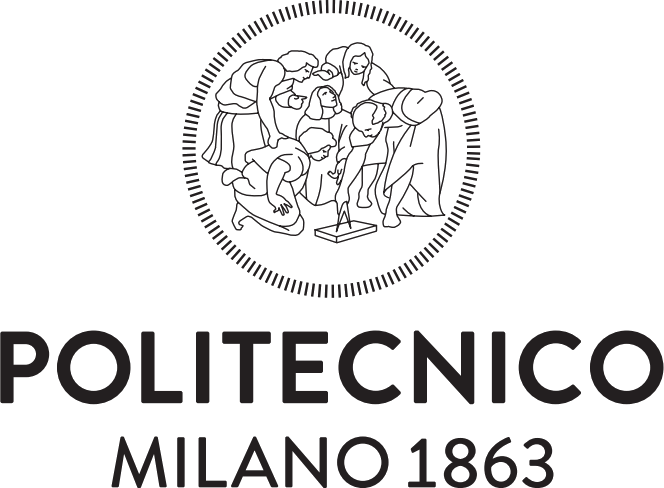

# Network Measurements and Data Analysis Lab

**Project #6: Failure Localization In Optical Networks**

**Professor Francesco Musumeci**

**Moein Taherinezhad - 10935476**

**Giulia Gerometta - 10628256**

**Niloufar Sasannia - 10888547**

In this project, our goal is to localize soft failures in an optical network comprising four nodes connected in series, creating three links. Each node has a monitor that provides OSNR (Optical Signal-to-Noise Ratio) samples. The aim is to use these OSNR values, identify key features, and apply machine learning methods for fault localization classification.


# Import Requirements

In [ ]:
!pip install shap==0.42.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 14.9 MB/s eta 0:00:00


In [ ]:
import time
import pandas as pd
import seaborn as sns
import xgboost as xgb
import numpy as np
import tensorflow.compat.v1.keras.backend as K
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
import matplotlib.pyplot as plt
from scipy.stats import kurtosis, skew
from sklearn.preprocessing import StandardScaler
from numba import jit
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import mean_squared_error, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.utils import to_categorical
import shap

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Data Preprocessing

We'll load data from 9 files, each containing observed data from the three monitors, merging them into a single pandas dataframe. While reading the data, we'll standardize values for each link to reduce bias, boosting our model's predictive performance.

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler

# Define links and nodes
links = ["1", "2", "3"]
# Nodes: A -> B -> C -> D
nodes = ["B", "C", "D"]
scaler = StandardScaler()

# Columns to read from the monitors
COLUMNS_TO_READ = [" DATE  ", "OSNR[dB] "]

# DataFrames for aggregating the data
aggr_df = pd.DataFrame()
std_aggr_df = pd.DataFrame()

def read_and_clean_file(file_name, columns_to_read):
    """
    Reads the file, skips initial rows, and renames columns.
    """
    df = pd.read_csv(file_name, skiprows=5, usecols=columns_to_read)
    df.rename(columns={" DATE  ": "time", "OSNR[dB] ": "OSNR"}, inplace=True)
    df['time'] = pd.to_datetime(df['time'], format='%Y/%m/%d %H:%M:%S %f')
    return df

def filter_and_standardize(df, scaler):
    """
    Filters invalid OSNR values and standardizes them.
    """
    df['OSNR'] = pd.to_numeric(df['OSNR'], errors='coerce')
    df = df[df["OSNR"] > 0]

    stn_df = df.copy()
    osnr_values = stn_df['OSNR'].values.reshape(-1, 1)
    stn_df['OSNR'] = scaler.fit_transform(osnr_values)

    return df, stn_df

def process_file(link, node, scaler):
    """
    Processes a single file and returns the cleaned and standardized DataFrames.
    """
    file_name = f"Fault_at_link_{link}_Monitor_at_node_{node}.dat"
    df = read_and_clean_file(file_name, COLUMNS_TO_READ)

    # Add link and node information
    df["link"] = link
    df["node"] = node

    print(f"Total {df.shape[0]} rows extracted for Node: {node}, failure at link: {link}")

    df, stn_df = filter_and_standardize(df, scaler)

    return df, stn_df

def aggregate_data(links, nodes, scaler):
    """
    Aggregates data from all specified links and nodes.
    """
    aggr_df = pd.DataFrame()
    std_aggr_df = pd.DataFrame()

    for link in links:
        for node in nodes:
            df, stn_df = process_file(link, node, scaler)
            aggr_df = pd.concat([aggr_df, df], ignore_index=True)
            std_aggr_df = pd.concat([std_aggr_df, stn_df], ignore_index=True)

    return aggr_df, std_aggr_df

# Aggregate data from all links and nodes
aggr_df, std_aggr_df = aggregate_data(links, nodes, scaler)

Total 21600 rows extracted for Node: B, failure at link: 1
Total 21603 rows extracted for Node: C, failure at link: 1
Total 21600 rows extracted for Node: D, failure at link: 1
Total 21600 rows extracted for Node: B, failure at link: 2
Total 21600 rows extracted for Node: C, failure at link: 2
Total 21600 rows extracted for Node: D, failure at link: 2
Total 21600 rows extracted for Node: B, failure at link: 3
Total 21600 rows extracted for Node: C, failure at link: 3
Total 21600 rows extracted for Node: D, failure at link: 3


In [ ]:
# dataframe with raw OSNR values
aggr_df.head()

,time,OSNR,link,node
0,2019-10-30 11:04:14.382,20.514,1,B
1,2019-10-30 11:04:15.419,20.629,1,B
2,2019-10-30 11:04:16.432,20.523,1,B
3,2019-10-30 11:04:17.417,20.524,1,B
4,2019-10-30 11:04:18.399,20.524,1,B


In [ ]:
# dataframe composed of standardized values
std_aggr_df.head()

,time,OSNR,link,node
0,2019-10-30 11:04:14.382,-0.877476,1,B
1,2019-10-30 11:04:15.419,2.267521,1,B
2,2019-10-30 11:04:16.432,-0.631345,1,B
3,2019-10-30 11:04:17.417,-0.603998,1,B
4,2019-10-30 11:04:18.399,-0.603998,1,B


# Data Analysis

In [ ]:
# compute summary statistics for OSNR raw values
osnr_stats = aggr_df['OSNR'].describe()
print(osnr_stats)

count    194400.00000
mean         20.27353
std           3.33124
min          16.11900
25%          17.76400
50%          18.97400
75%          22.60500
max          25.62300
Name: OSNR, dtype: float64


In [ ]:
# compute summary statistics for OSNR standarized values
osnr_stats = std_aggr_df['OSNR'].describe()
print(osnr_stats)

count    1.944000e+05
mean     2.794860e-14
std      1.000003e+00
min     -3.854176e+00
25%     -7.033165e-01
50%     -5.704168e-02
75%      6.522918e-01
max      4.590696e+00
Name: OSNR, dtype: float64


# Data Visualization

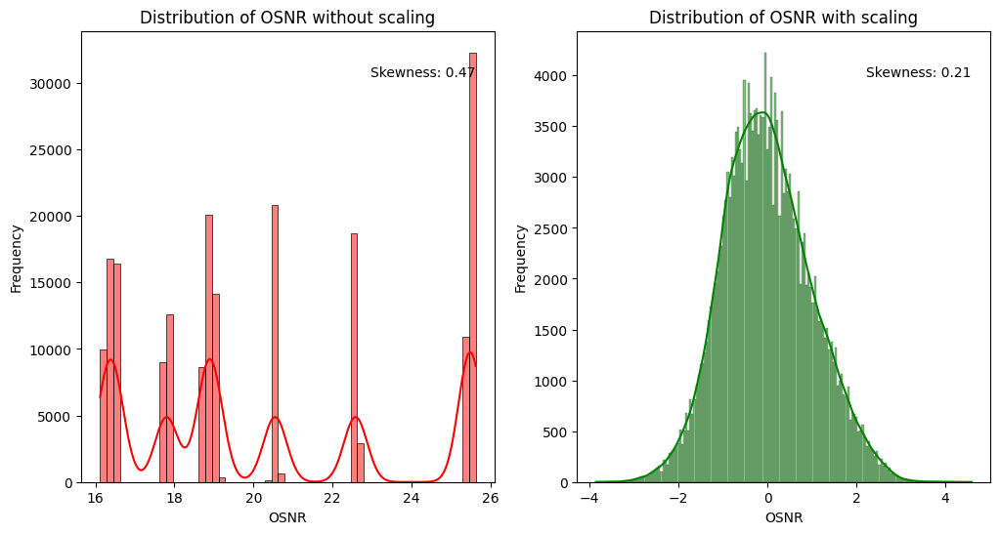

In [ ]:
def plot_histograms(df_original, df_standardized, column='OSNR'):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
    # Plot histogram for original OSNR values
    plot_histogram(df_original, column, 'red', axes[0], 'Distribution of OSNR without scaling')
    # Plot histogram for standardized OSNR values
    plot_histogram(df_standardized, column, 'green', axes[1], 'Distribution of OSNR with scaling')
    plt.show()

def plot_histogram(df, column, color, axis, title):
    # skewness: measure of the asymmetry of the probability distribution of a real-valued random variable about its mean
    skewness = df[column].skew()
    sns.histplot(df[column], kde=True, color=color, ax=axis)
    axis.set_xlabel(column)
    axis.set_ylabel('Frequency')
    axis.set_title(title)
    axis.text(0.7, 0.9, f"Skewness: {skewness:.2f}", transform=axis.transAxes)

# Call the function with the aggregated dataframes
plot_histograms(aggr_df, std_aggr_df)

Observing the OSNR distributions, we can see multiple peaks in the plot with absolute OSNR values: each link has unique characteristics, leading to varying OSNR measures.
The distribution with distinct peaks suggests that the data clusters around specific OSNR values rather than being smoothly distributed.
On the other hand, the scaled dataset closely approximates a normal distribution. In this case, the bell-shaped plot looks like a normal distribution.
The scaling process transformed the raw OSNR data from a multimodal moderately skewed distribution into a near-normal distribution (skewness equal to 0.21).
Skewness is a statistical measure that describes the asymmetry of a distribution around its mean.
Our dataset's skewness values (0.21 and 0.47) reveal that both distributions are moderately symmetrical since both have a slight positive skew.
However, the scaled dataset provides a more homogeneous data distribution. Most statistical analysis and machine learning algorithms assume normally distributed data. Indeed, as we will show later, we decided to use logistic regression, XGBoost, and LSTM machine learning models for classification. In all these cases, a scaled dataset ensures better performance and faster convergence during training.

**The samples are not collected exactly 1 second apart. As there was only one monitoring device during sampling, we do not need to use the absolute time value for joining; instead, we use the times as an index.**

Here we aim to analyze the impact of Normalization, Standardization, and Differencing techniques on a subset of our data. From this observation we will extract interesting behaviors of OSNR values in each scenario and draw some conclusions.

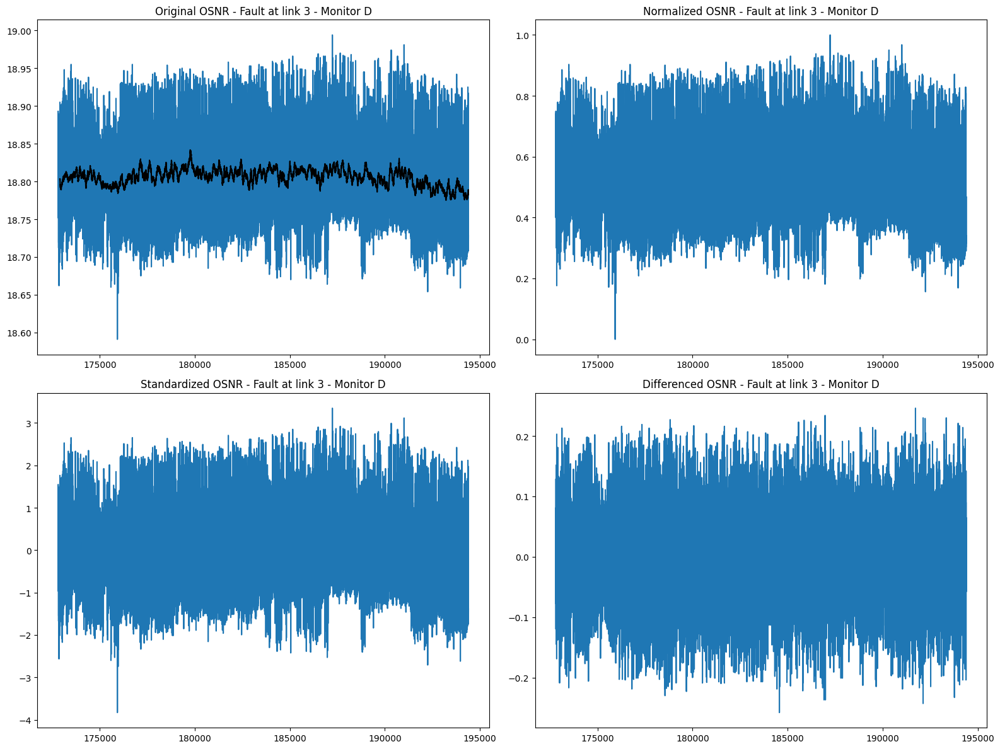

In [ ]:
def process_osnr_data(df, window_size=100):
    rolling_osnr = df['OSNR'].rolling(window_size).mean()
    normalized_osnr = (df['OSNR'] - df['OSNR'].min()) / (df['OSNR'].max() - df['OSNR'].min())
    standardized_osnr = (df['OSNR'] - df['OSNR'].mean()) / df['OSNR'].std()
    differenced_osnr = df['OSNR'].diff()

    return rolling_osnr, normalized_osnr, standardized_osnr, differenced_osnr

def plot_osnr_subplots(df, rolling_osnr, normalized_osnr, standardized_osnr, differenced_osnr):
    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(16, 12))

    plot_osnr(axes[0, 0], df['OSNR'], rolling_osnr, 'Original OSNR - Fault at link 3 - Monitor D')
    plot_osnr(axes[0, 1], normalized_osnr, None, 'Normalized OSNR - Fault at link 3 - Monitor D')
    plot_osnr(axes[1, 0], standardized_osnr, None, 'Standardized OSNR - Fault at link 3 - Monitor D')
    plot_osnr(axes[1, 1], differenced_osnr, None, 'Differenced OSNR - Fault at link 3 - Monitor D')

    plt.tight_layout()
    plt.show()

def plot_osnr(axis, data, rolling_data, title):
    axis.plot(data)
    if rolling_data is not None:
        axis.plot(rolling_data, linestyle='-', color='black')
    axis.set_title(title)


# Choosing the last fault at link 3 monitoring at node D example
last_fault_df = aggr_df.tail(21600)
# Process OSNR data
rolling_osnr, normalized_osnr, standardized_osnr, differenced_osnr = process_osnr_data(last_fault_df)
# Plot the OSNR data
plot_osnr_subplots(last_fault_df, rolling_osnr, normalized_osnr, standardized_osnr, differenced_osnr)

The top left plot represents the original OSNR values without any preprocessing.
The top right plot shows normalized OSNR measures. As we can see, normalization retains the shape and relative distribution of the original data.
The bottom left plot displays standardized OSNR values. It highlights outliers and deviations from the mean more clearly. Moreover, standardization is usually employed in machine learning algorithms that assume normally distributed data.
The bottom right plot illustrates the OSNR values after differencing.
However, differencing removes trends and seasonality, highlighting changes from one point to the next. Indeed, differencing appears more robust against outliers. These charts show an outlier that significantly impacts the dataset. Only standardization and normalization maintain the trend. Since we need to apply machine learning techniques, we will employ standardization.


# Feature Extraction

We extract statistical features (Mean OSNR, Max OSNR, Min OSNR, Peak-to-Peak OSNR, Skewness, Kurtosis) from OSNR values grouped into same-size windows. Windows are of duration *window_size*, including *window_size* consecutive OSNR samples. Hence, we compute the features of each window.

In [ ]:
# compute the kurtosis and skewness of an array using JIT (Just-In-Time) compilation for speed

@jit(nopython=True)
def fast_kurtosis(arr):
    """
    kurtosis = (m4 / var**2) - 3
    where:
    - m4 is the fourth central moment
    - var is the variance
    """
    mean = np.mean(arr)
    var = np.var(arr)
    n = len(arr)
    m4 = np.sum((arr - mean) ** 4) / n
    kurt = (m4 / var**2) - 3
    return kurt

@jit(nopython=True)
def fast_skewness(arr):
    """
    skewness = m3 / (std**3)
    where:
    - m3 is the third central moment
    - std is the standard deviation
    """
    mean = np.mean(arr)
    std = np.std(arr)
    n = len(arr)
    m3 = np.sum((arr - mean) ** 3) / n
    skew = m3 / (std**3)
    return skew

In [ ]:
def feature_extract(osnr_arr, window_size, spacing, node_name):
    """
    Calculate features from OSNR values using a sliding window approach.
    window_size is the Size of the sliding window and spacing is the Spacing between two consecutive windows.
    """
    features = [
        f'mean_{node_name}',
        f'std_{node_name}',
        f'max_osnr_{node_name}',
        f'min_osnr_{node_name}',
        f'peak_to_peak_{node_name}',
        f'kurtosis_{node_name}',
        f'skewness_{node_name}'
    ]

    def calculate_features(window):
        return [
            np.mean(window),
            np.std(window),
            np.max(window),
            np.min(window),
            np.max(window) - np.min(window),
            fast_kurtosis(window),
            fast_skewness(window)
        ]

    result = [
        calculate_features(osnr_arr[i:i + window_size])
        for i in range(0, len(osnr_arr) - window_size + 1, spacing)
    ]

    return pd.DataFrame(result, columns=features)

In [ ]:
window_size = 10
spacing = 1
feature_extract(std_aggr_df.head(21600)['OSNR'].values, window_size, spacing, 'B').head()

,mean_B,std_B,max_osnr_B,min_osnr_B,peak_to_peak_B,kurtosis_B,skewness_B
0,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780
1,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780
2,-0.461789,0.689012,1.583826,-0.877476,2.461302,4.799260,2.560758
3,-0.234802,0.928154,1.638522,-0.877476,2.515997,0.201236,1.458647
4,-0.207455,0.920874,1.638522,-0.877476,2.515997,0.128237,1.410731


In [ ]:
def dataset_builder(inp_df, links, nodes, window_size, spacing):
    """
    Builds the final dataset which contains features of the data from each node.
    """
    result_df = pd.DataFrame()

    # Iterate over each link and aggregate monitoring data from nodes
    for link in links:
        aggr_row = pd.DataFrame()
        for node in nodes:
            node_df = inp_df[(inp_df['link'] == link) & (inp_df['node'] == node)]['OSNR'].values
            features_df = feature_extract(node_df, window_size, spacing, node)
            aggr_row = pd.concat([aggr_row, features_df], axis=1)
        # Add link information to the aggregated row
        aggr_row['link'] = link
        result_df = pd.concat([result_df, aggr_row], ignore_index=True)

    return result_df

In [ ]:
# dataset containing features monitored for each Node
window_size = 10
spacing = 1
final_df = dataset_builder(std_aggr_df, links, nodes, window_size, spacing)

In [ ]:
final_df

,mean_B,std_B,max_osnr_B,min_osnr_B,peak_to_peak_B,kurtosis_B,skewness_B,mean_C,std_C,max_osnr_C,...,kurtosis_C,skewness_C,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780,0.854412,1.057799,1.823733,...,-1.050891,-0.801280,-0.115125,0.848617,0.803778,-2.398459,3.202237,2.466606,-1.731141,1
1,-0.147289,1.050458,2.267521,-0.877476,3.144996,0.586930,1.557780,0.871233,1.033000,1.823733,...,-1.019705,-0.801570,-0.289160,1.006045,0.803778,-2.398459,3.202237,-0.147097,-1.083813,1
2,-0.461789,0.689012,1.583826,-0.877476,2.461302,4.799260,2.560758,0.717740,1.121530,1.823733,...,-1.634799,-0.436351,-0.546731,1.057316,0.803778,-2.398459,3.202237,-1.140324,-0.622802,1
3,-0.234802,0.928154,1.638522,-0.877476,2.515997,0.201236,1.458647,0.827078,0.988612,1.823733,...,-1.640324,-0.424516,-0.493360,0.972573,0.803778,-1.911162,2.714940,-1.282336,-0.523694,1
4,-0.207455,0.920874,1.638522,-0.877476,2.515997,0.128237,1.410731,0.677790,0.951562,1.823733,...,-1.705454,-0.112416,-0.437669,1.021438,0.803778,-1.911162,2.714940,-1.335638,-0.484011,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64768,0.408834,0.575042,1.485173,-0.500929,1.986102,-0.668763,0.403601,-0.993312,1.137849,1.795546,...,0.975005,1.219486,-0.285265,1.340336,1.977502,-1.746264,3.723766,-0.994396,0.693809,3
64769,0.335156,0.513233,1.485173,-0.500929,1.986102,0.361206,0.639428,-1.048702,1.148984,1.795546,...,1.068222,1.319039,-0.632698,1.144800,1.977502,-1.746264,3.723766,0.216261,1.161183,3
64770,0.280699,0.495066,1.485173,-0.500929,1.986102,1.194439,0.983741,-1.032085,1.142718,1.795546,...,1.078023,1.303302,-0.987258,0.768789,0.872844,-1.746264,2.619108,0.677588,1.221882,3
64771,0.191004,0.534150,1.485173,-0.500929,1.986102,0.951751,1.045495,-1.167789,1.145839,1.795546,...,1.724017,1.605713,-0.873228,0.745171,0.872844,-1.746264,2.619108,0.377997,0.976943,3


In [ ]:
# dataset with only a part of features (just with node D)
final_one_node_df = final_df.iloc[:, 14:]
final_one_node_df

,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.115125,0.848617,0.803778,-2.398459,3.202237,2.466606,-1.731141,1
1,-0.289160,1.006045,0.803778,-2.398459,3.202237,-0.147097,-1.083813,1
2,-0.546731,1.057316,0.803778,-2.398459,3.202237,-1.140324,-0.622802,1
3,-0.493360,0.972573,0.803778,-1.911162,2.714940,-1.282336,-0.523694,1
4,-0.437669,1.021438,0.803778,-1.911162,2.714940,-1.335638,-0.484011,1
...,...,...,...,...,...,...,...,...
64768,-0.285265,1.340336,1.977502,-1.746264,3.723766,-0.994396,0.693809,3
64769,-0.632698,1.144800,1.977502,-1.746264,3.723766,0.216261,1.161183,3
64770,-0.987258,0.768789,0.872844,-1.746264,2.619108,0.677588,1.221882,3
64771,-0.873228,0.745171,0.872844,-1.746264,2.619108,0.377997,0.976943,3


In [ ]:
window_size = 100
spacing = 25
new_final_df = dataset_builder(std_aggr_df, links, nodes, window_size, spacing)

In [ ]:
new_final_df

,mean_B,std_B,max_osnr_B,min_osnr_B,peak_to_peak_B,kurtosis_B,skewness_B,mean_C,std_C,max_osnr_C,...,kurtosis_C,skewness_C,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.158775,0.853506,2.267521,-1.998735,4.266256,0.033878,-0.146887,0.437878,0.865643,2.244263,...,-0.365284,-0.095219,-0.249480,1.113478,2.010418,-2.468073,4.478491,-0.945739,-0.115725,1
1,-0.135256,0.943241,1.556478,-1.998735,3.555213,-0.922648,-0.274244,0.457222,0.864823,2.244263,...,-0.346165,-0.106545,-0.148076,1.161455,2.567329,-2.468073,5.035402,-0.548191,0.322044,1
2,-0.251758,1.007760,1.802608,-1.998735,3.801343,-1.127768,0.169230,0.340104,0.898593,2.580687,...,-0.485733,0.206895,-0.109324,1.139979,2.567329,-2.212822,4.780151,-0.550228,0.513353,1
3,-0.208275,1.012817,1.802608,-1.889344,3.691952,-1.062339,0.536193,0.289010,0.817179,2.580687,...,-0.109150,0.811201,-0.008848,1.089753,2.567329,-2.003981,4.571310,-0.383016,0.525119,1
4,-0.254766,0.861363,1.802608,-1.670562,3.473170,0.028135,1.074261,0.250952,0.834887,2.580687,...,1.225356,0.040119,0.114137,0.947823,2.567329,-2.003981,4.571310,0.219845,0.559972,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2578,0.257314,0.907686,3.343140,-1.237708,4.580848,1.924181,1.207270,-0.982234,0.847191,1.407820,...,0.390254,0.588050,-0.496397,1.030900,1.817148,-2.066972,3.884120,-0.812917,0.292318,3
2579,0.247063,0.928822,3.343140,-1.301776,4.644916,1.698389,1.171478,-1.018791,0.868959,1.407820,...,0.329307,0.528606,-0.525796,1.013199,1.638978,-2.066972,3.705949,-0.990920,0.279540,3
2580,0.150961,0.791767,2.221953,-1.301776,3.523729,-0.263609,0.423408,-1.033192,0.848815,1.407820,...,0.532082,0.730922,-0.424773,1.026198,1.692429,-1.942252,3.634681,-0.963879,0.266949,3
2581,0.210224,0.826425,2.830597,-1.301776,4.132373,0.806977,0.703107,-1.071688,0.861466,1.407820,...,0.654364,0.911572,-0.423526,1.043822,2.120038,-1.942252,4.062291,-0.825673,0.321851,3


In [ ]:
# dataset with only a part of features (just with node D) and bigger window size
new_final_one_node_df = new_final_df.iloc[:, 14:]
new_final_one_node_df

,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.249480,1.113478,2.010418,-2.468073,4.478491,-0.945739,-0.115725,1
1,-0.148076,1.161455,2.567329,-2.468073,5.035402,-0.548191,0.322044,1
2,-0.109324,1.139979,2.567329,-2.212822,4.780151,-0.550228,0.513353,1
3,-0.008848,1.089753,2.567329,-2.003981,4.571310,-0.383016,0.525119,1
4,0.114137,0.947823,2.567329,-2.003981,4.571310,0.219845,0.559972,1
...,...,...,...,...,...,...,...,...
2578,-0.496397,1.030900,1.817148,-2.066972,3.884120,-0.812917,0.292318,3
2579,-0.525796,1.013199,1.638978,-2.066972,3.705949,-0.990920,0.279540,3
2580,-0.424773,1.026198,1.692429,-1.942252,3.634681,-0.963879,0.266949,3
2581,-0.423526,1.043822,2.120038,-1.942252,4.062291,-0.825673,0.321851,3


# Feature Analysis


This section focuses on feature analysis to help us understand the dataset structure for feature selection for machine learning model development. In general, features having non-overlapping plots will indicate a good discriminative power. On the other hand, a feature scatter plot representing coinciding values in the three links suggests that this feature is not valuable for classification. Moreover, even if the presence of outliers can introduce a discriminative value for a specific link, it also introduces noise. Indeed, a wider spread indicates a vaster variability in that feature. While features with a more concentrated distribution imply more consistency in the values.
Here, the ideal case would be a concentrated distribution of the single features in a specific link but with a non-overlapping scatter plot from one link to another.

In [ ]:
# plotting a single feature against the 3 different links
def plot_feature(ax, df, feature, unique_target_values):
    for value in unique_target_values:
        subset = df[df['link'] == value]
        ax.scatter(subset[feature], [value] * len(subset), label=f'link={value}')

    ax.set_xlabel(feature)
    ax.set_ylabel('link')
    ax.set_title(f'Feature = {feature}')
    ax.legend()


# visualization of data distributions using scatter plots for each feature
def scatter_features(df):
    unique_target_values = df['link'].unique()
    # Exclude the target variable
    features = df.columns[:-1]
    num_features = len(features)

    fig, axs = plt.subplots(num_features, 1, figsize=(12, 4*num_features))

    # Ensure axs is always iterable, even if there's only one subplot
    if num_features == 1:
        axs = [axs]

    # Iterate over each feature and plot
    for i, feature in enumerate(features):
        plot_feature(axs[i], df, feature, unique_target_values)

    plt.tight_layout()
    plt.show()

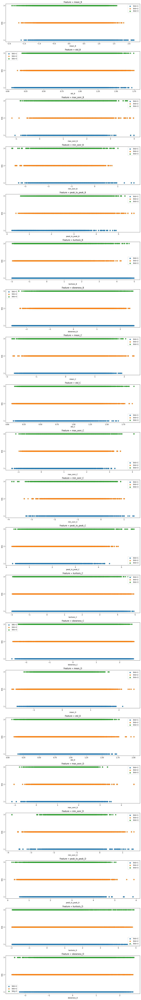

In [ ]:
scatter_features(final_df)

For most features, scatter plots of the different links overlap, meaning that a single feature is not discriminative for classification.
For this reason, we must use machine-learning algorithms to deliver a more comprehensive analysis, including all the features. Indeed, multiple features collectively contribute to the classification. Machine learning models can consider all the features simultaneously to produce accurate predictions.

In [ ]:
# plot a histogram for a given feature and link value on a given axis
def plot_histogram(ax, data, feature, link_value):
    ax.hist(data[feature])
    ax.set_xlabel(feature)
    ax.set_ylabel('Frequency')
    ax.set_title(f'Link = {link_value}')

# visualization of data distributions by creating histograms for each feature and each unique link value
def hist_features(df):
    unique_links = df['link'].unique()
    # Exclude the target variable
    features = df.columns[:-1]

    for feature in features:
        fig, axs = plt.subplots(1, len(unique_links), figsize=(16, 4))
        fig.suptitle(feature)

        # Ensure axs is always iterable, even if there's only one subplot
        if len(unique_links) == 1:
            axs = [axs]

        for i, link_value in enumerate(unique_links):
            filtered_data = df[df['link'] == link_value]
            plot_histogram(axs[i], filtered_data, feature, link_value)

    plt.tight_layout()
    plt.show()

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


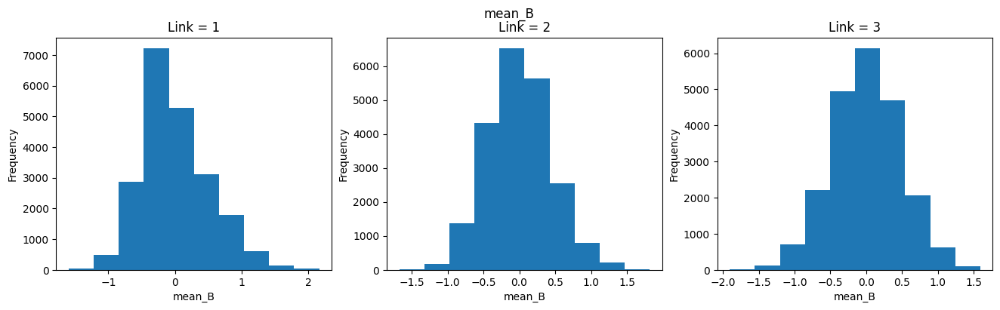

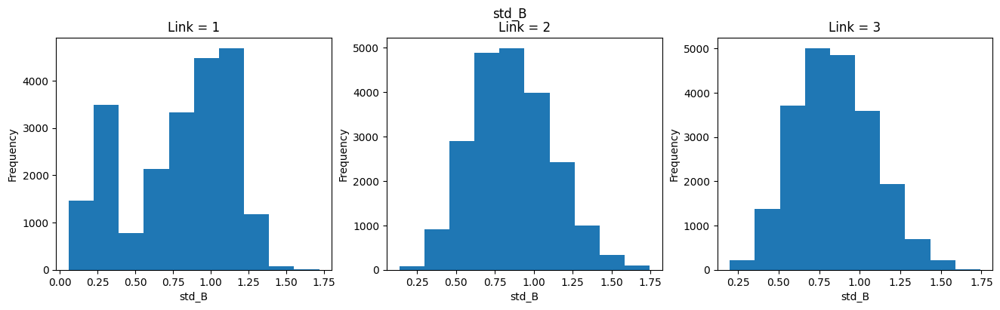

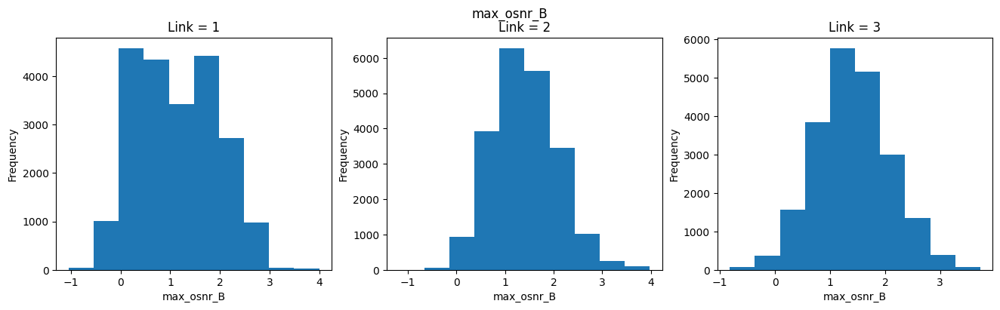

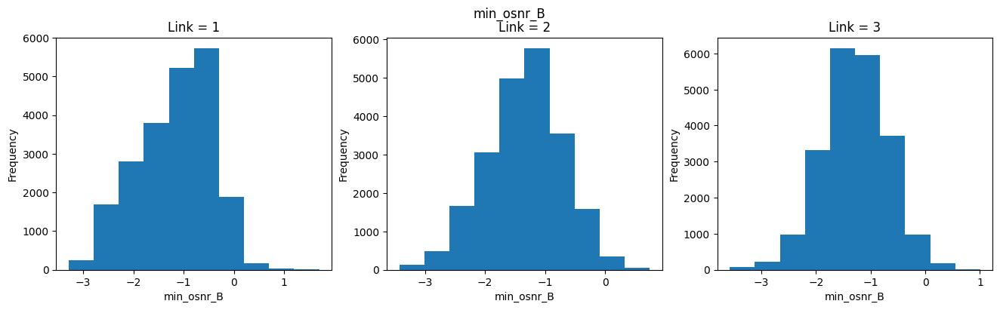

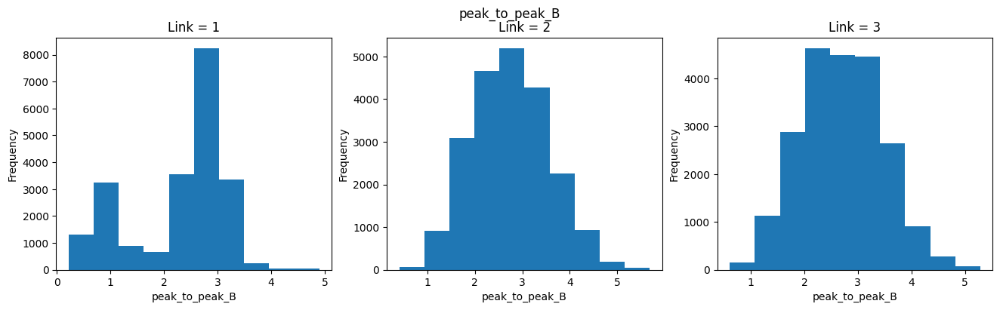

...

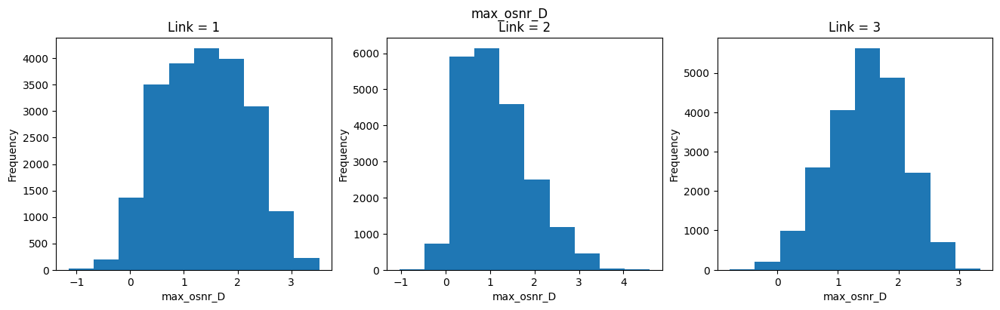

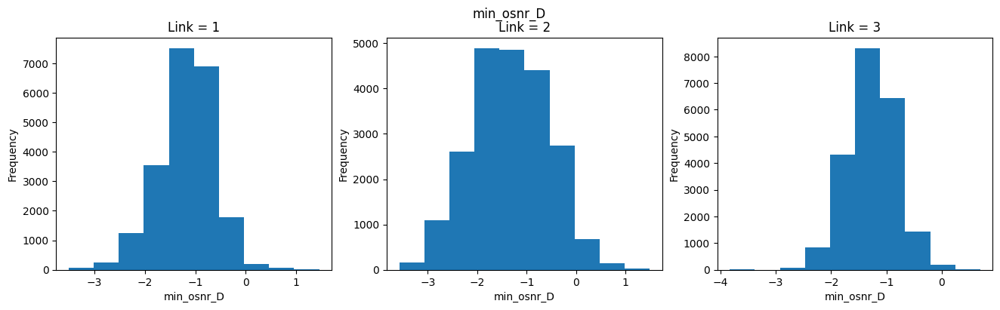

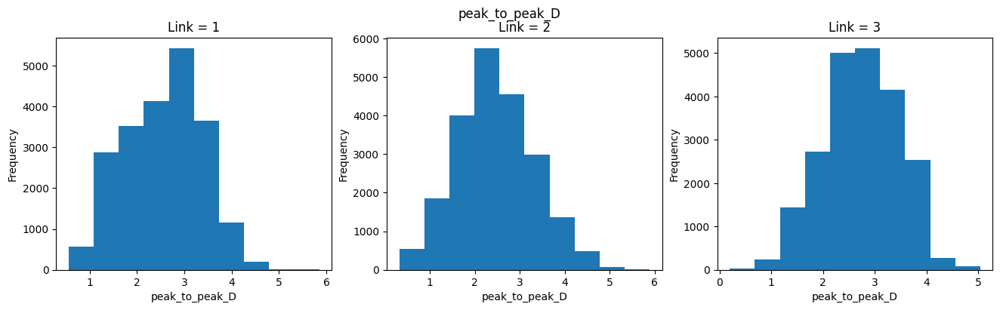

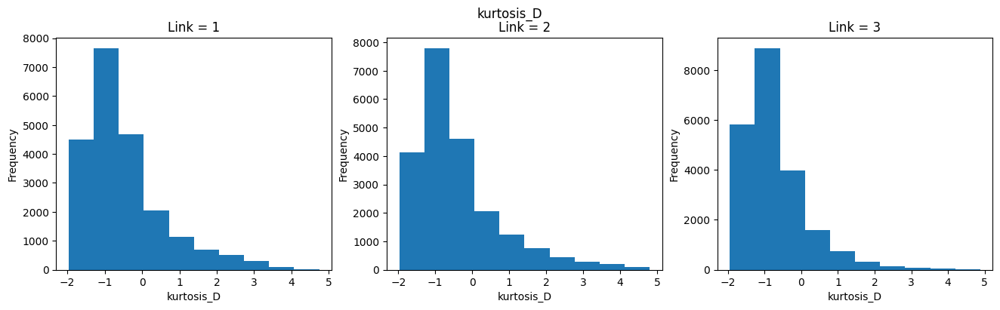

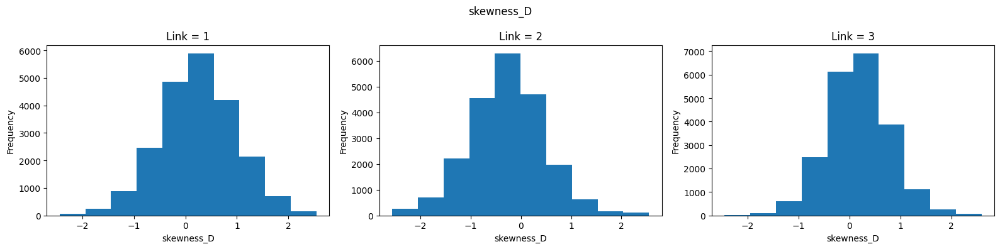

In [ ]:
hist_features(final_df)

Moreover, we investigated features' distribution with histograms representing the distribution of each variable for the three different links. We can appreciate only irregular behavior on Link 1's features collected from monitor B, revealing more variability. Indeed, links 2 and 3 always show the typical bell-shaped curve, showing more stability.
These results might indicate issues such as inconsistent signal quality or external factors affecting the OSNR values collected link 1.

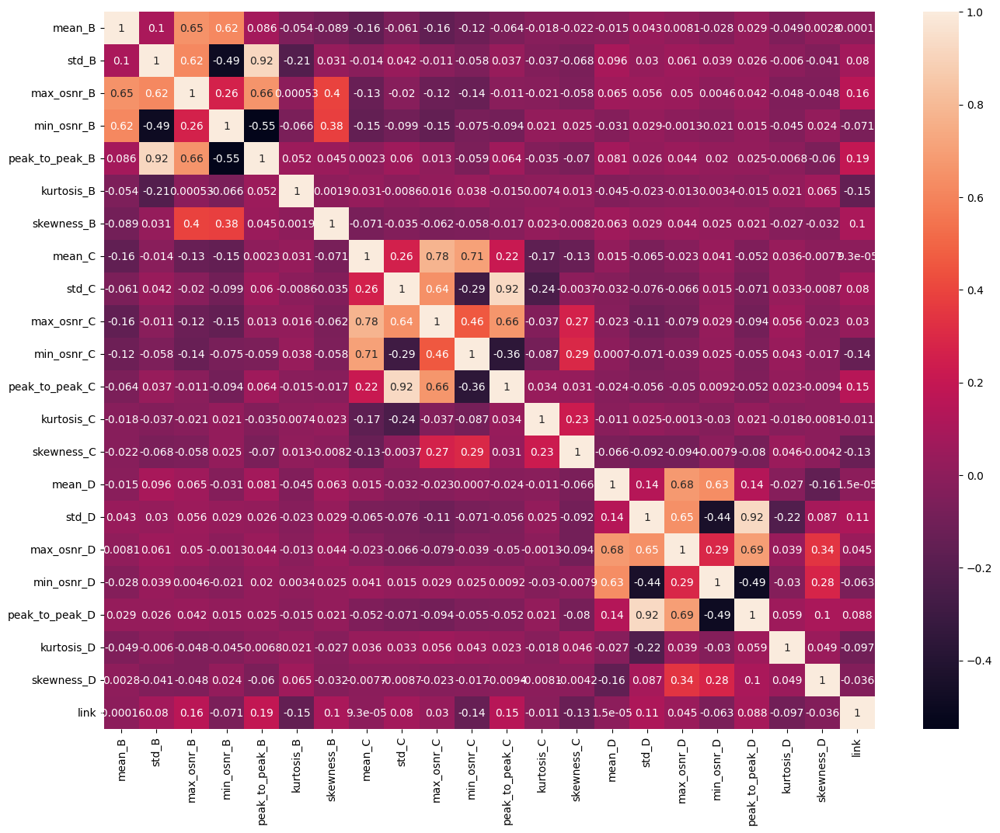

In [ ]:
# correlation matrix heatmap
correlation_matrix = final_df.corr()
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True)
plt.show()

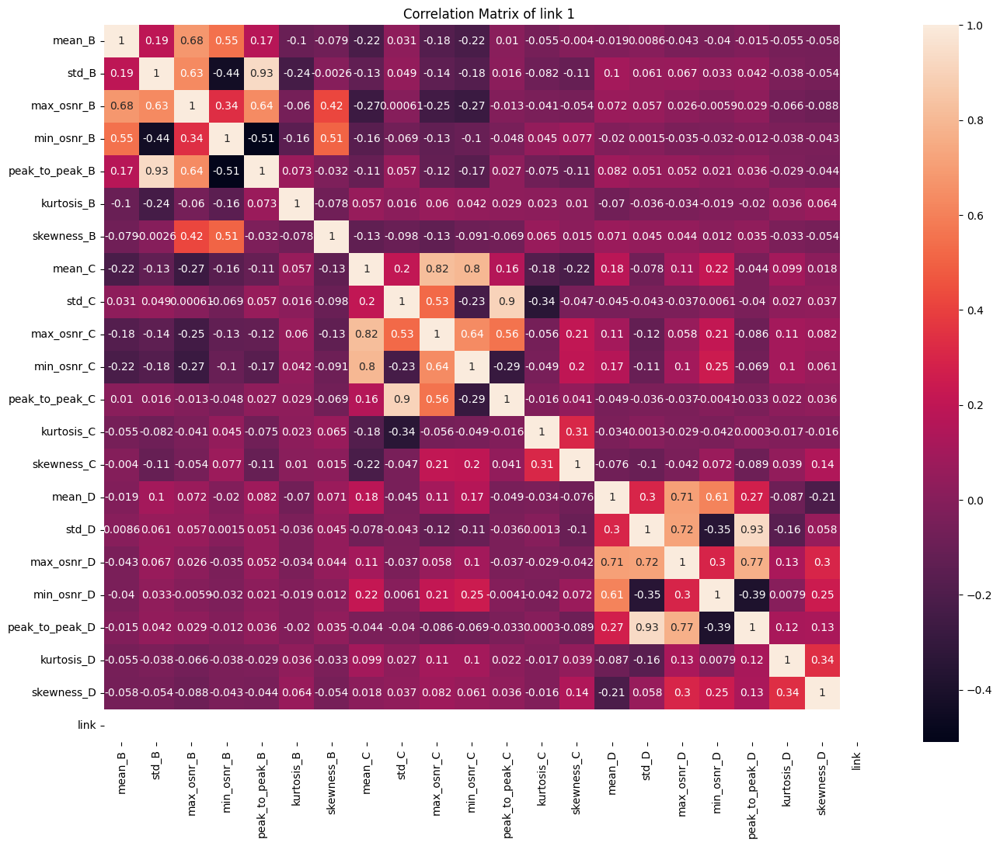

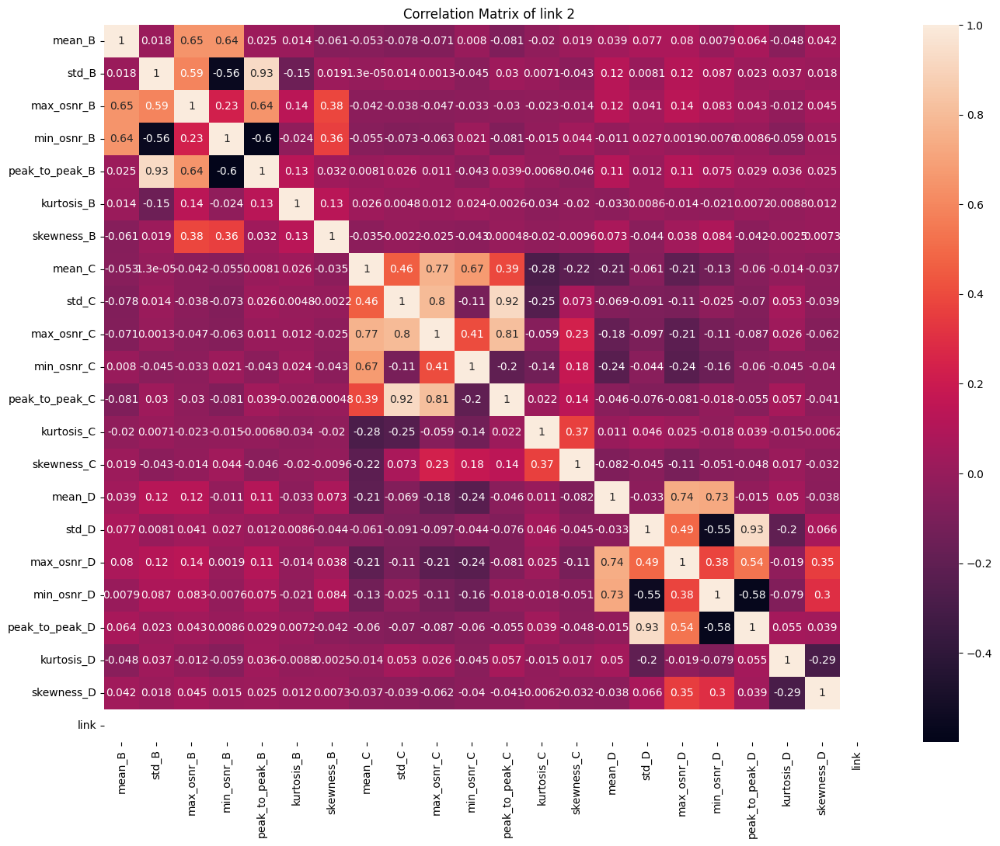

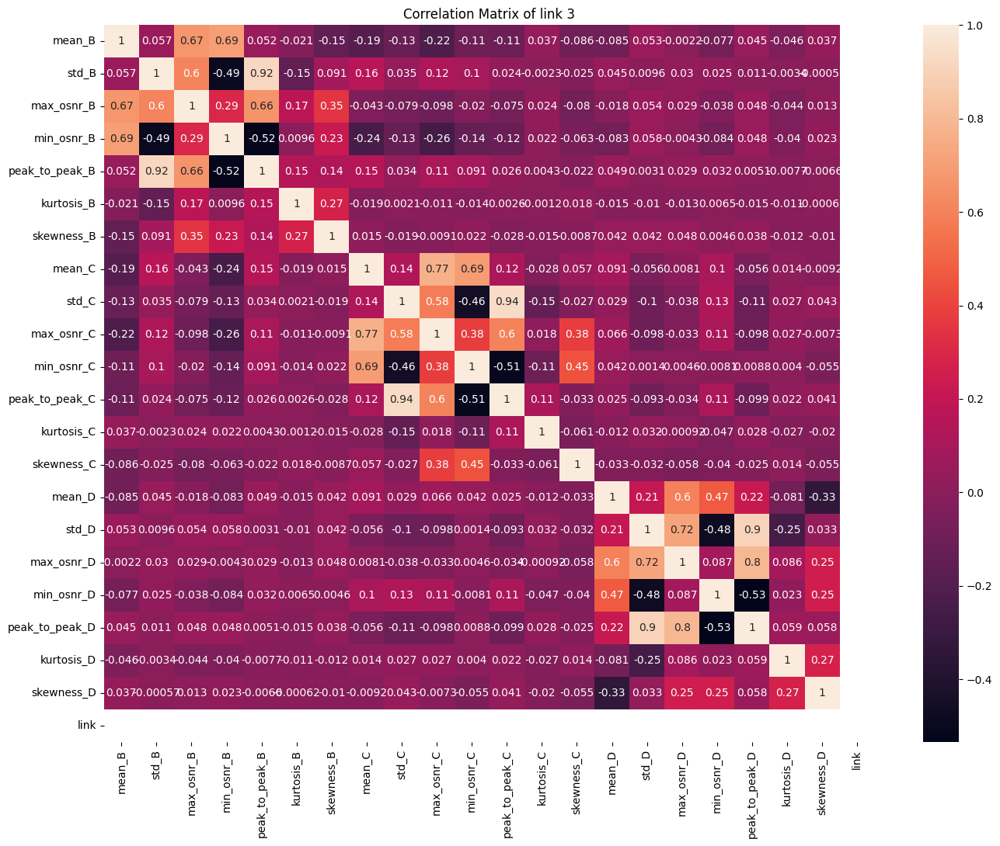

In [ ]:
# correlation matrix of each link value (1, 2, 3)
for link in links:
    correlation_matrix = final_df[final_df['link'] == link].corr()
    plt.figure(figsize=(16, 12))
    plt.title(f"Correlation Matrix of link {link}")
    sns.heatmap(correlation_matrix, annot=True)
    plt.show()

Finally, we plotted a correlation matrix for each link. These correlation matrices show the correlation coefficients between variables, where 1 indicates a perfect positive correlation, -1 is a perfect negative, and 0 indicates no correlation.
For all three links, we can see that peak-to-peak and std are highly correlated in each monitor. We might remove or combine highly correlated features (in our case, peak-to-peak and std) to simplify the model.
However, it is evident that these correlations are primarily due to our small window sizes. We will investigate further and contrast these correlations by utilizing windows with increased spacings.

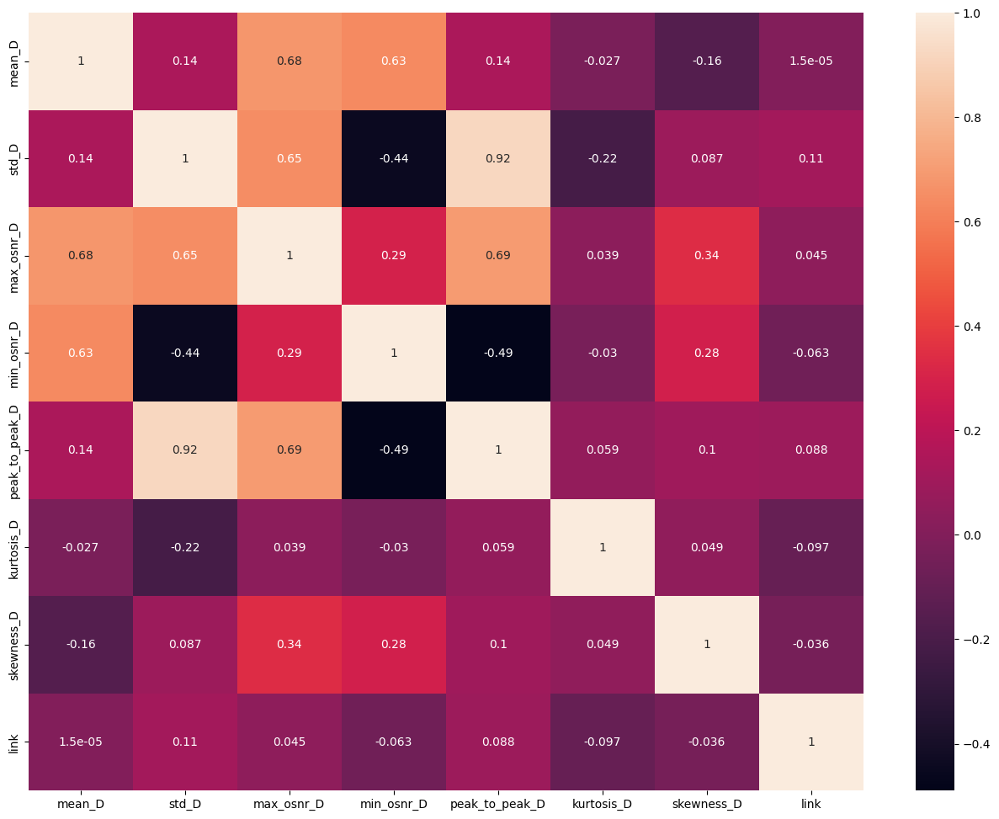

In [ ]:
# correlation matrix of a df with only node D features
correlation_matrix = final_one_node_df.corr()
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True)
plt.show()

# Explainable AI

Explainable AI moves beyond interpretable AI providing insights on how the ML model arrived at the result. XAI estimates the contribution of each feature to the prediction.
We implemented the two functions below using SHAP to explain the output of machine learning models. In particular, the **shap_plots_explainable_ai_tree_explainer** function explains tree-based models. At first, we used a bar plot to give a global summary showing the impact of each feature on the model's output across the entire test set. Then, it iterates through each link and generates a SHAP summary plot.
Hence, we plot the SHAP values as a bar chart, showing the contribution of each feature to the model's prediction for that instance.
At this point, for each feature, we show the relationship between the feature value and the SHAP value, illustrating how changes in the feature affect the model's prediction. The **shap_plots_explainable_ai_linear_explainer** function accomplishes the same tasks as before but for explaining linear models.



In [ ]:
def shap_plots_explainable_ai_tree_explainer(best_model, X_test):
    # initializing the explainer
    explainer = shap.TreeExplainer(best_model)
    # generating SHAP values for the test data
    shap_values = explainer.shap_values(X_test)
    # global summary plot
    plt.title("Gobal Summary Plot")
    shap.summary_plot(shap_values, X_test, plot_type="bar")

    # separate plots for each label
    for label_idx in range(3):
        print("Link ", label_idx + 1)
        # summary plot
        shap.summary_plot(shap_values[label_idx], X_test, class_names=["1", "2", "3"], show=False)

        # bar plot for a specific instance (e.g., instance at index 0)
        plt.figure(figsize=(12, 6))
        shap_values_label = shap_values[label_idx][0]
        plt.bar(range(len(shap_values_label)), shap_values_label)
        plt.xticks(range(len(shap_values_label)), X_test.columns, rotation=90, ha='center')
        plt.xlabel("Features")
        plt.ylabel("SHAP Values")
        plt.title("SHAP Values for Link " + str(label_idx + 1))
        plt.show()

        for feature_idx, feature_name in enumerate(X_test.columns):
            shap.dependence_plot(feature_idx, shap_values[label_idx], X_test, interaction_index=None, feature_names=X_test.columns)

In [ ]:
def shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test):
    # initializing the explainer
    explainer = shap.LinearExplainer(best_model, X_train)
    # generating SHAP values for the test data
    shap_values = explainer.shap_values(X_test)
    # global summary plot
    plt.title("Gobal Summary Plot")
    shap.summary_plot(shap_values, X_test, plot_type="bar")

    # separate plots for each label
    for label_idx in range(3):
        print("Link ", label_idx + 1)
        # summary plot
        shap.summary_plot(shap_values[label_idx], X_test, class_names=["1", "2", "3"], show=False)

        # bar plot for a specific instance (e.g., instance at index 0)
        plt.figure(figsize=(12, 6))
        shap_values_label = shap_values[label_idx][0]
        plt.bar(range(len(shap_values_label)), shap_values_label)
        plt.xticks(range(len(shap_values_label)), X_test.columns, rotation=90, ha='center')
        plt.xlabel("Features")
        plt.ylabel("SHAP Values")
        plt.title("SHAP Values for Link " + str(label_idx + 1))
        plt.show()

        for feature_idx, feature_name in enumerate(X_test.columns):
            shap.dependence_plot(feature_idx, shap_values[label_idx], X_test, interaction_index=None, feature_names=X_test.columns)

# Models

In this section, we will apply Logistic regression, XGboost, and LSTM models suitable for anomaly detection. In the first stage, we employed random train and test splits. After that, we used an in-time train and test separations. For both cases, we integrated Explainable AI (XAI) techniques. In particular, we exploited SHAP to determine feature importance for fault predictions.

For each model, we will train with both the dataset composed of all the monitors (Multiple Monitor subsection) and the one composed of just one node (Single Monitor subsection). In the single monitor case, we used just the data collected from the monitor at node D.

Finally we decided to increase window and spacing.
Note that we built our dataset calculating features from OSNR values using a sliding window approach. window_size is the size of the sliding window, and spacing is the spacing between two consecutive windows.
In the previous cases, we used a dataset with window_size equal to 10 with a spacing of 1.
Hence, we explored a bigger window size (100) with a bigger spacing (25).

## Scenario 1 & 3: Random Train & Test Splits

### Logistic Regression

In this section, we are performing logistic regression classification with k-fold cross-validation and optional feature scaling.
We used the K-Fold Cross-Validation technique to evaluate the performance of the logistic regression model. This methodology proposes to split the data into k subsets (folds). Hence, the model is trained k times, using a different fold as the validation set and the remaining folds as the training set. At this point, we average the performance metrics over all k iterations to provide a more robust estimate of model performance.
We used StratifiedKFold to split the training data into n_splits folds for cross-validation. StratifiedKFold splitting ensures that each fold has the same proportion of each class as the original dataset.


The final_df data frame contains features computed from scaled OSNR values. Hence, the features in the dataset are not standardized on their own, but they are calculated from scaled values. Indeed, we decided to apply the StandardScaler() function to standardize the features. We run the model with scaled and non-scaled features (is_scaled = True/False). As we can see from the confusion matrices, the overall model performance does not change.

In [ ]:
def logistic_classifier_w_kfold(n_splits, df, is_scaled, test_size):
    """
    Classification with Logistic Regression using k-fold cross-validation and optional scaling.
    """
    # Scale data if required
    if is_scaled:
        scaler = StandardScaler()
        df.iloc[:, :-1] = scaler.fit_transform(df.iloc[:, :-1])

    # Split features and target
    X = df.iloc[:, :-1]
    y = LabelEncoder().fit_transform(df.iloc[:, -1])
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=42)

    # KFold cross-validation setup
    outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

    best_model, best_score = None, 0.0
    metrics = {'test_accuracy': [], 'mse': [], 'precision': [], 'recall': [], 'f1': [], 'train_accuracy': [], 'duration': []}

    for train_idx, test_idx in outer_skf.split(X_train, y_train):
        X_train_fold, X_test_fold = X_train.iloc[train_idx], X_train.iloc[test_idx]
        y_train_fold, y_test_fold = y_train[train_idx], y_train[test_idx]

        model = LogisticRegression(multi_class='multinomial', solver='sag')

        start_time = time.time()
        model.fit(X_train_fold, y_train_fold)
        metrics['duration'].append(time.time() - start_time)

        y_pred_fold = model.predict(X_test_fold)
        y_pred_test = model.predict(X_test)

        # Collect fold metrics
        metrics['train_accuracy'].append(accuracy_score(y_test_fold, y_pred_fold))
        metrics['mse'].append(mean_squared_error(y_test_fold, y_pred_fold))
        metrics['precision'].append(precision_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['recall'].append(recall_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['f1'].append(f1_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['test_accuracy'].append(accuracy_score(y_test, y_pred_test))

        # Track the best model
        test_accuracy = accuracy_score(y_test, y_pred_test)
        if test_accuracy > best_score:
            best_score = test_accuracy
            best_metrics = {
                'mse': mean_squared_error(y_test, y_pred_test),
                'precision': precision_score(y_test, y_pred_test, average='macro'),
                'recall': recall_score(y_test, y_pred_test, average='macro'),
                'f1': f1_score(y_test, y_pred_test, average='macro'),
            }
            best_model = model

    # Print average metrics
    print(f"Average Train accuracy: {np.mean(metrics['train_accuracy'])}")
    print(f"Average Train mse: {np.mean(metrics['mse'])}")
    print(f"Average Train precision: {np.mean(metrics['precision'])}")
    print(f"Average Train recall: {np.mean(metrics['recall'])}")
    print(f"Average Train f1: {np.mean(metrics['f1'])}")
    print(f"Average Train duration: {np.mean(metrics['duration'])}")
    print(f"Average Test accuracy: {np.mean(metrics['test_accuracy'])}")
    print("******************************************")
    print(f"Best Test accuracy: {best_score}")
    print(f"Best Test MSE: {best_metrics['mse']}")
    print(f"Best Test precision: {best_metrics['precision']}")
    print(f"Best Test recall: {best_metrics['recall']}")
    print(f"Best Test f1: {best_metrics['f1']}")

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_matrix(y_test, best_model.predict(X_test)), annot=True, fmt='d')
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

    return best_model, X_train, X_test

#### Multiple Monitor

Average Train accuracy: 0.6687445850702479
Average Train mse: 0.5634716543615726
Average Train precision: 0.6657385862861755
Average Train recall: 0.6684948807158614
Average Train f1: 0.6664708011571678
Average Train duration: 0.6076370239257812
Average Test accuracy: 0.6664762639907372
******************************************
Best Test accuracy: 0.6677730605943651
Best Test MSE: 0.5663450405248939
Best Test precision: 0.6654407241336916
Best Test recall: 0.6687863452316849
Best Test f1: 0.6663172292964724


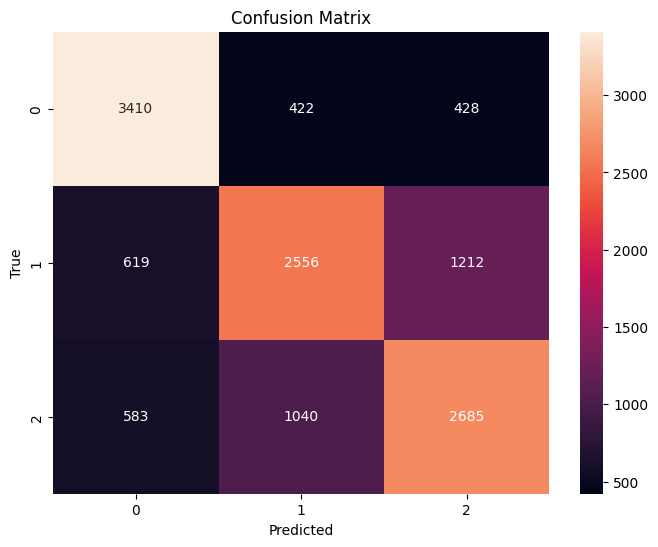

In [ ]:
# no scaling, test size=0.2
best_model, X_train, X_test = logistic_classifier_w_kfold(5, final_df, False, 0.2)

Average Train accuracy: 0.6690726586321396
Average Train mse: 0.5626225408635277
Average Train precision: 0.6661031456796571
Average Train recall: 0.6688235917378029
Average Train f1: 0.6668405174724932
Average Train duration: 0.7114324569702148
Average Test accuracy: 0.6665843303743728
******************************************
Best Test accuracy: 0.6670011578541104
Best Test MSE: 0.5666538016209958
Best Test precision: 0.6646379826525658
Best Test recall: 0.6680141555406922
Best Test f1: 0.6655444934907009


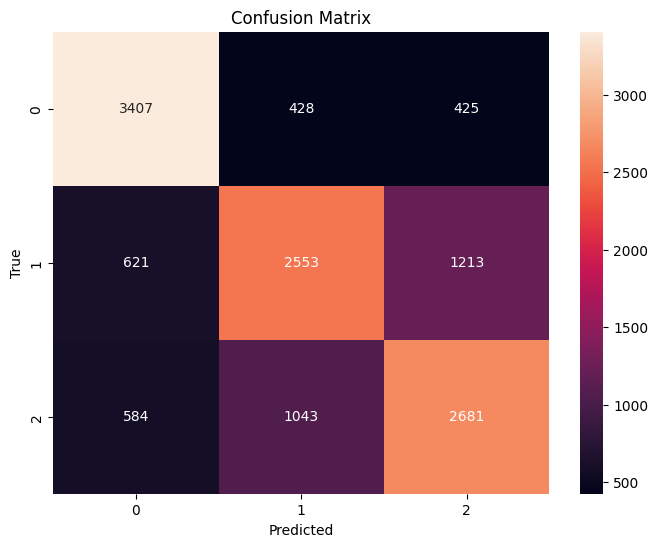

In [ ]:
# scaling, test size=0.2
best_model, X_train, X_test = logistic_classifier_w_kfold(5, final_df, True, 0.2)

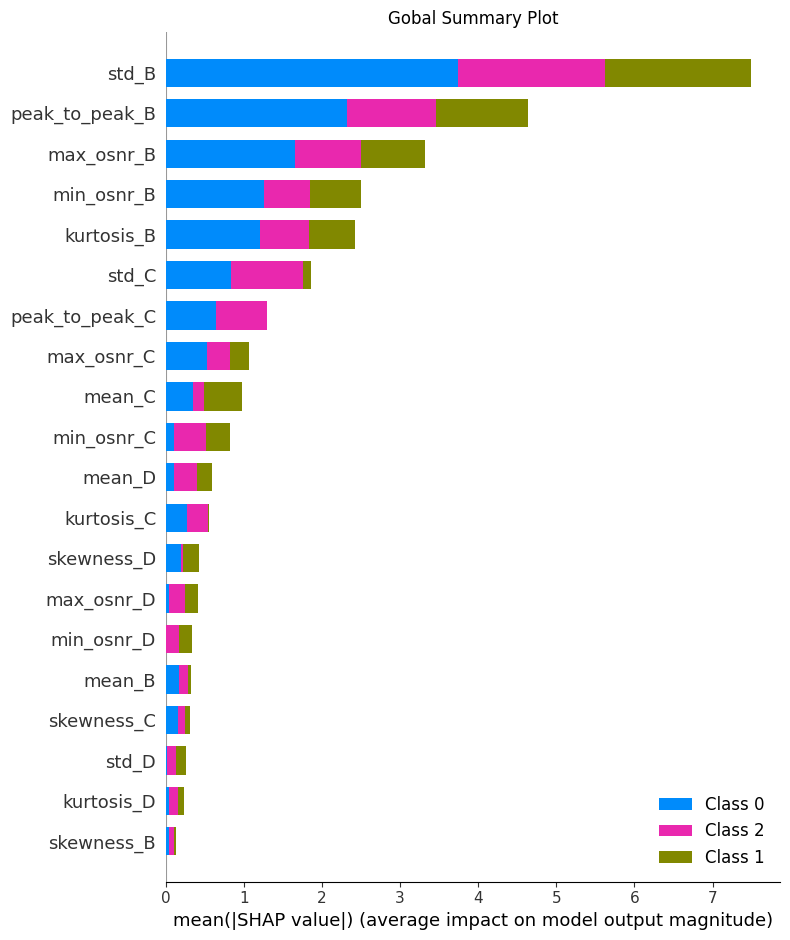

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


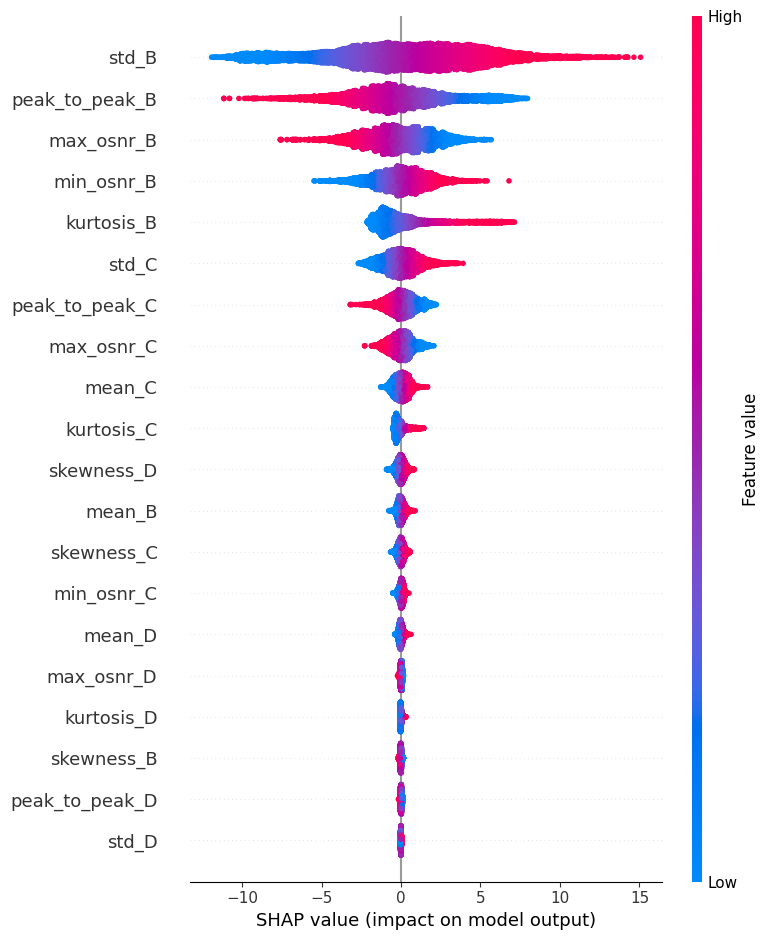

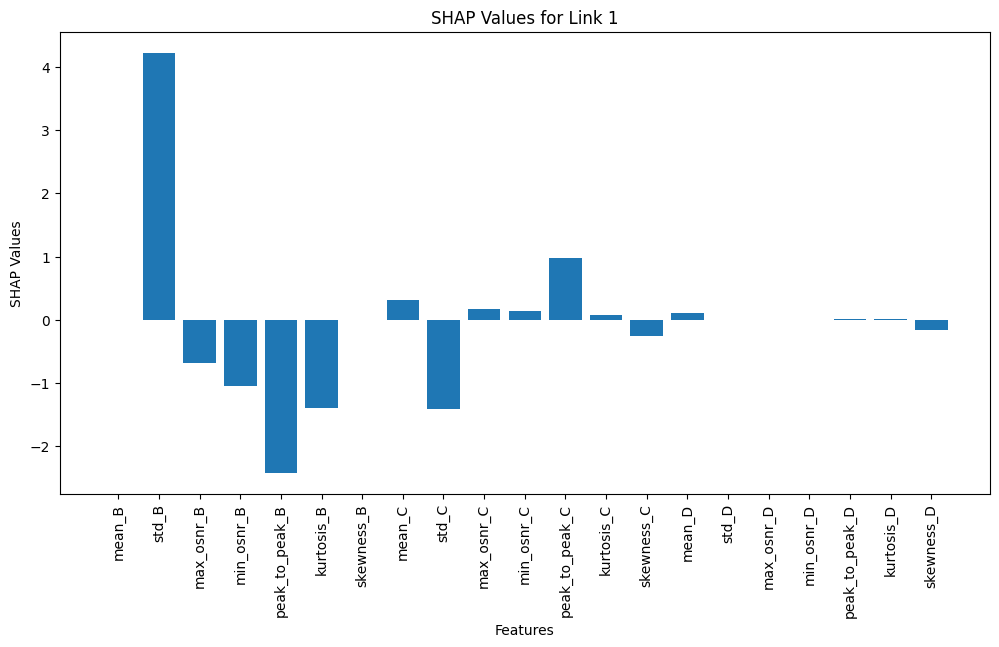

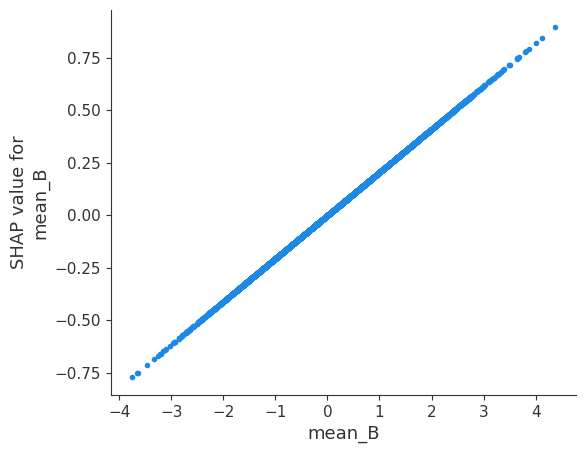

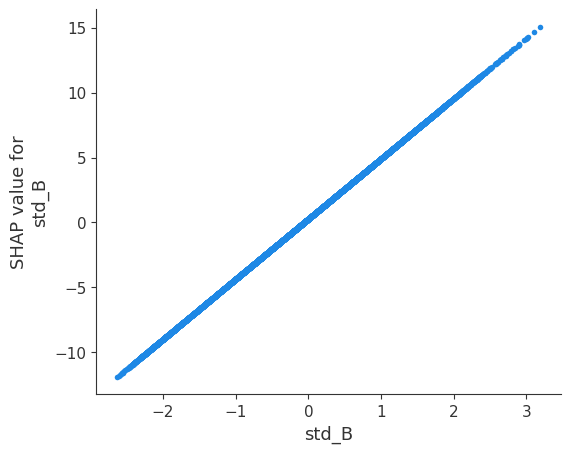

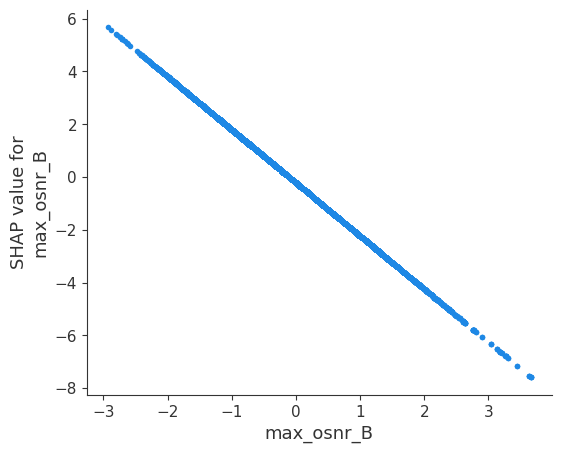

...

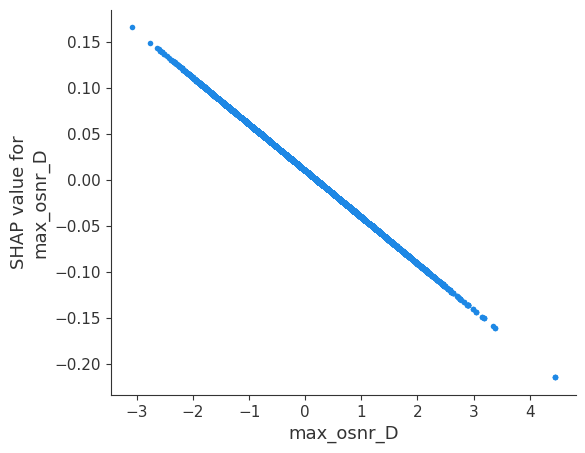

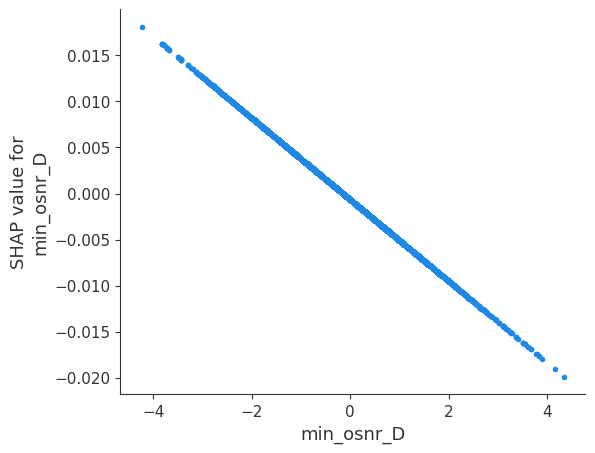

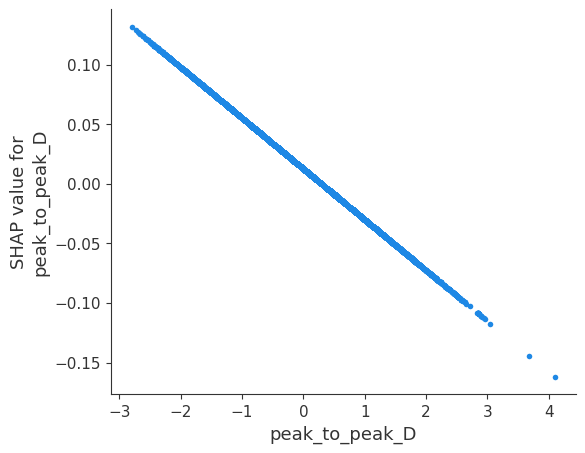

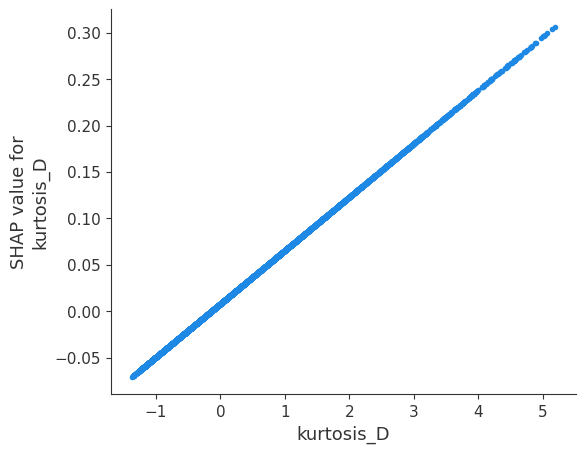

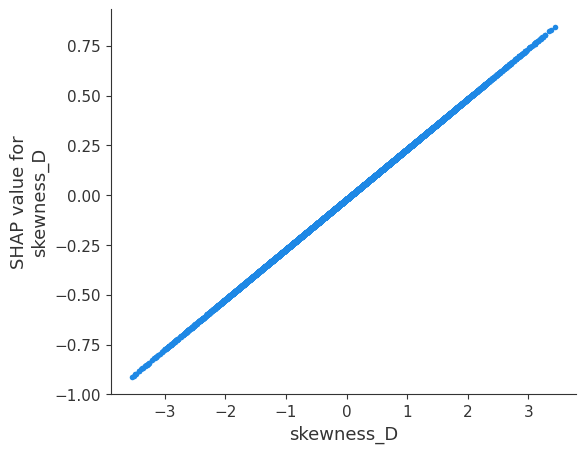

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


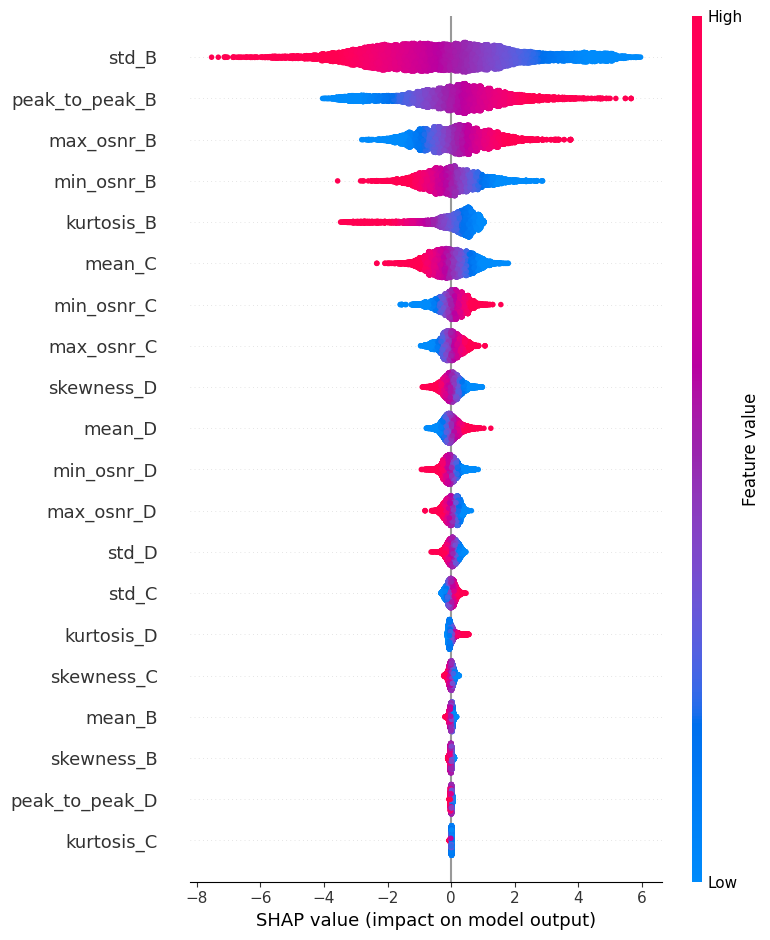

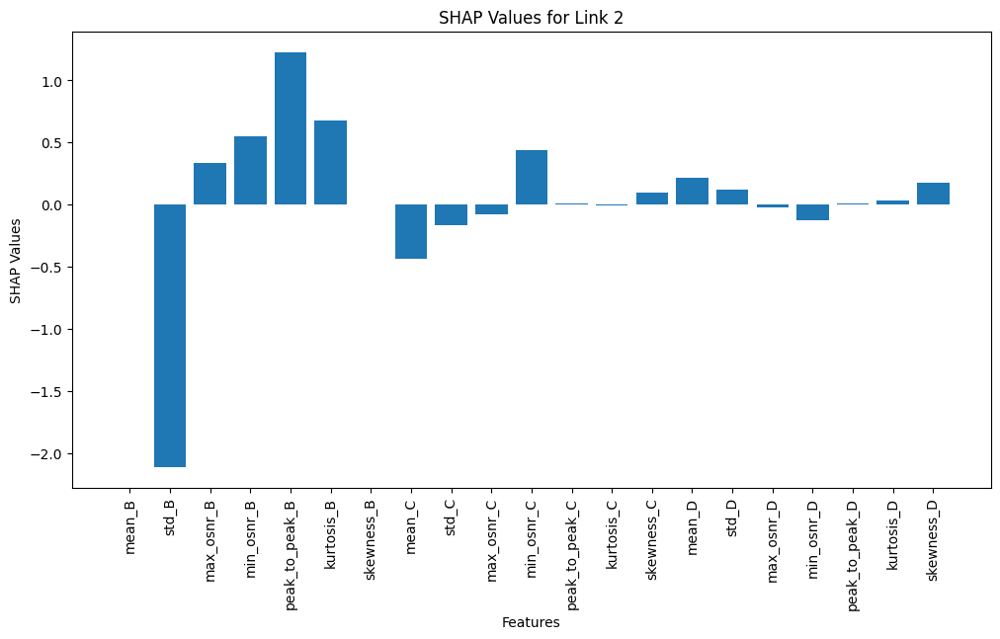

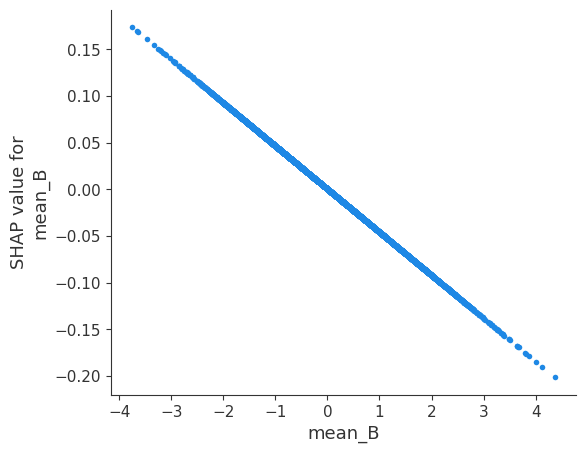

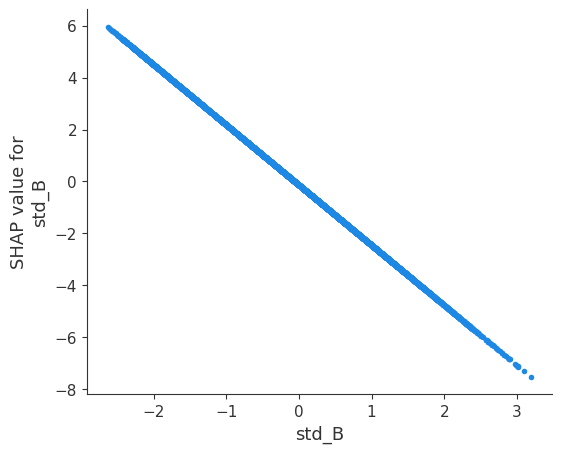

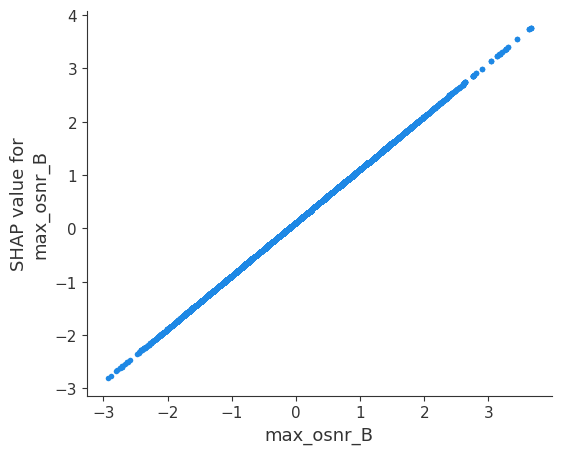

...

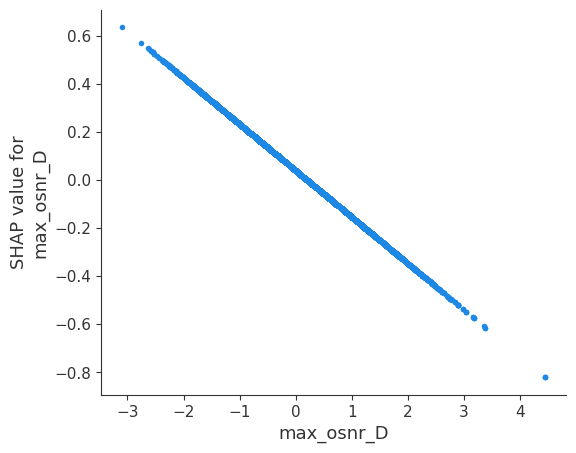

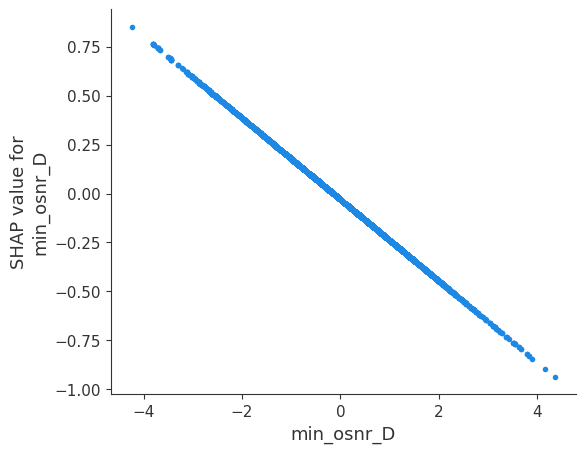

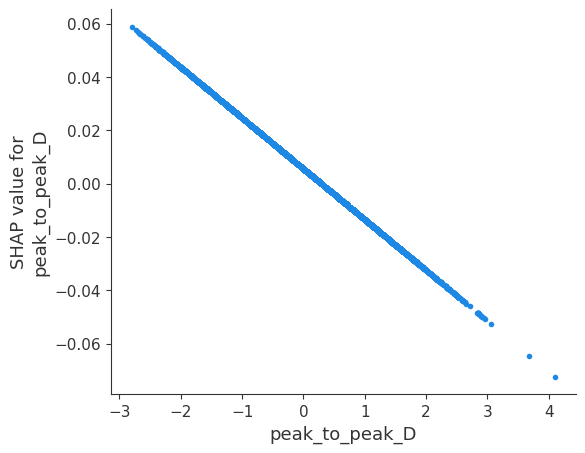

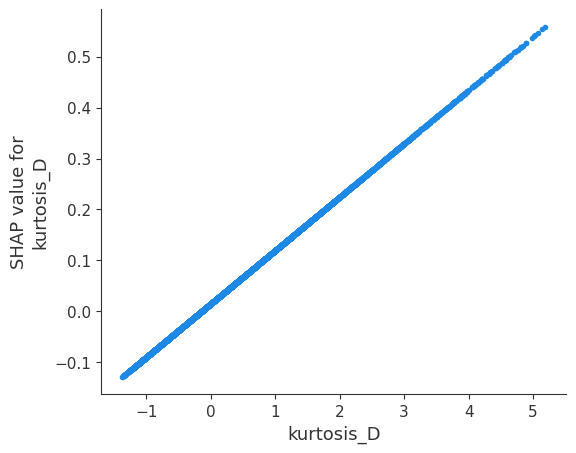

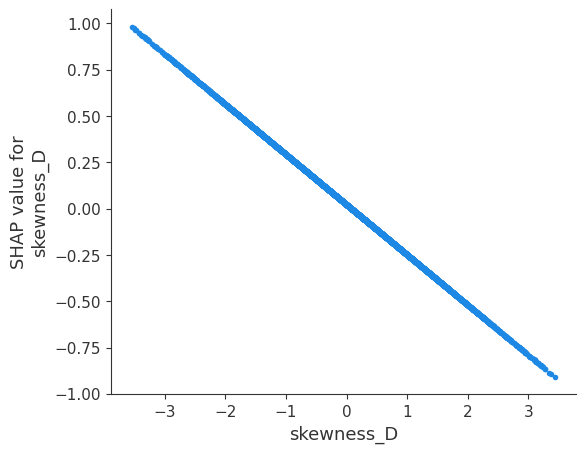

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


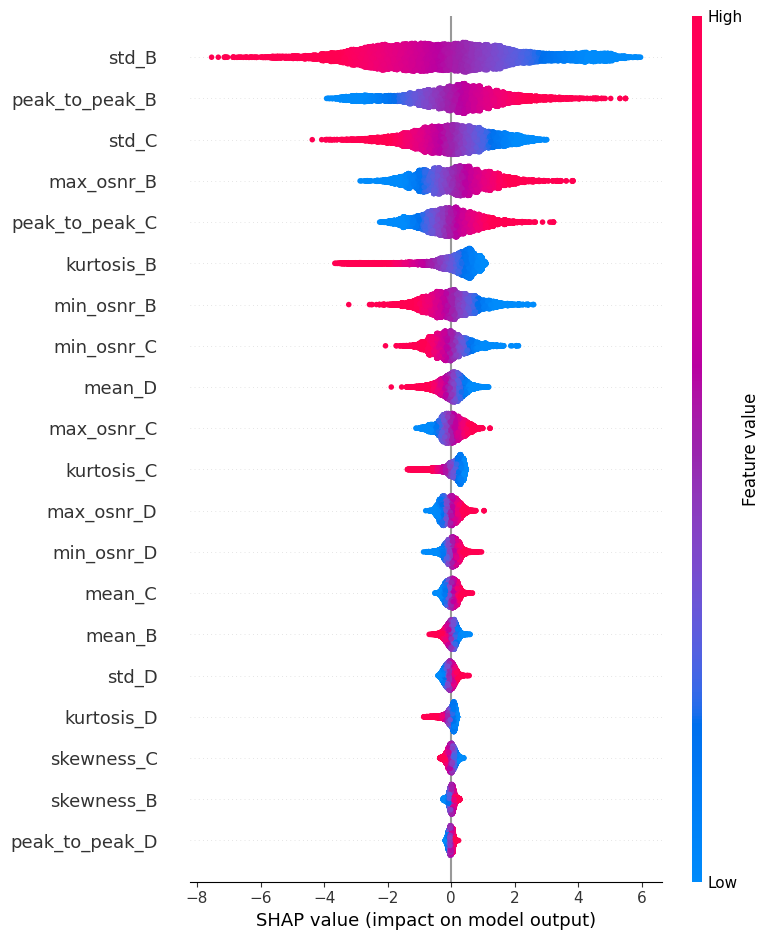

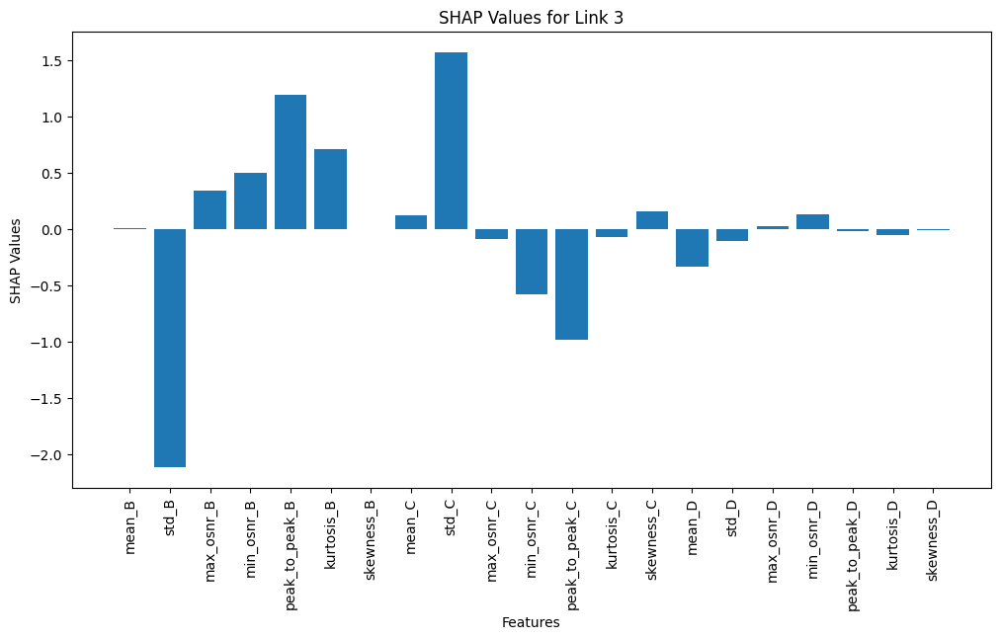

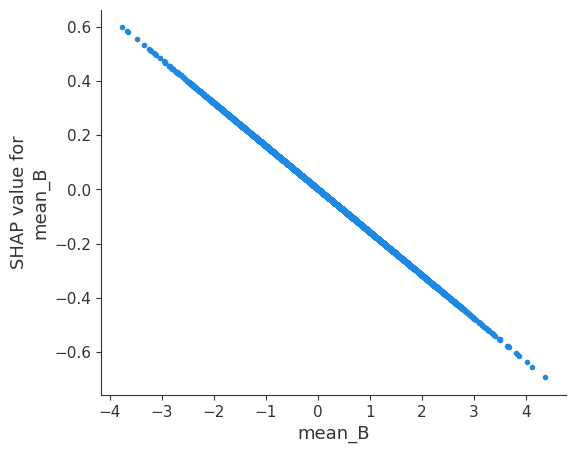

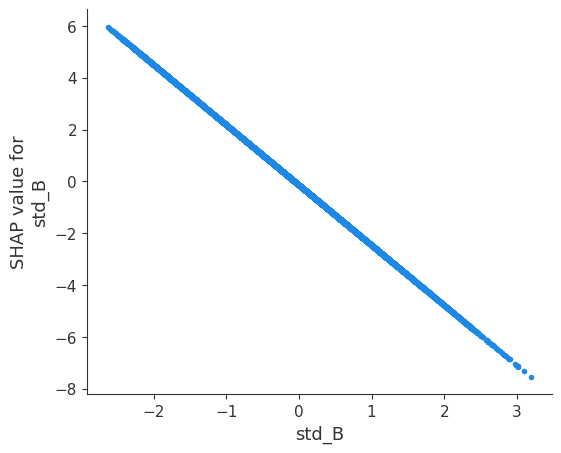

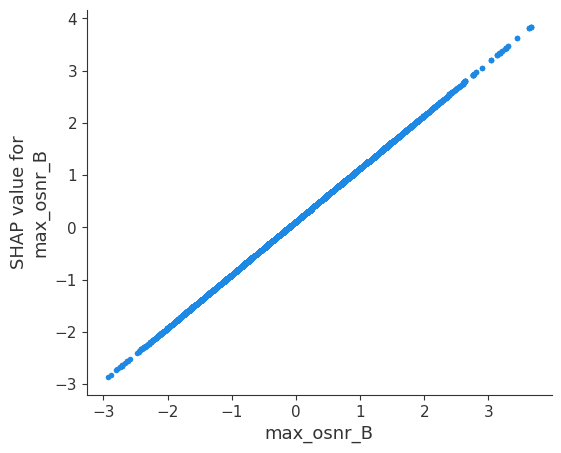

...

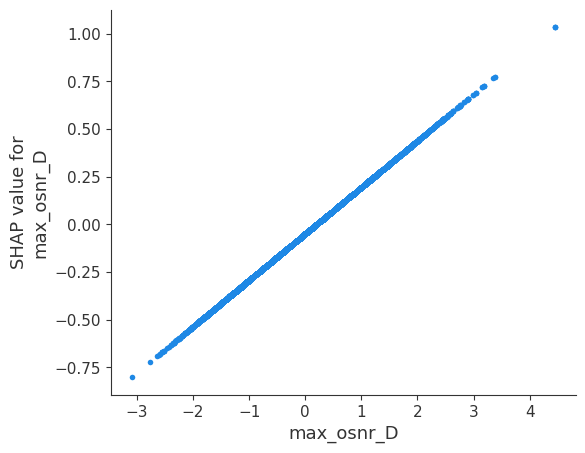

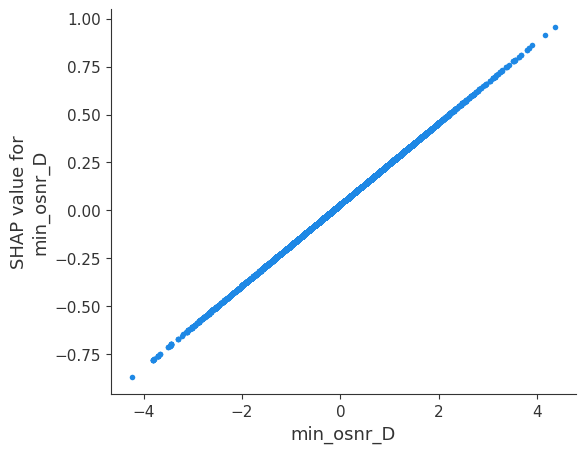

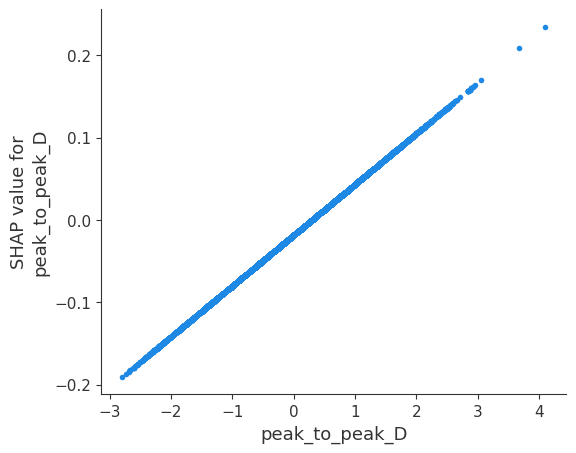

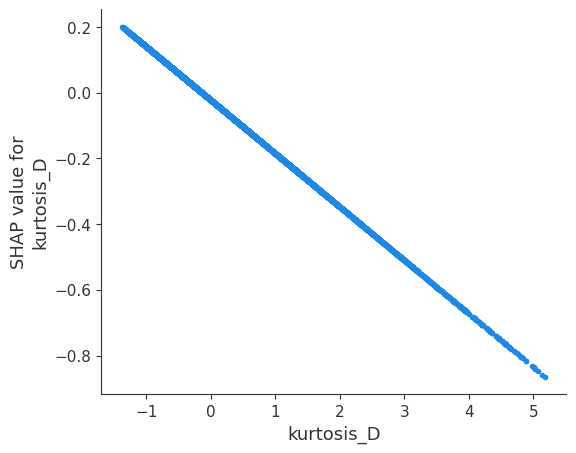

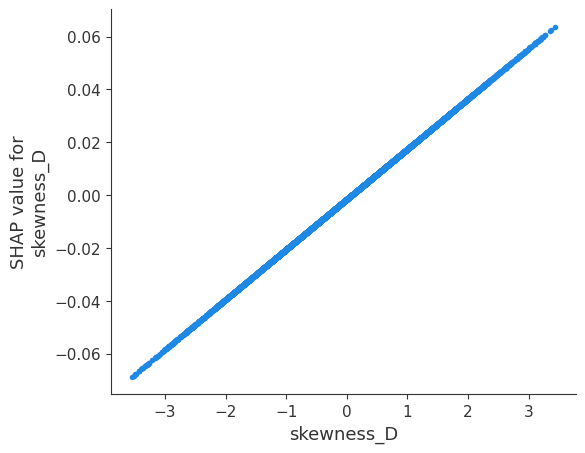

In [ ]:
shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test)


The SHAP global summary plot presents us insights into the impact of each feature on the model's output. This plot arranges on the y-axis the features ordered by their effect on the prediction. A bigger SHAP value, hence the higher the feature is on the y-axis, denotes a more significant impact on the model's output. Each bar is divided into colored segments representing the influence of the feature on the three different classes.
As we can see from the plot, the most impactful features come from node B. While features from the other nodes are also necessary, their impact is less compared to node B. This means that node B is a pivotal monitoring point for failure detection in this optical network.



#### Single Monitor

Average Train accuracy: 0.46968244913424995
Average Train mse: 1.1125667188804038
Average Train precision: 0.4680083177967728
Average Train recall: 0.46995540903837896
Average Train f1: 0.4646427853160479
Average Train duration: 0.38431801795959475
Average Test accuracy: 0.4751678888460054
******************************************
Best Test accuracy: 0.4761096101891162
Best Test MSE: 1.0974913160941722
Best Test precision: 0.47276177869608876
Best Test recall: 0.47497925884890496
Best Test f1: 0.4700225874054082


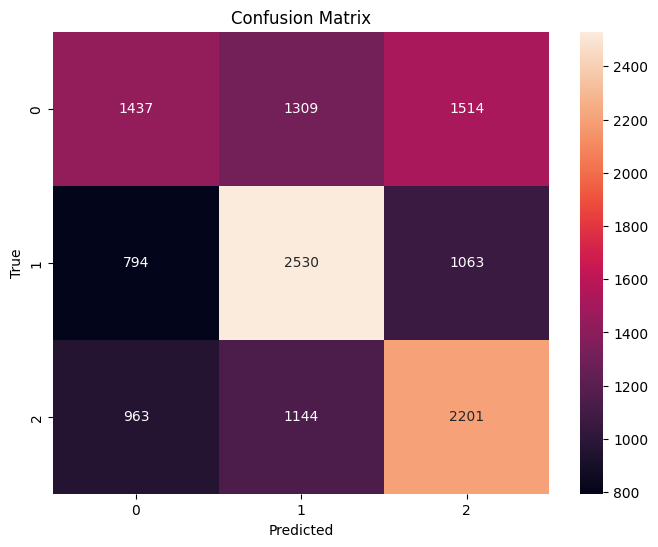

In [ ]:
# no scaling, test size=0.2
best_model, X_train, X_test = logistic_classifier_w_kfold(5, final_one_node_df, False, 0.2)

Average Train accuracy: 0.46958595198091596
Average Train mse: 1.1123737525061421
Average Train precision: 0.4679166922202941
Average Train recall: 0.46985907527954546
Average Train f1: 0.4645393721196104
Average Train duration: 0.4392250537872314
Average Test accuracy: 0.4751215746815901
******************************************
Best Test accuracy: 0.4758008490930143
Best Test MSE: 1.0975685063681977
Best Test precision: 0.4724340950966561
Best Test recall: 0.4746680134750834
Best Test f1: 0.4696886989150591


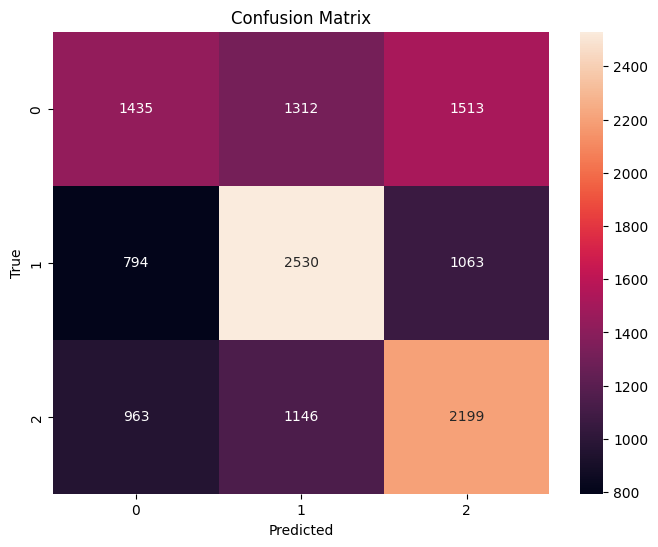

In [ ]:
# scaling, test size=0.2
best_model, X_train, X_test = logistic_classifier_w_kfold(5, final_one_node_df, True, 0.2)

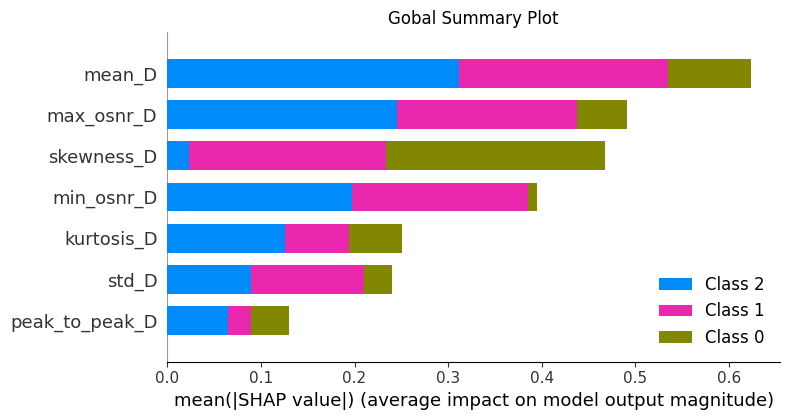

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


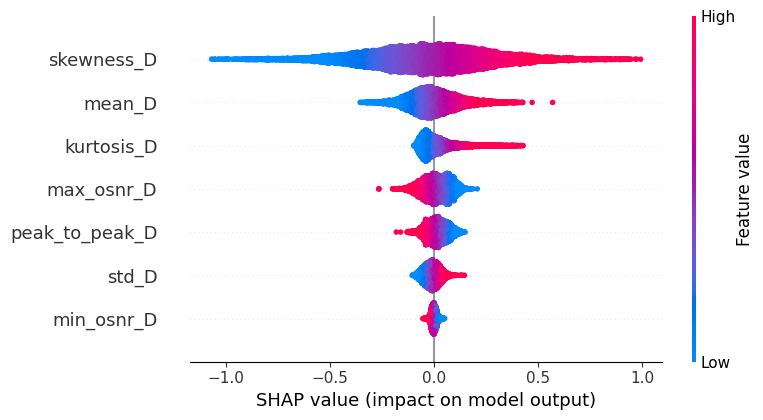

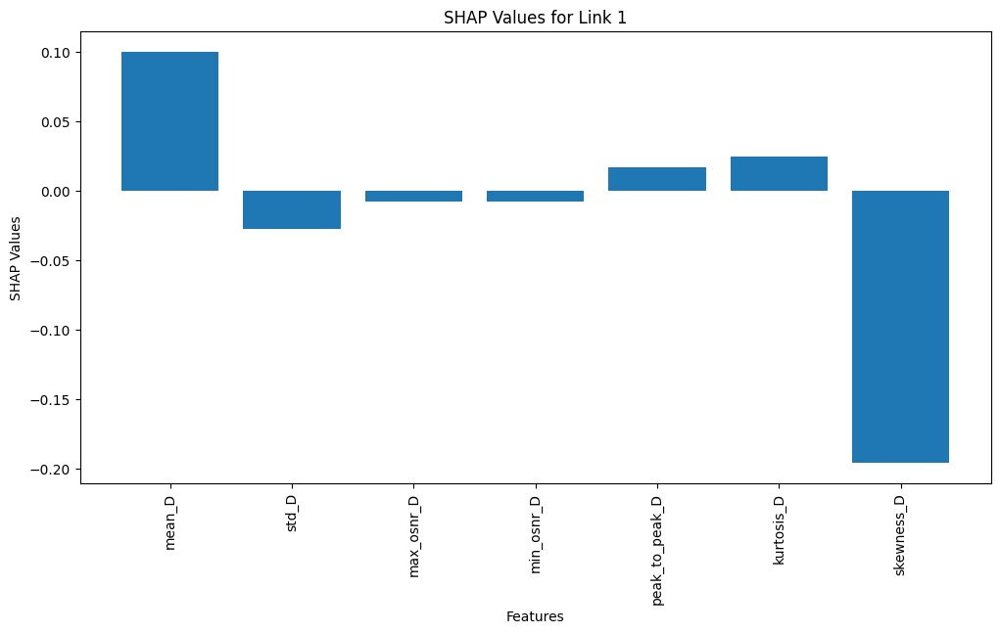

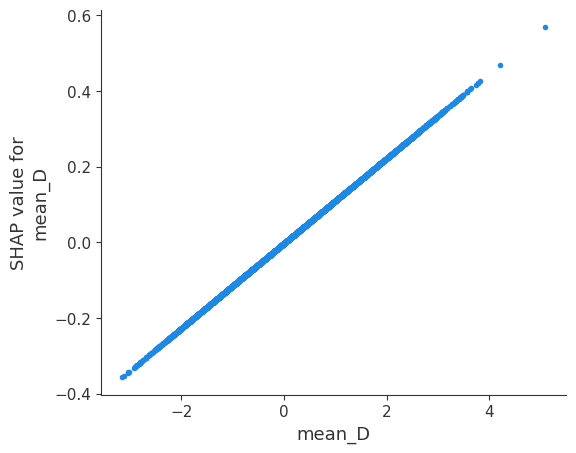

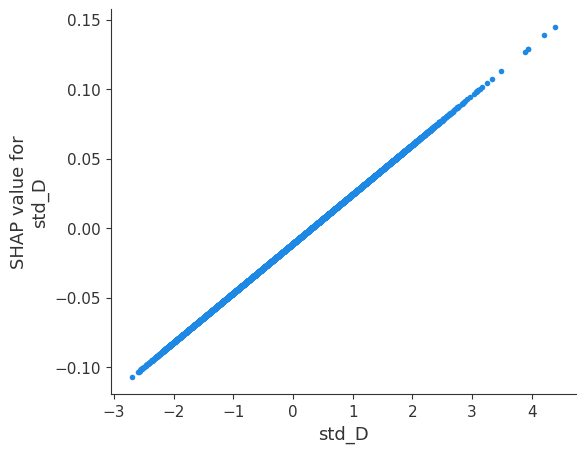

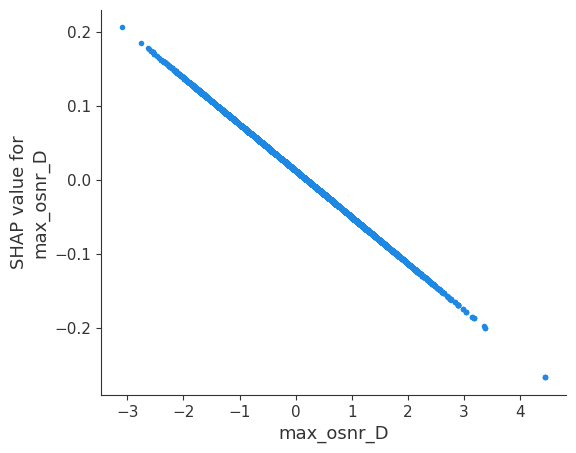

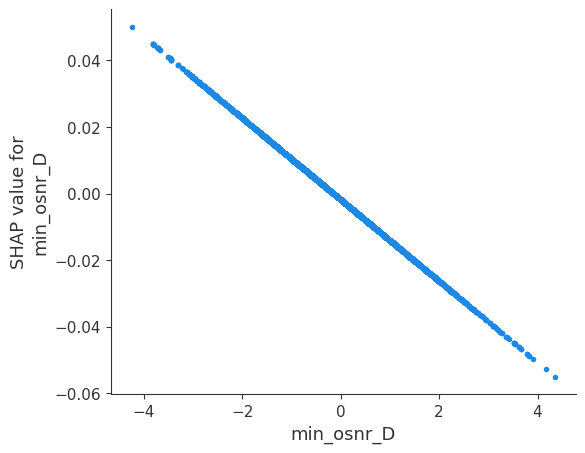

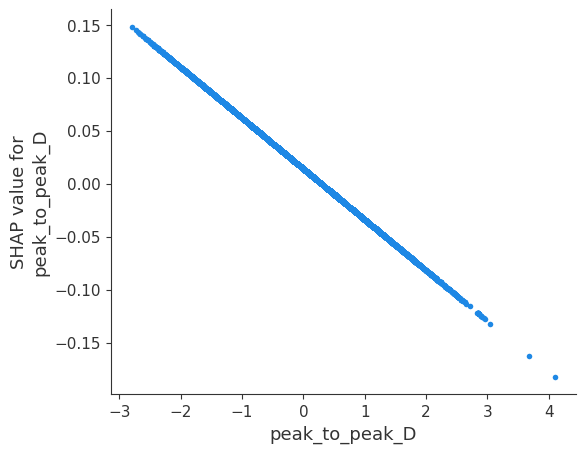

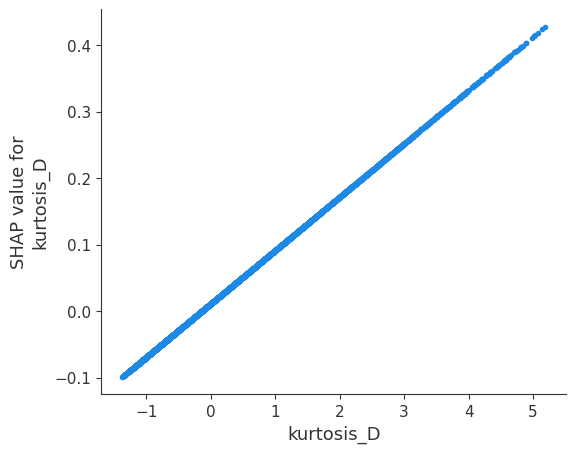

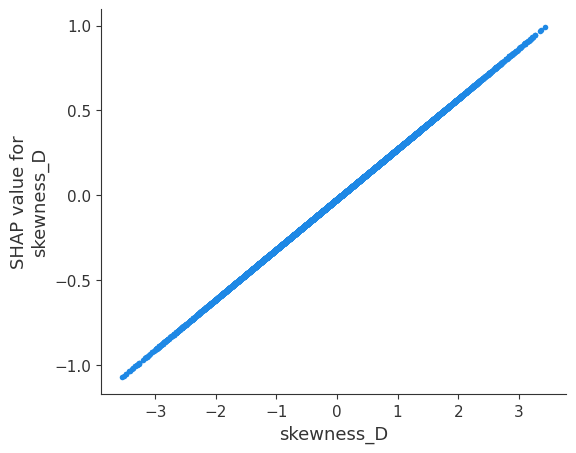

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


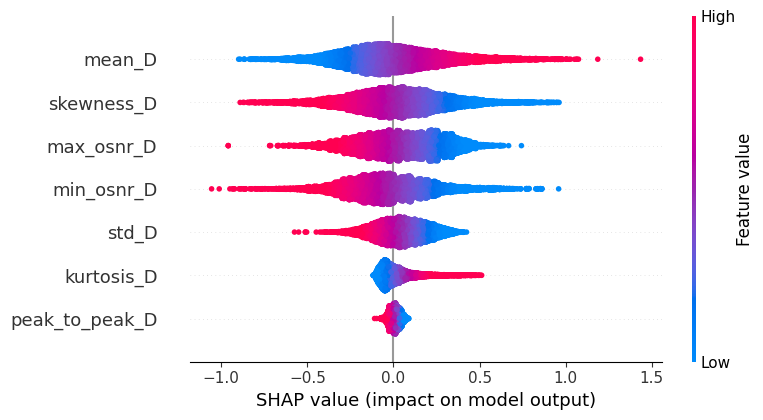

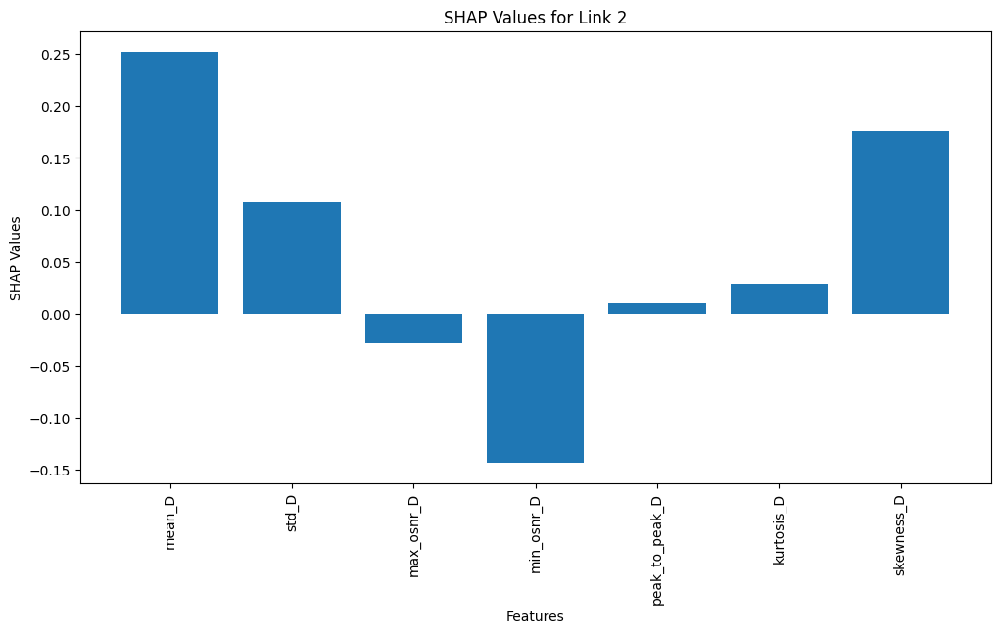

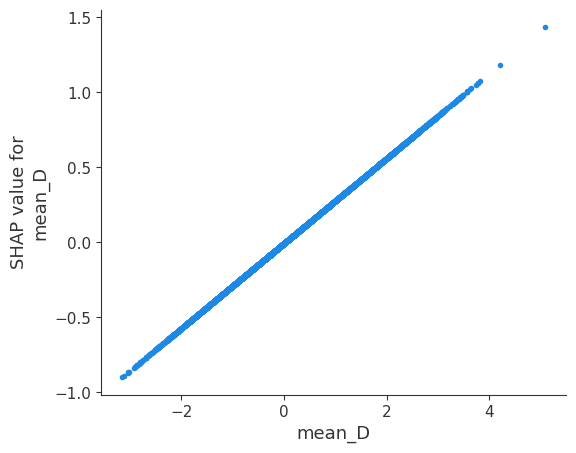

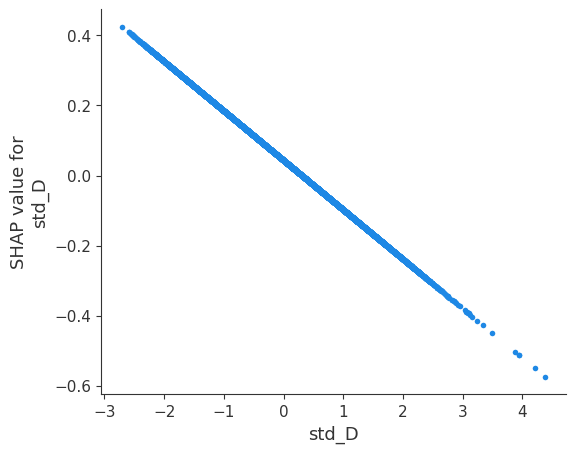

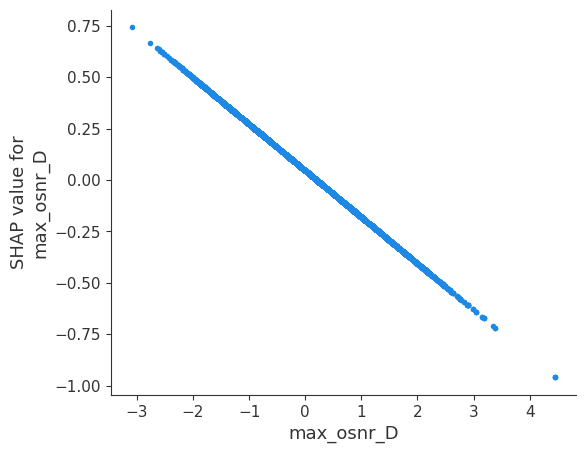

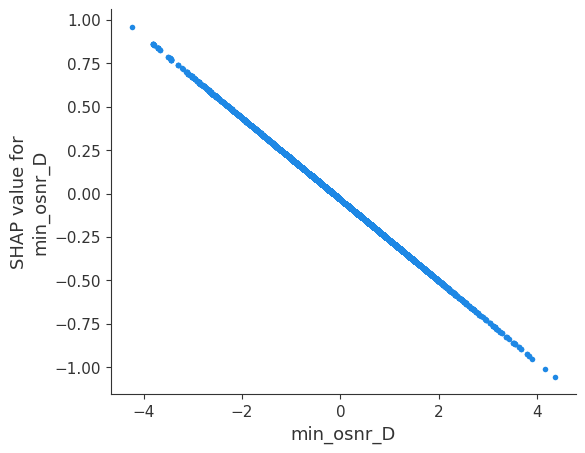

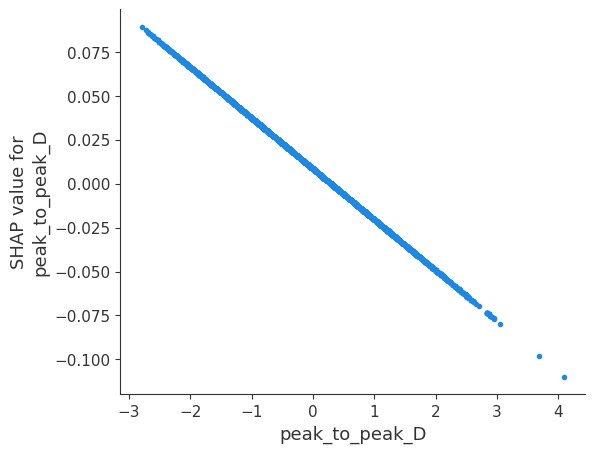

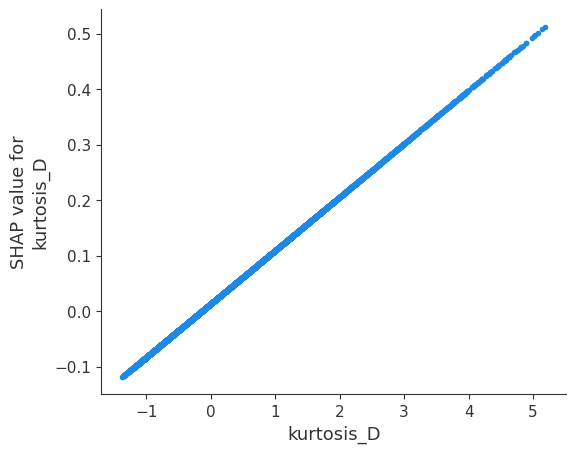

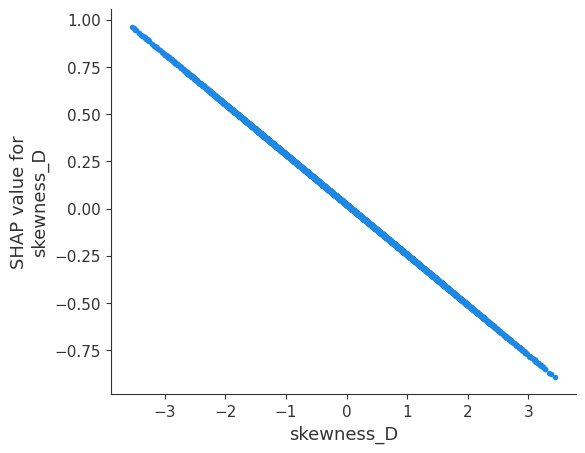

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


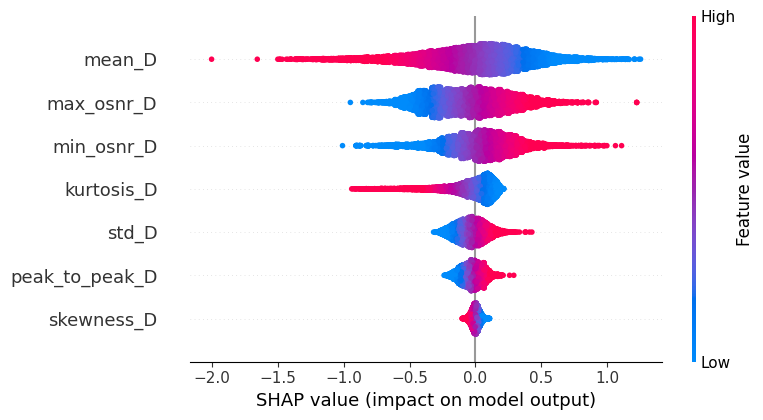

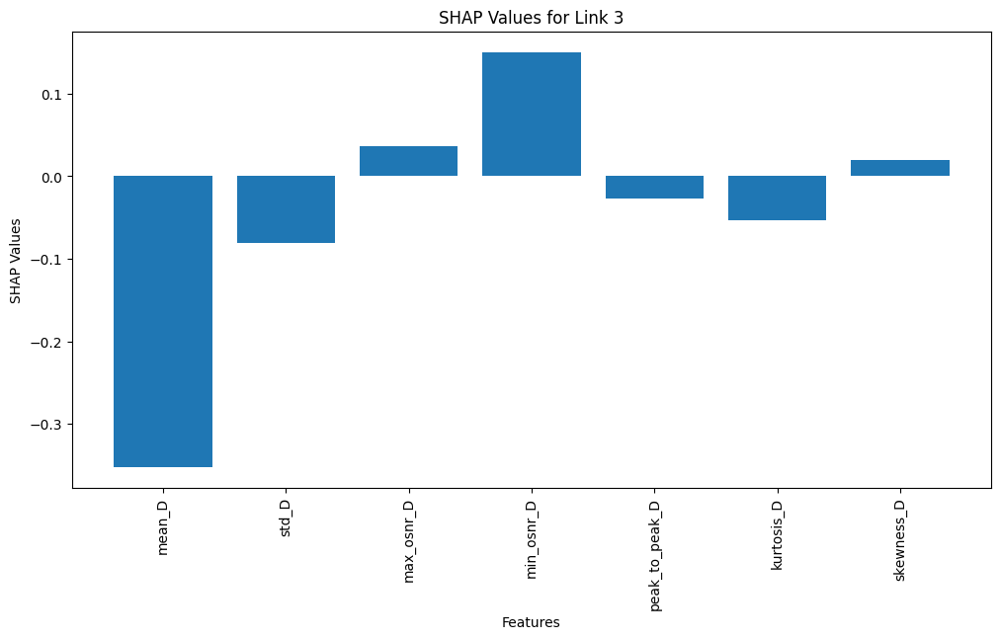

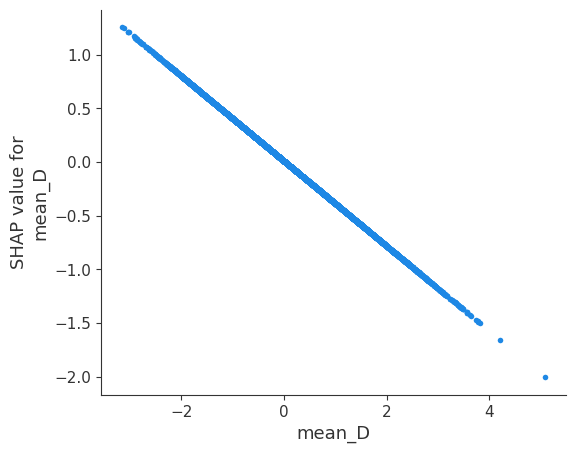

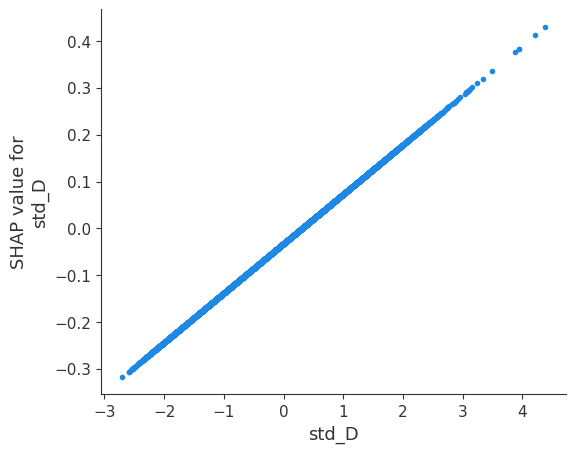

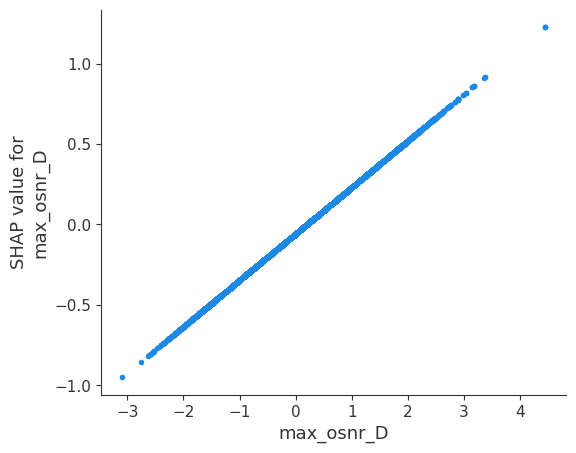

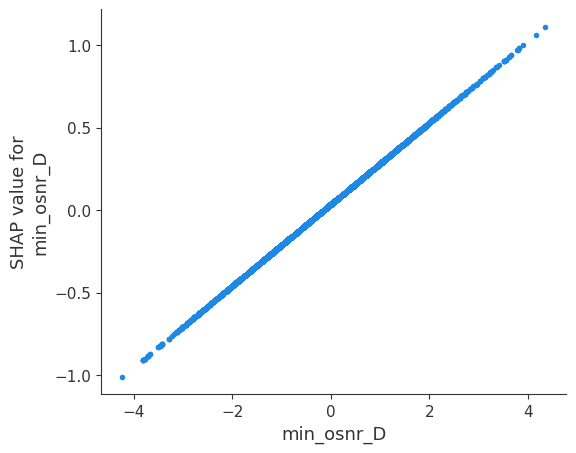

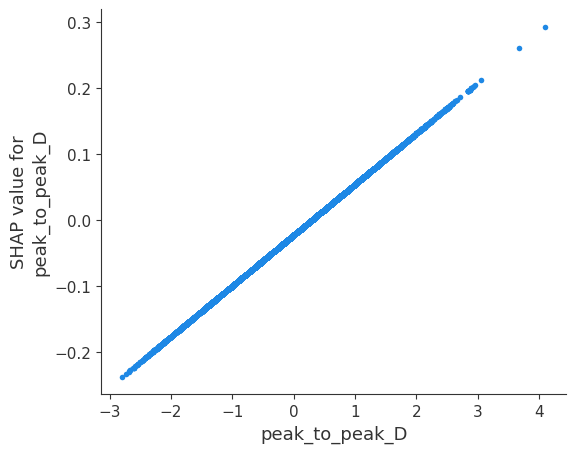

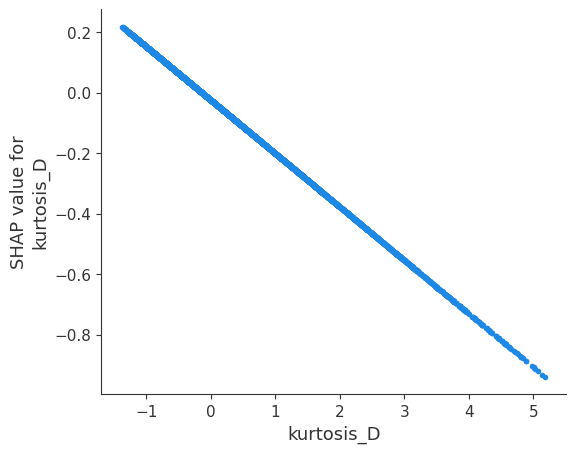

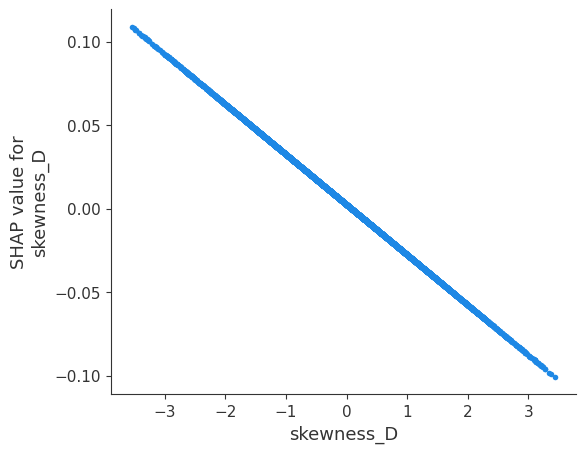

In [ ]:
shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test)

#### Bigger window sizes and spacing

We can appreciate an overall performance improvement with an increased window size and spacing.
Indeed, we can capture more information about the signal's behavior over a longer period using a larger window size. This allows a more robust calculation of statistical features, better representing the underlying patterns and anomalies. Moreover, with a spacing of 25, there is less overlap between consecutive windows., reducing redundancy and noise in the features.

#### Multiple Monitor

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


Average Train accuracy: 0.8896375057023548
Average Train mse: 0.14231322595360915
Average Train precision: 0.8905049813686275
Average Train recall: 0.8894698652935699
Average Train f1: 0.8895893033004743
Average Train duration: 0.08277745246887207
Average Test accuracy: 0.9106382978723404
******************************************
Best Test accuracy: 0.9148936170212766
Best Test MSE: 0.10251450676982592
Best Test precision: 0.9167487763518883
Best Test recall: 0.9158464043079428
Best Test f1: 0.9158326368753823


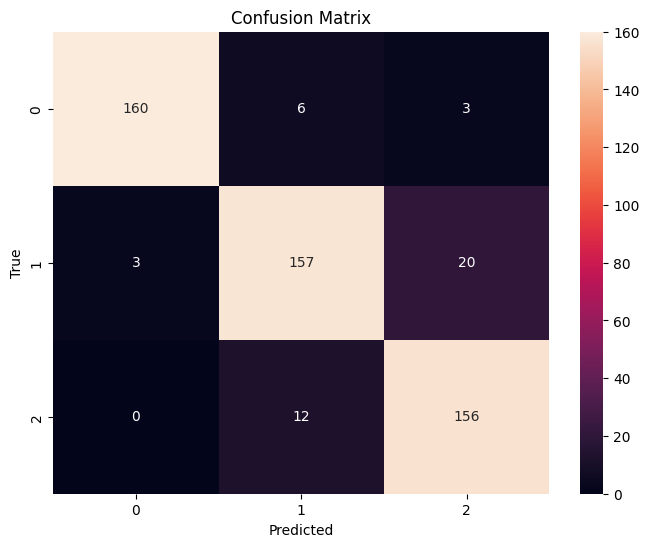

In [ ]:
# no scaling, test Size=0.2
best_model, X_train, X_test = logistic_classifier_w_kfold(5, new_final_df, False, 0.2)

Average Train accuracy: 0.8925442444233896
Average Train mse: 0.13939595980863484
Average Train precision: 0.8936125486584647
Average Train recall: 0.8924041933962676
Average Train f1: 0.8926023724528178
Average Train duration: 0.029768991470336913
Average Test accuracy: 0.9148936170212766
******************************************
Best Test accuracy: 0.9245647969052224
Best Test MSE: 0.08704061895551257
Best Test precision: 0.9251647052198885
Best Test recall: 0.9253232522463292
Best Test f1: 0.9251782216348458


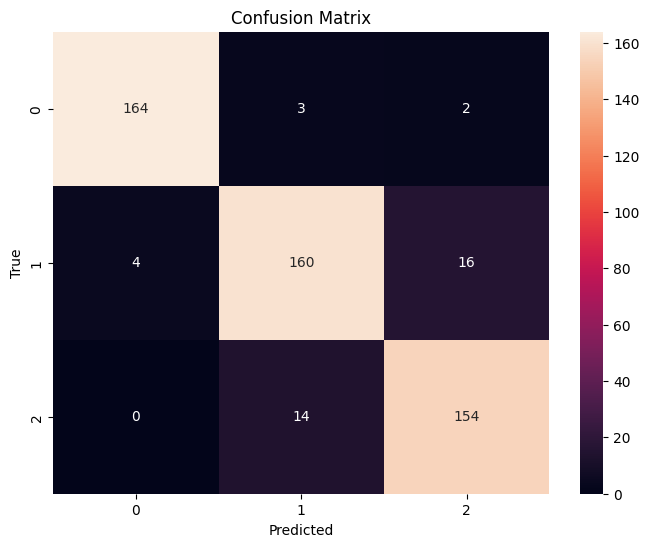

In [ ]:
# scaling, test Size=0.2
best_model, X_train, X_test = logistic_classifier_w_kfold(5, new_final_df, True, 0.2)

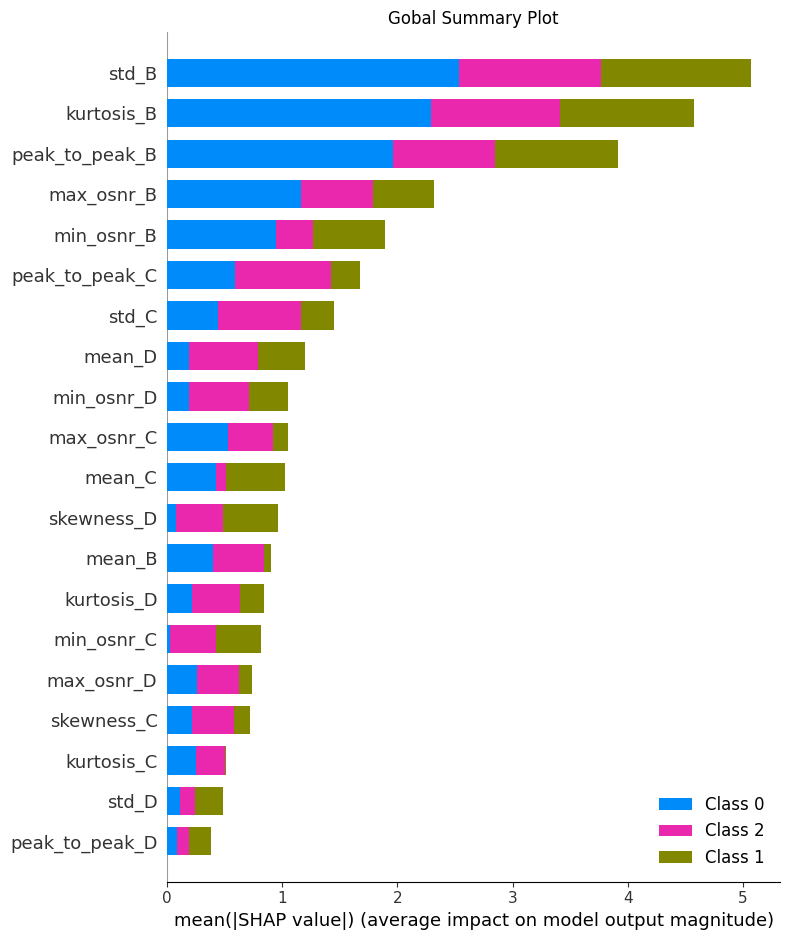

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


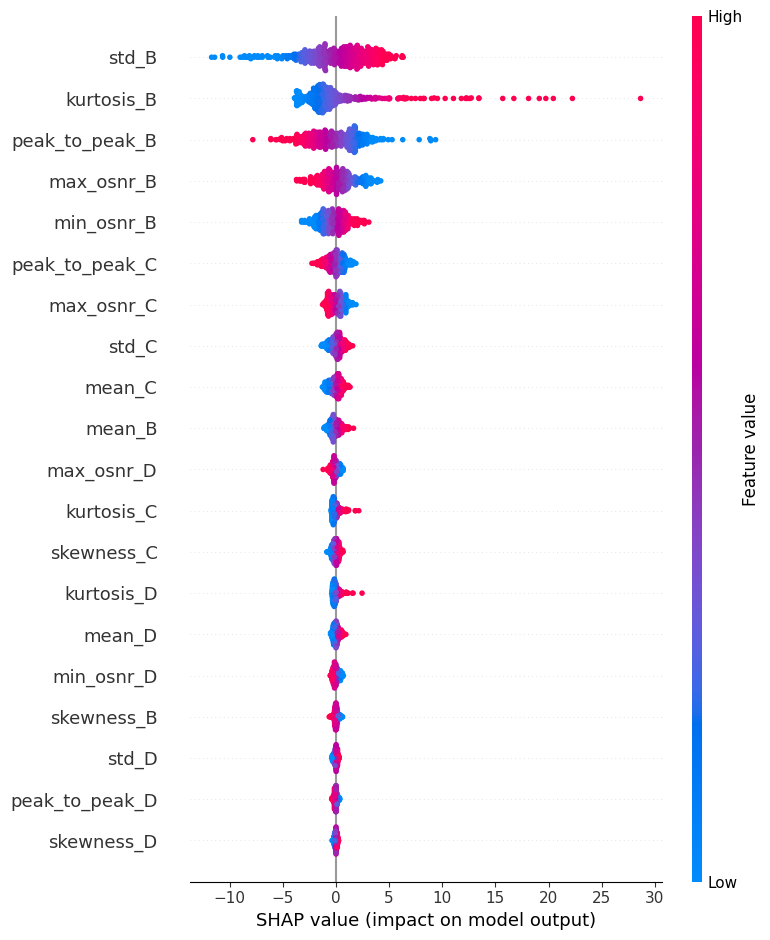

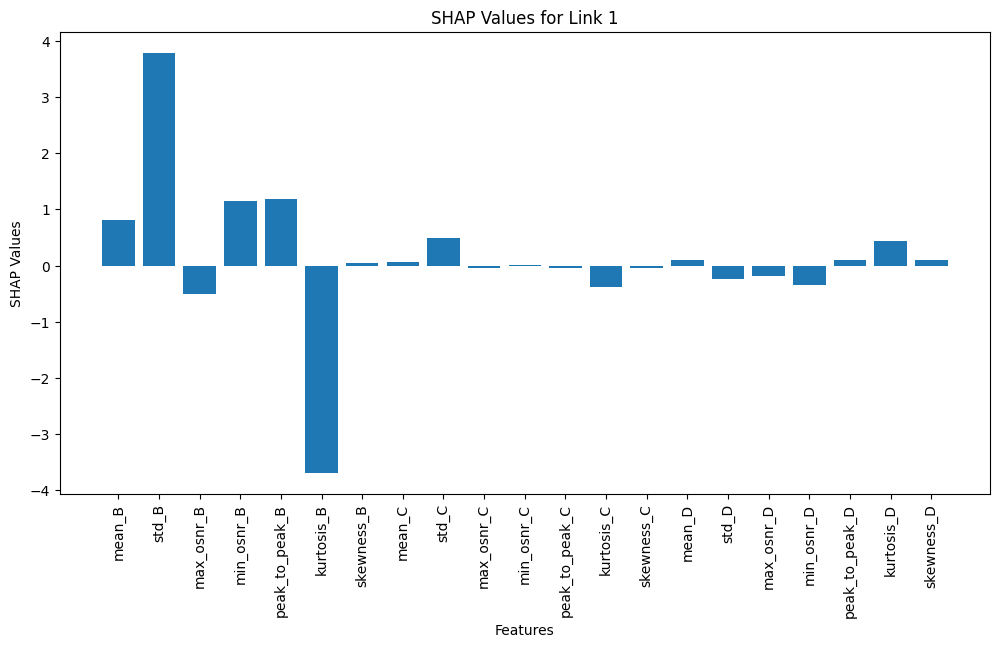

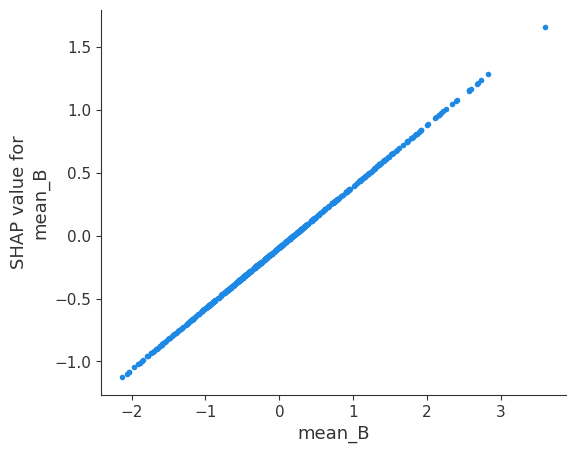

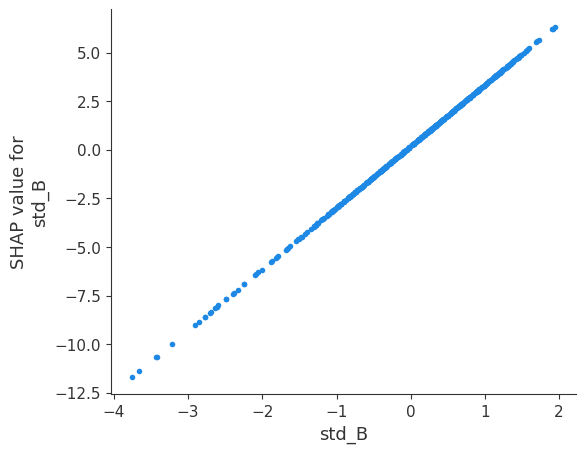

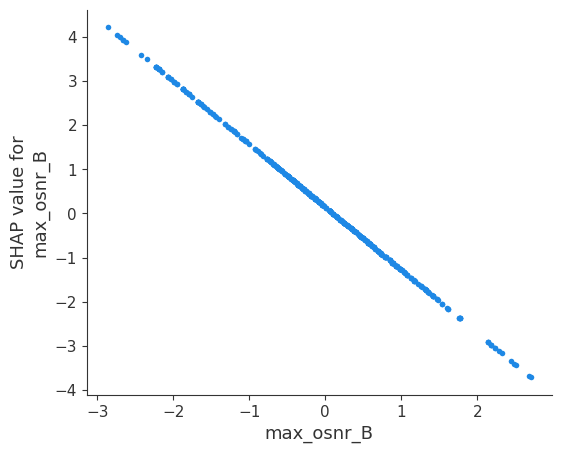

...

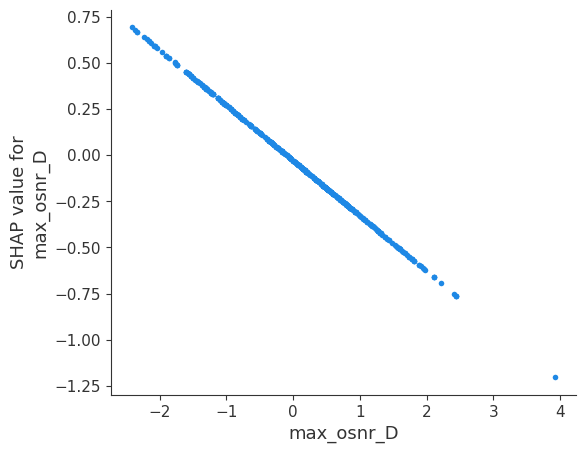

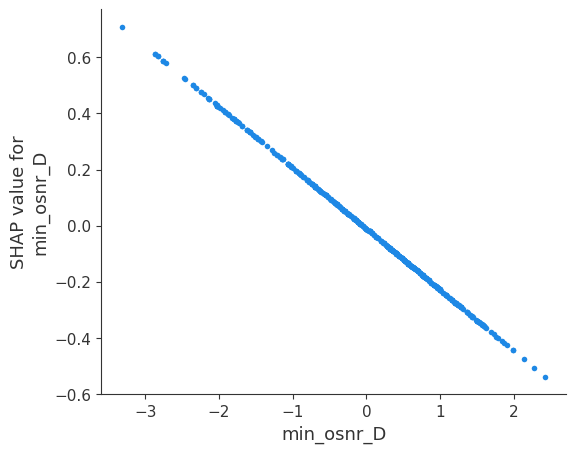

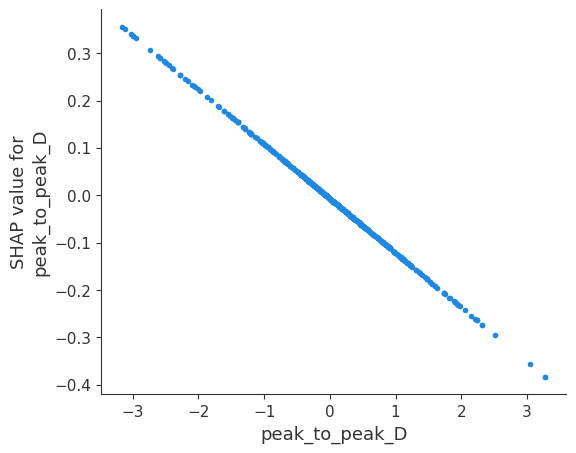

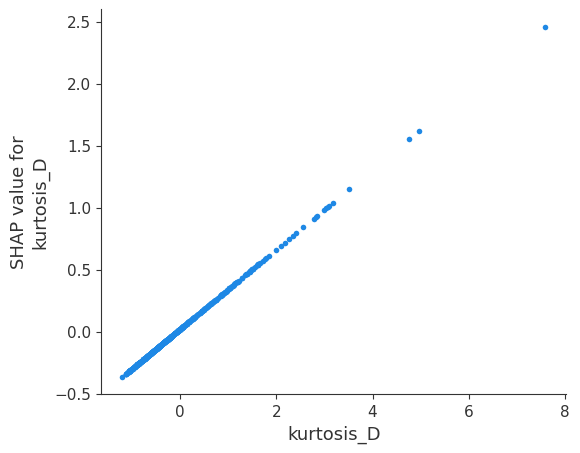

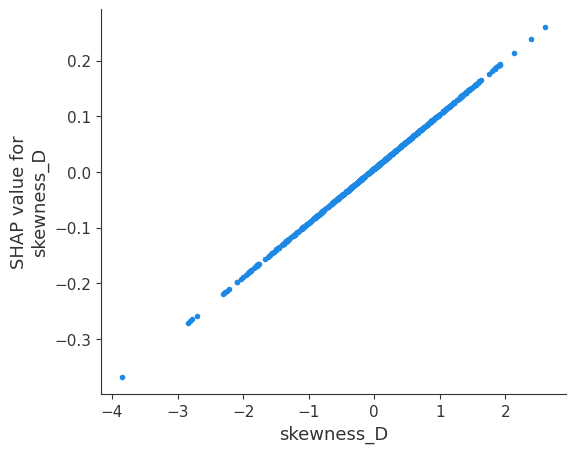

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


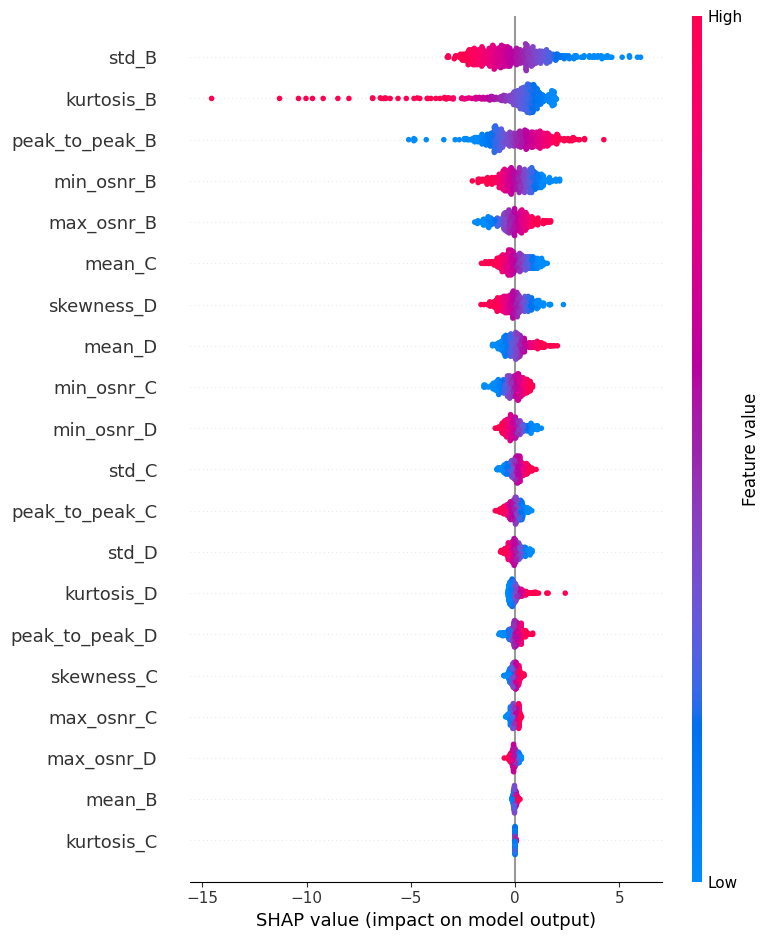

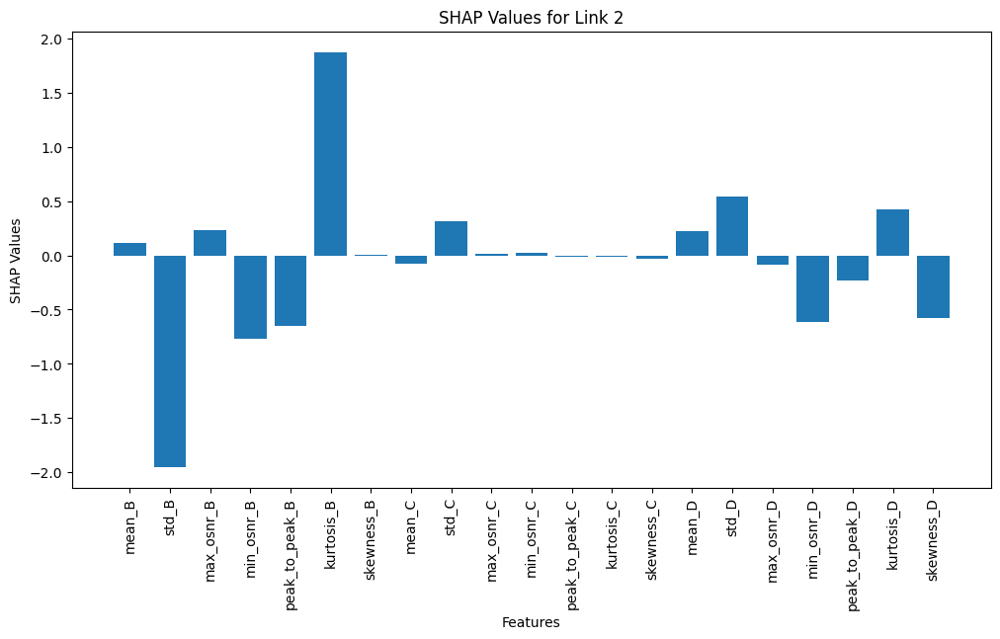

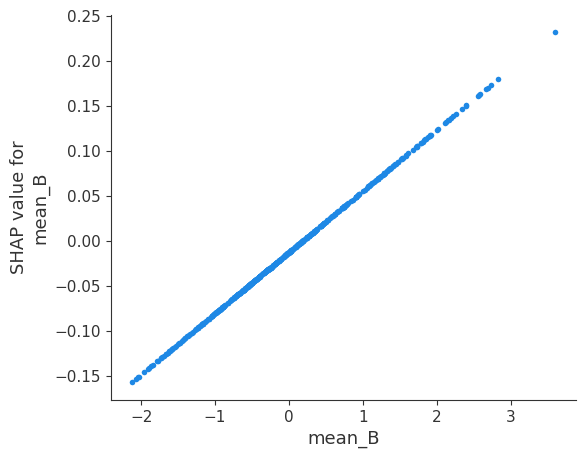

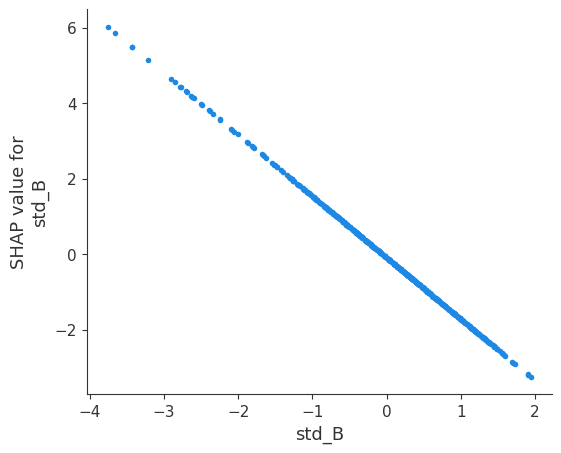

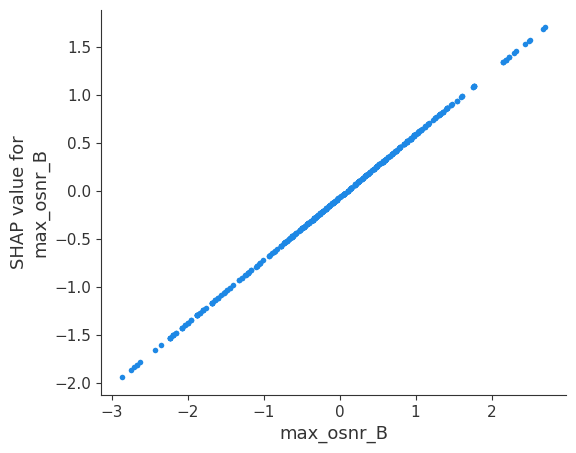

...

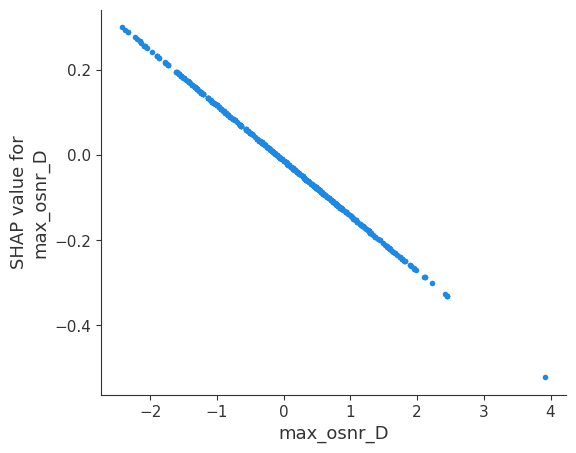

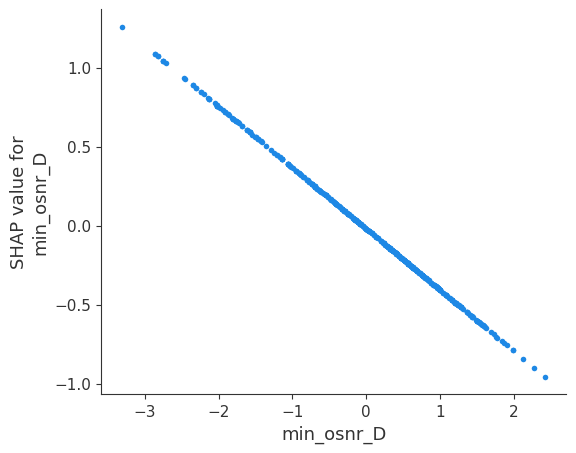

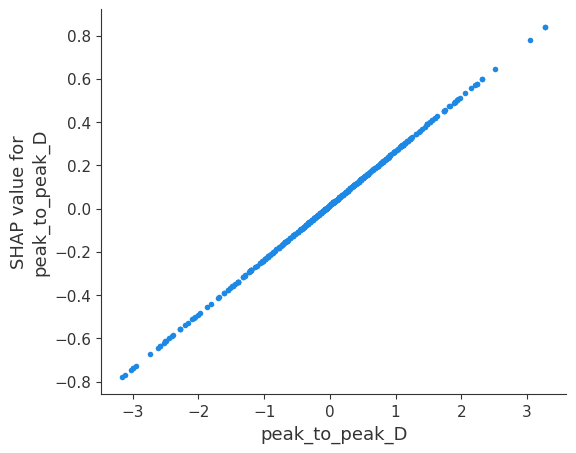

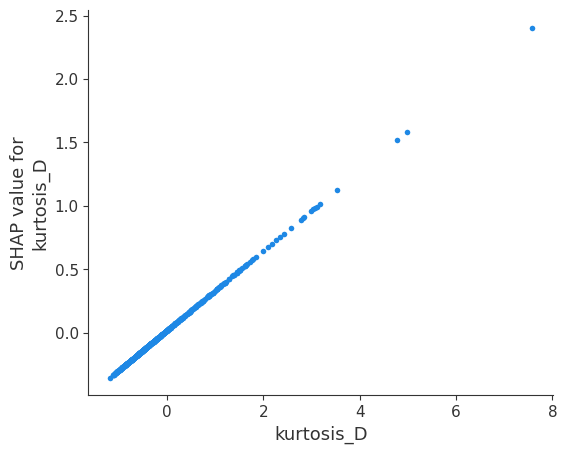

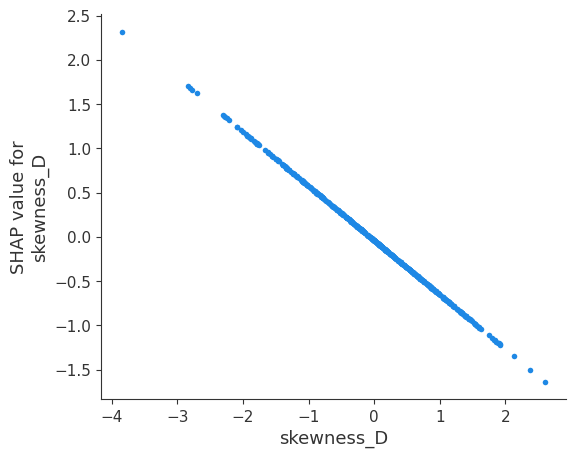

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


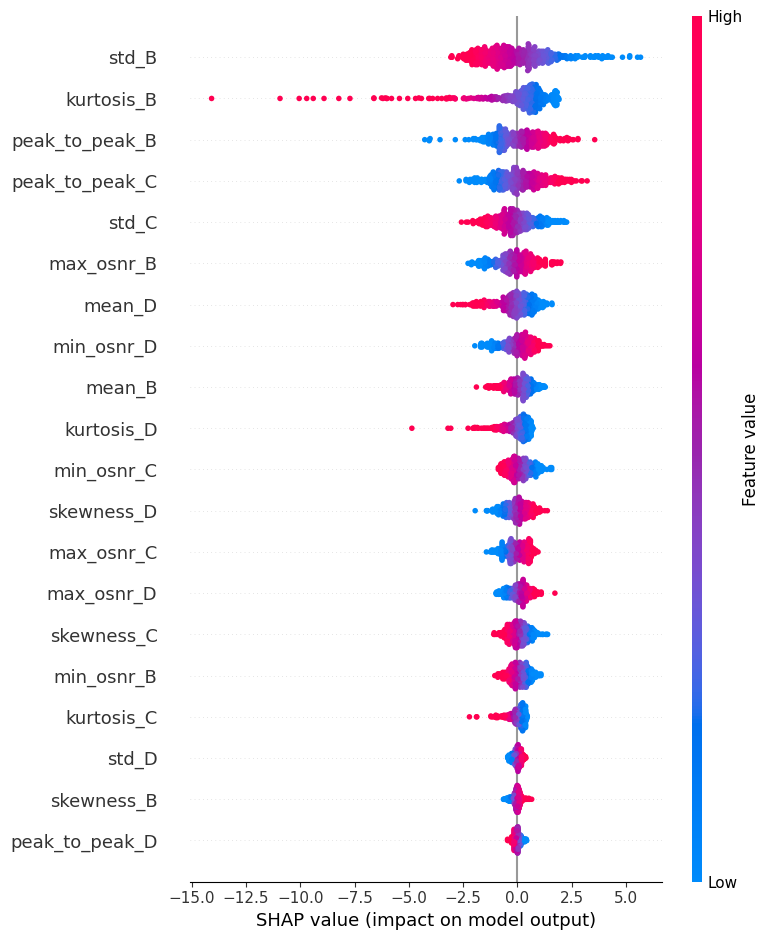

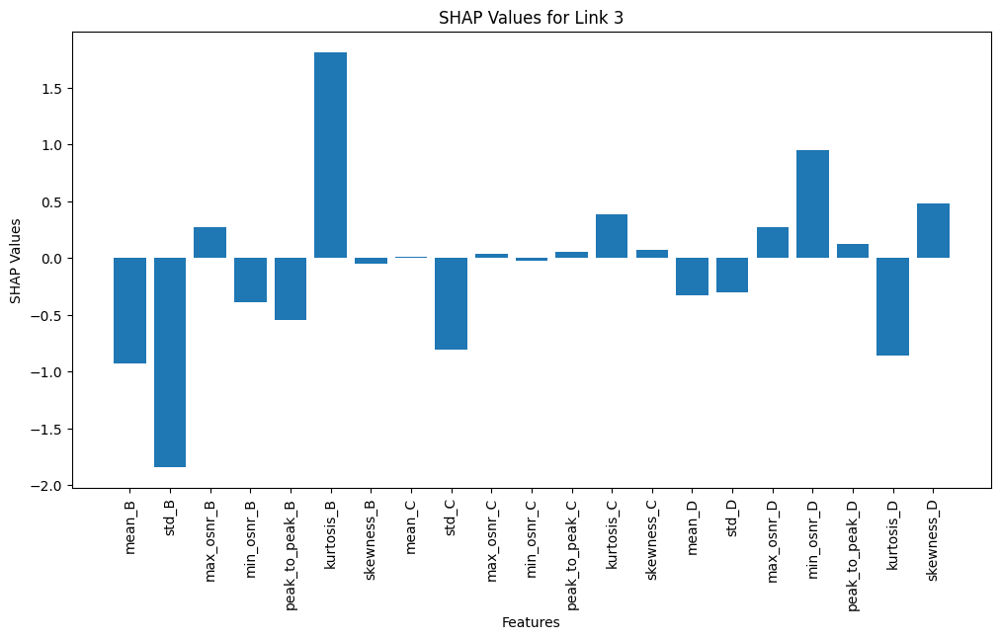

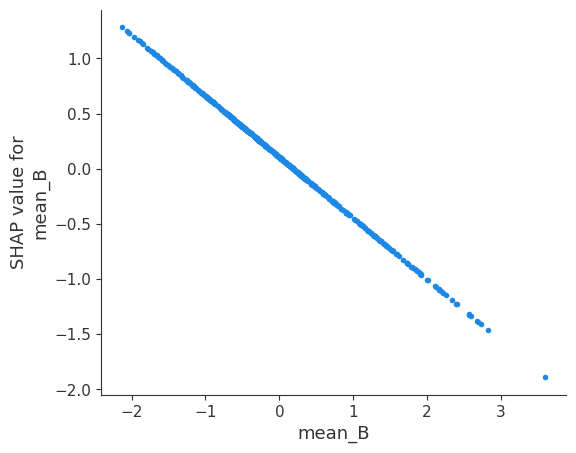

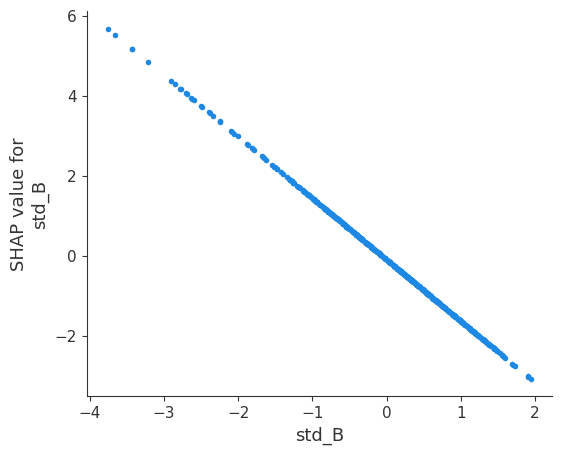

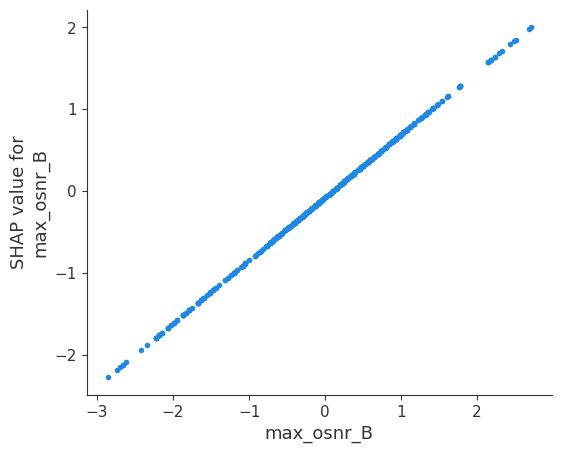

...

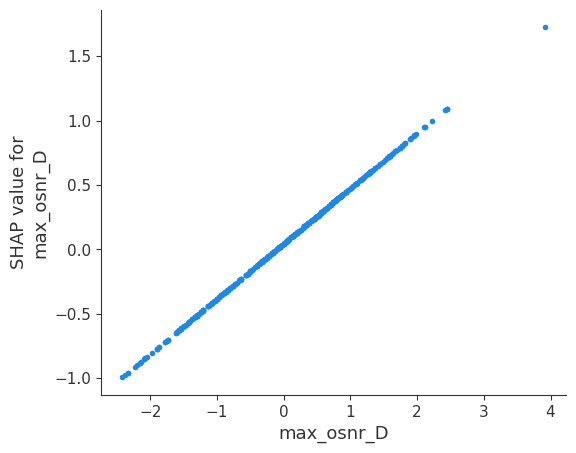

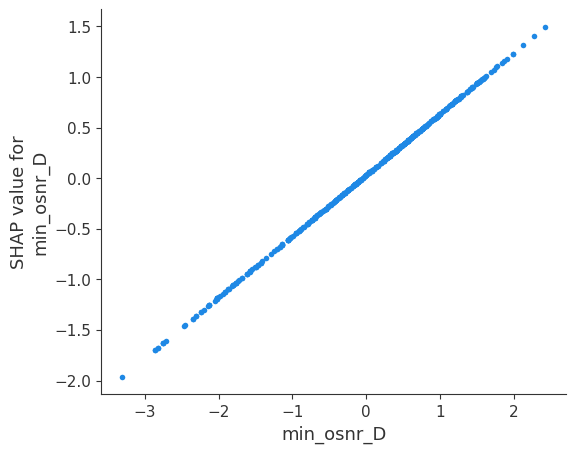

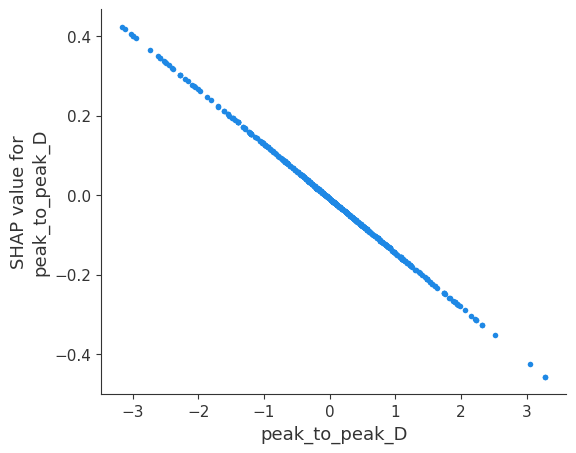

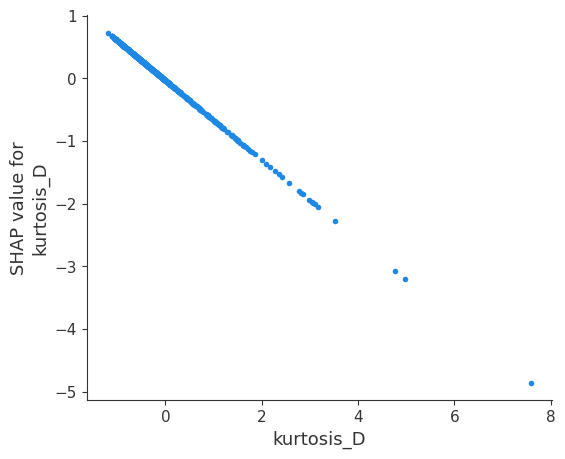

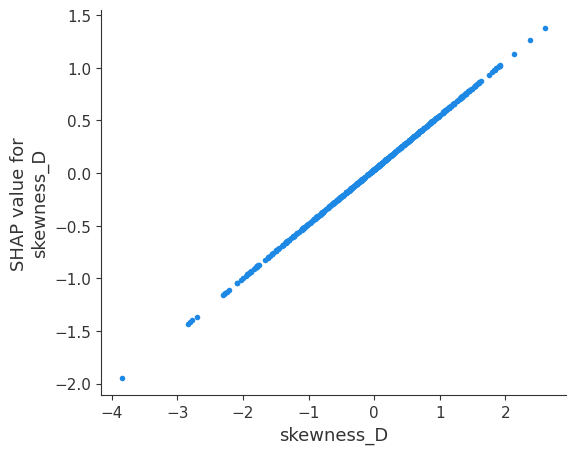

In [ ]:
shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test)

#### Single Monitor

Average Train accuracy: 0.6302055187095718
Average Train mse: 0.8562386683978429
Average Train precision: 0.6343039163639184
Average Train recall: 0.6305541420094458
Average Train f1: 0.6247012954088851
Average Train duration: 0.0650904655456543
Average Test accuracy: 0.6599613152804642
******************************************
Best Test accuracy: 0.6673114119922631
Best Test MSE: 0.7678916827852998
Best Test precision: 0.6736098310291859
Best Test recall: 0.6664623837700762
Best Test f1: 0.6618371121389229


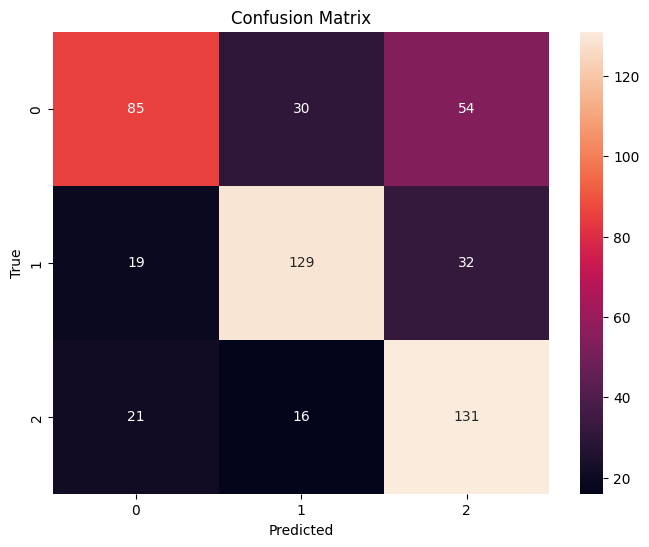

In [ ]:
# no scaling, test size=0.2
best_model, X_train, X_test = logistic_classifier_w_kfold(5, new_final_one_node_df, False, 0.2)

Average Train accuracy: 0.6350422851528231
Average Train mse: 0.8426957223567392
Average Train precision: 0.6391202653352546
Average Train recall: 0.6353959970523031
Average Train f1: 0.630050271696217
Average Train duration: 0.022464179992675783
Average Test accuracy: 0.6615087040618957
******************************************
Best Test accuracy: 0.6750483558994197
Best Test MSE: 0.7543520309477756
Best Test precision: 0.6811264849755415
Best Test recall: 0.6738463103847719
Best Test f1: 0.6698909973346064


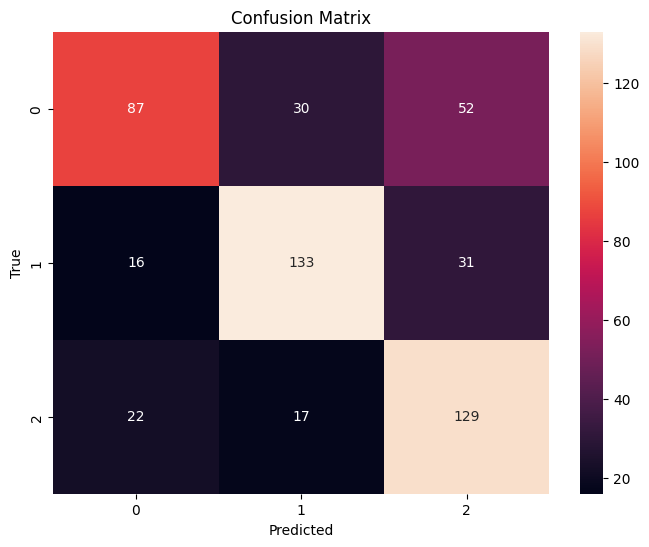

In [ ]:
# scaling, test size=0.2
best_model, X_train, X_test = logistic_classifier_w_kfold(5, new_final_one_node_df, True, 0.2)

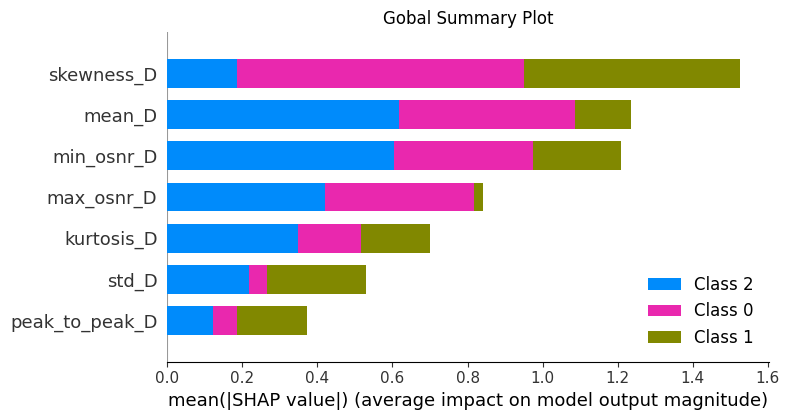

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


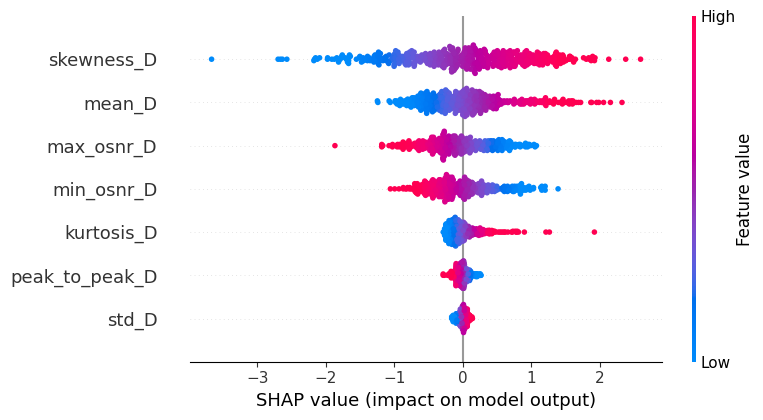

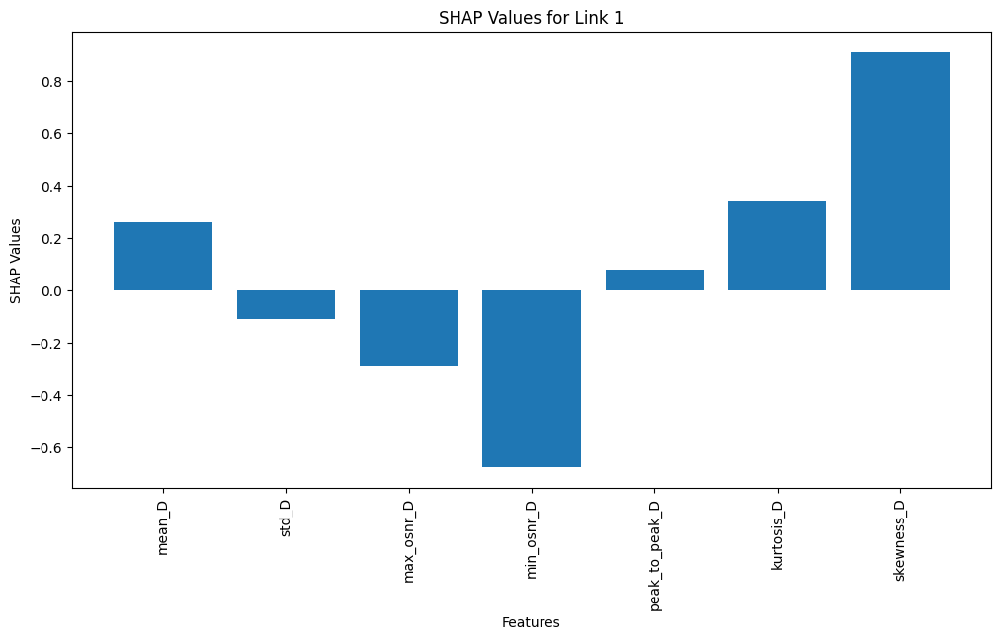

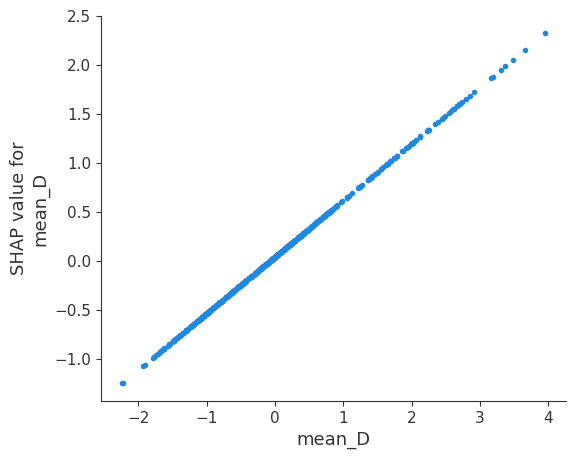

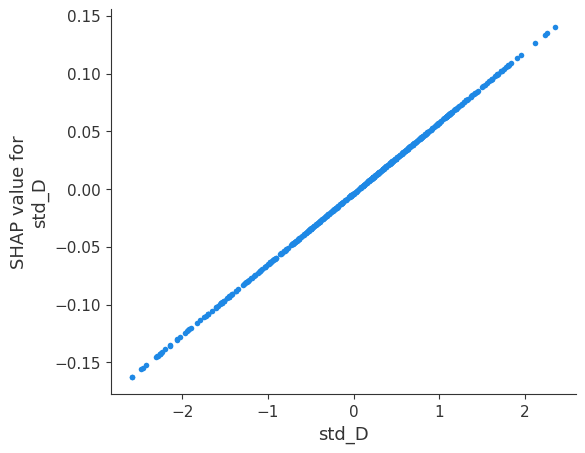

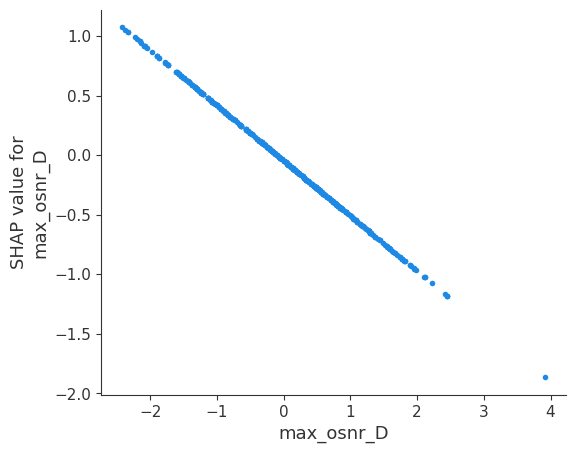

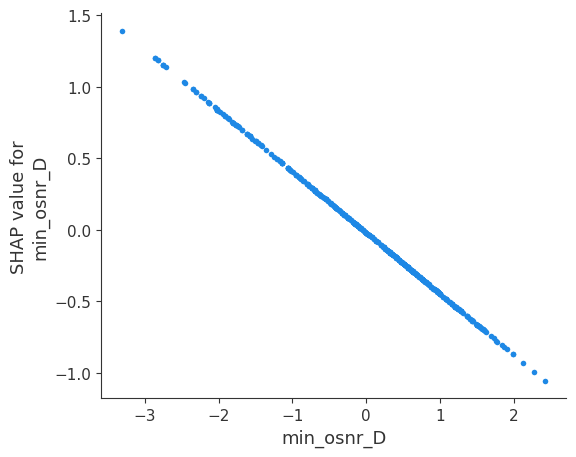

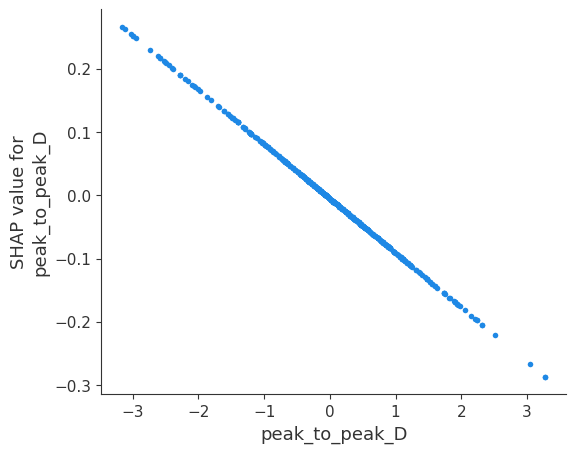

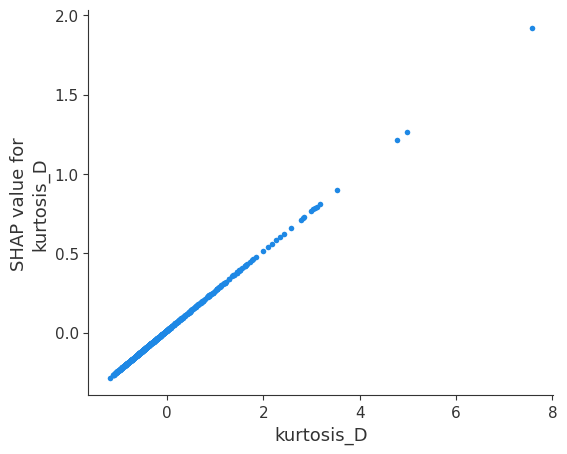

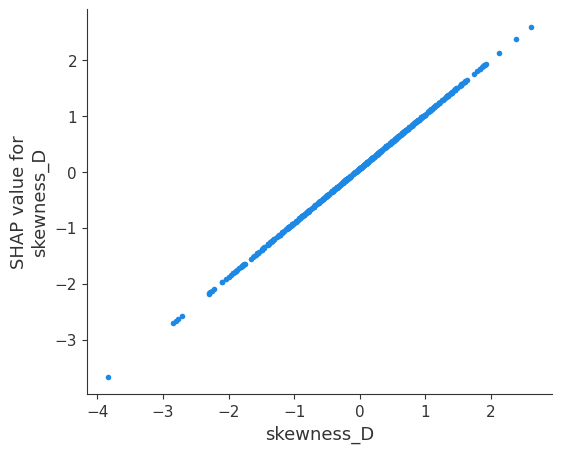

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


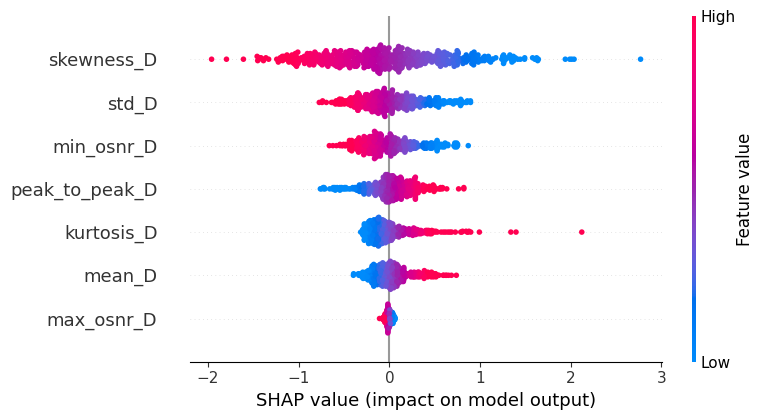

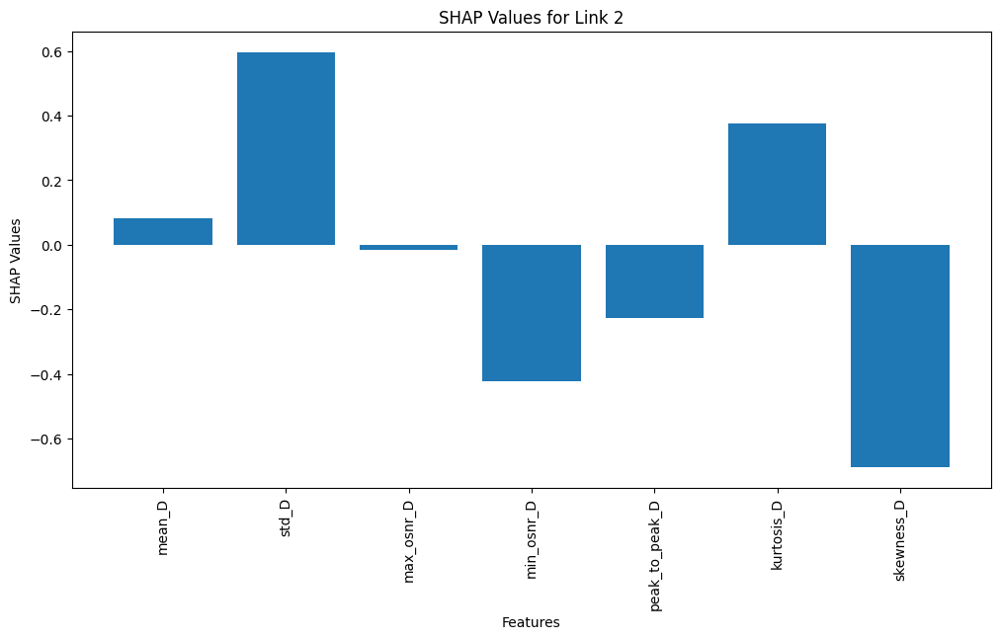

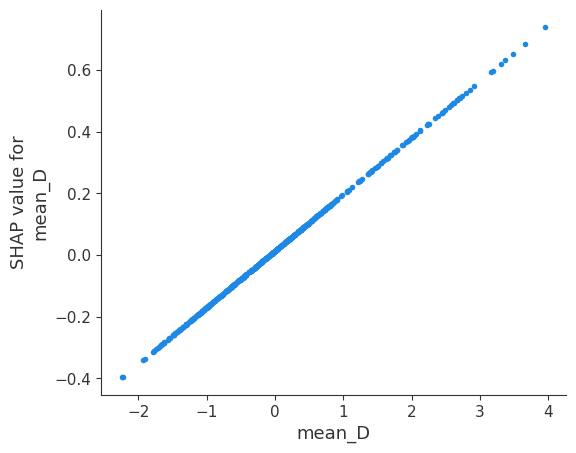

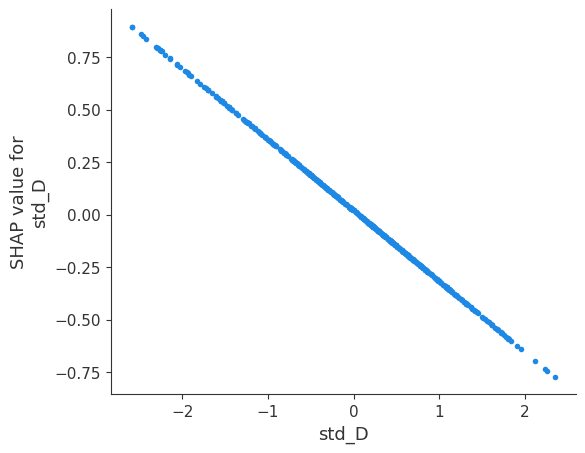

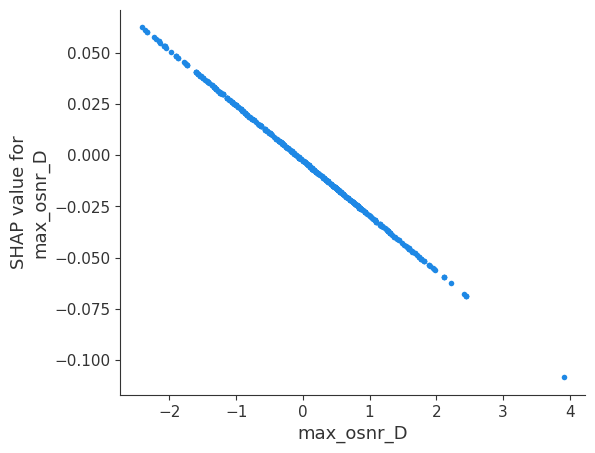

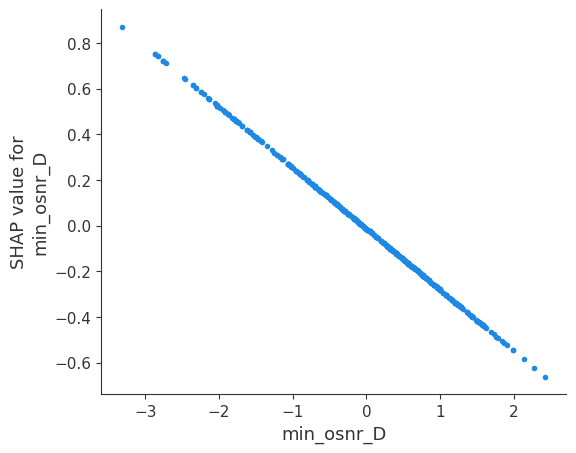

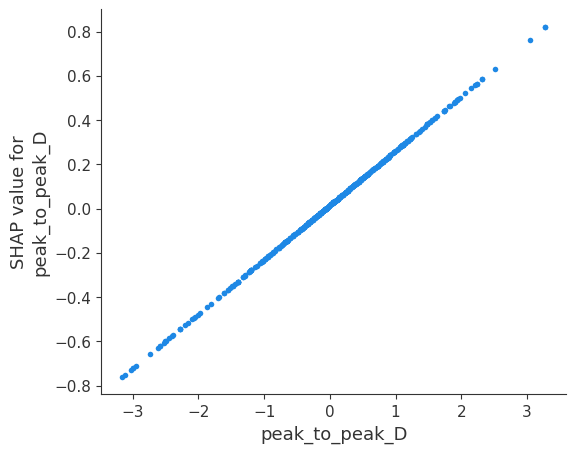

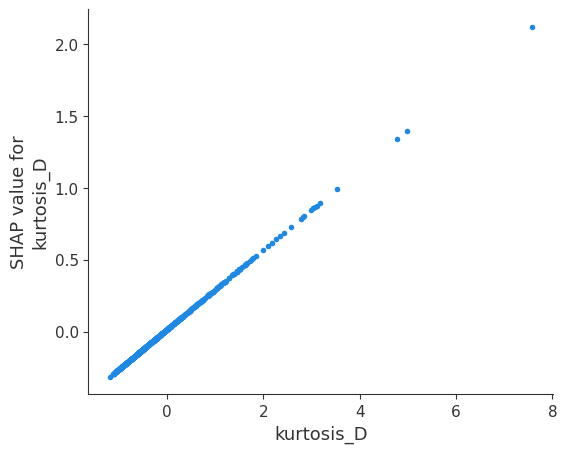

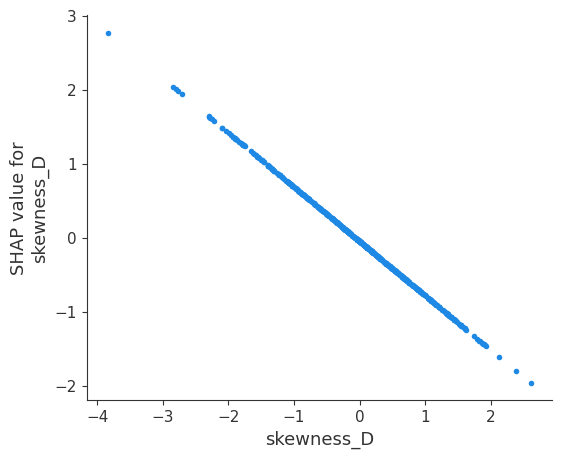

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


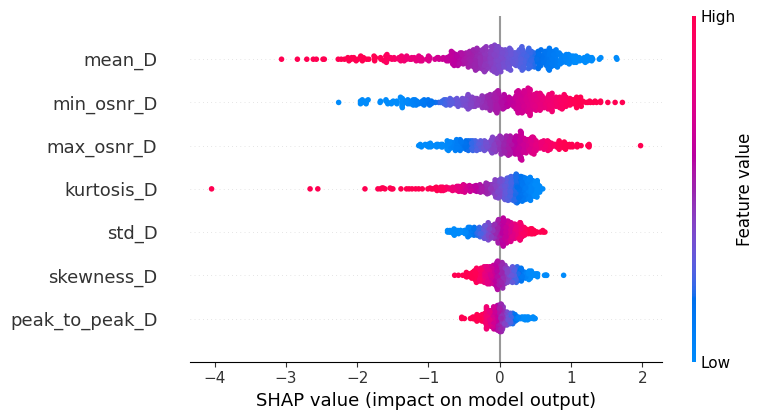

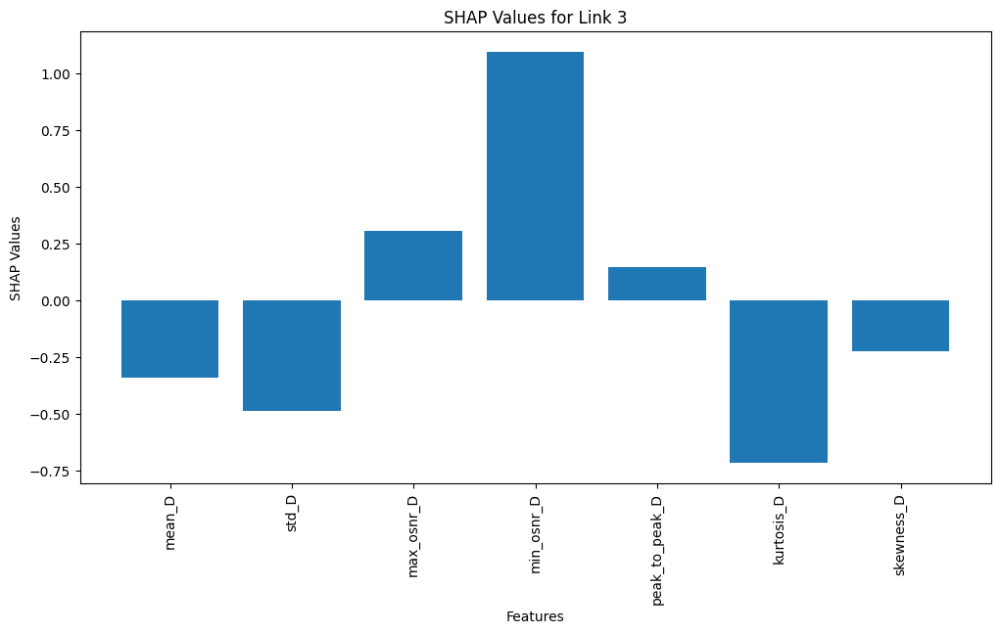

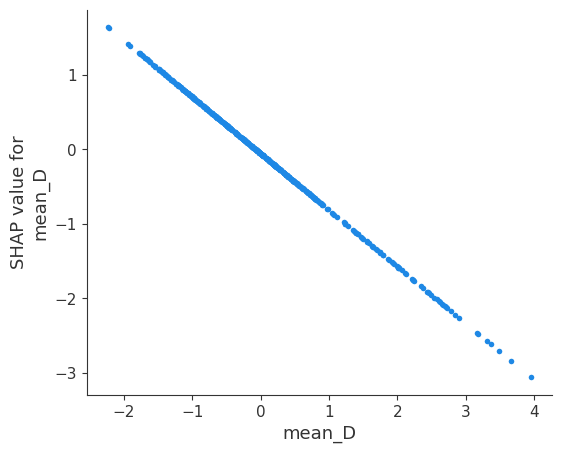

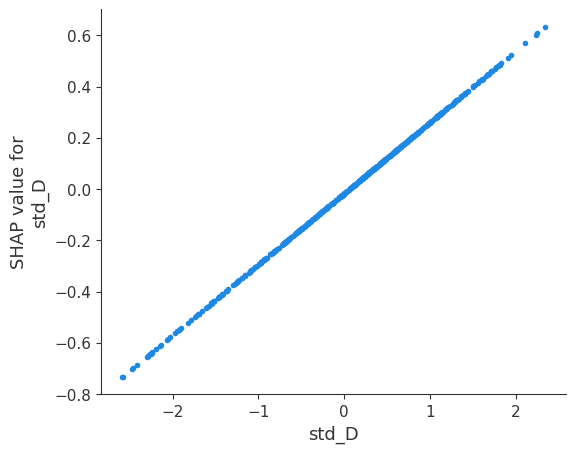

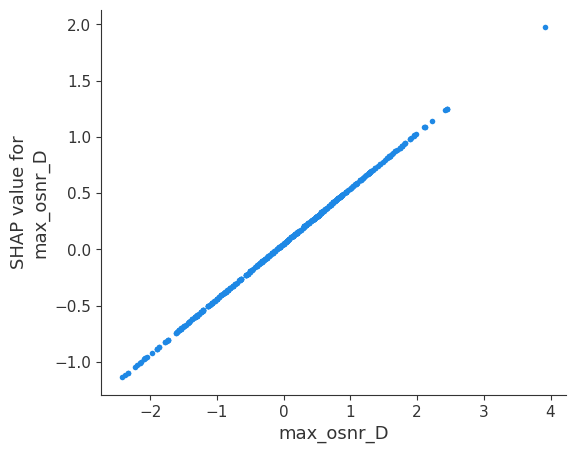

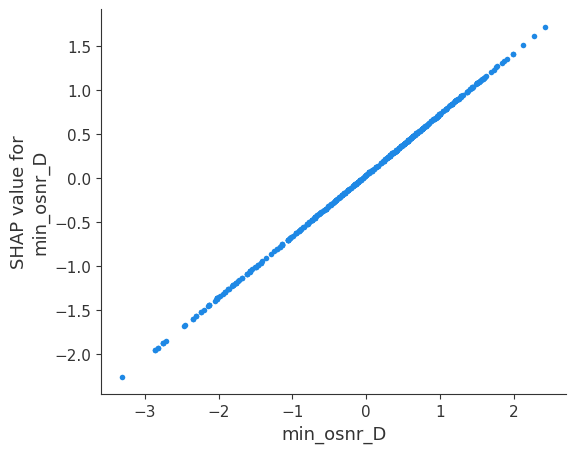

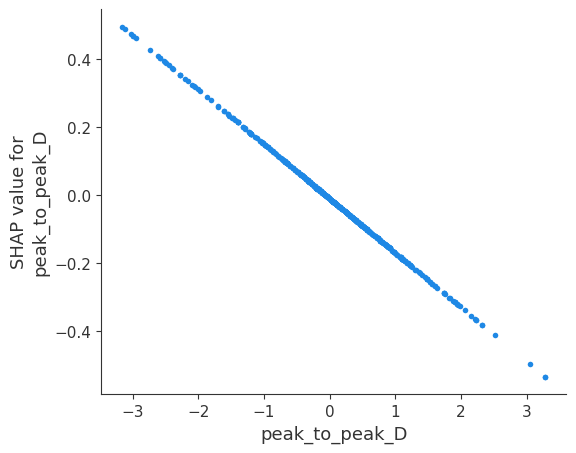

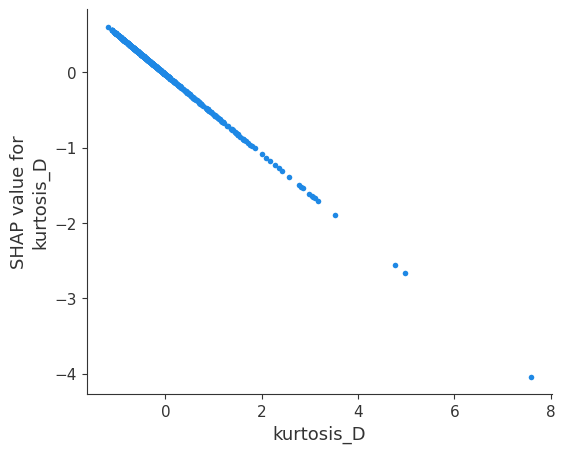

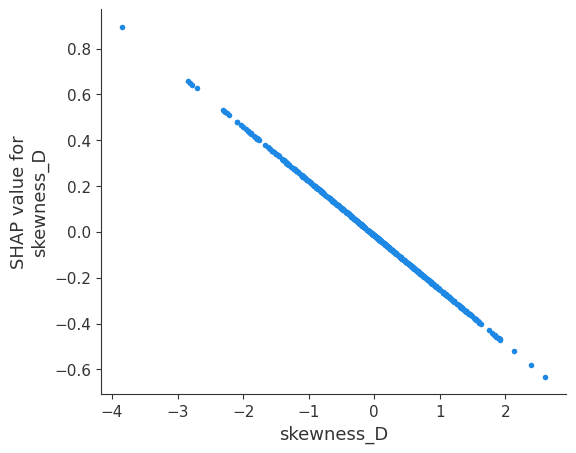

In [ ]:
shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test)

### XGBoost

In [ ]:
def xgb_classifier_w_kfold(n_splits, df, is_scaled, test_size):
    """
    Classification with XGBoost using hyperparameter tuning and scaling.
    """
    # Scale data if required
    if is_scaled:
        scaler = StandardScaler()
        df.iloc[:, :-1] = scaler.fit_transform(df.iloc[:, :-1])

    # Define parameter grid
    param_grid = {
        'n_estimators': [50, 100], # Number of trees or boosting rounds
        'max_depth': [4, 6], # Maximum depth of each tree
        # 'learning_rate': [0.01, 0.001], # Learning rate (step size) for each boosting round
    }

    # Split features and target
    X= df.iloc[:, :-1]
    y = LabelEncoder().fit_transform(df.iloc[:, -1])
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=42)

    # KFold cross-validation setup
    outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    inner_skf = StratifiedKFold(n_splits=2, shuffle=True, random_state=42)

    best_model, best_score = None, 0.0
    metrics = {'test_accuracy': [], 'mse': [], 'precision': [], 'recall': [], 'f1': [], 'train_accuracy': [], 'duration': []}

    for train_idx, test_idx in outer_skf.split(X_train, y_train):
        X_train_fold, X_test_fold = X_train.iloc[train_idx], X_train.iloc[test_idx]
        y_train_fold, y_test_fold = y_train[train_idx], y_train[test_idx]

        model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)
        grid_search = GridSearchCV(model, param_grid, cv=inner_skf)

        start_time = time.time()
        grid_search.fit(X_train_fold, y_train_fold)
        metrics['duration'].append(time.time() - start_time)


        y_pred_fold = grid_search.best_estimator_.predict(X_test_fold)
        y_pred_test = grid_search.best_estimator_.predict(X_test)

        # Collect fold metrics
        metrics['train_accuracy'].append(accuracy_score(y_test_fold, y_pred_fold))
        metrics['mse'].append(mean_squared_error(y_test_fold, y_pred_fold))
        metrics['precision'].append(precision_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['recall'].append(recall_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['f1'].append(f1_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['test_accuracy'].append(accuracy_score(y_test, y_pred_test))

        # Track the best model
        test_accuracy = accuracy_score(y_test, y_pred_test)
        if test_accuracy > best_score:
            best_score = test_accuracy
            best_model = grid_search.best_estimator_
            best_metrics = {
                'mse': mean_squared_error(y_test, y_pred_test),
                'precision': precision_score(y_test, y_pred_test, average='macro'),
                'recall': recall_score(y_test, y_pred_test, average='macro'),
                'f1': f1_score(y_test, y_pred_test, average='macro'),
            }

    # Print average metrics
    print(f"Average Train accuracy: {np.mean(metrics['train_accuracy'])}")
    print(f"Average Train mse: {np.mean(metrics['mse'])}")
    print(f"Average Train precision: {np.mean(metrics['precision'])}")
    print(f"Average Train recall: {np.mean(metrics['recall'])}")
    print(f"Average Train f1: {np.mean(metrics['f1'])}")
    print(f"Average Train duration: {np.mean(metrics['duration'])}")
    print(f"Average Test accuracy: {np.mean(metrics['test_accuracy'])}")
    print("******************************************")
    print(f"Best Test accuracy: {best_score}")
    print(f"Best Test MSE: {best_metrics['mse']}")
    print(f"Best Test precision: {best_metrics['precision']}")
    print(f"Best Test recall: {best_metrics['recall']}")
    print(f"Best Test f1: {best_metrics['f1']}")

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_matrix(y_test, best_model.predict(X_test)), annot=True, cmap='Blues', fmt='d')
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

    return best_model, X_test

#### Multiple Monitor

Average Train accuracy: 0.9736770960933997
Average Train mse: 0.0520282651372321
Average Train precision: 0.9737003908491209
Average Train recall: 0.9736672292984363
Average Train f1: 0.9736729365333814
Average Train duration: 14.866848754882813
Average Test accuracy: 0.97387881126978
******************************************
Best Test accuracy: 0.975839444230027
Best Test MSE: 0.05218062524121961
Best Test precision: 0.9758218292499251
Best Test recall: 0.9758418328900728
Best Test f1: 0.97583017044649


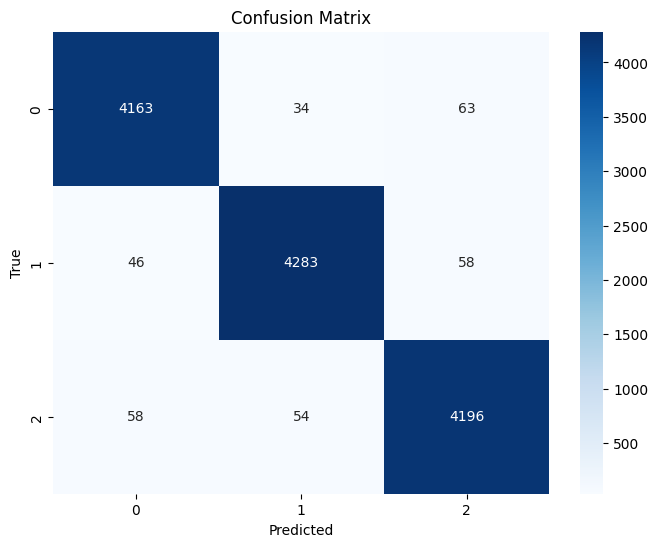

In [ ]:
# no scaling, test size=0.2
best_model, X_test = xgb_classifier_w_kfold(5, final_df, False, 0.2)

Average Train accuracy: 0.9736770960933997
Average Train mse: 0.0520282651372321
Average Train precision: 0.9737003908491209
Average Train recall: 0.9736672292984363
Average Train f1: 0.9736729365333814
Average Train duration: 14.764987707138062
Average Test accuracy: 0.97387881126978
******************************************
Best Test accuracy: 0.975839444230027
Best Test MSE: 0.05218062524121961
Best Test precision: 0.9758218292499251
Best Test recall: 0.9758418328900728
Best Test f1: 0.97583017044649


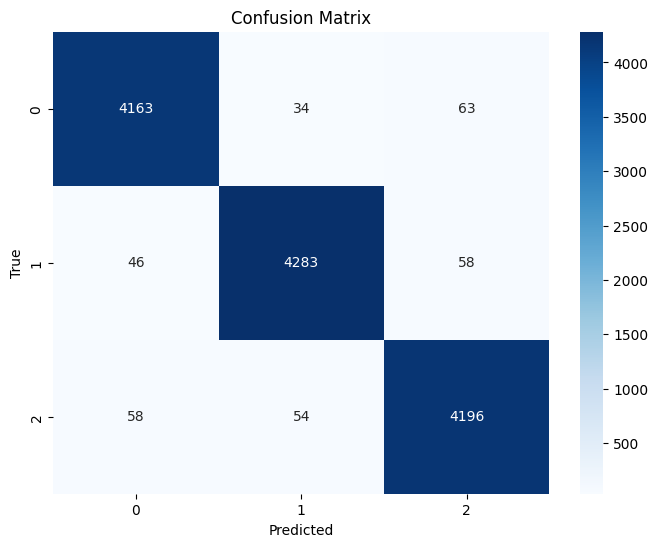

In [ ]:
# scaling, Test size=0.2
best_model, X_test = xgb_classifier_w_kfold(5, final_df, True, 0.2)

[08:32:13] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


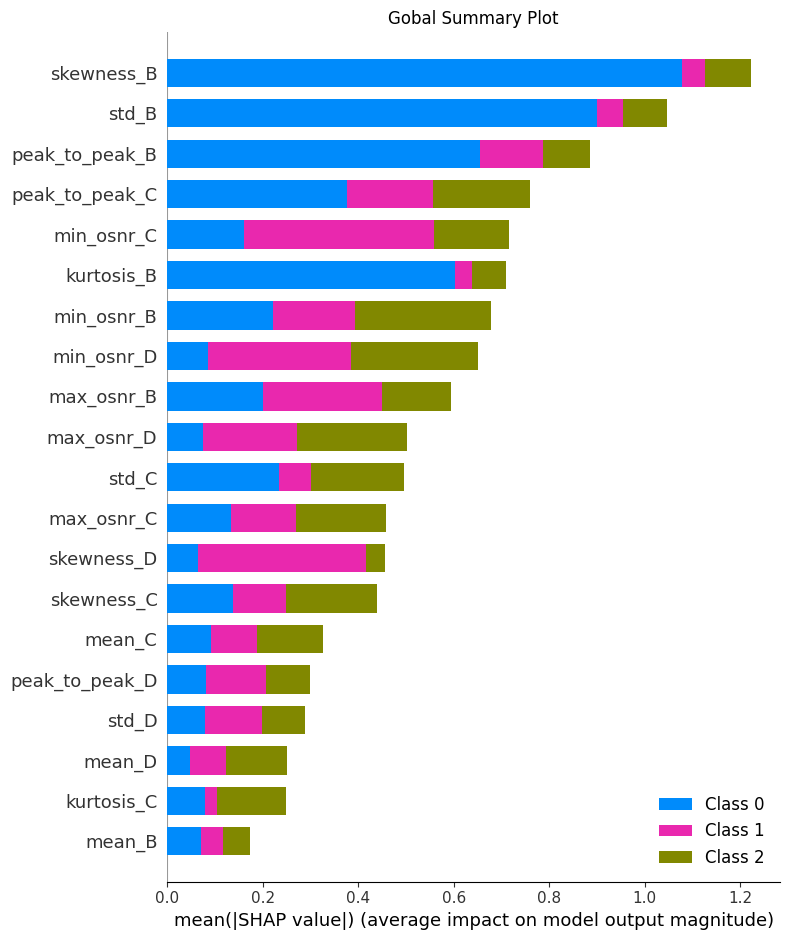

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


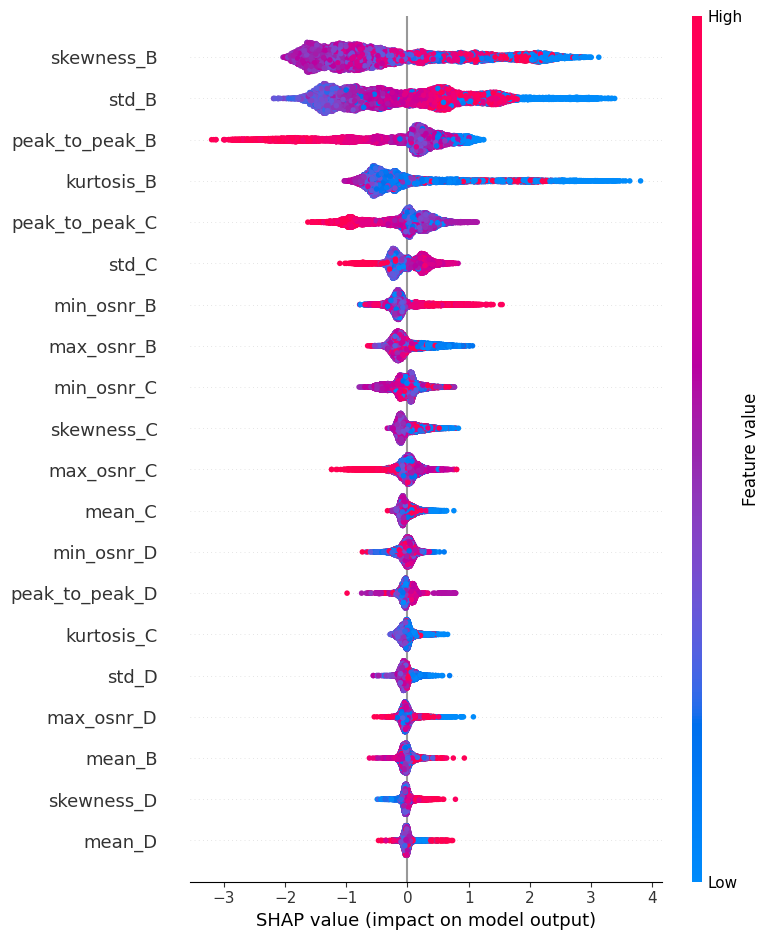

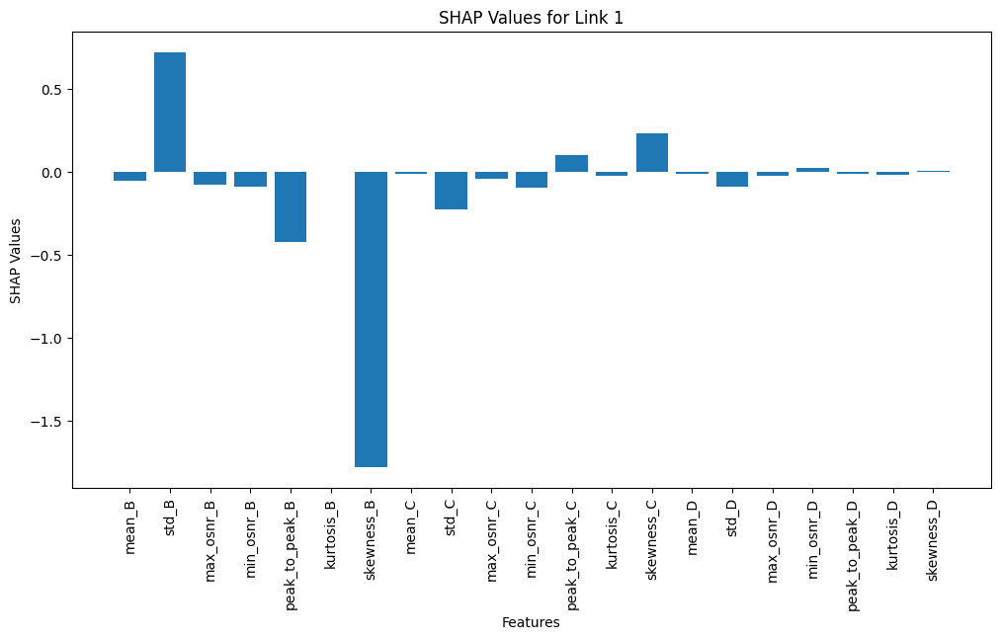

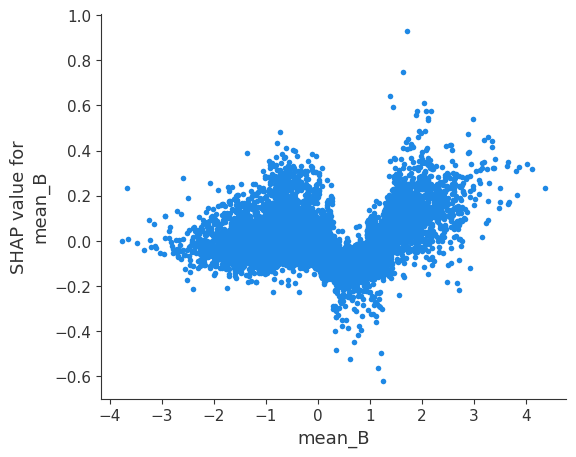

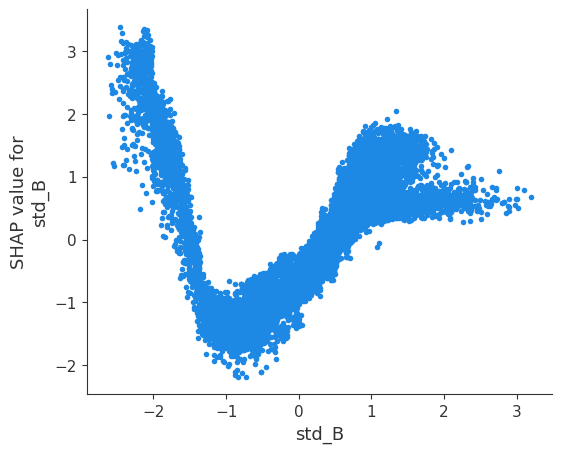

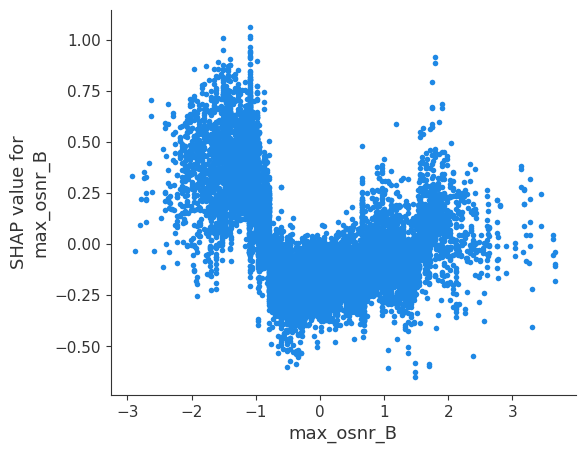

...

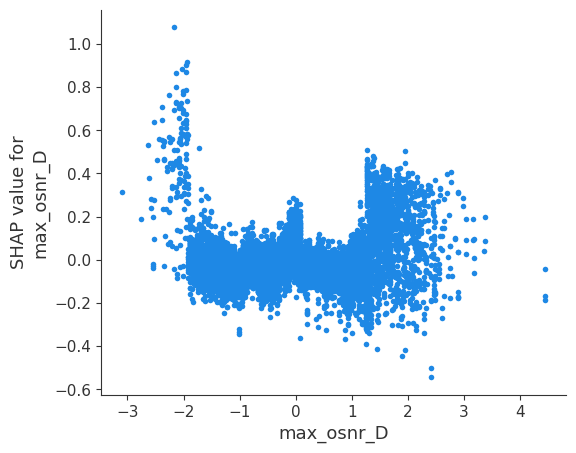

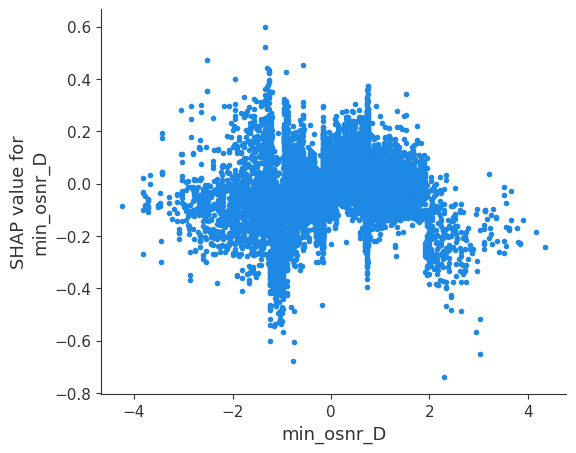

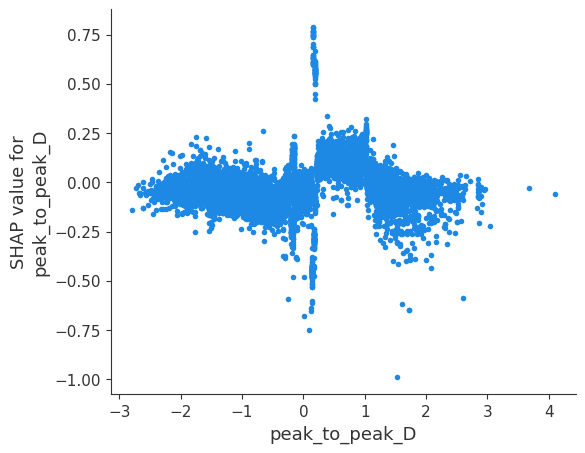

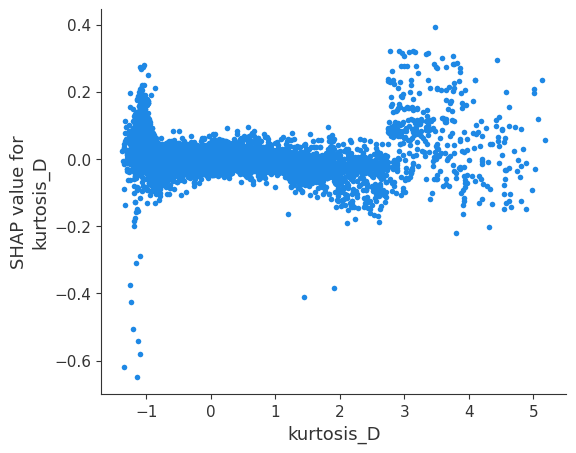

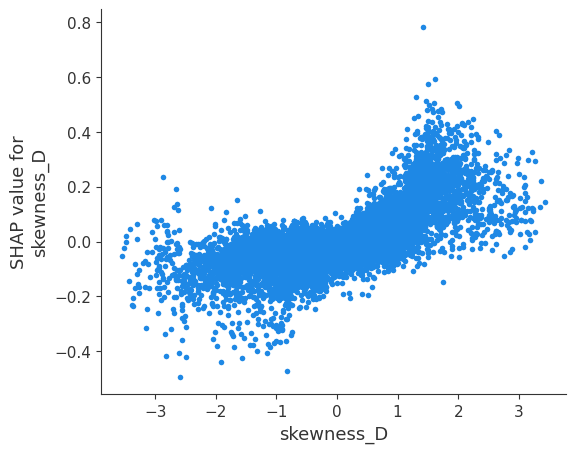

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


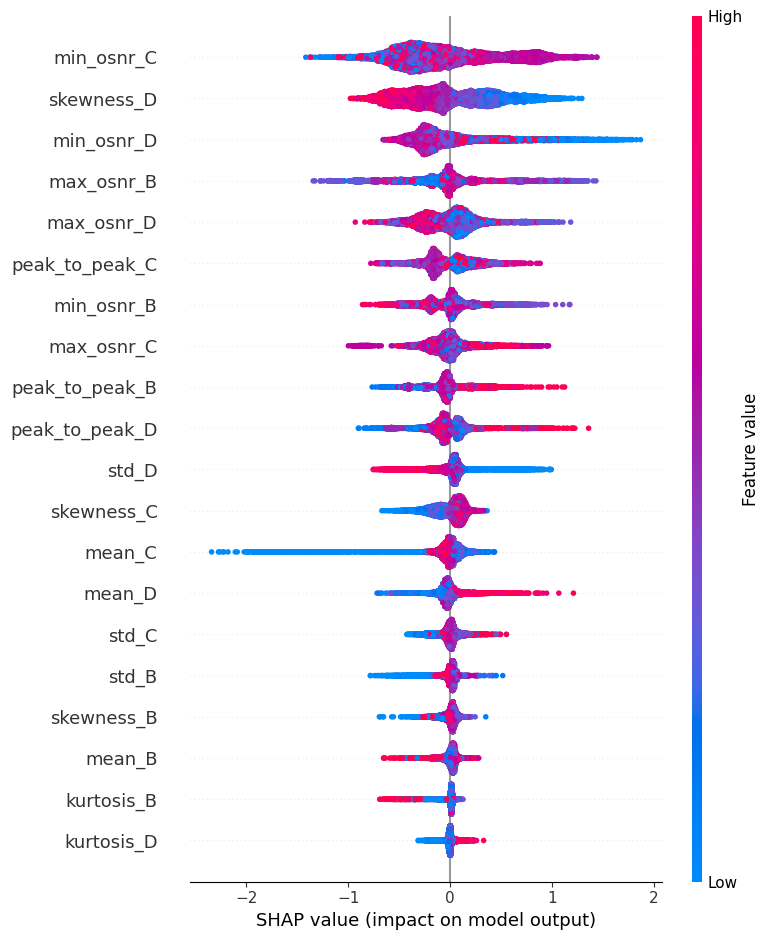

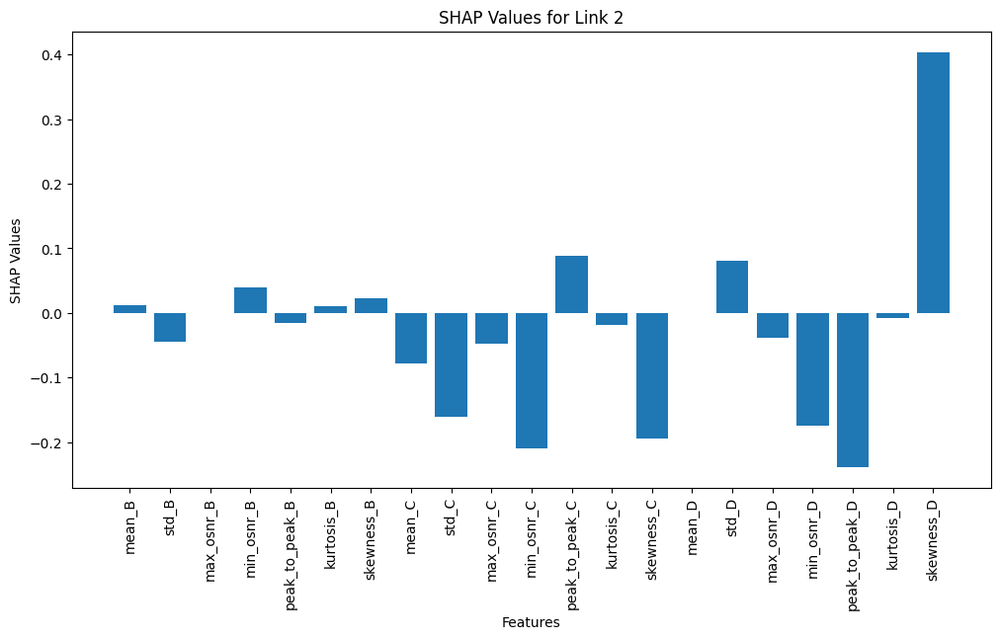

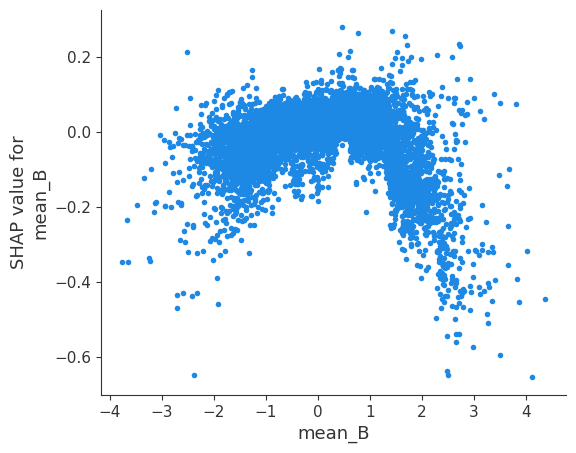

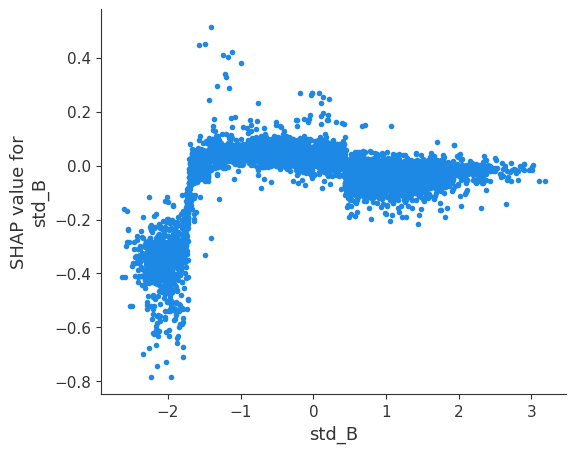

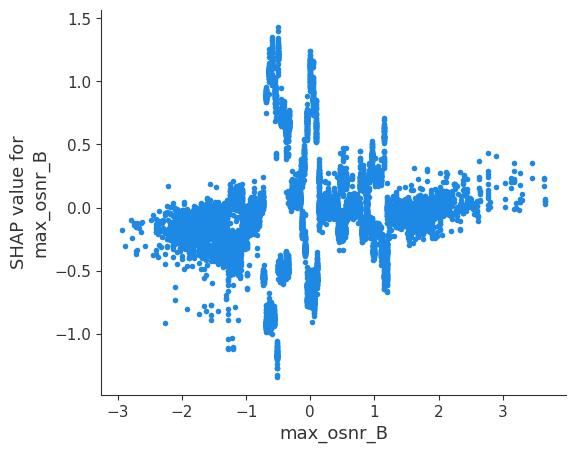

...

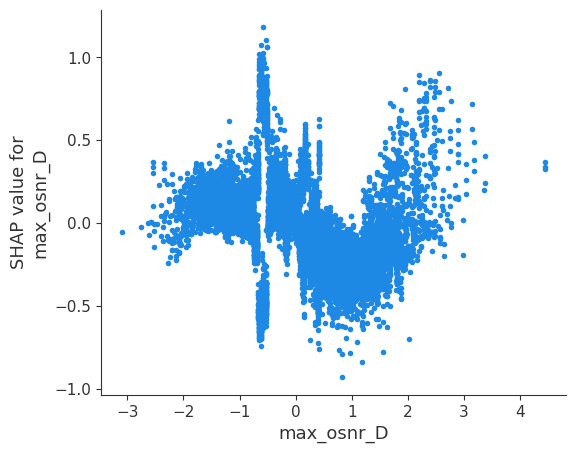

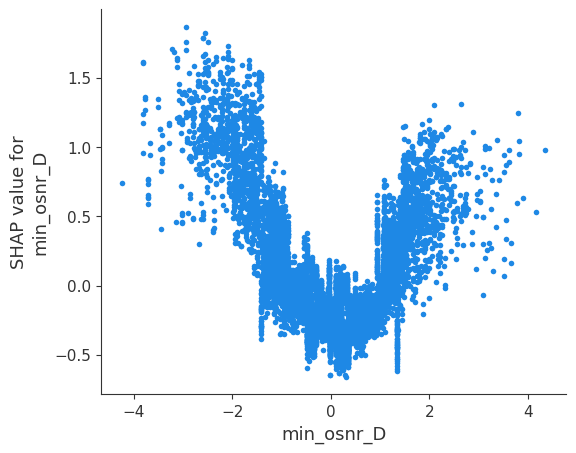

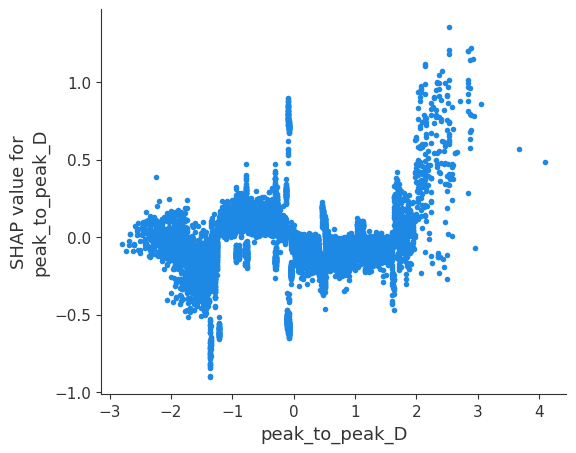

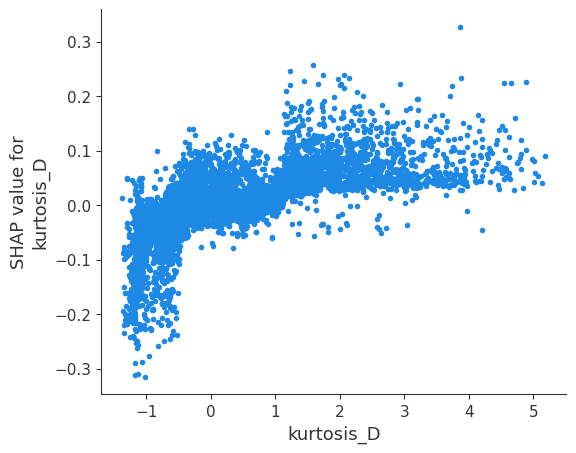

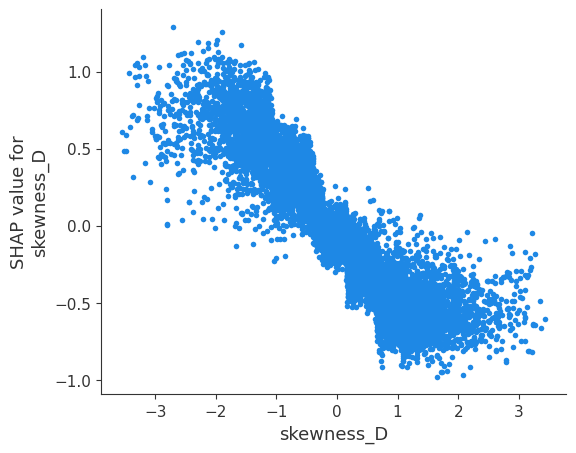

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


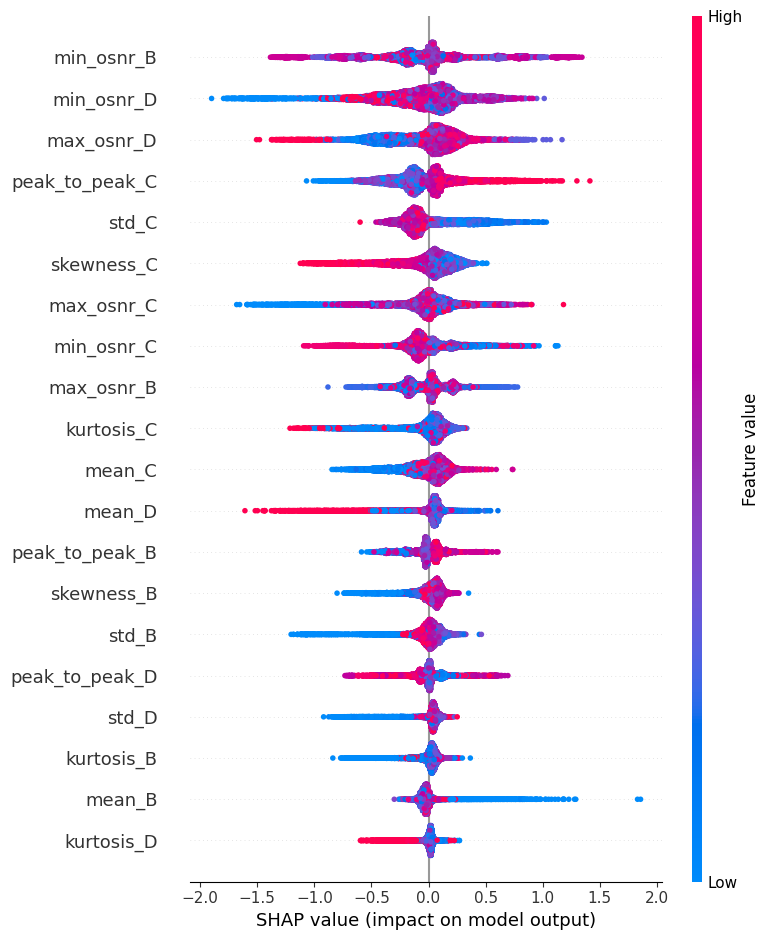

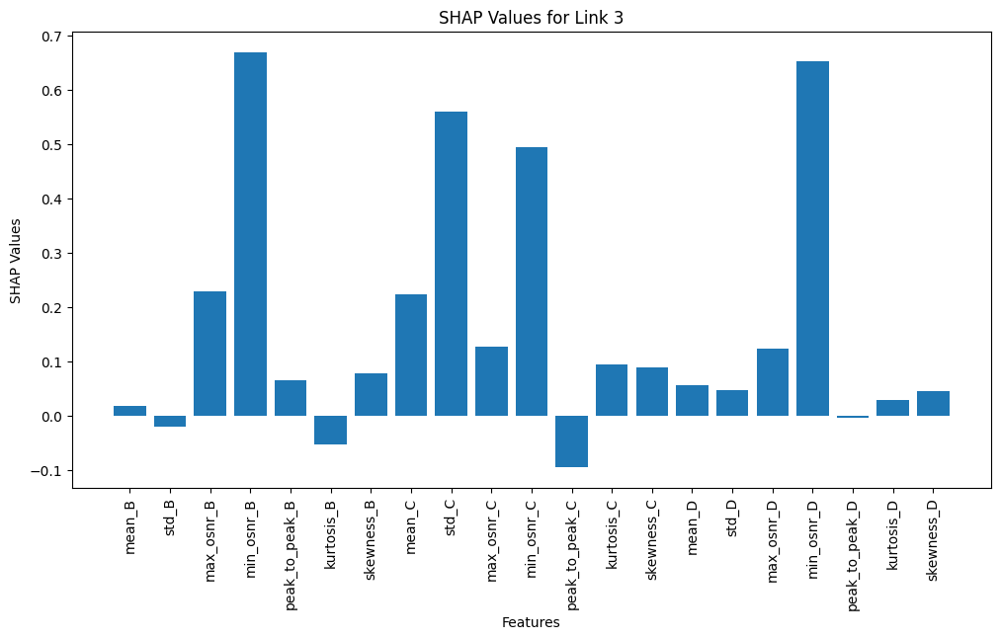

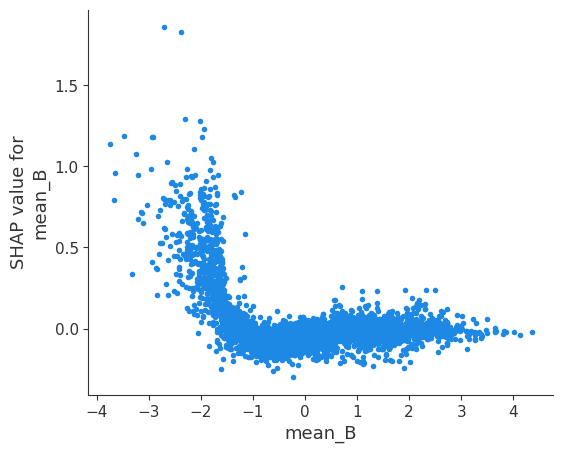

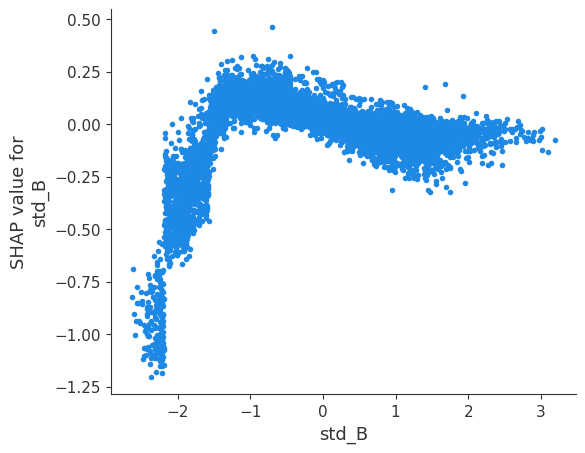

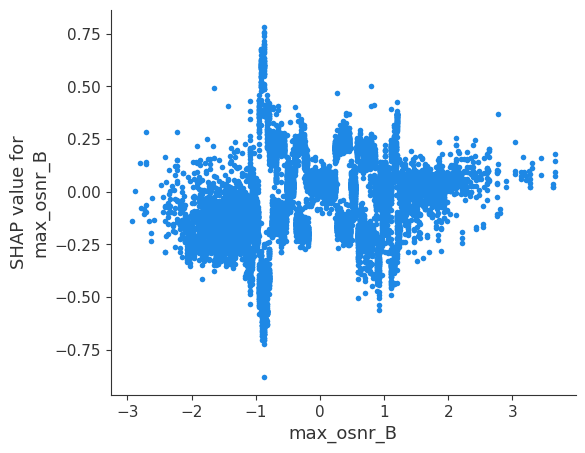

...

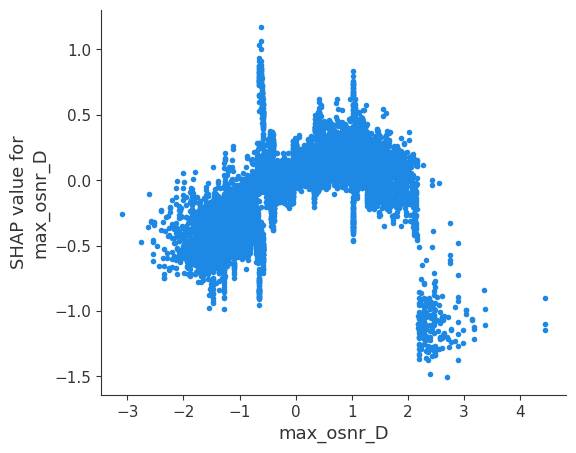

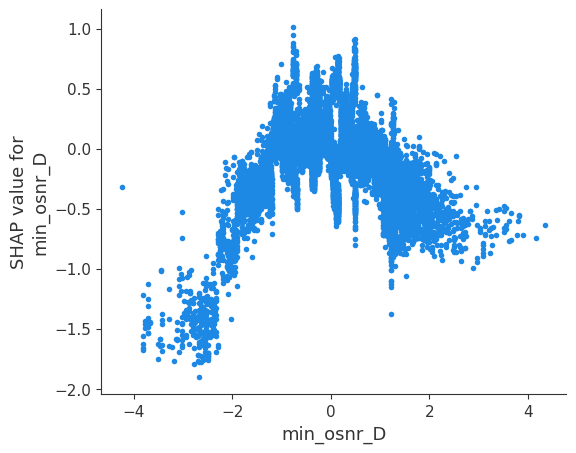

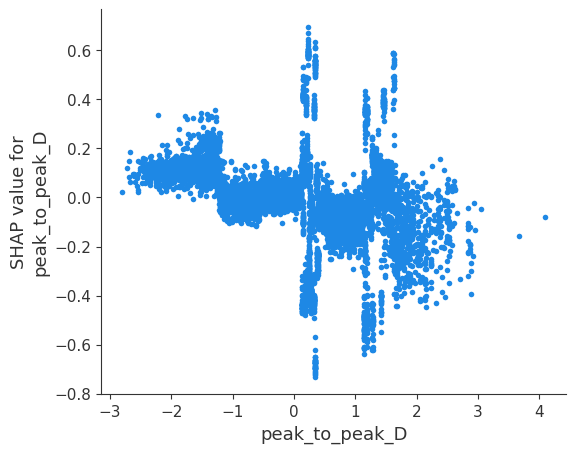

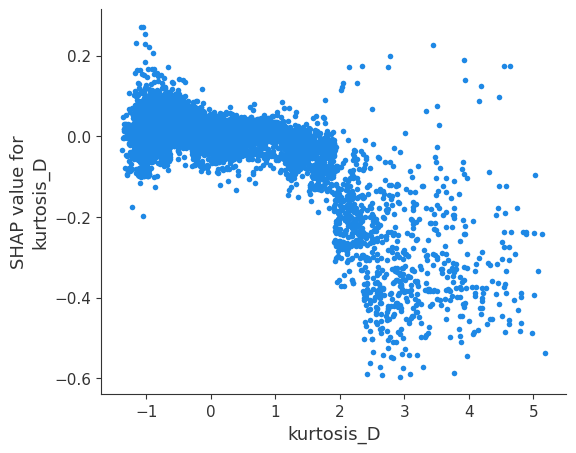

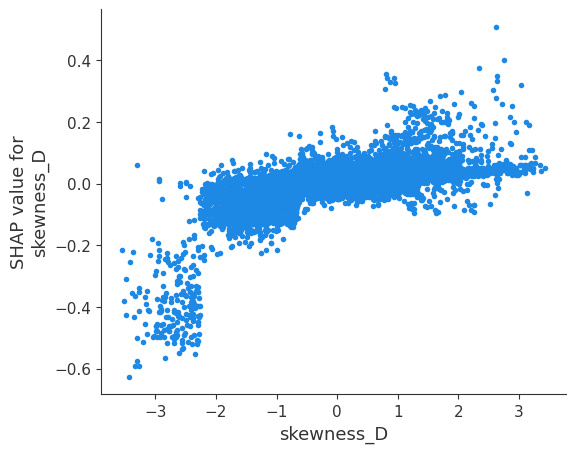

In [ ]:
shap_plots_explainable_ai_tree_explainer(best_model, X_test)

#### Single Monitor

Average Train accuracy: 0.9388630181009814
Average Train mse: 0.09633712671551065
Average Train precision: 0.9392153295565885
Average Train recall: 0.9388599370795028
Average Train f1: 0.9389212488198286
Average Train duration: 6.66820592880249
Average Test accuracy: 0.937954457738325
******************************************
Best Test accuracy: 0.9455036665380162
Best Test MSE: 0.09316866074874566
Best Test precision: 0.9460589007683247
Best Test recall: 0.9454327981363605
Best Test f1: 0.9456023429727121


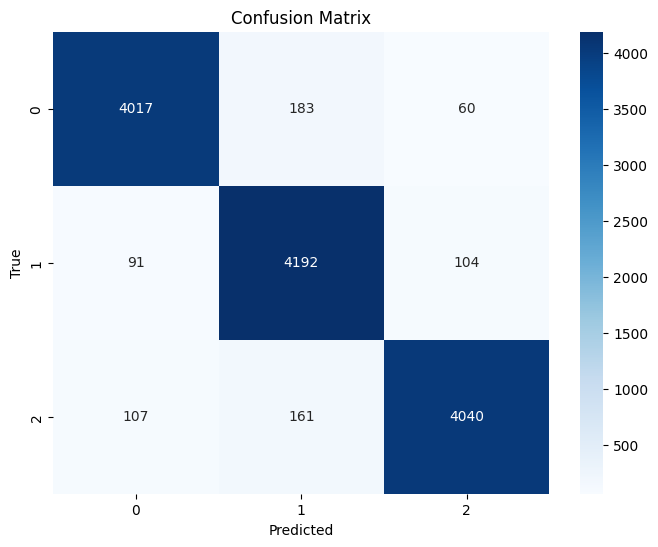

In [ ]:
# no scaling, Test size=0.2
best_model, X_test = xgb_classifier_w_kfold(5, final_one_node_df, False, 0.2)

Average Train accuracy: 0.9388630181009814
Average Train mse: 0.09633712671551065
Average Train precision: 0.9392153295565885
Average Train recall: 0.9388599370795028
Average Train f1: 0.9389212488198286
Average Train duration: 7.226100206375122
Average Test accuracy: 0.937954457738325
******************************************
Best Test accuracy: 0.9455036665380162
Best Test MSE: 0.09316866074874566
Best Test precision: 0.9460589007683247
Best Test recall: 0.9454327981363605
Best Test f1: 0.9456023429727121


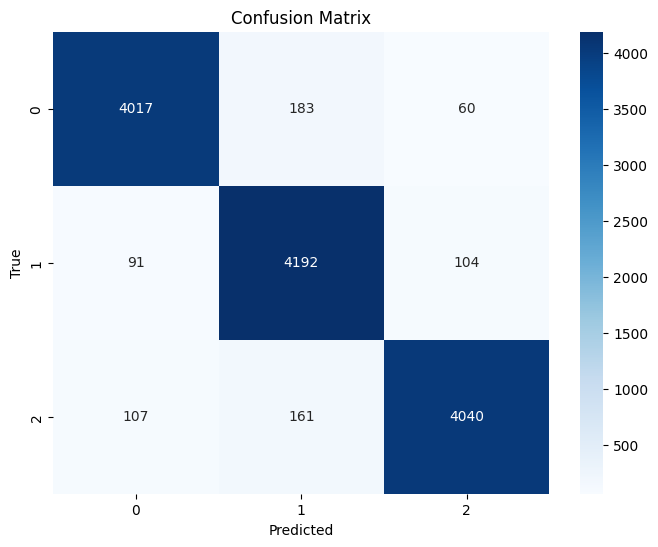

In [ ]:
# scaling, Test size=0.2
best_model, X_test = xgb_classifier_w_kfold(5, final_one_node_df, True, 0.2)

[08:34:17] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


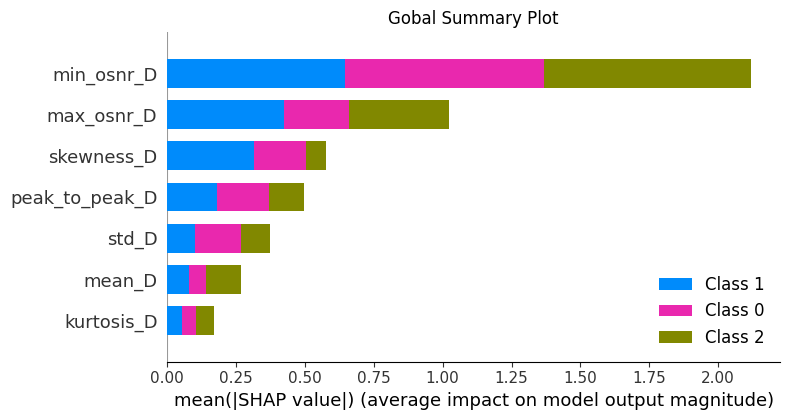

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


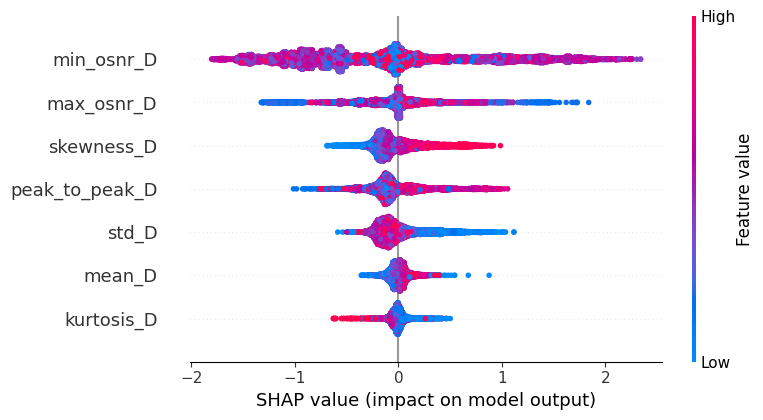

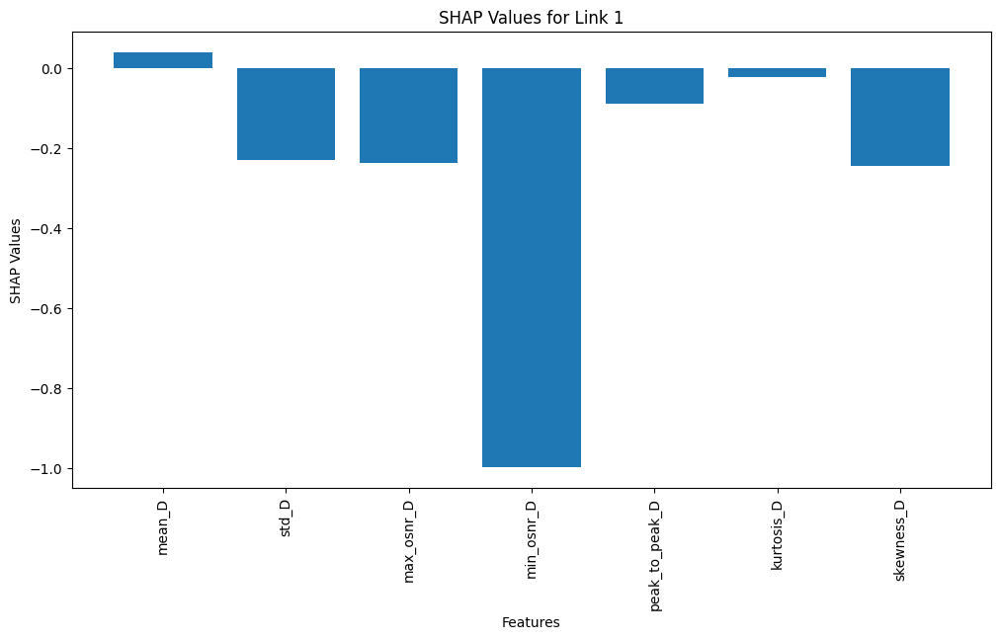

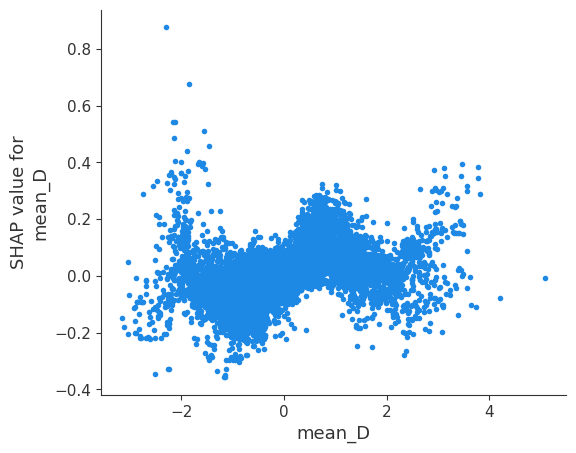

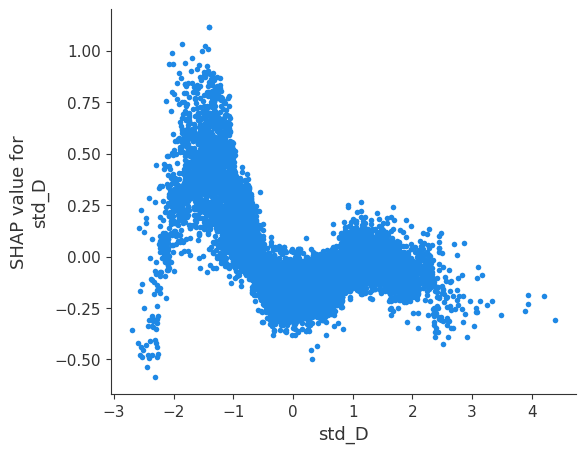

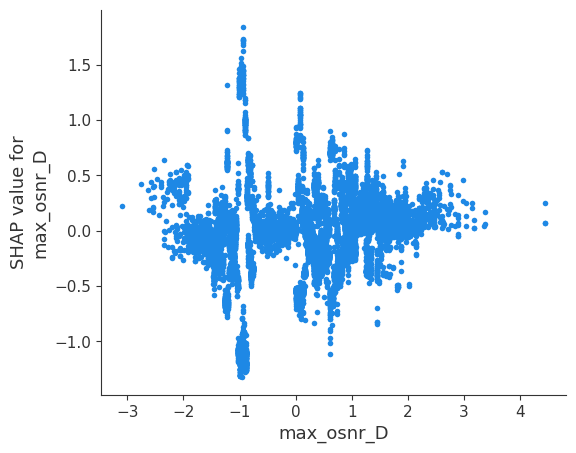

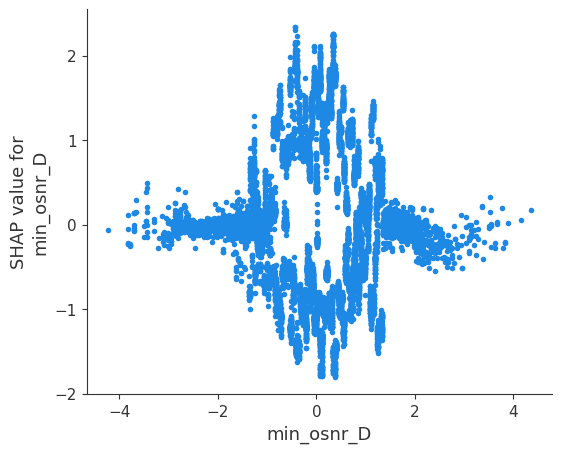

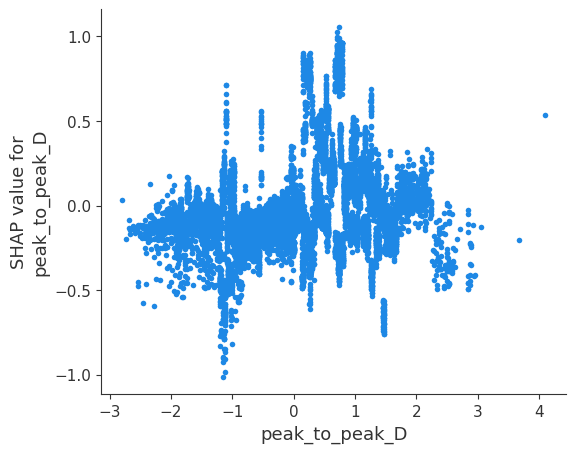

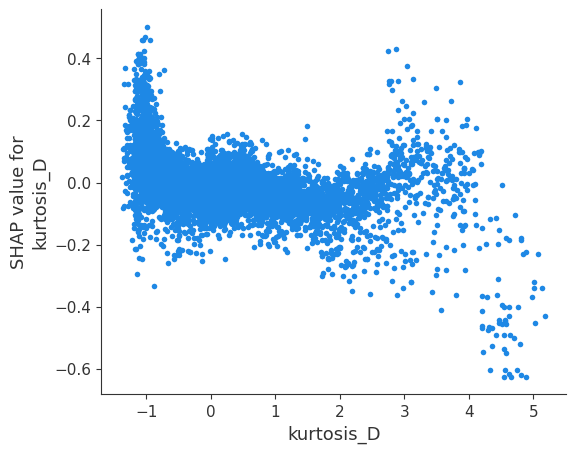

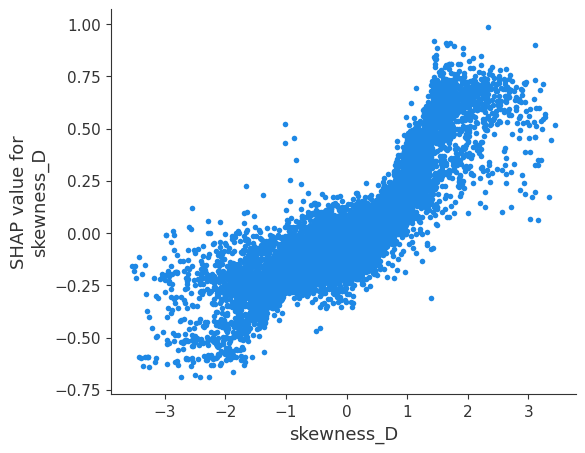

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


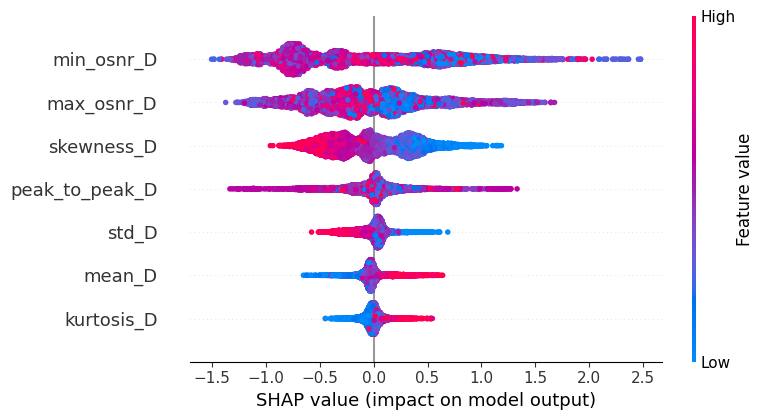

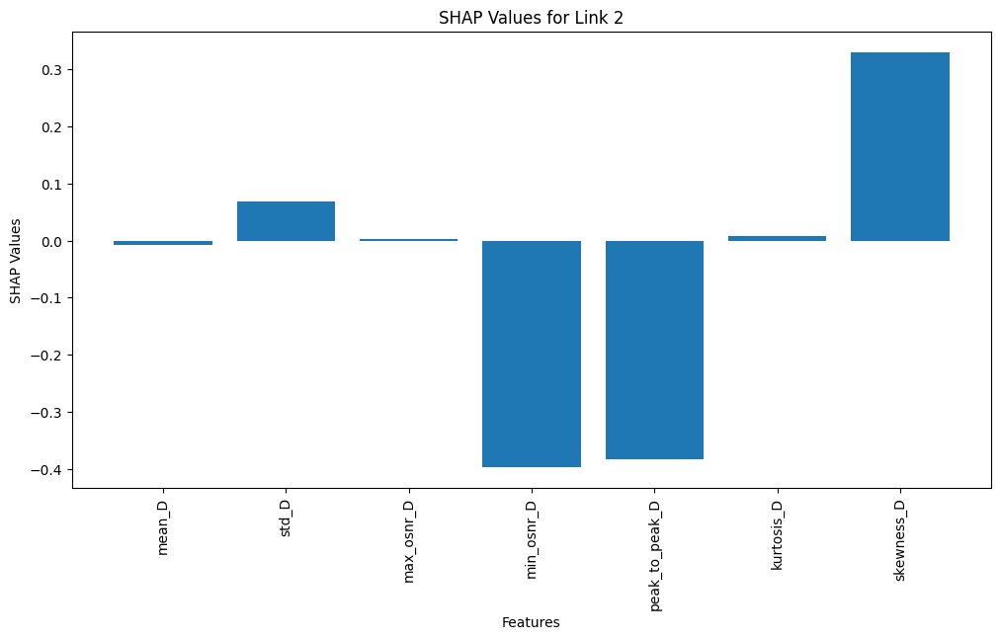

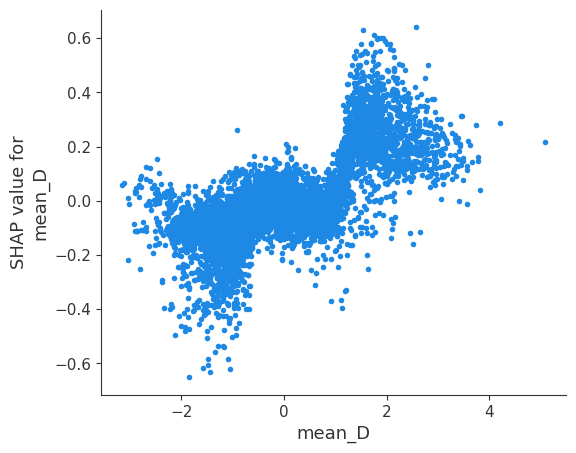

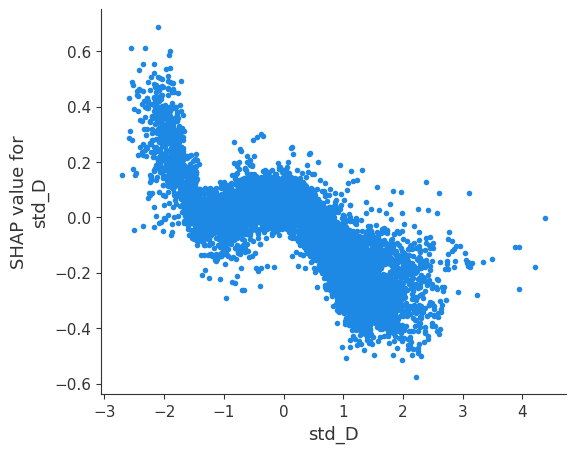

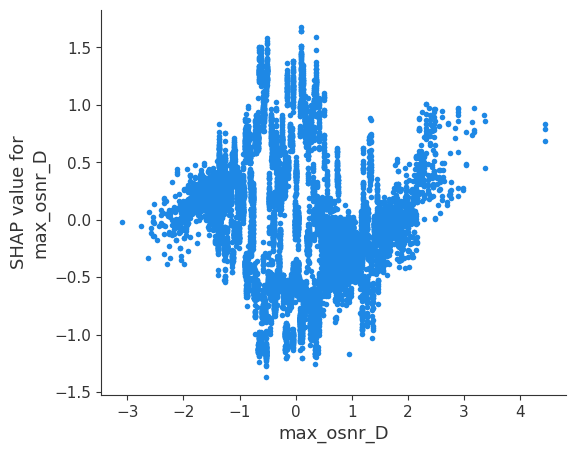

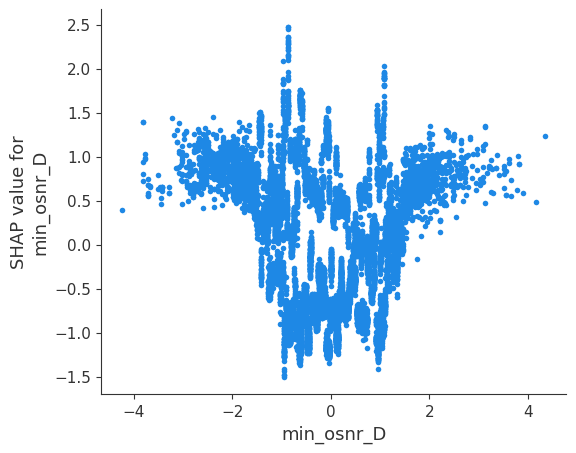

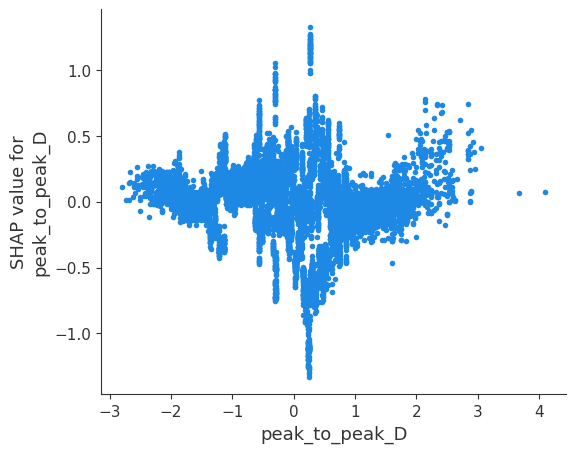

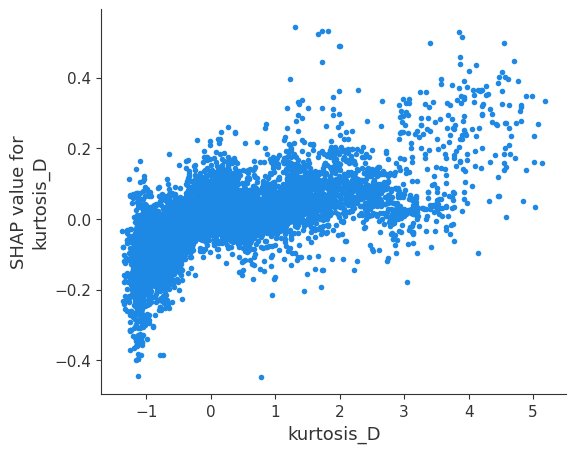

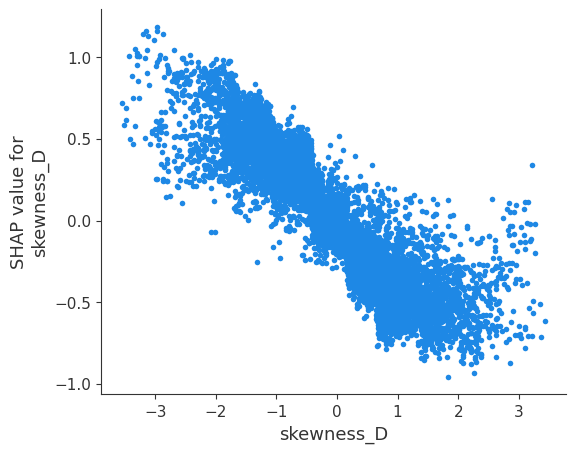

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


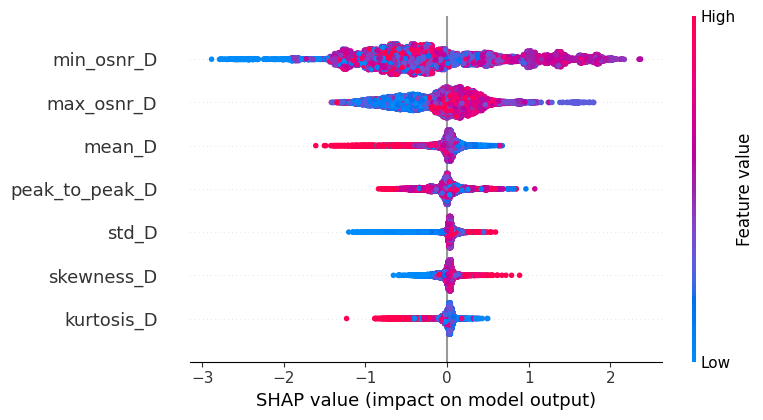

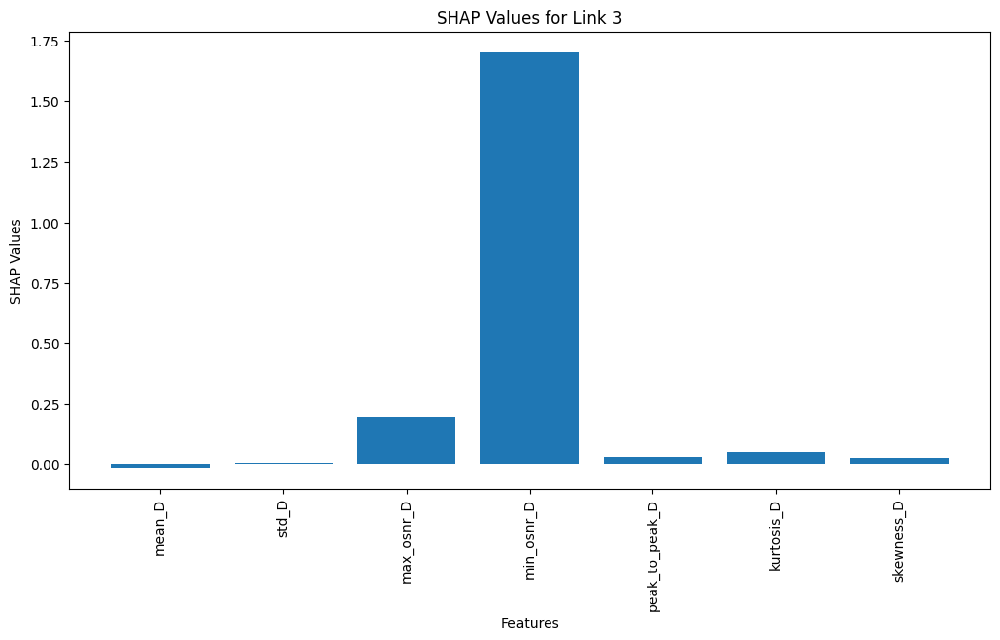

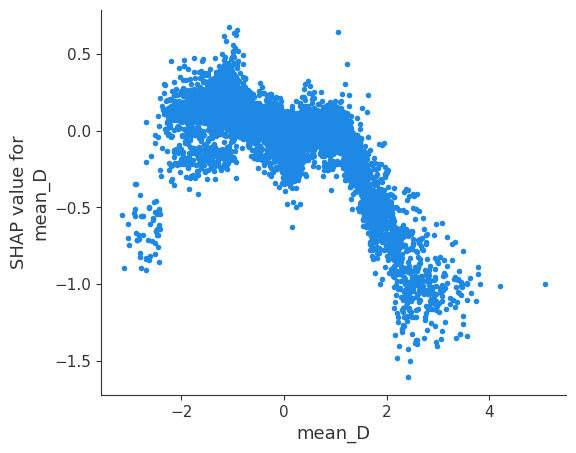

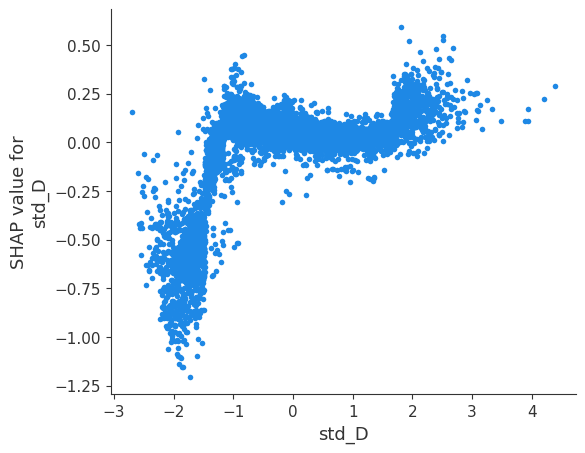

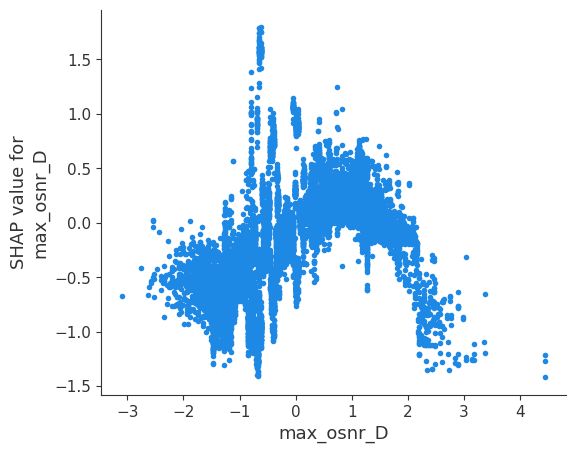

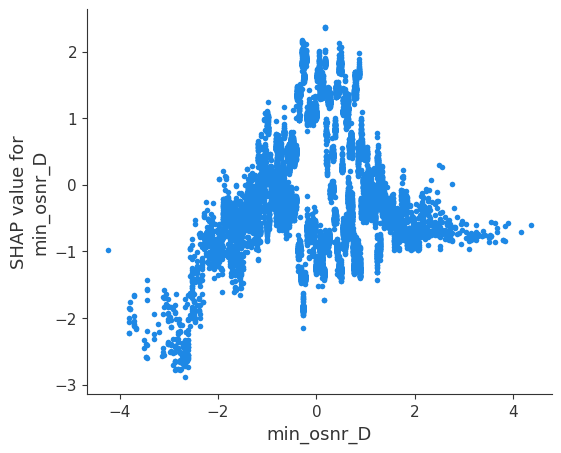

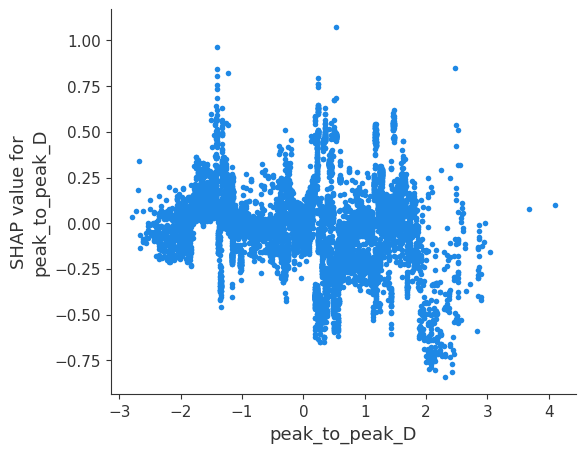

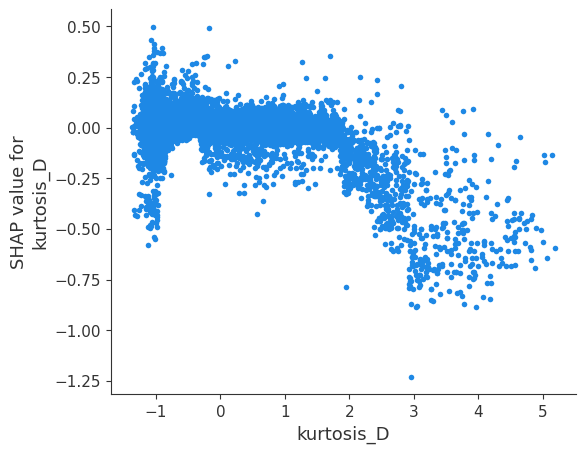

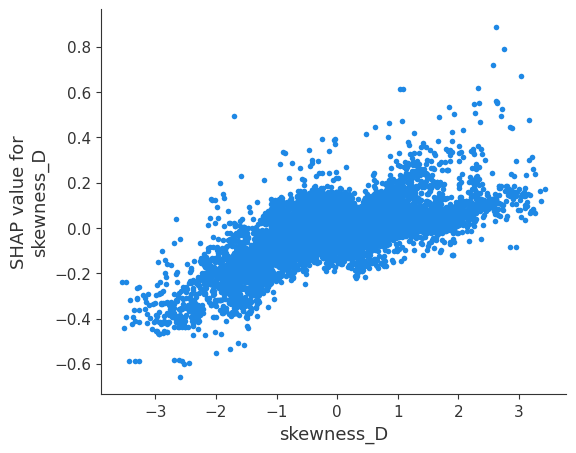

In [ ]:
shap_plots_explainable_ai_tree_explainer(best_model, X_test)

#### Bigger window sizes and spacing

#### Multiple Monitor

Average Train accuracy: 0.9830613748815665
Average Train mse: 0.022749763132961363
Average Train precision: 0.9831190073949599
Average Train recall: 0.983027185882858
Average Train f1: 0.9830455392674967
Average Train duration: 2.5708969593048097
Average Test accuracy: 0.98568665377176
******************************************
Best Test accuracy: 0.988394584139265
Best Test MSE: 0.017408123791102514
Best Test precision: 0.9884982895507933
Best Test recall: 0.9883597883597884
Best Test f1: 0.9884118867079575


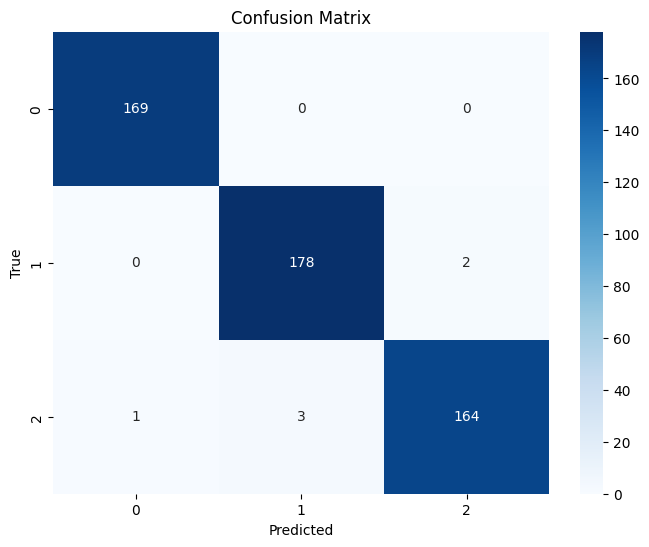

In [ ]:
# no scaling, Test size 0.2 on window 100
best_model, X_test = xgb_classifier_w_kfold(5, new_final_df, False, 0.2)

Average Train accuracy: 0.9830613748815665
Average Train mse: 0.022749763132961363
Average Train precision: 0.9831190073949599
Average Train recall: 0.983027185882858
Average Train f1: 0.9830455392674967
Average Train duration: 2.575778675079346
Average Test accuracy: 0.98568665377176
******************************************
Best Test accuracy: 0.988394584139265
Best Test MSE: 0.017408123791102514
Best Test precision: 0.9884982895507933
Best Test recall: 0.9883597883597884
Best Test f1: 0.9884118867079575


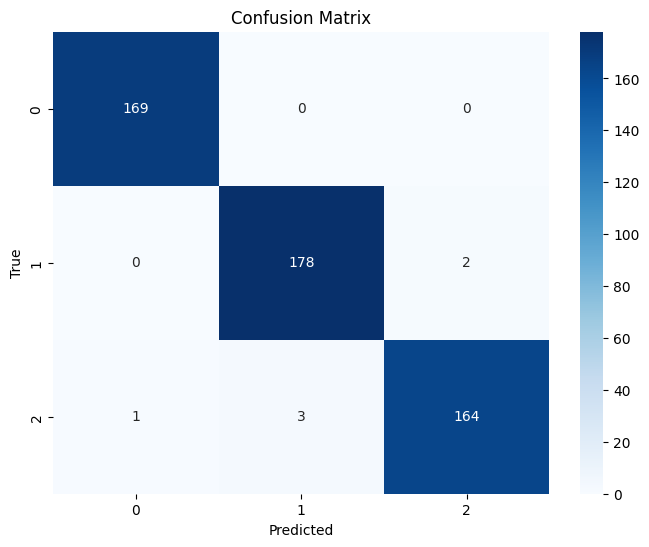

In [ ]:
# scaling, Test size 0.2 on window 100
best_model, X_test = xgb_classifier_w_kfold(5, new_final_df, True, 0.2)

[08:35:09] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


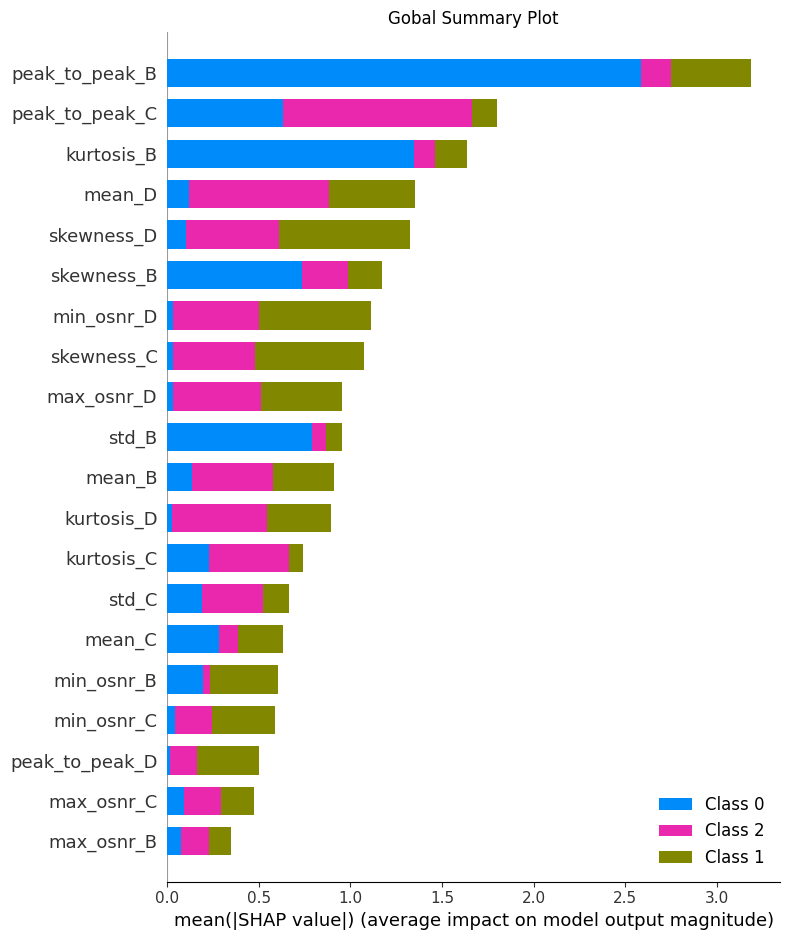

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


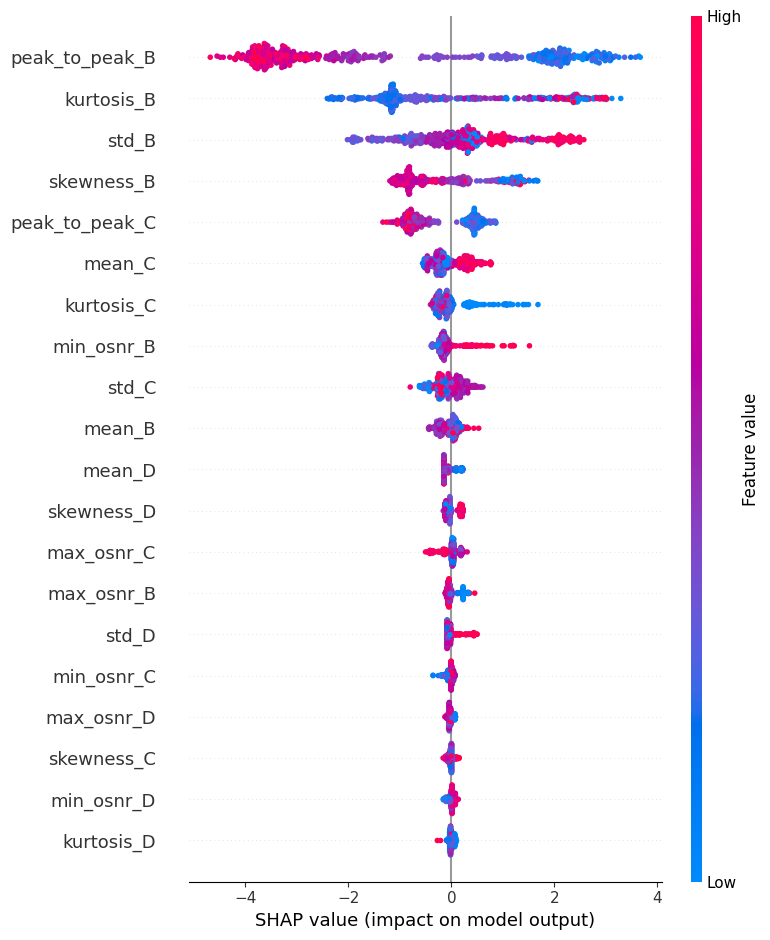

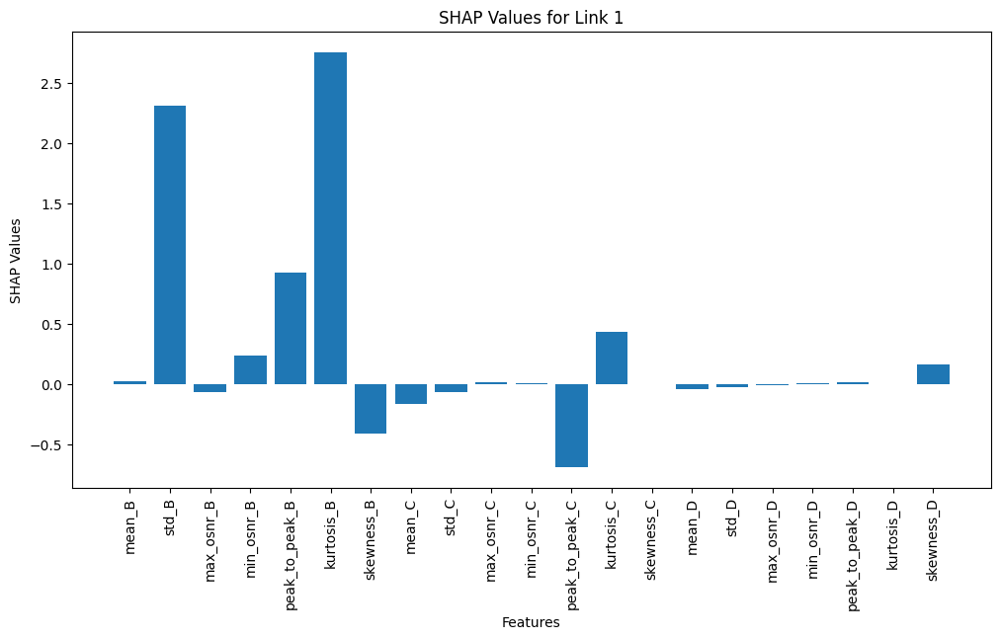

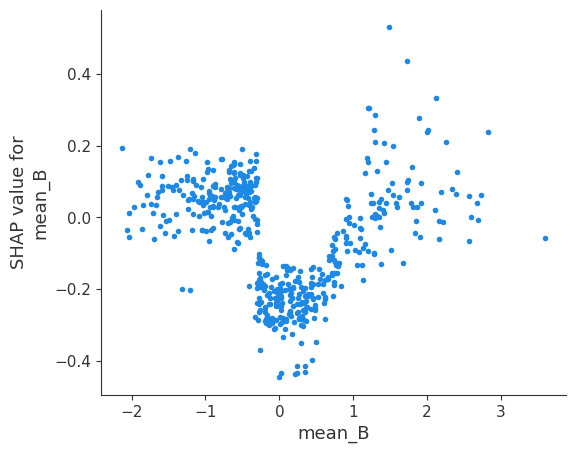

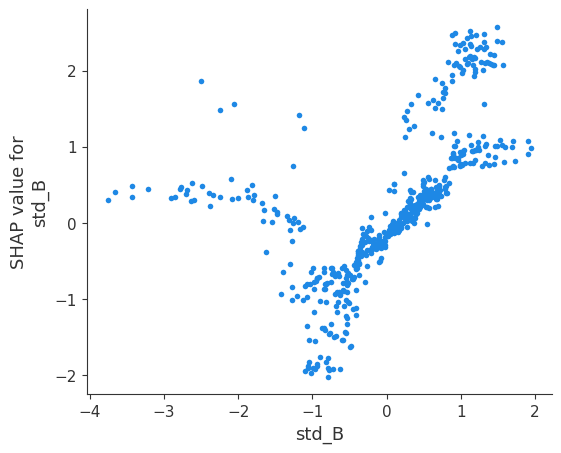

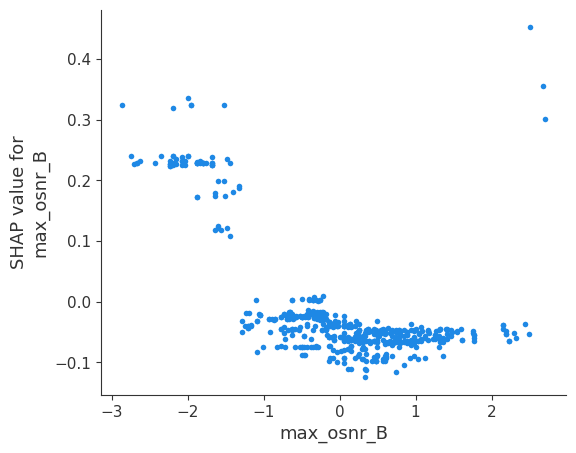

...

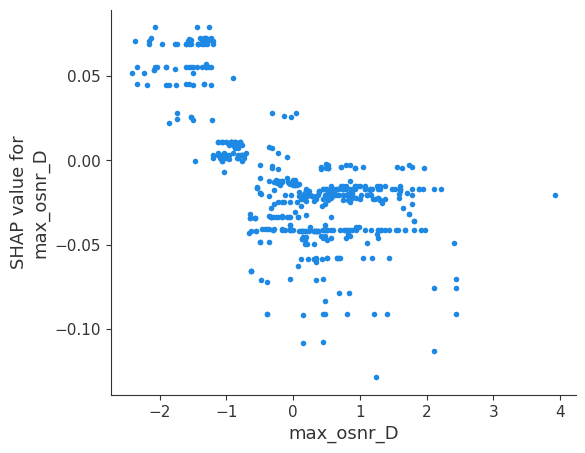

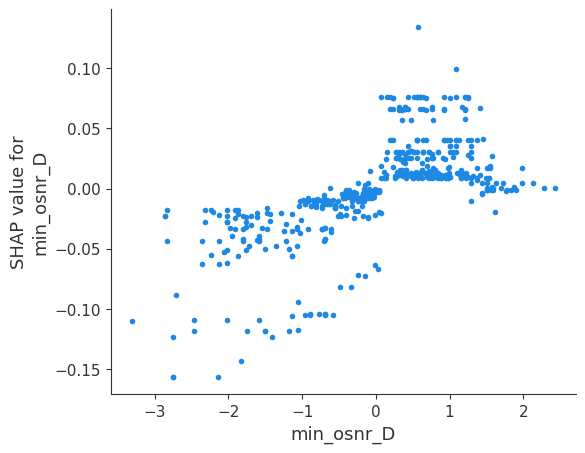

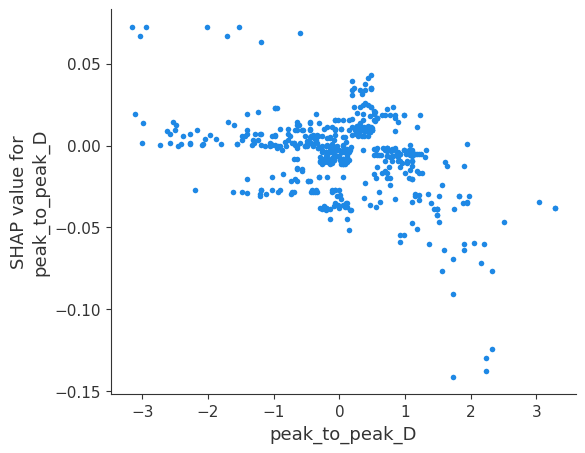

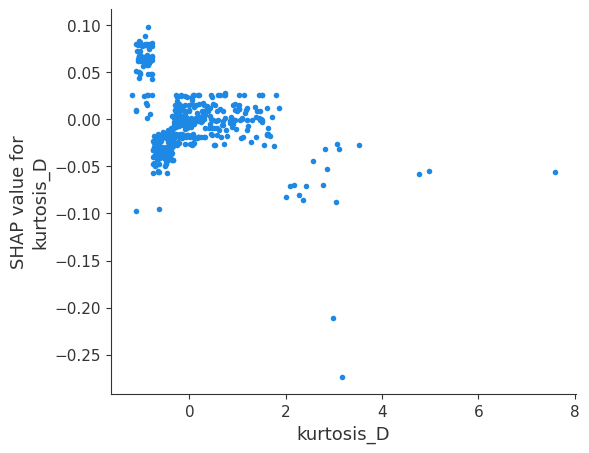

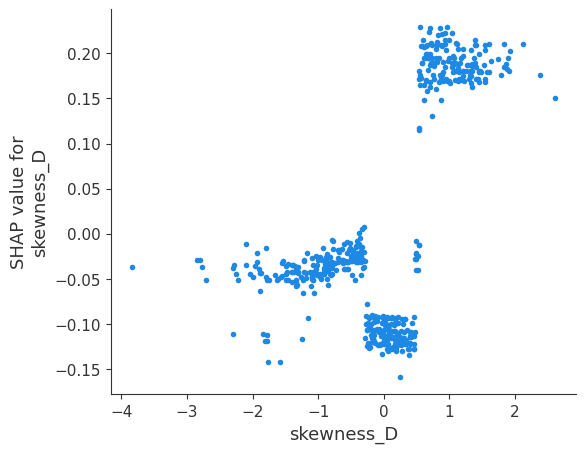

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


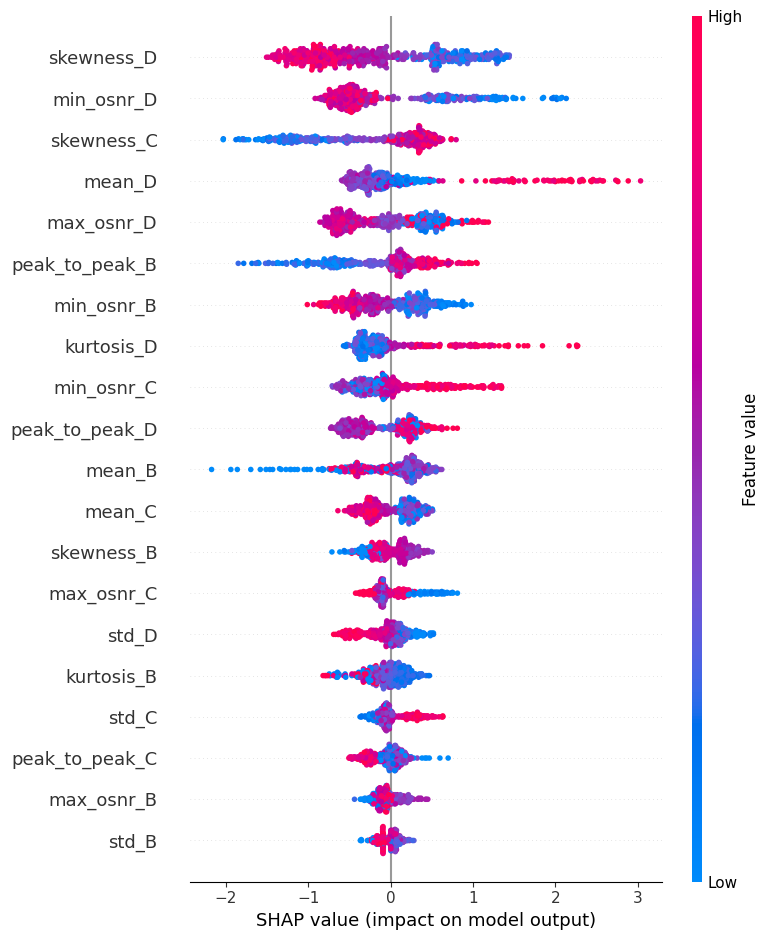

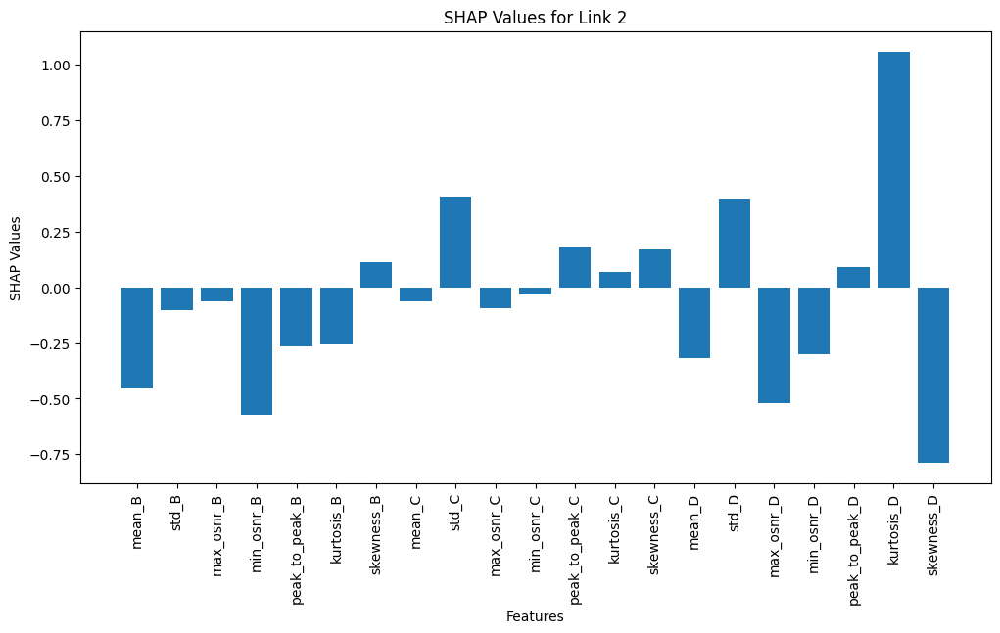

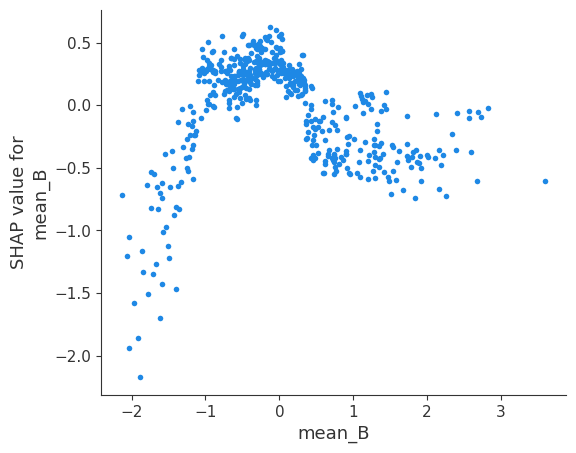

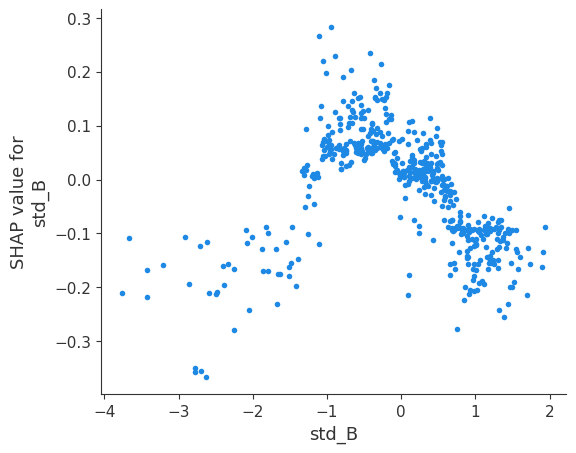

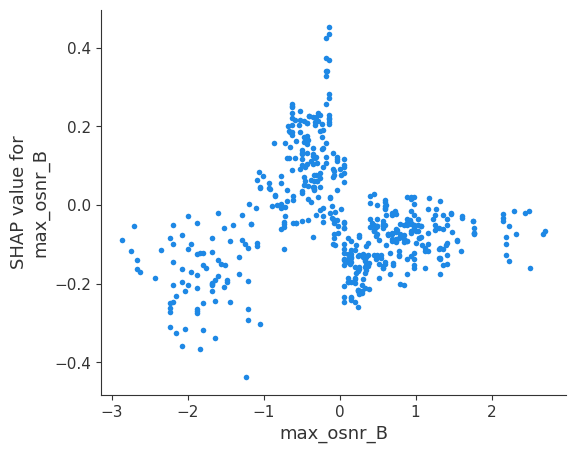

...

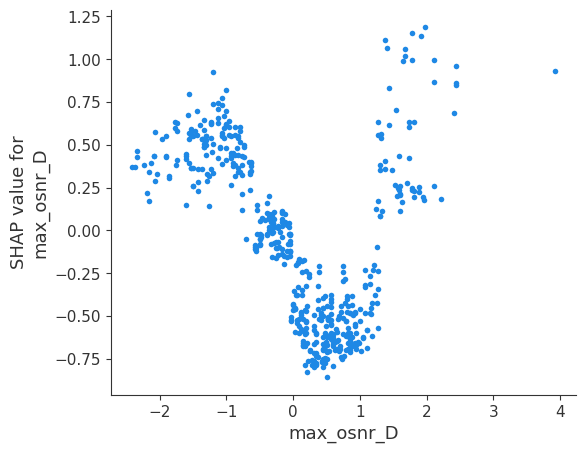

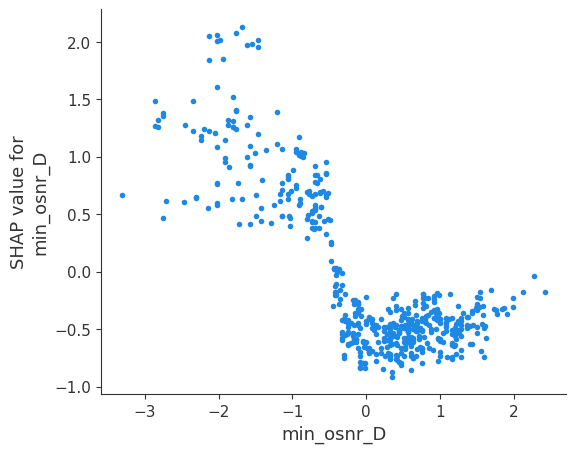

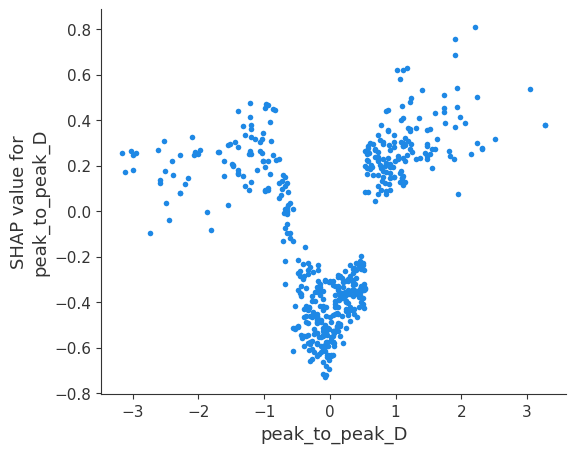

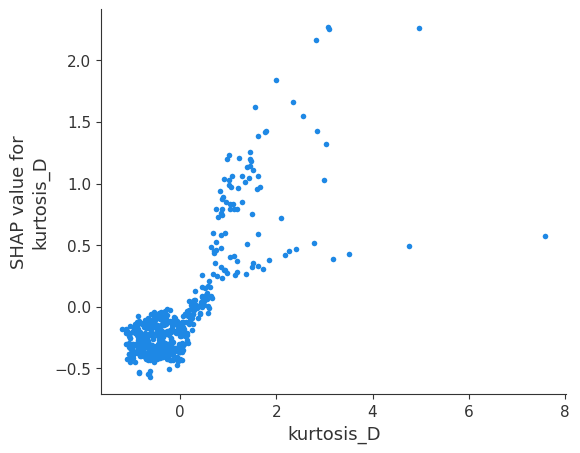

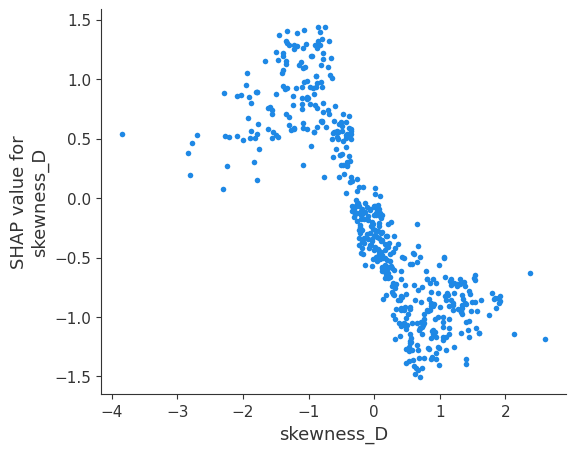

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


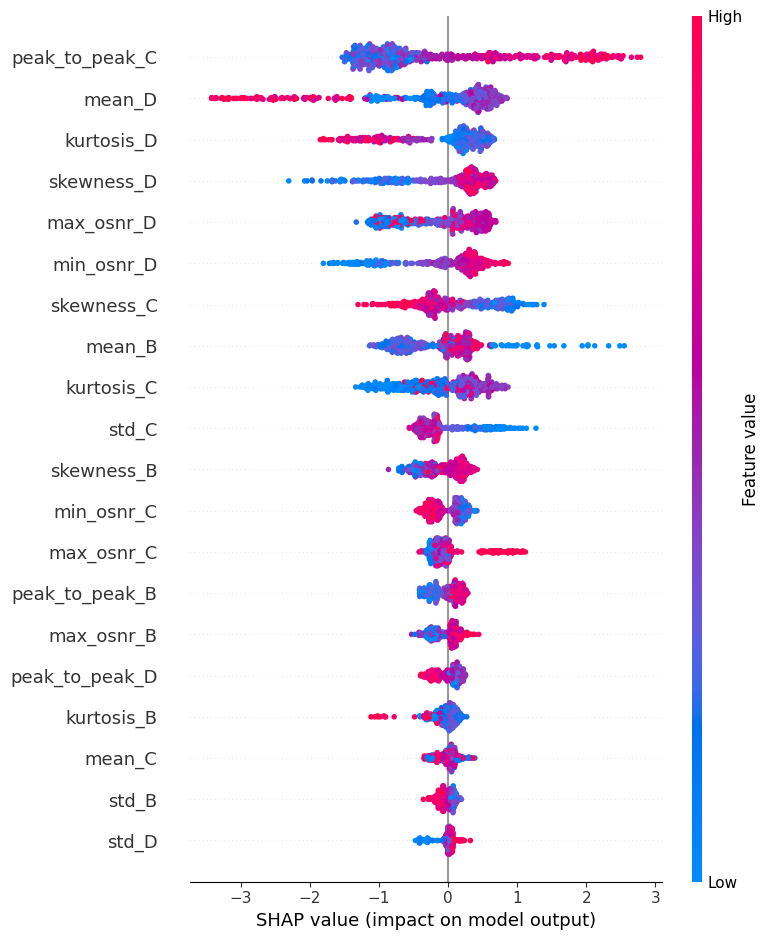

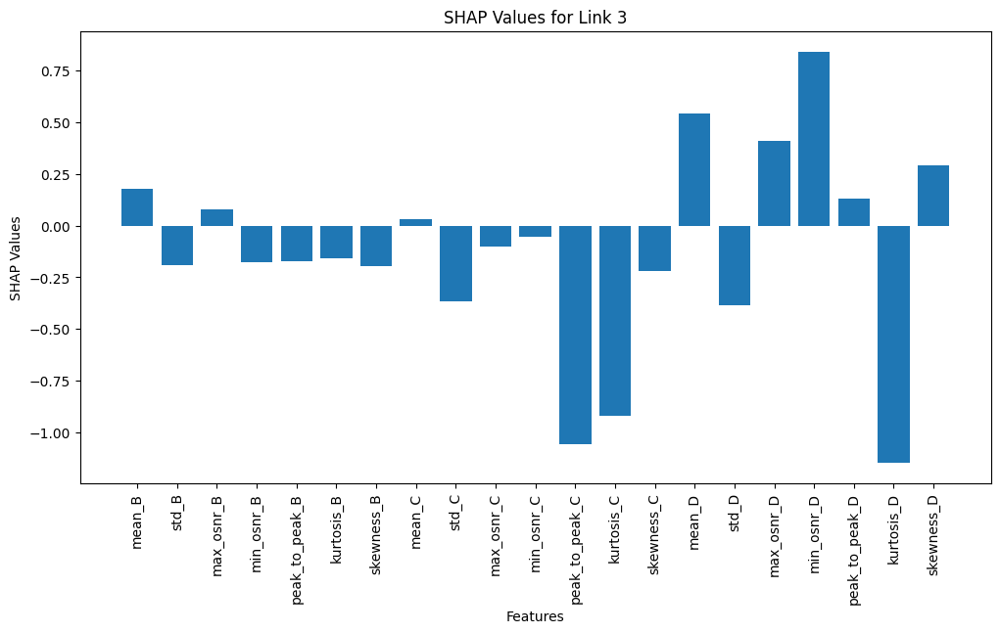

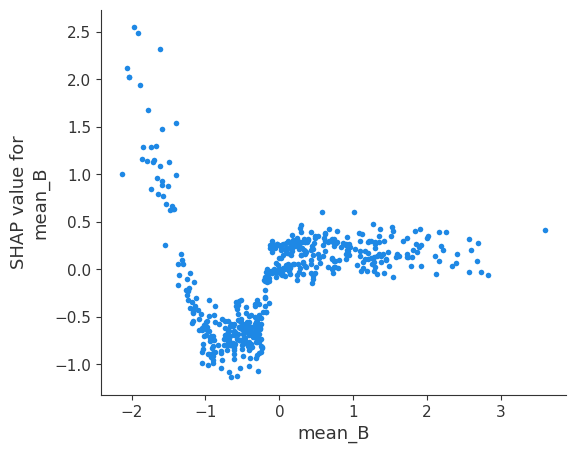

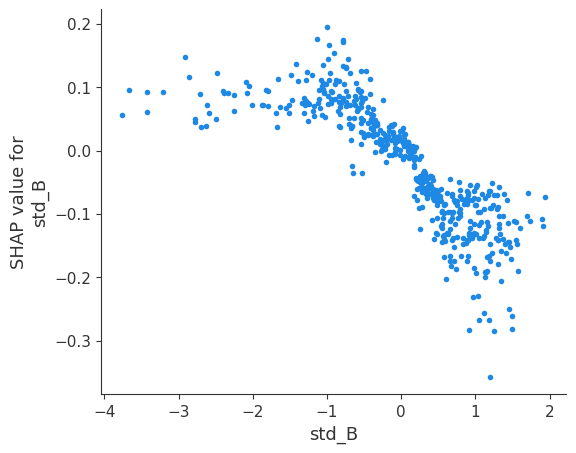

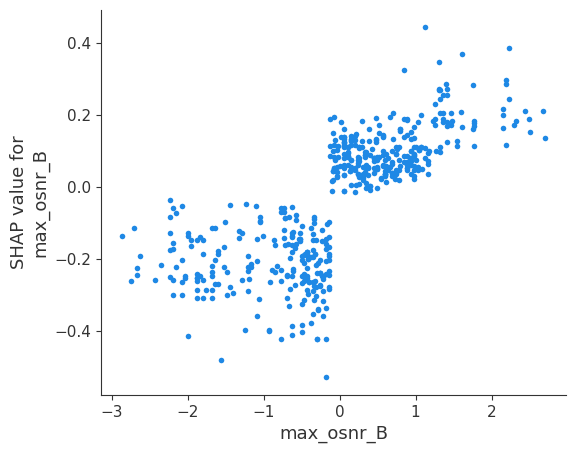

...

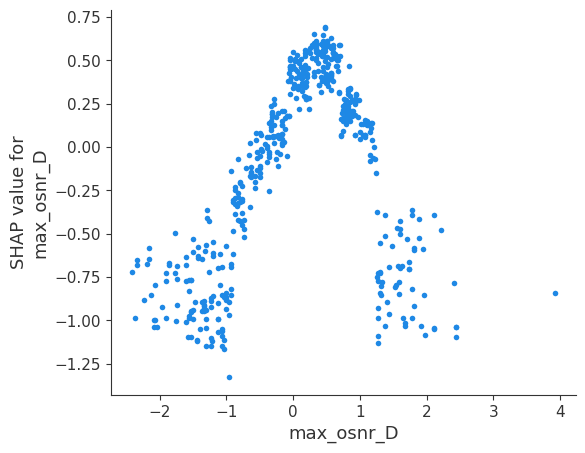

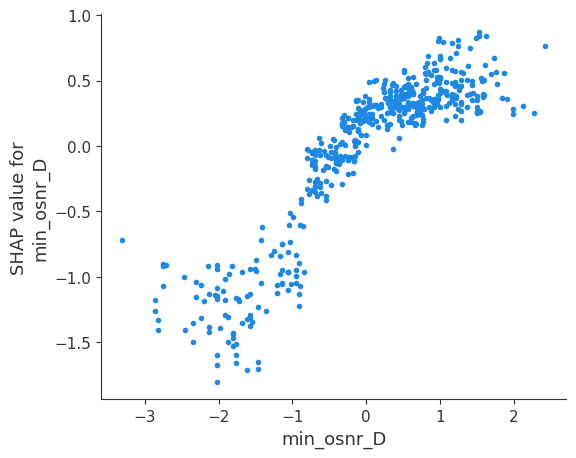

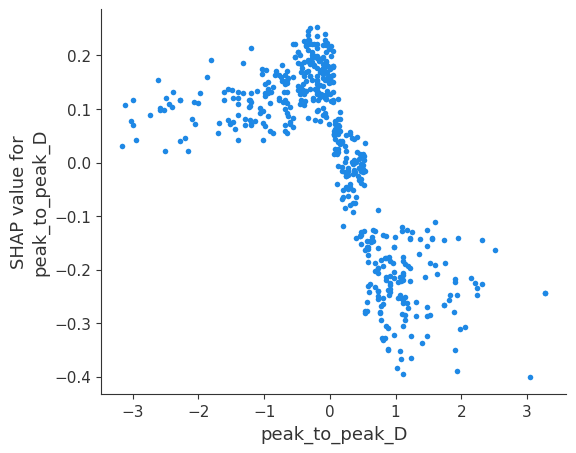

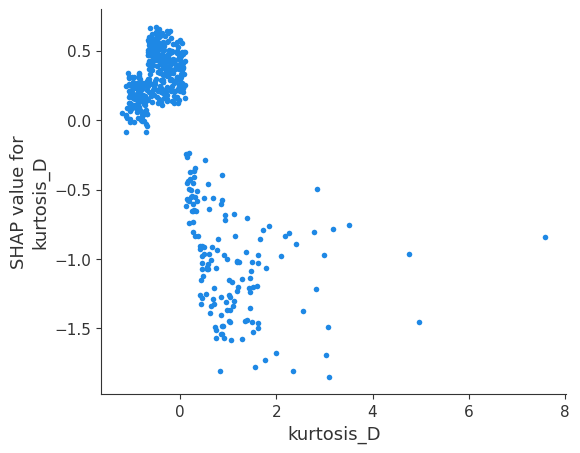

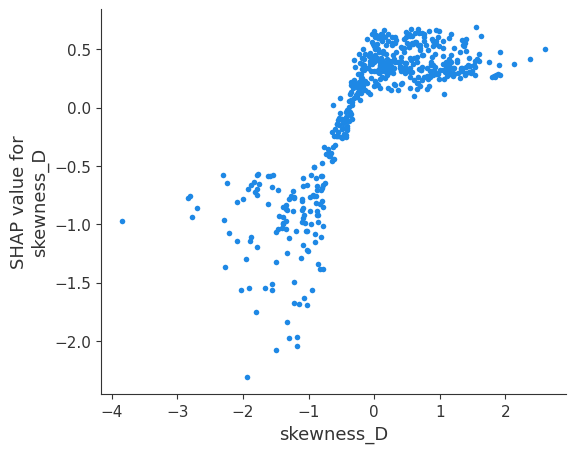

In [ ]:
shap_plots_explainable_ai_tree_explainer(best_model, X_test)

#### Single Monitoring

Average Train accuracy: 0.890110070065855
Average Train mse: 0.242047700927583
Average Train precision: 0.8908264070962015
Average Train recall: 0.8903278430142925
Average Train f1: 0.8898863114334118
Average Train duration: 1.883317232131958
Average Test accuracy: 0.9098646034816248
******************************************
Best Test accuracy: 0.9148936170212766
Best Test MSE: 0.218568665377176
Best Test precision: 0.9146368741460766
Best Test recall: 0.9137268714191791
Best Test f1: 0.9138831368775725


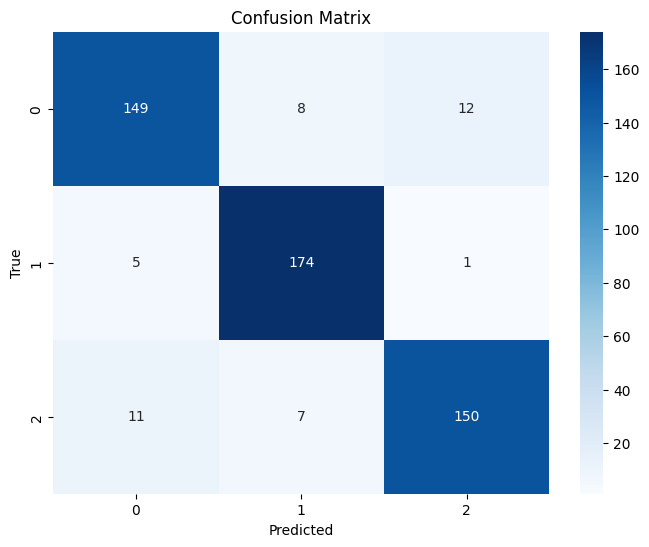

In [ ]:
# no scaling, test size=0.2
best_model, X_test = xgb_classifier_w_kfold(5, new_final_one_node_df, False, 0.2)

Average Train accuracy: 0.890110070065855
Average Train mse: 0.242047700927583
Average Train precision: 0.8908264070962015
Average Train recall: 0.8903278430142925
Average Train f1: 0.8898863114334118
Average Train duration: 1.7008069515228272
Average Test accuracy: 0.9098646034816248
******************************************
Best Test accuracy: 0.9148936170212766
Best Test MSE: 0.218568665377176
Best Test precision: 0.9146368741460766
Best Test recall: 0.9137268714191791
Best Test f1: 0.9138831368775725


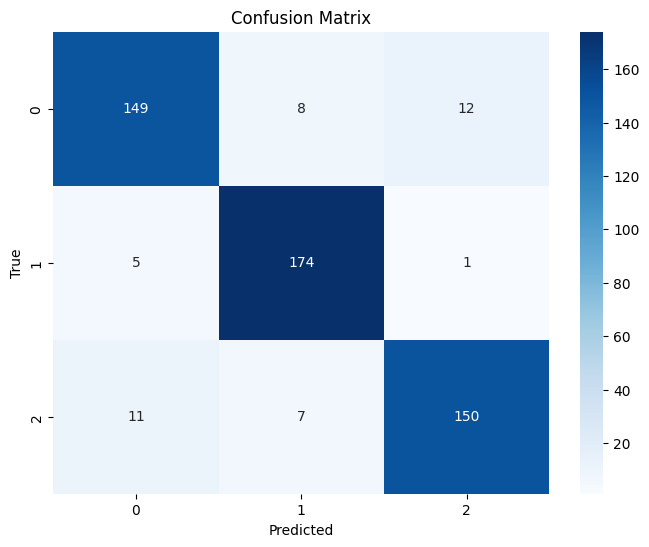

In [ ]:
# scaling, test size=0.2
best_model, X_test = xgb_classifier_w_kfold(5, new_final_one_node_df, True, 0.2)

[08:35:45] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


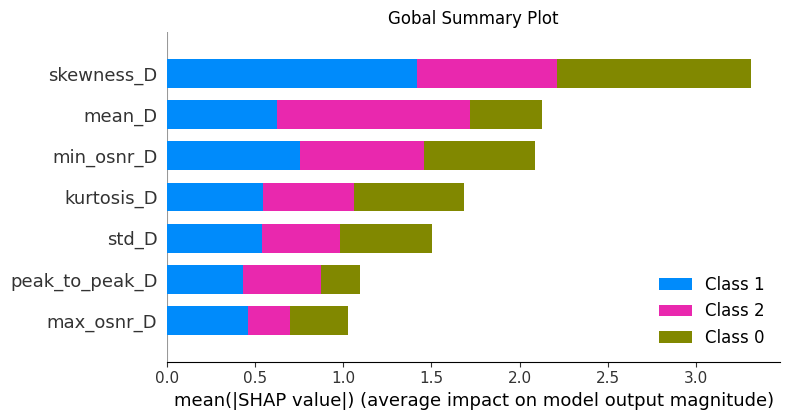

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


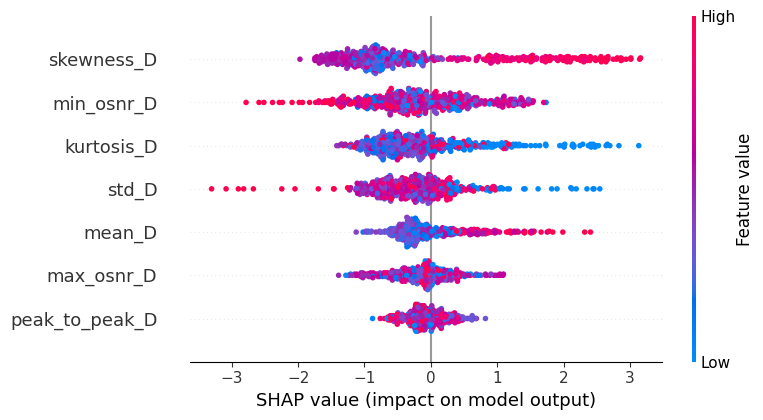

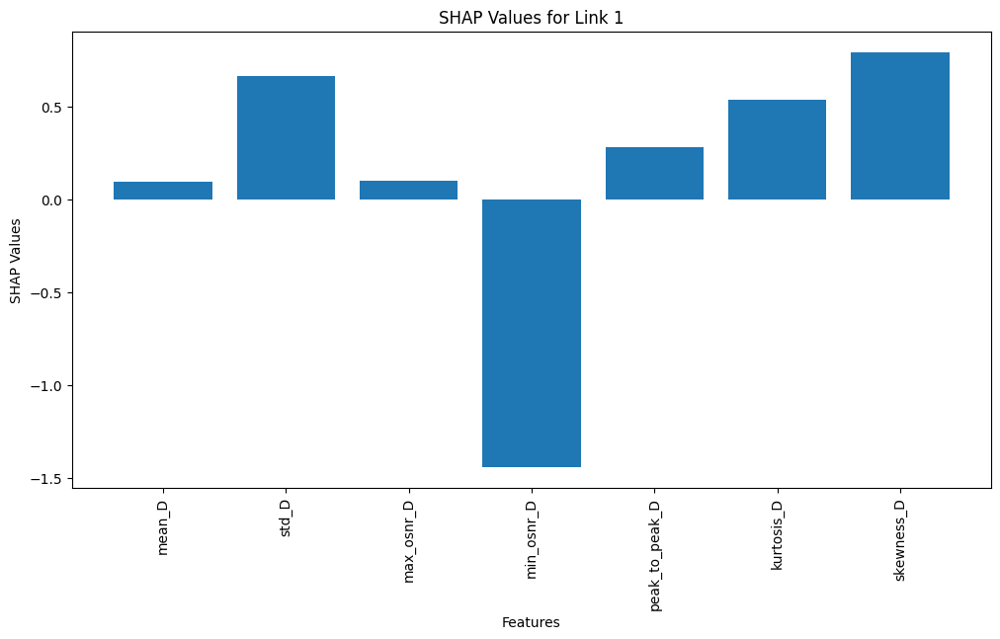

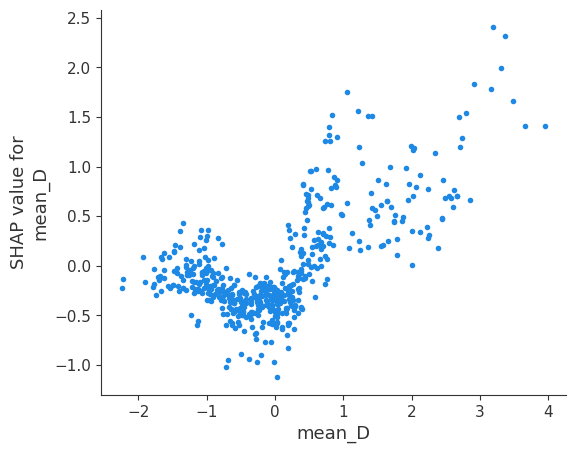

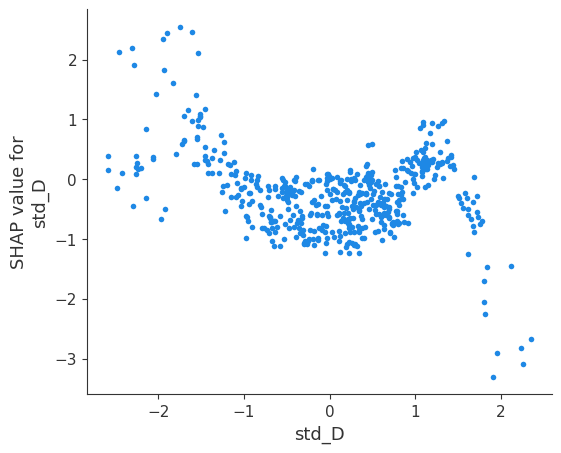

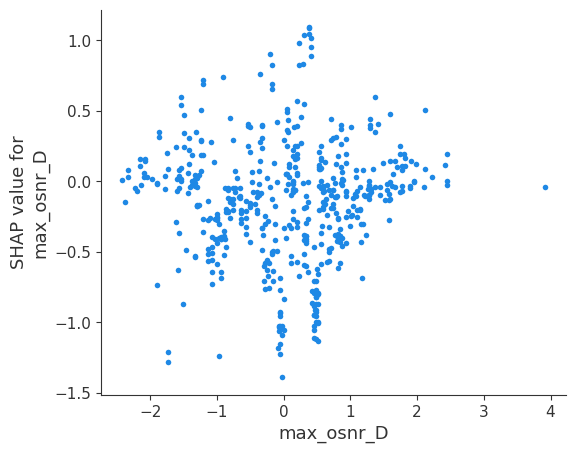

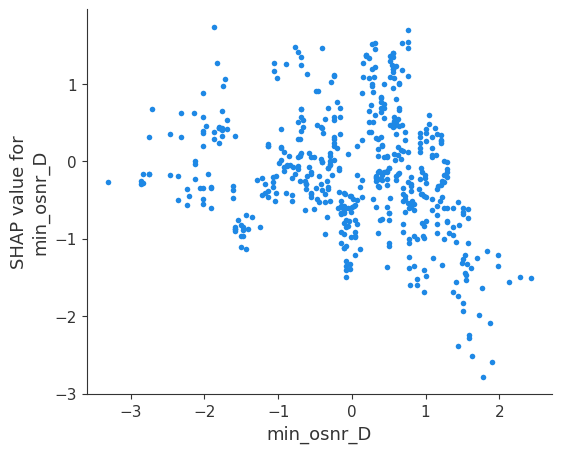

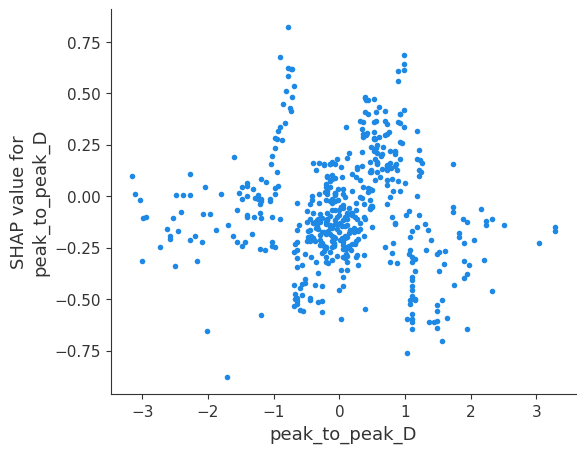

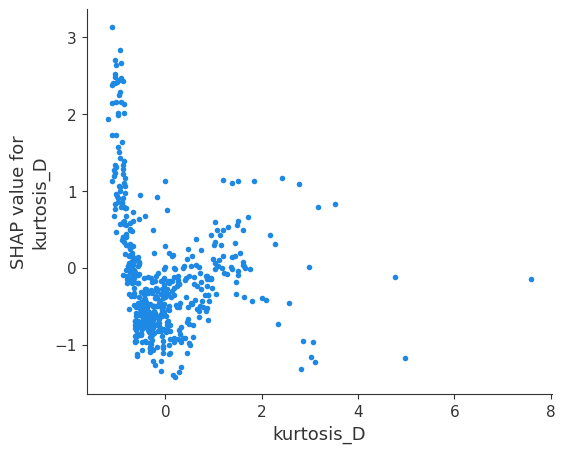

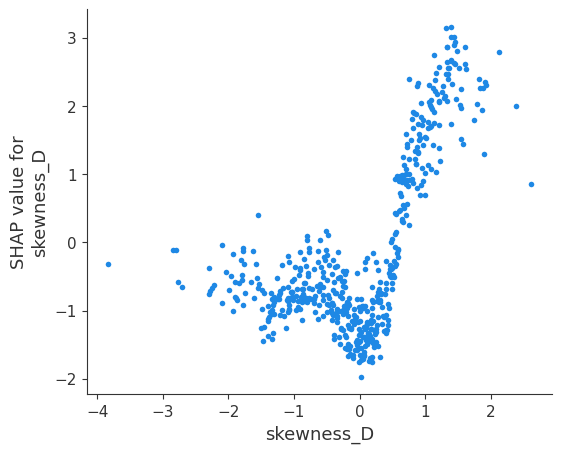

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


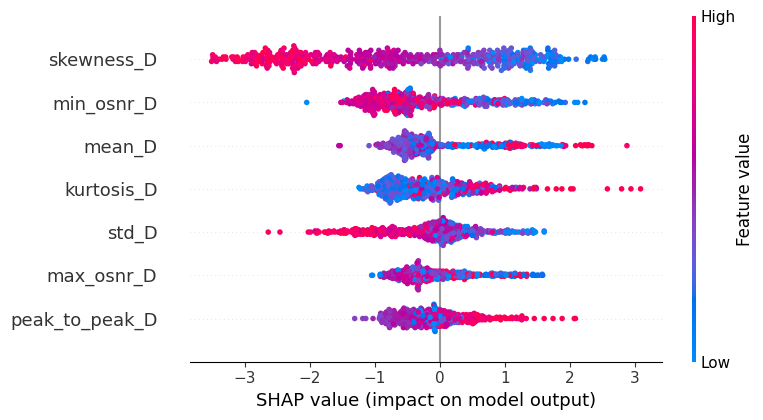

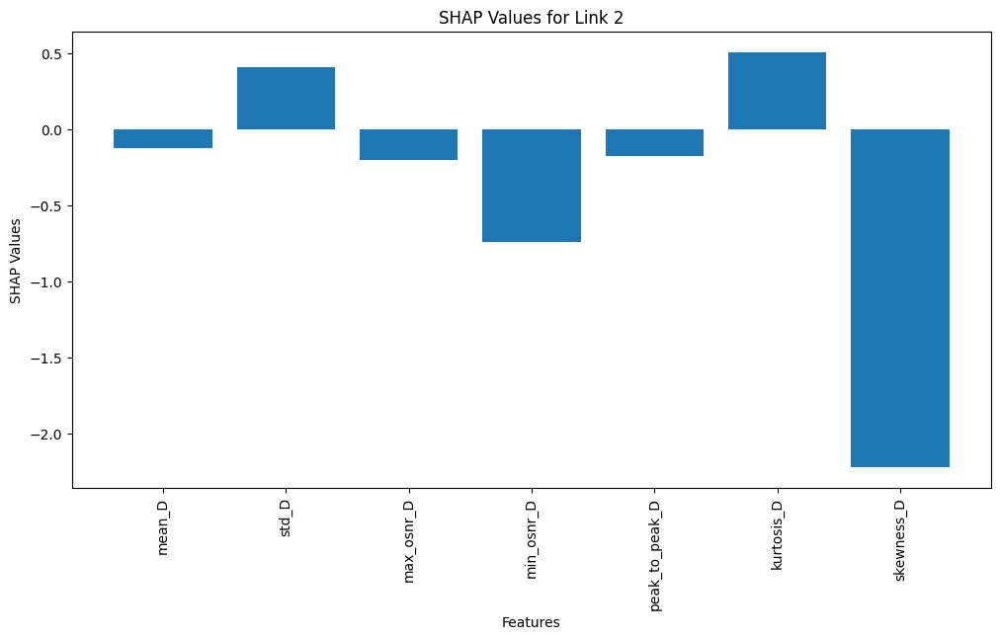

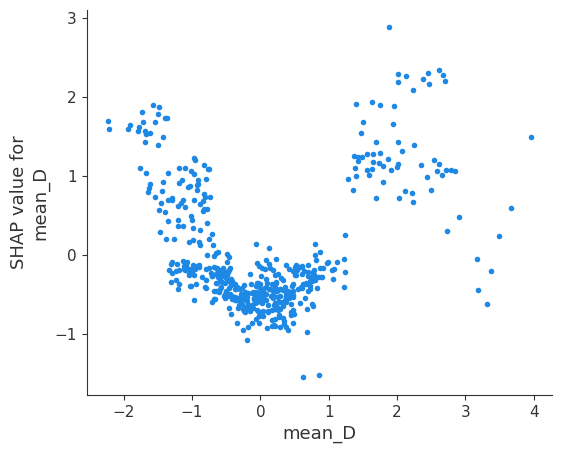

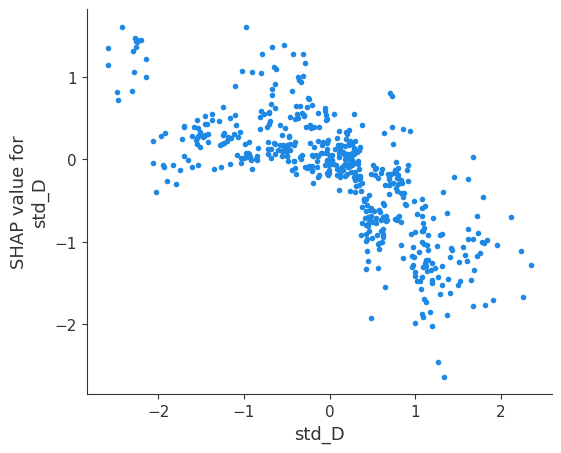

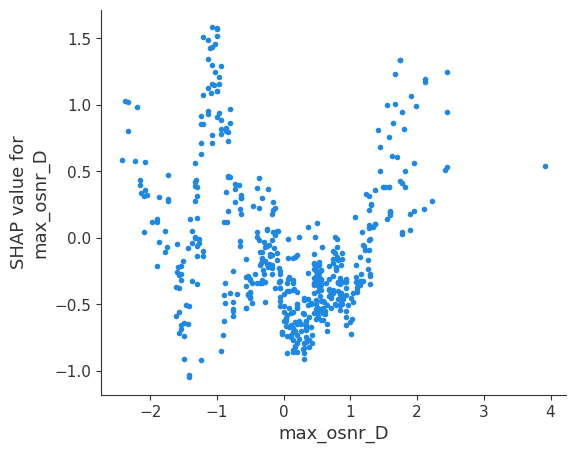

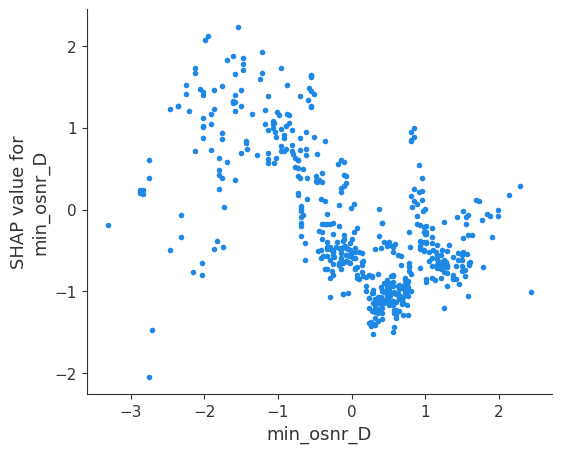

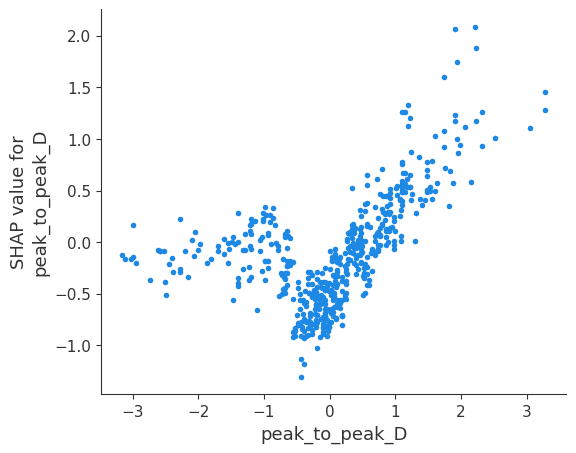

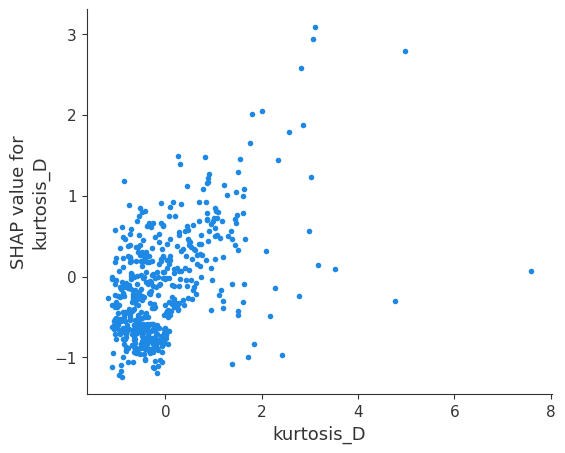

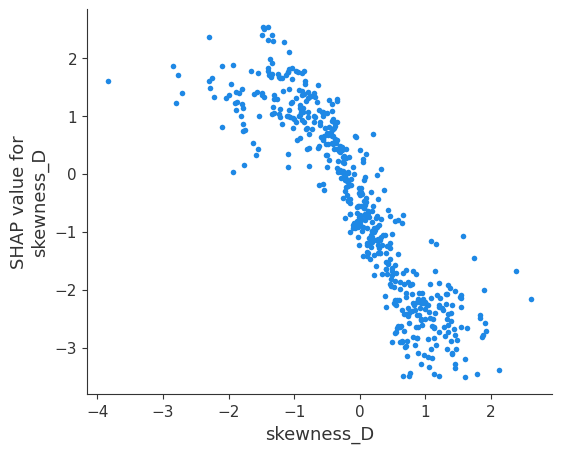

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


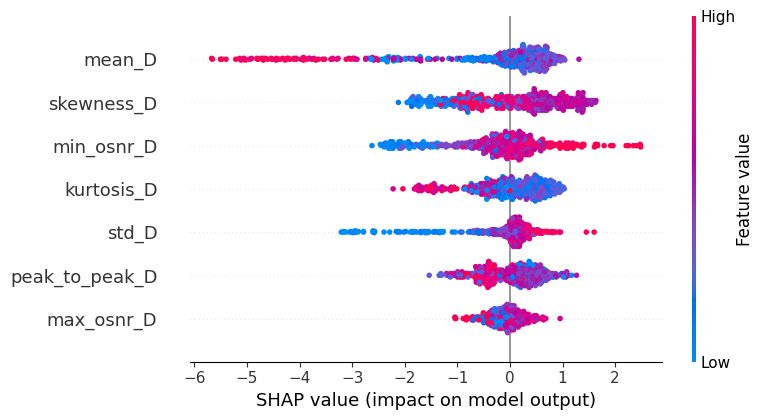

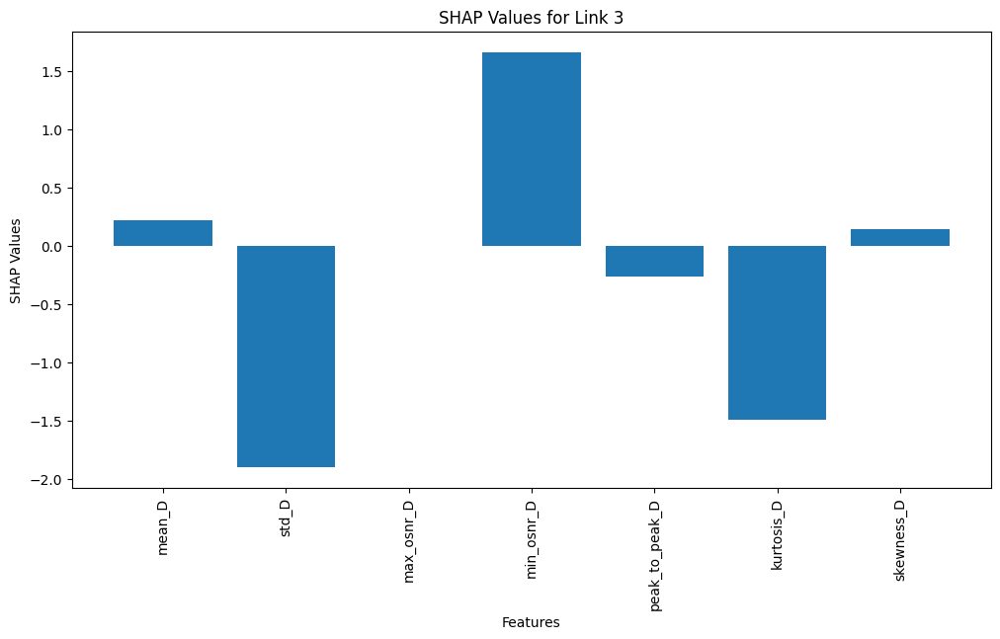

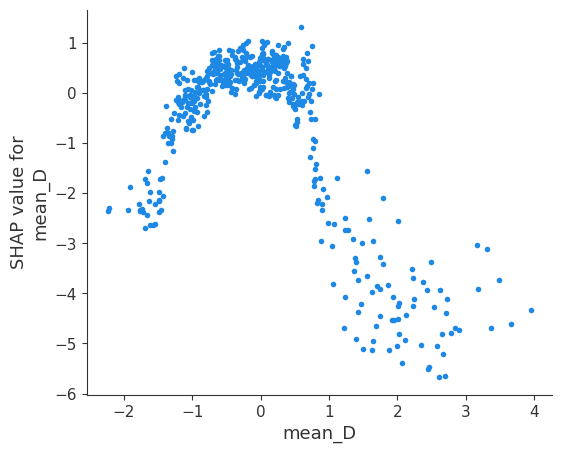

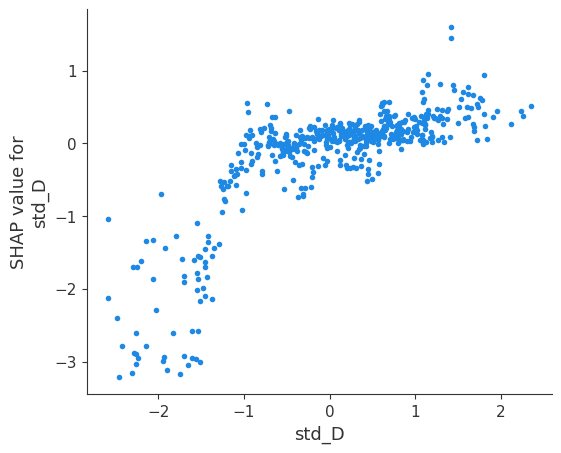

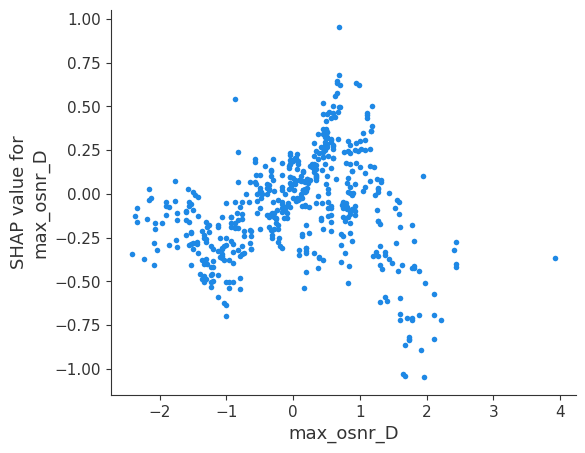

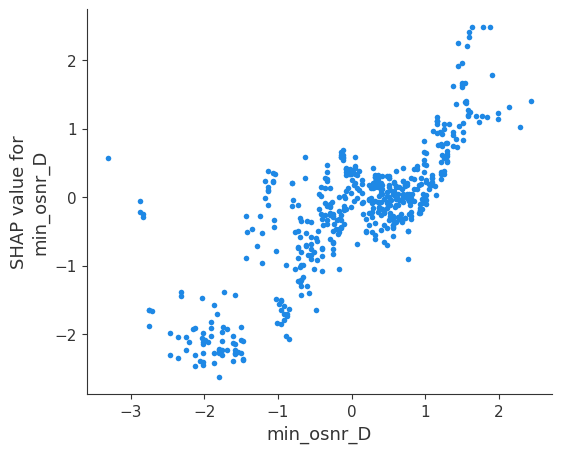

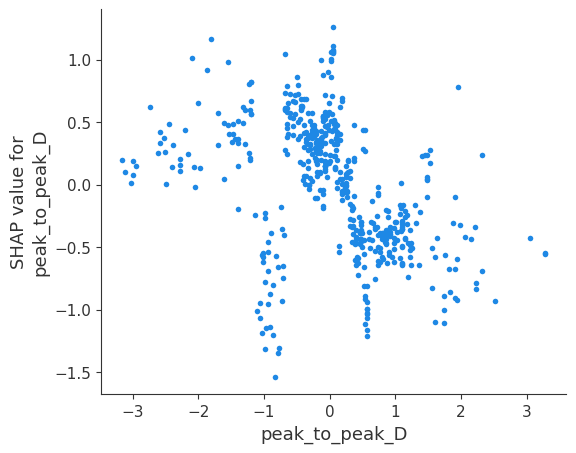

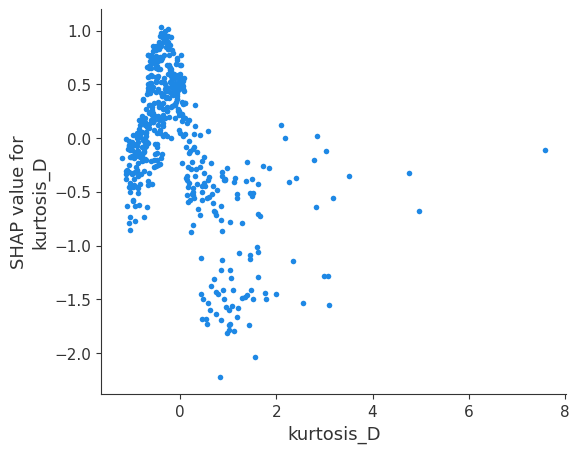

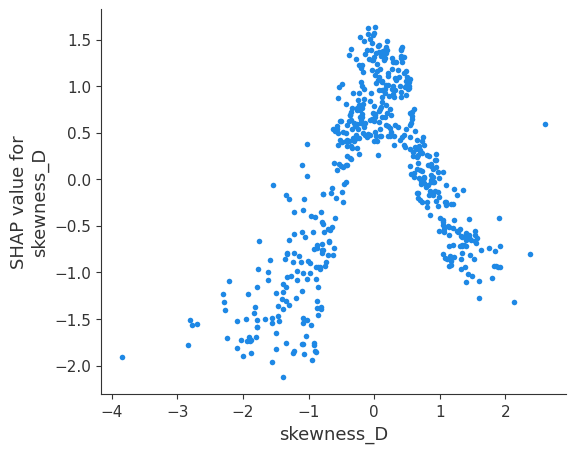

In [ ]:
shap_plots_explainable_ai_tree_explainer(best_model, X_test)

### LSTM

In [ ]:
def lstm_classifier_w_kfold(n_splits, df, is_scaled, test_size):
    """
    Classification with LSTM using k-fold cross-validation and optional scaling.
    """
    # Scale data if required
    if is_scaled:
        scaler = StandardScaler()
        df.iloc[:, :-1] = scaler.fit_transform(df.iloc[:, :-1])

    # Split features and target
    X = df.iloc[:, :-1].values
    y = LabelEncoder().fit_transform(df.iloc[:, -1])
    X = X.reshape((X.shape[0], X.shape[1], 1))  # Reshape for LSTM
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=42)

    # KFold cross-validation setup
    outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

    best_model, best_score = None, 0.0
    metrics = {'test_accuracy': [], 'mse': [], 'precision': [], 'recall': [], 'f1': [], 'train_accuracy': [], 'duration': []}

    for train_idx, test_idx in outer_skf.split(X_train, y_train):
        X_train_fold, X_test_fold = X_train[train_idx], X_train[test_idx]
        y_train_fold, y_test_fold = y_train[train_idx], y_train[test_idx]

        model = Sequential([
            LSTM(10, input_shape=(X_train_fold.shape[1], X_train_fold.shape[2])),
            Dense(len(np.unique(y)), activation='softmax')#Links that is equal to 3
        ])
        model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

        start_time = time.time()
        history = model.fit(X_train_fold, y_train_fold, epochs=10, batch_size=64, verbose=0)
        metrics['duration'].append(time.time() - start_time)

        y_pred_fold = model.predict(X_test_fold).argmax(axis=1)
        y_pred_test = model.predict(X_test).argmax(axis=1)

        # Collect fold metrics
        metrics['train_accuracy'].append(accuracy_score(y_test_fold, y_pred_fold))
        metrics['mse'].append(mean_squared_error(y_test_fold, y_pred_fold))
        metrics['precision'].append(precision_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['recall'].append(recall_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['f1'].append(f1_score(y_test_fold, y_pred_fold, average='macro'))
        metrics['test_accuracy'].append(accuracy_score(y_test, y_pred_test))

        # Track the best model
        test_accuracy = accuracy_score(y_test, y_pred_test)
        if test_accuracy > best_score:
            best_score = test_accuracy
            best_metrics = {
                'mse': mean_squared_error(y_test, y_pred_test),
                'precision': precision_score(y_test, y_pred_test, average='macro'),
                'recall': recall_score(y_test, y_pred_test, average='macro'),
                'f1': f1_score(y_test, y_pred_test, average='macro'),
            }
            best_model = model

    # Print average metrics
    print(f"Average Train accuracy: {np.mean(metrics['train_accuracy'])}")
    print(f"Average Train mse: {np.mean(metrics['mse'])}")
    print(f"Average Train precision: {np.mean(metrics['precision'])}")
    print(f"Average Train recall: {np.mean(metrics['recall'])}")
    print(f"Average Train f1: {np.mean(metrics['f1'])}")
    print(f"Average Train duration: {np.mean(metrics['duration'])}")
    print(f"Average Test accuracy: {np.mean(metrics['test_accuracy'])}")
    print("******************************************")
    print(f"Best Test accuracy: {best_score}")
    print(f"Best Test MSE: {best_metrics['mse']}")
    print(f"Best Test precision: {best_metrics['precision']}")
    print(f"Best Test recall: {best_metrics['recall']}")
    print(f"Best Test f1: {best_metrics['f1']}")

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_matrix(y_test, best_model.predict(X_test).argmax(axis=1)), annot=True, fmt='d')
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

    return best_model, X_test

#### Multiple Monitor

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Average Train accuracy: 0.656008163785799
Average Train mse: 0.6493292833330347
Average Train precision: 0.6600261776532047
Average Train recall: 0.6559498266845589
Average Train f1: 0.6557854168937088
Average Train duration: 72.10884094238281
Average Test accuracy: 0.6630335777692011
******************************************
Best Test accuracy: 0.6897722886916249
Best Test MSE: 0.5922809725974527
Best Test precision: 0.6888084626640856
Best Test recall: 0.6905788741370081
Best Test f1: 0.6878003943131032


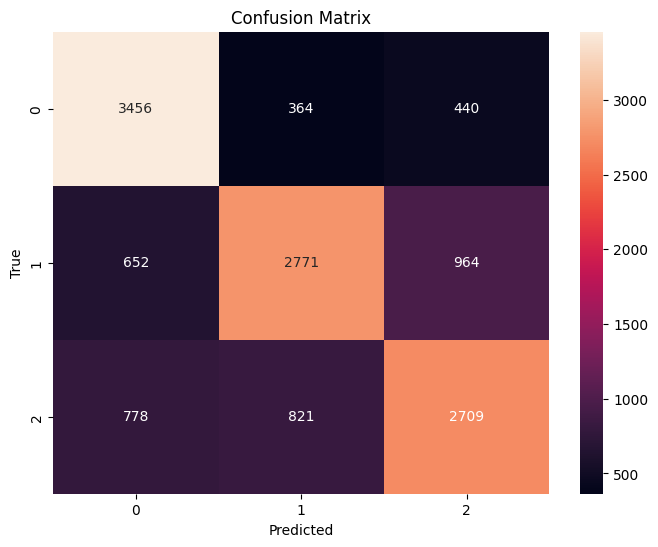

In [ ]:
# no scaling, test size=0.2
best_model, X_test = lstm_classifier_w_kfold(5, final_df, False, 0.2)

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Average Train accuracy: 0.673626551472926
Average Train mse: 0.5873645133971828
Average Train precision: 0.6761978973302749
Average Train recall: 0.6734739600233597
Average Train f1: 0.6736416135652648
Average Train duration: 72.50701961517333
Average Test accuracy: 0.6799691238903899
******************************************
Best Test accuracy: 0.7042068699343883
Best Test MSE: 0.5285218062524122
Best Test precision: 0.7037301944625799
Best Test recall: 0.7051485795525115
Best Test f1: 0.7029615648197796


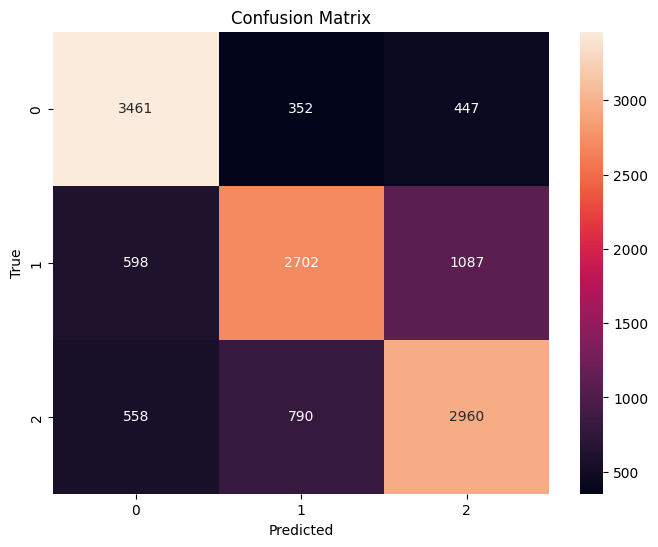

In [ ]:
# scaling, test size=0.2
best_model, X_test = lstm_classifier_w_kfold(5, final_df, True, 0.2)

#### Single Monitor

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Average Train accuracy: 0.5426686185335688
Average Train mse: 1.0050751059578595
Average Train precision: 0.5426866806453872
Average Train recall: 0.5429594188459786
Average Train f1: 0.5369148001185635
Average Train duration: 34.83951377868652
Average Test accuracy: 0.5463064453878811
******************************************
Best Test accuracy: 0.5508297954457738
Best Test MSE: 0.9593207255885758
Best Test precision: 0.5492284918743061
Best Test recall: 0.5495603346763132
Best Test f1: 0.5437108235246078


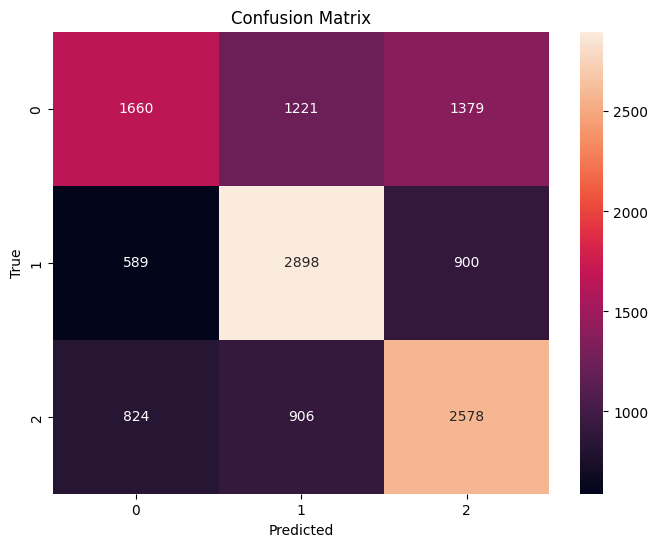

In [ ]:
# no scaling, Test size=0.2
best_model, X_test = lstm_classifier_w_kfold(5, final_one_node_df, False, 0.2)

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Average Train accuracy: 0.5440967075029758
Average Train mse: 1.0142997496548767
Average Train precision: 0.5442052278502926
Average Train recall: 0.5443547164668361
Average Train f1: 0.5397510430674404
Average Train duration: 36.27781023979187
Average Test accuracy: 0.5460439984561944
******************************************
Best Test accuracy: 0.5492859899652643
Best Test MSE: 0.978927055191046
Best Test precision: 0.5470003984835273
Best Test recall: 0.5483018753490715
Best Test f1: 0.5446031372872069


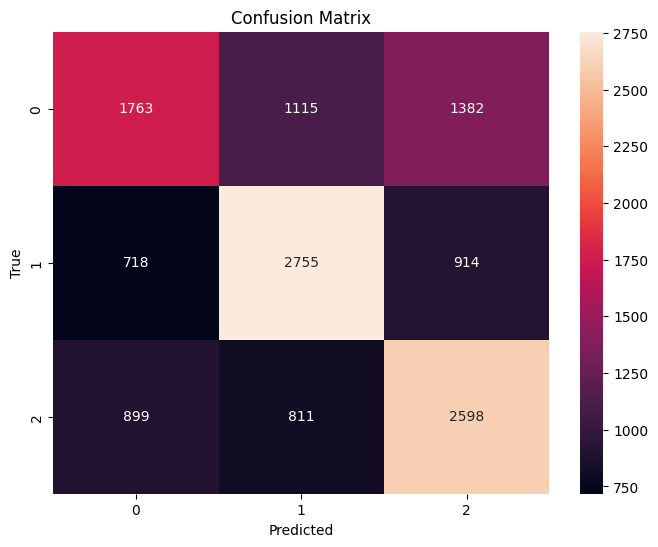

In [ ]:
# scaling, test size=0.2
best_model, X_test = lstm_classifier_w_kfold(5, final_one_node_df, True, 0.2)

#### Bigger window sizes and spacing

#### Multiple Monitor

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Average Train accuracy: 0.6650360856698366
Average Train mse: 0.7459545449228573
Average Train precision: 0.6797947318937549
Average Train recall: 0.6646097179418524
Average Train f1: 0.663742669154121
Average Train duration: 6.254923725128174
Average Test accuracy: 0.6568665377176016
******************************************
Best Test accuracy: 0.6711798839458414
Best Test MSE: 0.7756286266924565
Best Test precision: 0.6871373233506346
Best Test recall: 0.6724711186249648
Best Test f1: 0.6726256461042371


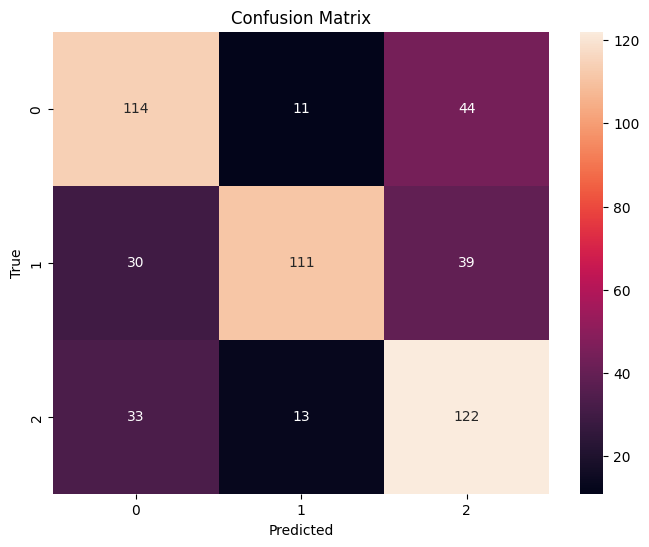

In [ ]:
# no scaling, test size=0.2
best_model, X_test = lstm_classifier_w_kfold(5, new_final_df, False, 0.2)

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Average Train accuracy: 0.6645705395889625
Average Train mse: 0.6592495116445006
Average Train precision: 0.671455020811507
Average Train recall: 0.6639702302787113
Average Train f1: 0.6613423043713883
Average Train duration: 7.324804353713989
Average Test accuracy: 0.637137330754352
******************************************
Best Test accuracy: 0.6653771760154739
Best Test MSE: 0.7292069632495164
Best Test precision: 0.6765826704866166
Best Test recall: 0.6672067248990325
Best Test f1: 0.6653711961682977


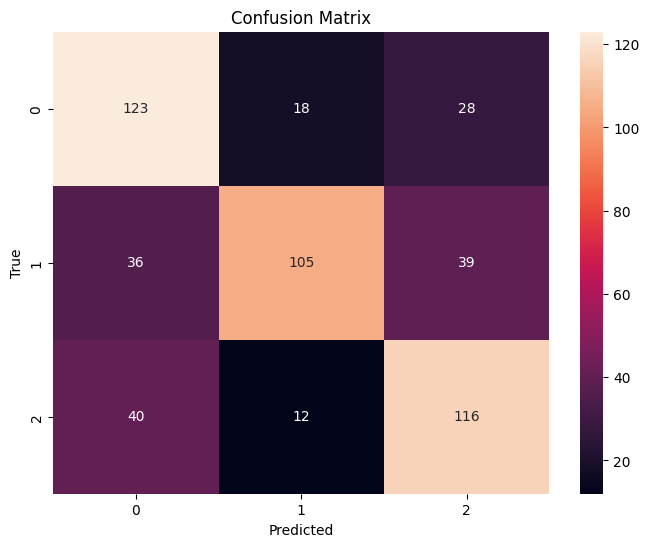

(<keras.src.engine.sequential.Sequential at 0x78f1642379a0>,
 array([[[ 1.85761061],
         [ 1.13662721],
         [ 0.45502682],
         ...,
         [-0.98384013],
         [ 1.29305033],
         [ 0.87162637]],
 
        [[ 0.01499705],
         [ 1.42742479],
         [-0.41264386],
         ...,
         [ 0.77143083],
         [-0.92085866],
         [ 0.01185499]],
 
        [[ 0.75179825],
         [-0.8128868 ],
         [ 0.33746429],
         ...,
         [ 1.81882745],
         [-0.65911017],
         [ 0.18228447]],
 
        ...,
 
        [[ 0.13898113],
         [ 0.81524579],
         [ 0.89183595],
         ...,
         [ 0.88824557],
         [-0.06373546],
         [ 0.78953353]],
 
        [[ 2.56175222],
         [ 0.90342499],
         [ 0.69166427],
         ...,
         [-0.35695764],
         [ 0.20399201],
         [ 1.38849275]],
 
        [[-0.89808377],
         [ 0.76151712],
         [-1.55639157],
         ...,
         [ 0.01917185],
         

In [ ]:
# scaling, test size=0.2
lstm_classifier_w_kfold(5, new_final_df, True, 0.2)

#### Single Monitor

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Average Train accuracy: 0.5465863321968321
Average Train mse: 1.0067152484459059
Average Train precision: 0.5453187672879729
Average Train recall: 0.5468326871977843
Average Train f1: 0.5432002187057872
Average Train duration: 39.135574388504025
Average Test accuracy: 0.5488537244307217
******************************************
Best Test accuracy: 0.5523736009262833
Best Test MSE: 0.9793130065611733
Best Test precision: 0.5497382800570851
Best Test recall: 0.5514420092274547
Best Test f1: 0.5477893644510669


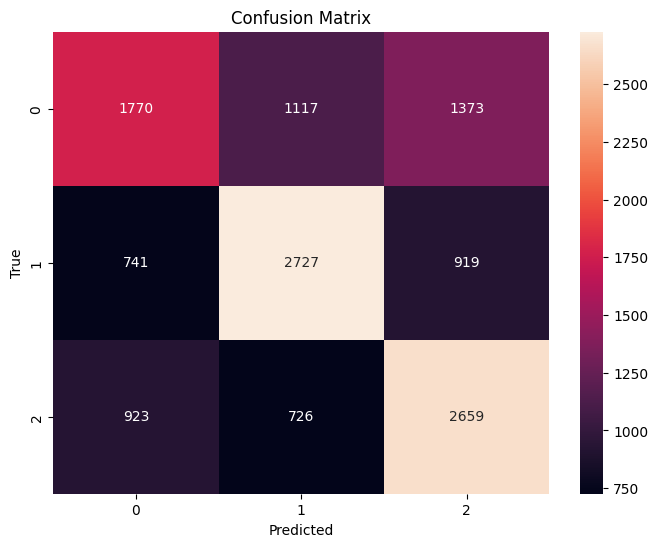

In [ ]:
#No scaling
best_model, X_test = lstm_classifier_w_kfold(5, final_one_node_df, False, 0.2)

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.


Average Train accuracy: 0.5413949734256673
Average Train mse: 1.013527859949745
Average Train precision: 0.5406490353328676
Average Train recall: 0.5416804281328182
Average Train f1: 0.5362709899127439
Average Train duration: 40.54340510368347
Average Test accuracy: 0.5449324585102276
******************************************
Best Test accuracy: 0.5472018525665766
Best Test MSE: 1.0032419915090698
Best Test precision: 0.5441528237501018
Best Test recall: 0.5461005459449771
Best Test f1: 0.5421499962301545


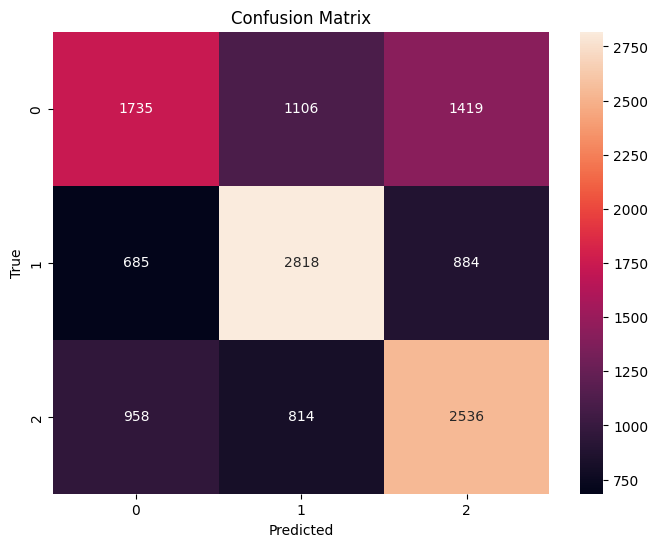

In [ ]:
#scaling
best_model, X_test = lstm_classifier_w_kfold(5, final_one_node_df, True, 0.2)

## Scenario 2 & 4: In time Train & Test Splits

In [ ]:
def in_time_spliter(df, window_size, spacing, train_ratio):
    """
    Splits the data into train and test sets based on time intervals.
    """
    range_size = 21600 // spacing
    start_point = int(range_size * train_ratio)
    window_space = window_size // spacing

    test_indices = []
    for i in range(3):
        start = start_point + i * range_size
        end = (i+1) * (range_size - window_space)
        test_indices.extend(range(start, end + 1))

    train_data = df.loc[~df.index.isin(test_indices)]
    test_data = df.loc[df.index.isin(test_indices)]

    return train_data, test_data


In [ ]:
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.8)

X_train = train_data.drop('link', axis=1)
y_train = train_data['link']

X_test = test_data.drop('link', axis=1)
y_test = test_data['link']

train_data

,mean_B,std_B,max_osnr_B,min_osnr_B,peak_to_peak_B,kurtosis_B,skewness_B,mean_C,std_C,max_osnr_C,...,kurtosis_C,skewness_C,mean_D,std_D,max_osnr_D,min_osnr_D,peak_to_peak_D,kurtosis_D,skewness_D,link
0,-0.308313,0.768904,1.300492,0.592641,0.666429,0.851030,1.850656,1.455739,1.110641,0.712523,...,-0.499545,-1.173145,-0.232642,0.084298,-0.715725,-1.875744,0.762246,2.896196,-2.413762,1
1,-0.308313,0.768904,1.300492,0.592641,0.666429,0.851030,1.850656,1.484404,1.016354,0.712523,...,-0.473361,-1.173503,-0.583870,0.669715,-0.715725,-1.875744,0.762246,0.375436,-1.535870,1
2,-0.966433,-0.495913,0.364254,0.592641,-0.145393,4.275178,3.079795,1.222842,1.352940,0.712523,...,-0.989790,-0.723779,-1.103689,0.860371,-0.715725,-1.875744,0.762246,-0.582473,-0.910658,1
3,-0.491442,0.340924,0.439153,0.592641,-0.080447,0.537505,1.729170,1.409160,0.847593,0.712523,...,-0.994429,-0.709205,-0.995978,0.545242,-0.715725,-1.073211,0.157124,-0.719434,-0.776250,1
4,-0.434214,0.315446,0.439153,0.592641,-0.080447,0.478164,1.670450,1.154764,0.706732,0.712523,...,-1.049111,-0.324890,-0.883585,0.726955,-0.715725,-1.073211,0.157124,-0.770841,-0.722432,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60477,-0.478548,0.701159,0.799427,-0.885548,1.382397,0.166698,0.320495,0.114617,1.055937,0.200777,...,0.300050,-1.367262,-0.130137,-0.641862,-0.840147,0.342739,-1.023883,-1.076461,-0.408457,3
60478,-0.384700,0.705058,0.799427,-0.885548,1.382397,0.122756,0.162293,0.152371,0.958604,0.200777,...,0.511168,-1.430686,-0.349478,-0.654570,-0.840147,0.342739,-1.023883,-1.103016,0.112423,3
60479,-0.257336,0.505550,0.799427,-0.885548,1.382397,0.439137,0.180695,0.138213,0.944611,0.200777,...,0.519548,-1.419884,-0.367457,-0.616232,-0.840147,0.342739,-1.023883,-1.095436,0.085776,3
64771,0.399596,-1.037827,0.229161,1.167128,-0.709646,1.147588,1.222858,-1.990211,1.445360,0.677841,...,1.830248,1.790785,-1.762610,-0.300378,-0.621591,-0.801640,0.038121,0.881857,1.258881,3


In [ ]:
# scatter plots for train and test data to visualize their distributions
def scatter_plot_train_test(X_train, X_test, y_train, y_test):
    fig, ax = plt.subplots()
    ax.scatter(X_train.index, y_train, color='blue', label='Train')
    ax.scatter(X_test.index, y_test, color='red', label='Test')
    ax.set_xlabel('Data Index')
    ax.set_ylabel('Y')
    ax.legend()
    ax.set_title('Train vs Test Data Scatter Plot')

    plt.show()

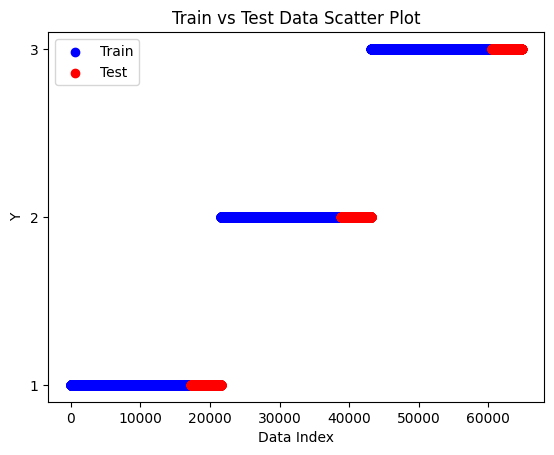

In [ ]:
scatter_plot_train_test(X_train, X_test, y_train, y_test)

### Logistic Regression

In [ ]:
def in_time_logistic_classifier_w_kfold(n_splits, train_df, test_df, is_scaled):
    """
    Classification with Logistic Regression
    """
    # shuffle the datasets
    train_df = train_df.sample(frac=1, random_state=42)
    test_df = test_df.sample(frac=1, random_state=42)

    train_df.reset_index(drop=True, inplace=True)
    test_df.reset_index(drop=True, inplace=True)

    label_encoder = LabelEncoder()
    X_train, y_train = train_df.drop('link', axis=1), label_encoder.fit_transform(train_df['link'])
    X_test, y_test = test_df.drop('link', axis=1), label_encoder.fit_transform(test_df['link'])

    cols = X_train.columns

    if is_scaled:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    X_train = pd.DataFrame(X_train, columns=cols)
    X_test = pd.DataFrame(X_test, columns=cols)

    outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

    test_accuracies, train_accuracies, mse_scores, precision_scores, recall_scores, f1_scores, training_durations = [], [], [], [], [], [], []
    best_model, best_score = None, 0.0

    for train_index, test_index in outer_skf.split(X_train, y_train):
        X_train_fold, X_val_fold = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train_fold, y_val_fold = y_train[train_index], y_train[test_index]

        model = LogisticRegression(multi_class='multinomial', solver='sag')

        start_time = time.time()
        model.fit(X_train_fold, y_train_fold)
        training_duration = time.time() - start_time

        y_pred_val = model.predict(X_val_fold)
        train_accuracies.append(accuracy_score(y_val_fold, y_pred_val))
        mse_scores.append(mean_squared_error(y_val_fold, y_pred_val))
        precision_scores.append(precision_score(y_val_fold, y_pred_val, average='macro'))
        recall_scores.append(recall_score(y_val_fold, y_pred_val, average='macro'))
        f1_scores.append(f1_score(y_val_fold, y_pred_val, average='macro'))

        y_pred_test = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred_test)
        test_accuracies.append(accuracy)

        if accuracy > best_score:
            best_score = accuracy
            best_model = model

    avg_metrics = {
        "Average Train Accuracy": np.mean(train_accuracies),
        "Average Train MSE": np.mean(mse_scores),
        "Average Train Precision": np.mean(precision_scores),
        "Average Train F1": np.mean(f1_scores),
        "Average Train Duration": np.mean(training_durations),
        "Average Test Accuracy": np.mean(test_accuracies)
    }

    for metric, value in avg_metrics.items():
        print(f"{metric}: {value:.4f}")

    print(f"Best Test Accuracy: {best_score:.4f}")

    y_pred_best = best_model.predict(X_test)
    confusion_best = confusion_matrix(y_test, y_pred_best)
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

    return best_model, X_train, X_test

#### Multiple Monitor

Mean of empty slice.
invalid value encountered in scalar divide


Average Train Accuracy: 0.6711
Average Train MSE: 0.5550
Average Train Precision: 0.6684
Average Train F1: 0.6693
Average Train Duration: nan
Average Test Accuracy: 0.5972
Best Test Accuracy: 0.6002


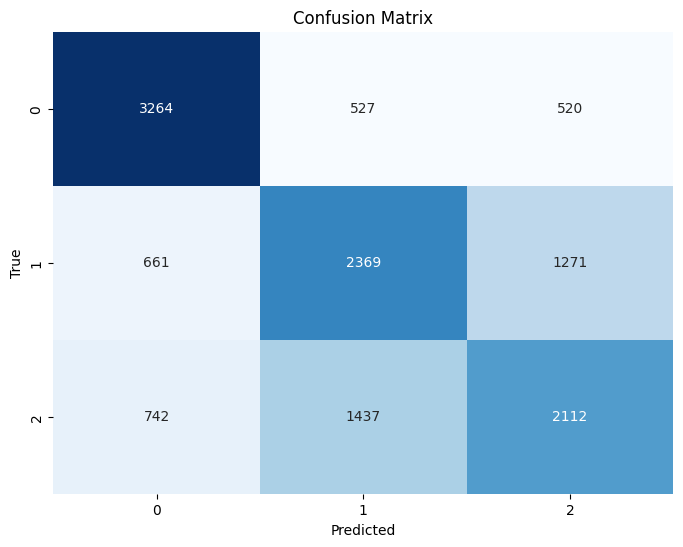

In [ ]:
# no scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.8)
best_model, X_train, X_test = in_time_logistic_classifier_w_kfold(5, train_data, test_data, False)

Average Train Accuracy: 0.6711
Average Train MSE: 0.5551
Average Train Precision: 0.6684
Average Train F1: 0.6692
Average Train Duration: nan
Average Test Accuracy: 0.5970
Best Test Accuracy: 0.6000


Mean of empty slice.
invalid value encountered in scalar divide


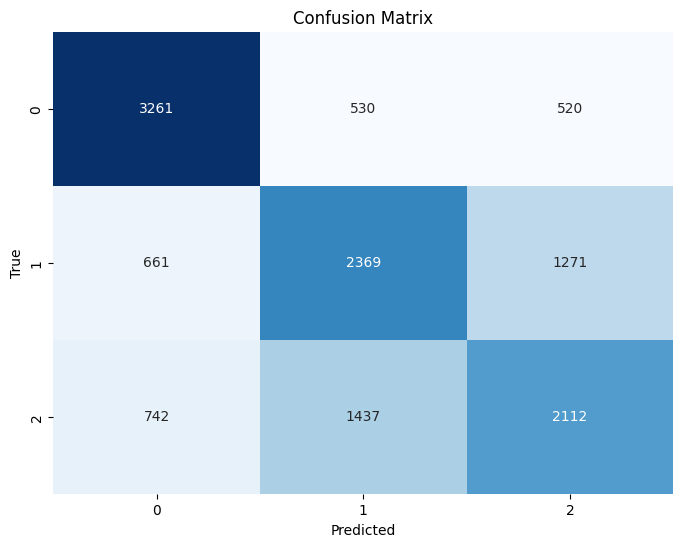

In [ ]:
# scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.8)
best_model, X_train, X_test = in_time_logistic_classifier_w_kfold(5, train_data, test_data, True)

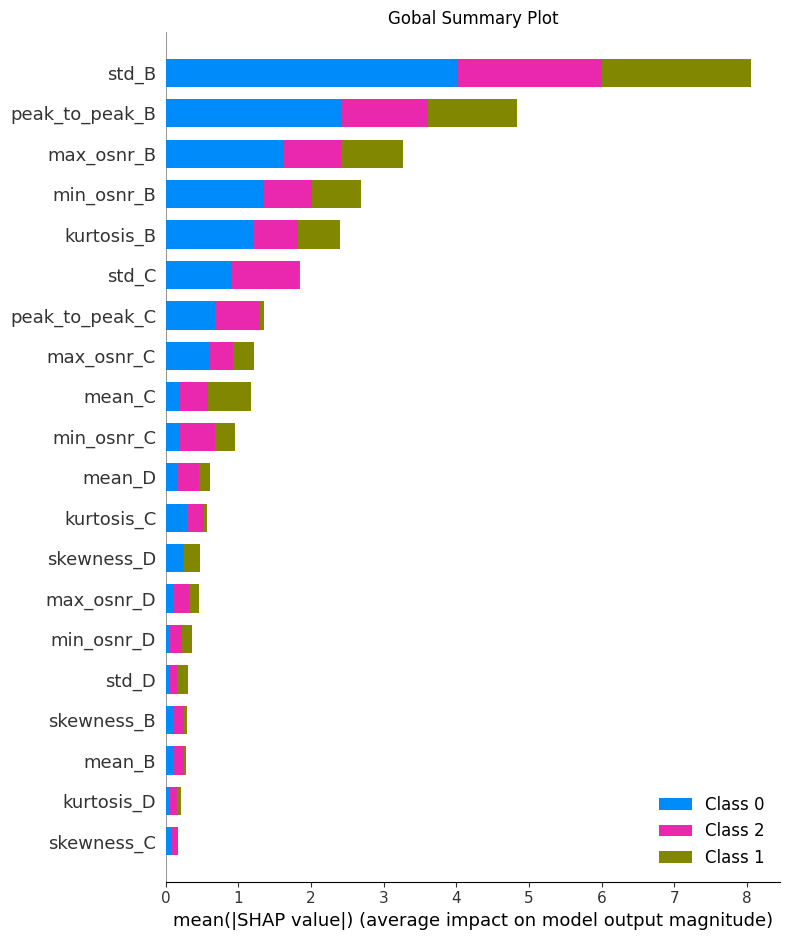

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


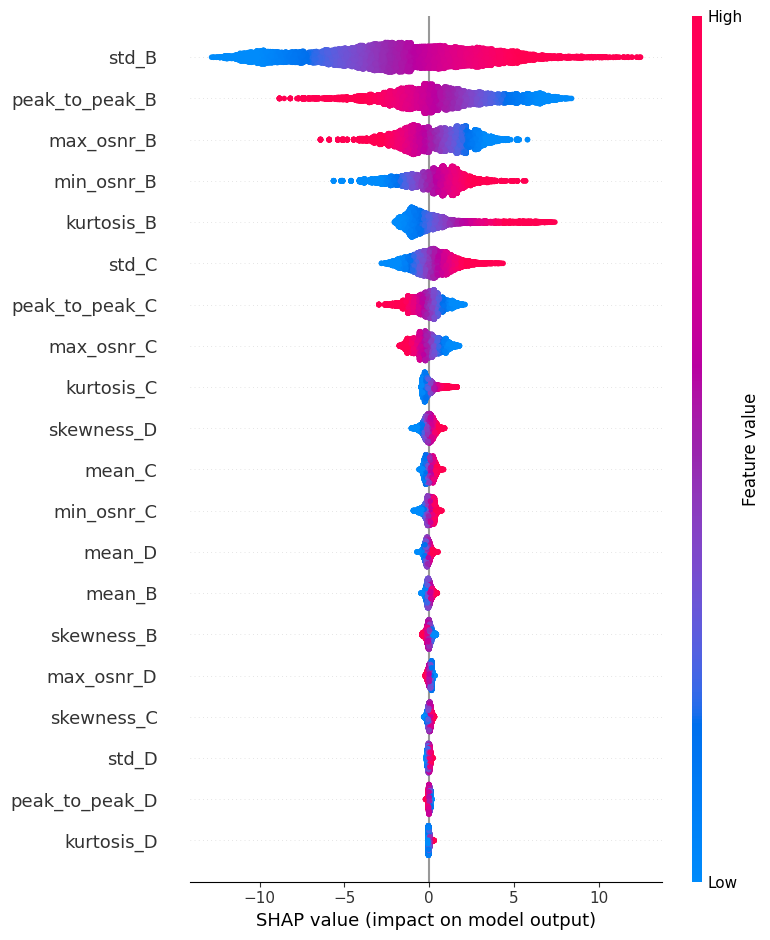

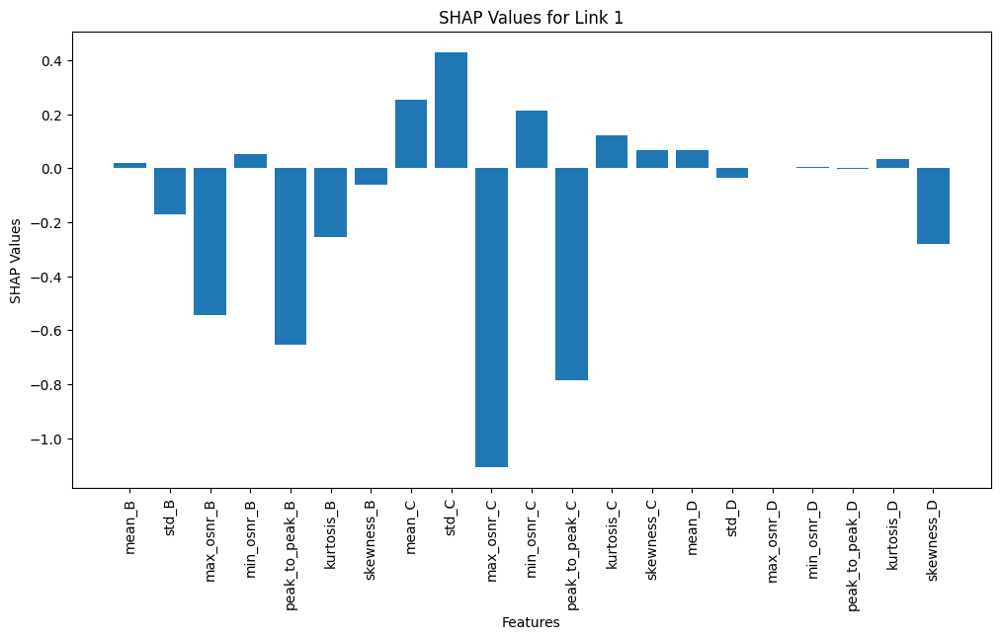

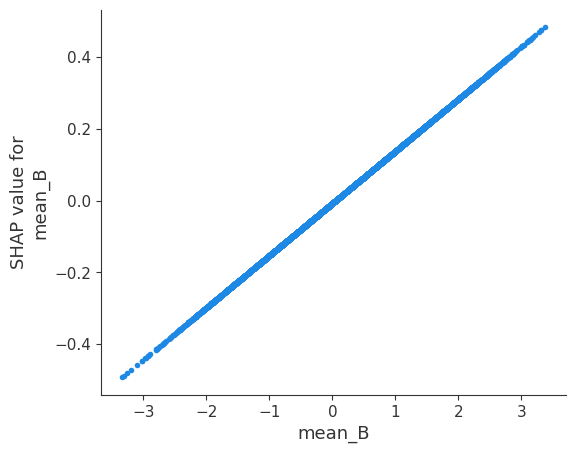

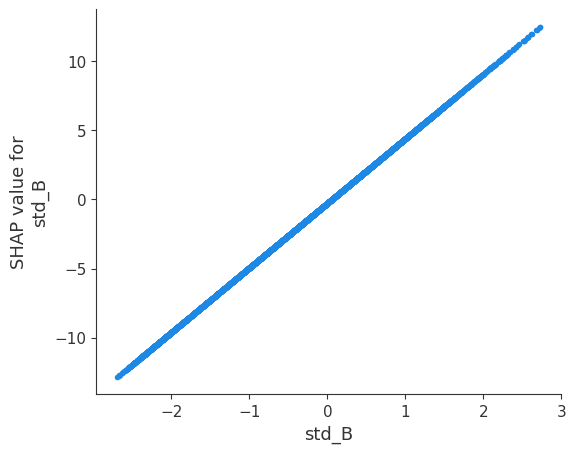

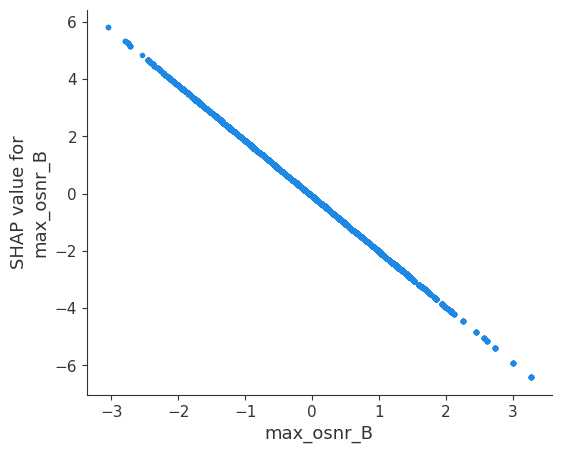

...

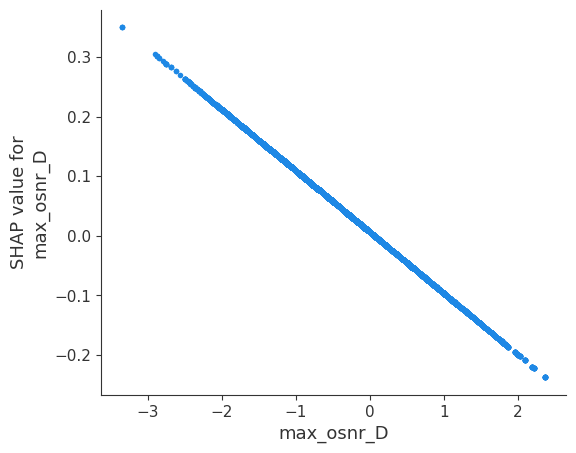

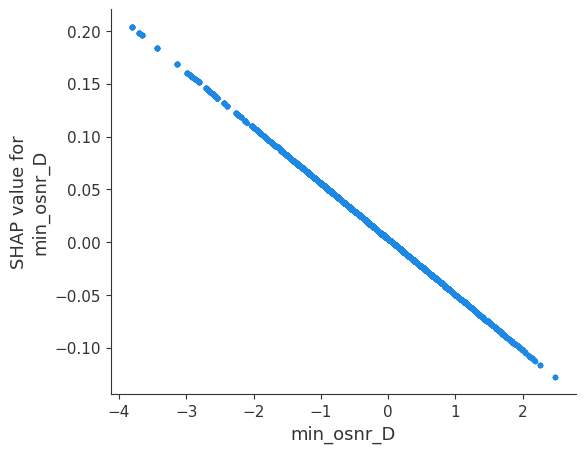

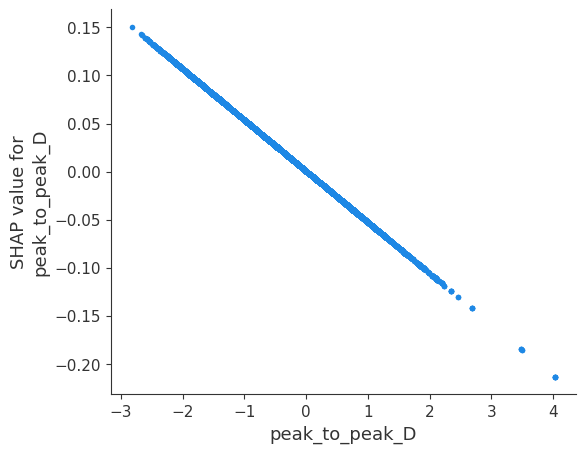

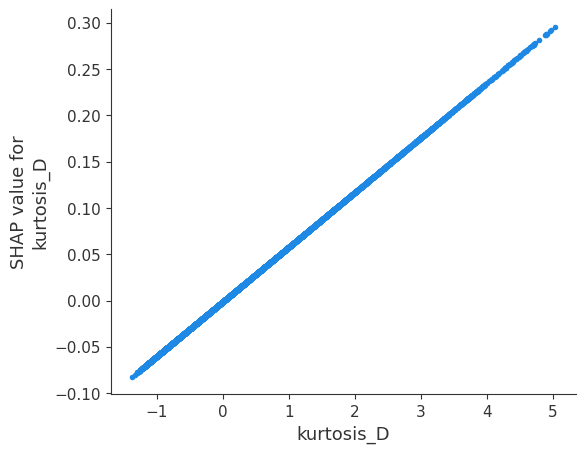

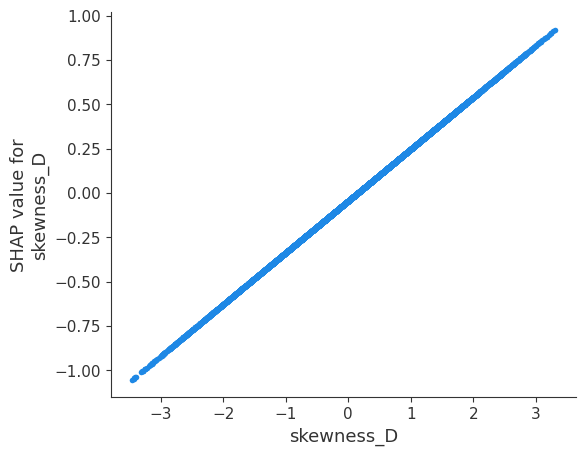

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


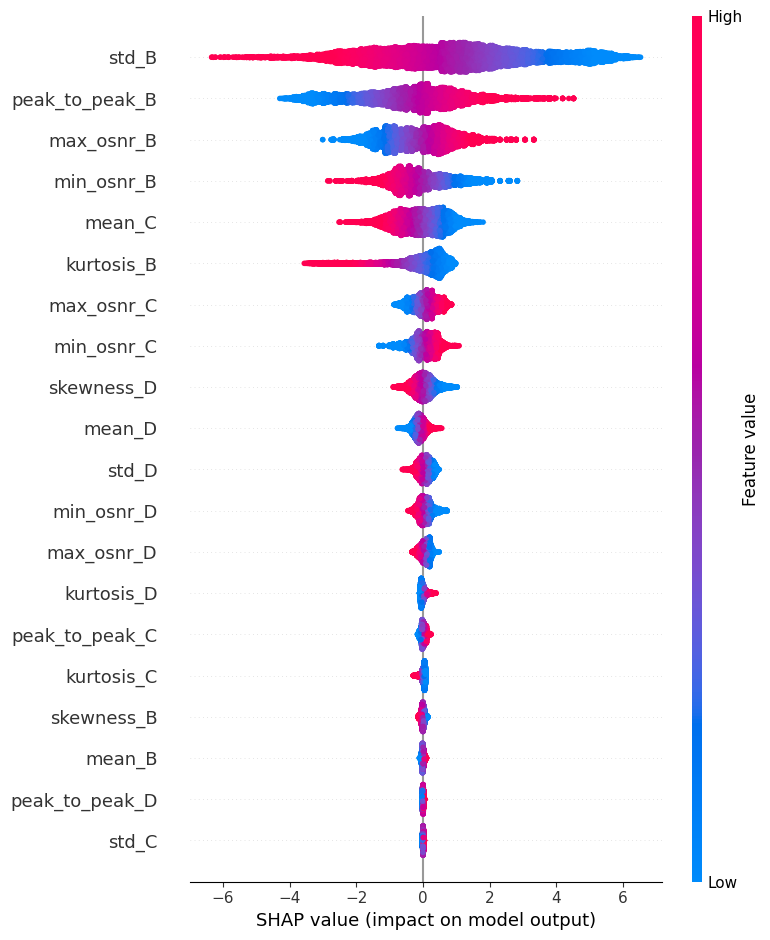

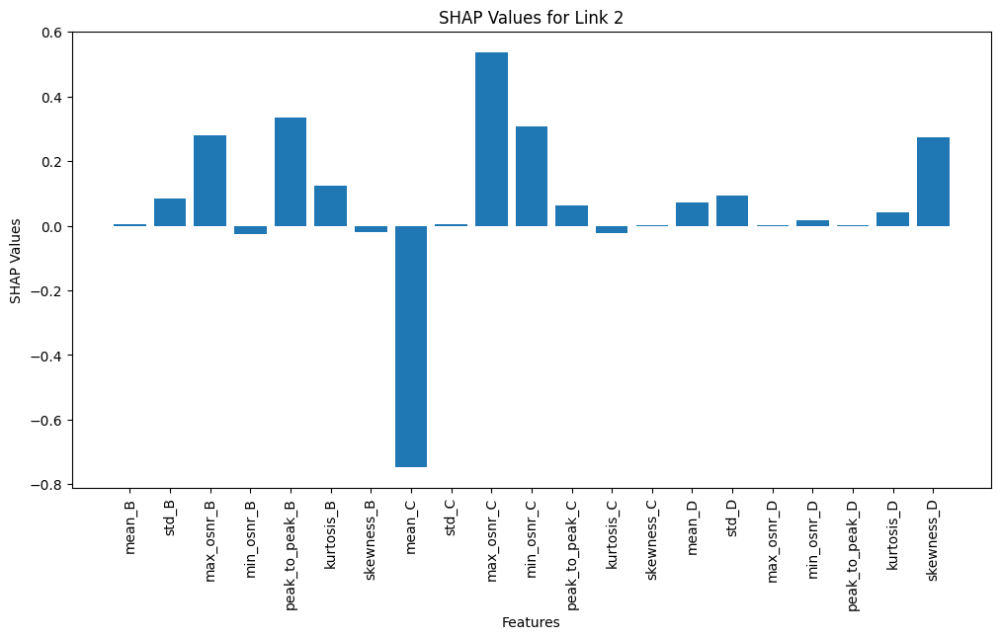

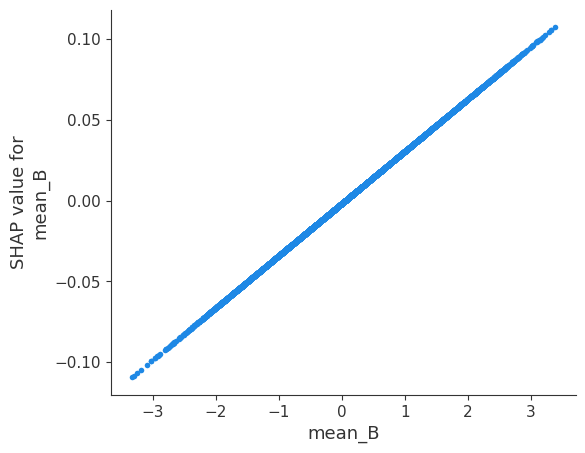

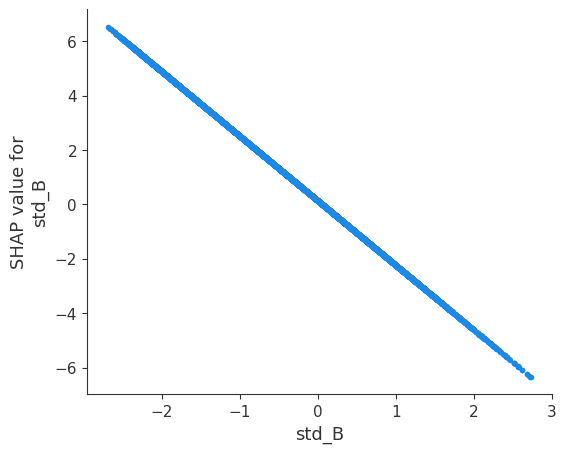

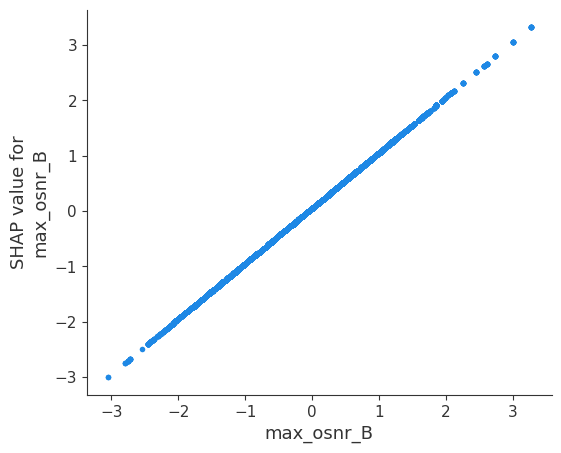

...

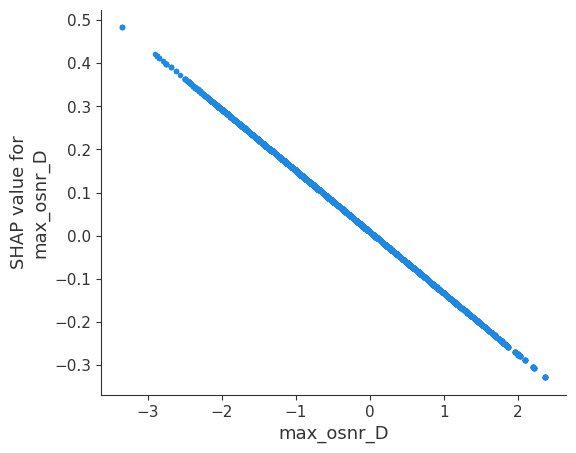

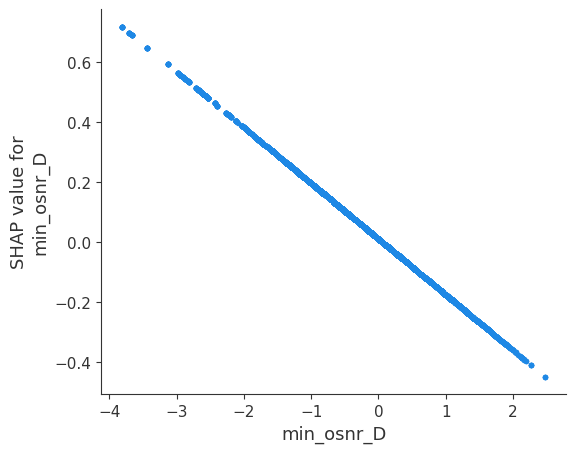

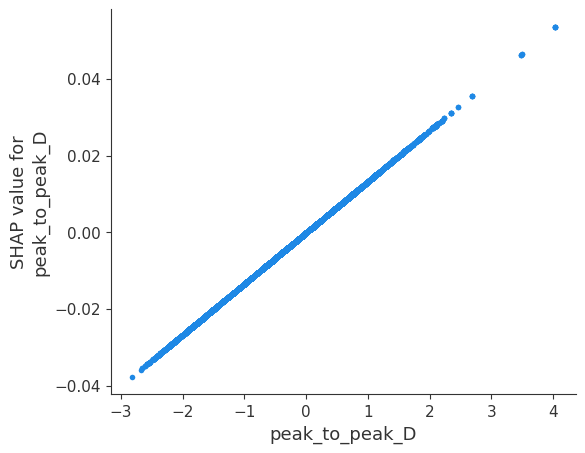

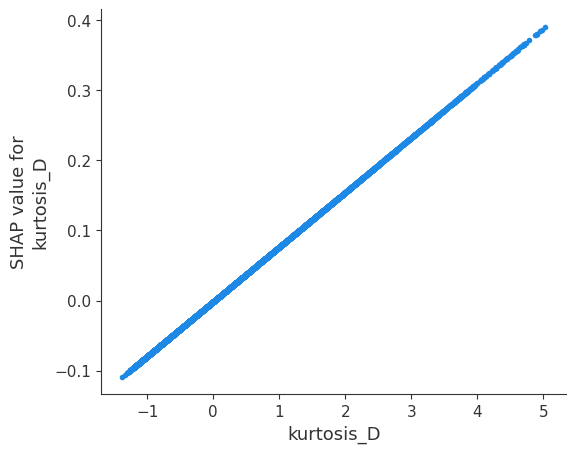

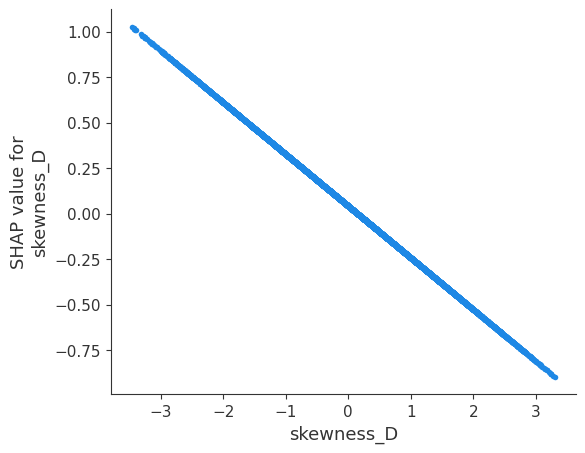

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


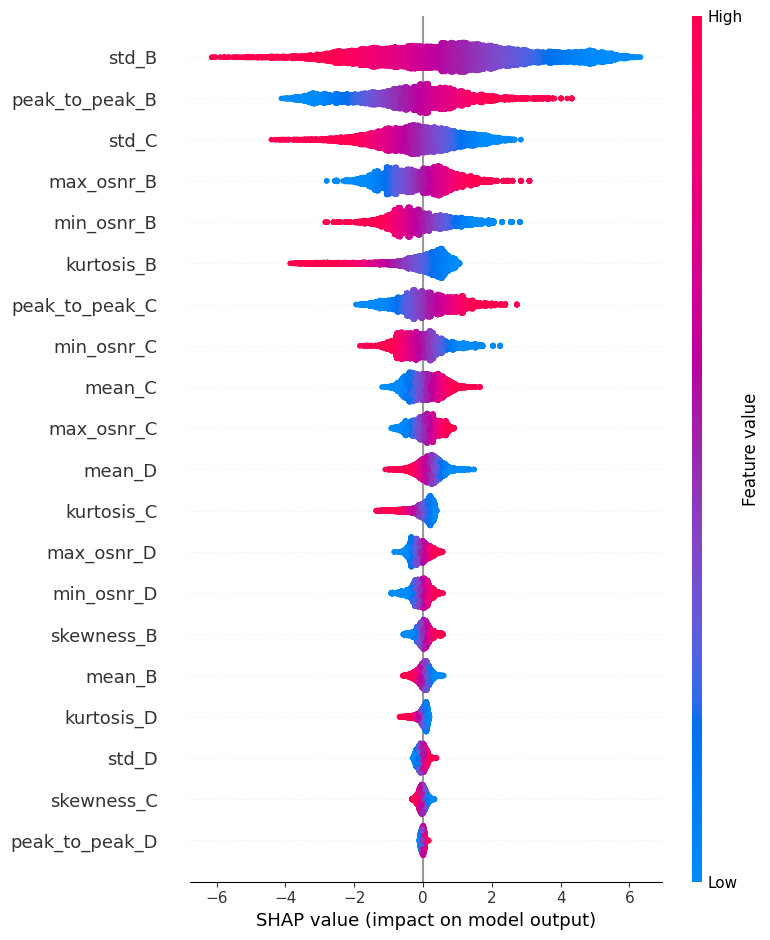

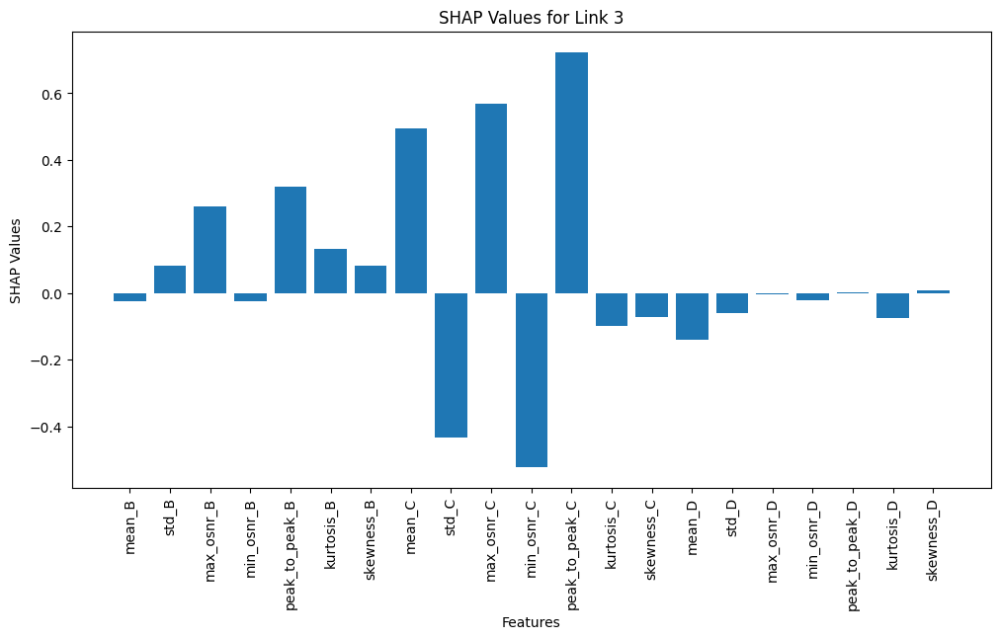

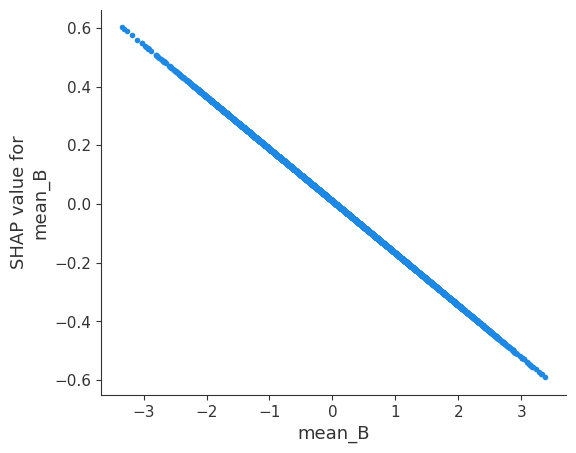

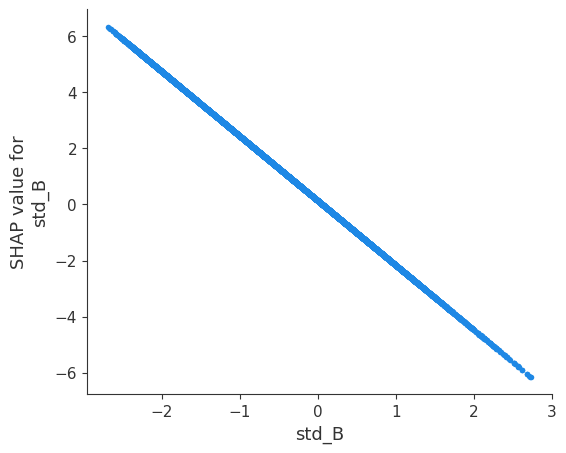

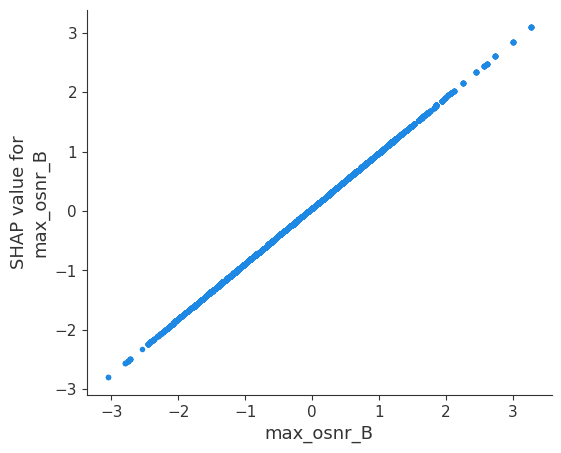

...

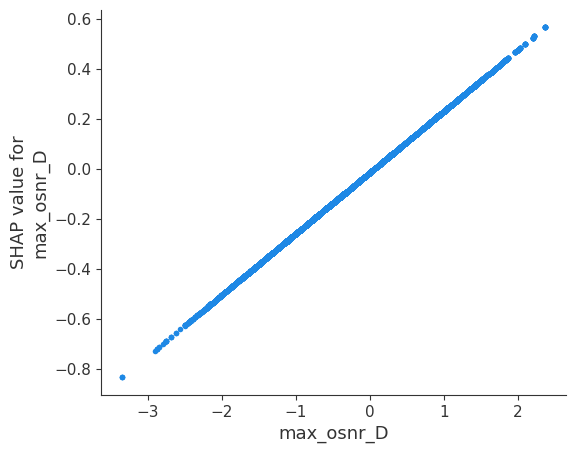

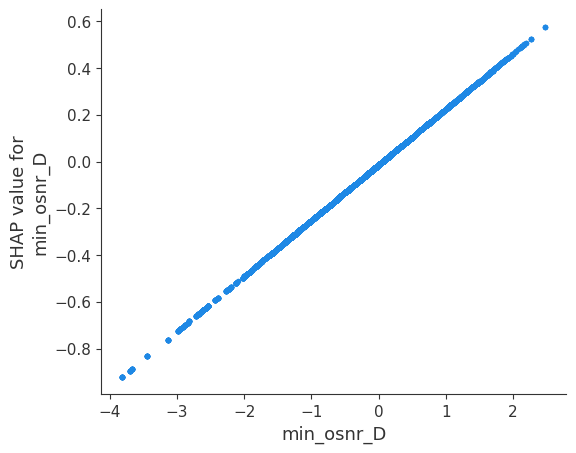

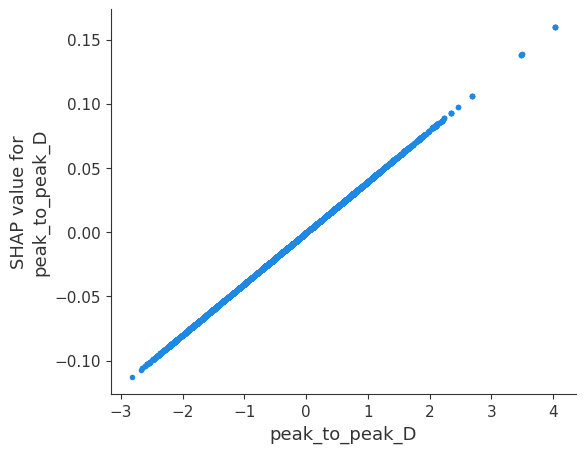

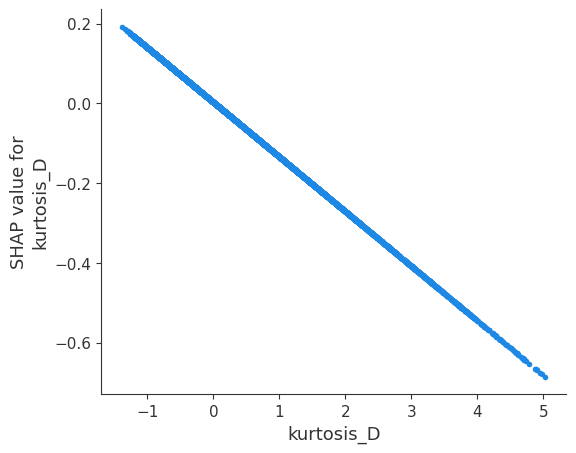

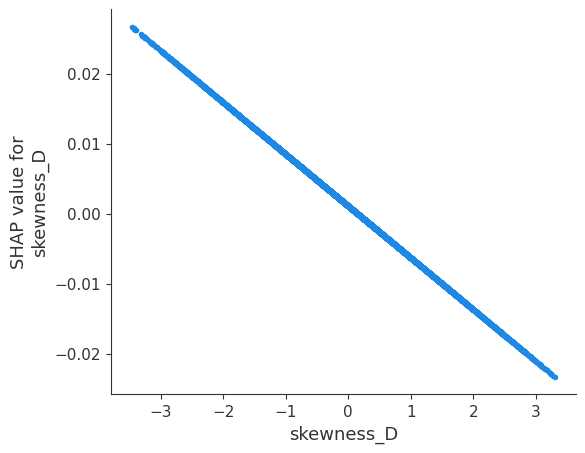

In [ ]:
shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test)

#### Single Monitor

Average Train Accuracy: 0.4568
Average Train MSE: 1.1403
Average Train Precision: 0.4554
Average Train F1: 0.4491
Average Train Duration: nan
Average Test Accuracy: 0.5416
Best Test Accuracy: 0.5427


Mean of empty slice.
invalid value encountered in scalar divide


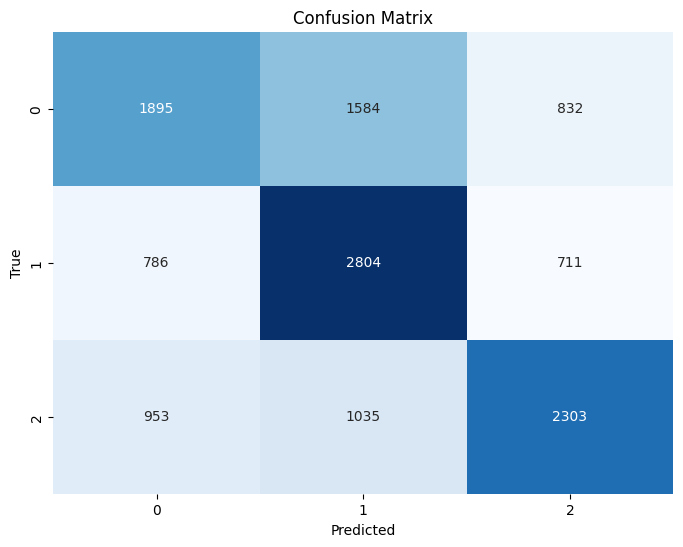

In [ ]:
# no scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
best_model, X_train, X_test = in_time_logistic_classifier_w_kfold(5, train_data, test_data, False)

Average Train Accuracy: 0.4568
Average Train MSE: 1.1404
Average Train Precision: 0.4554
Average Train F1: 0.4491
Average Train Duration: nan
Average Test Accuracy: 0.5417
Best Test Accuracy: 0.5427


Mean of empty slice.
invalid value encountered in scalar divide


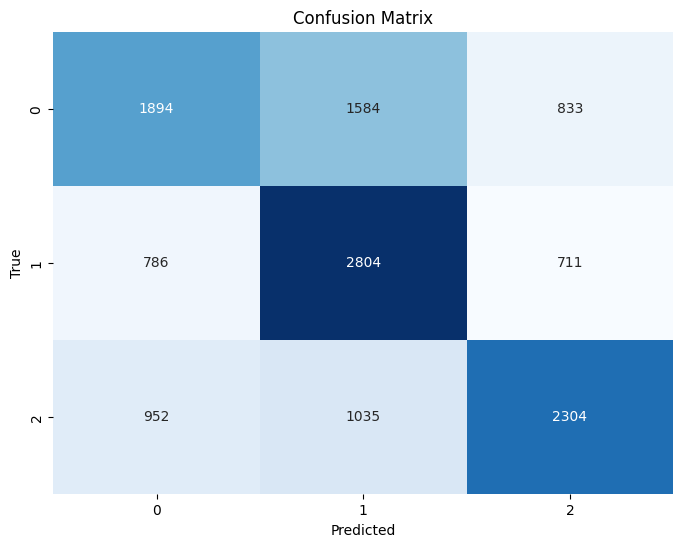

In [ ]:
# scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
best_model, X_train, X_test = in_time_logistic_classifier_w_kfold(5, train_data, test_data, True)

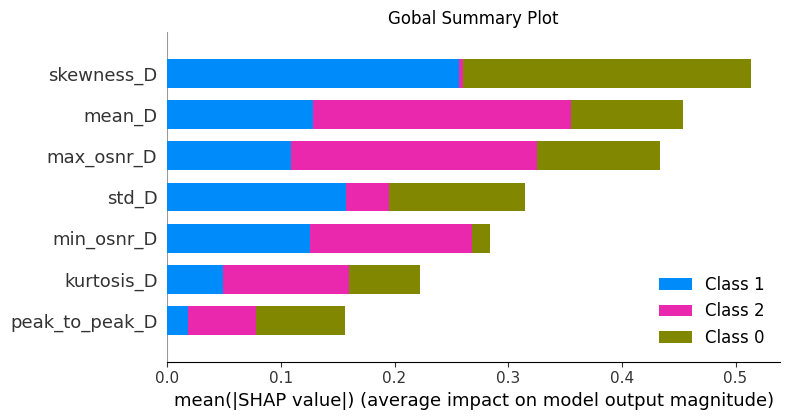

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


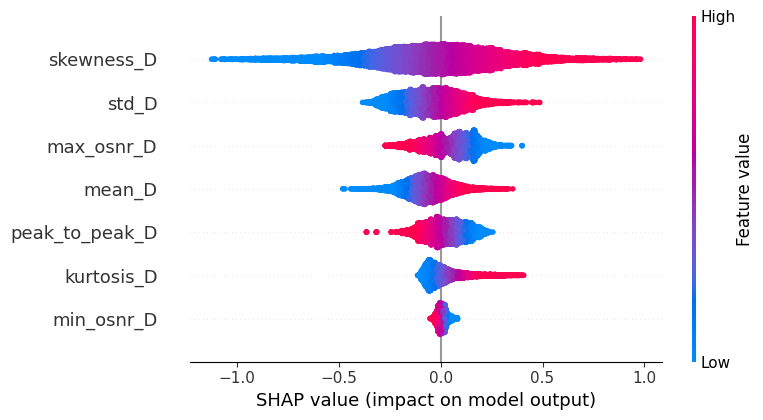

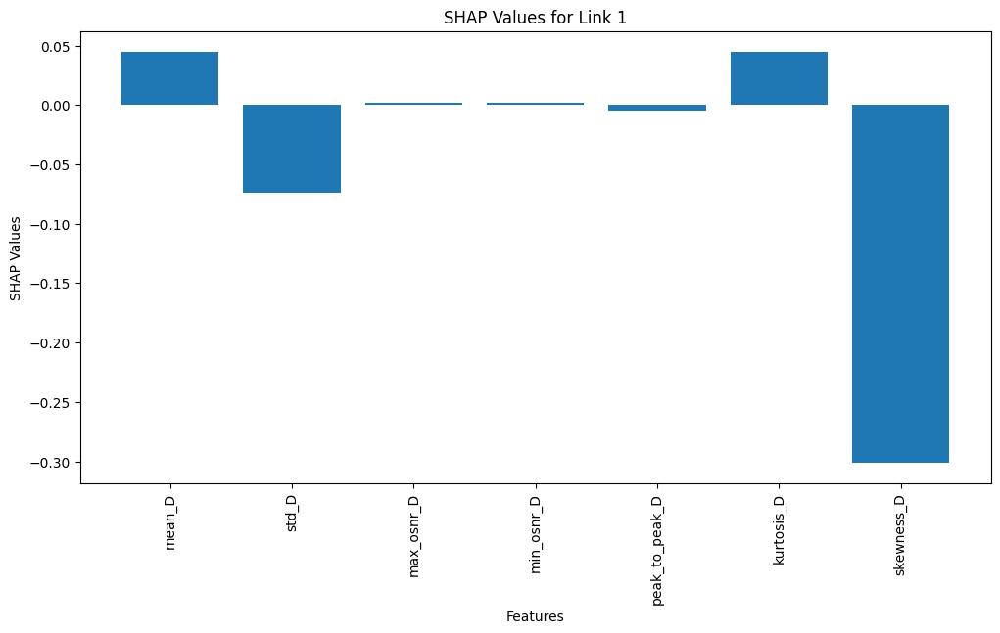

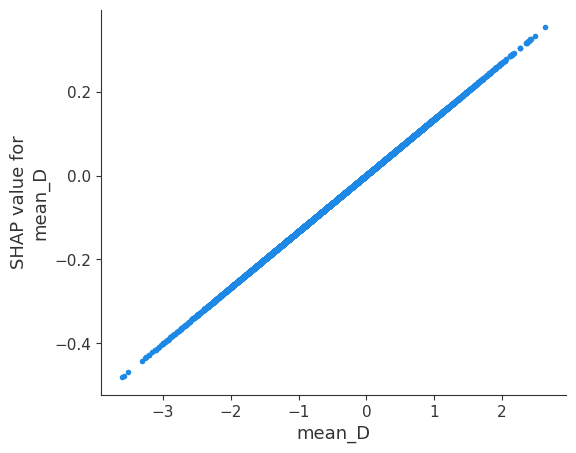

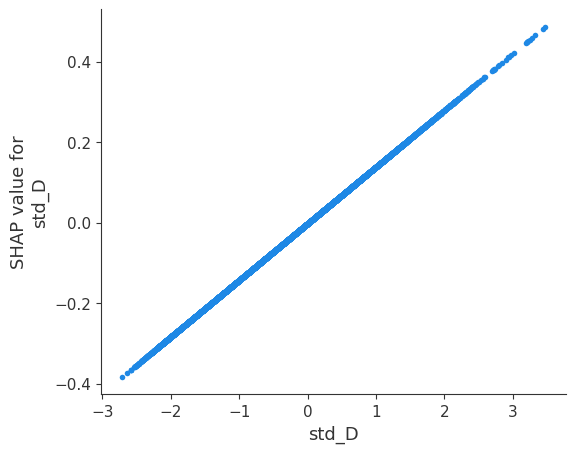

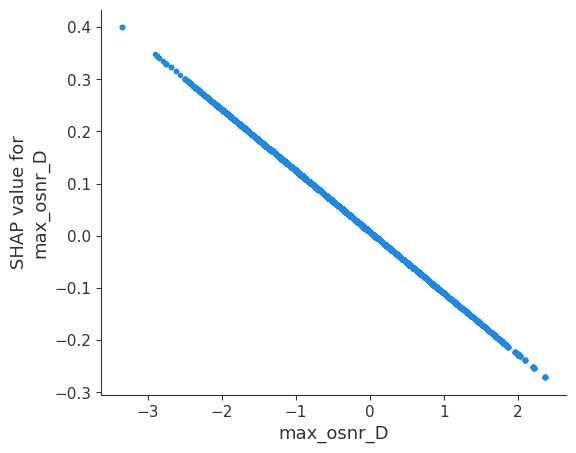

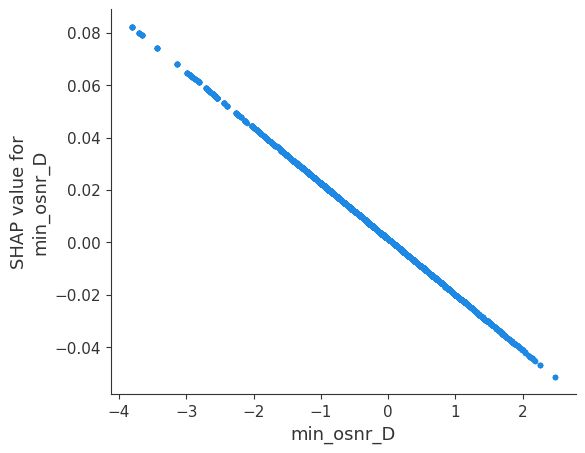

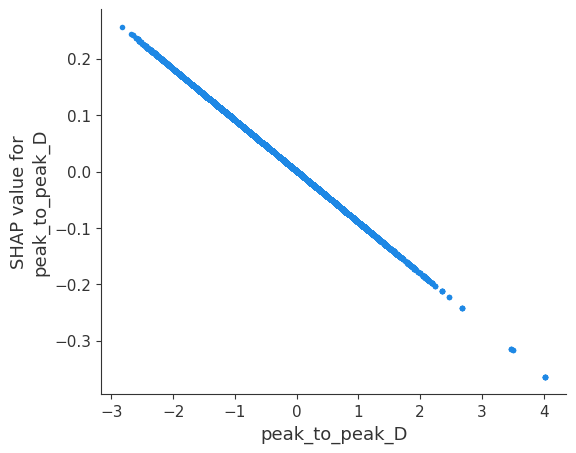

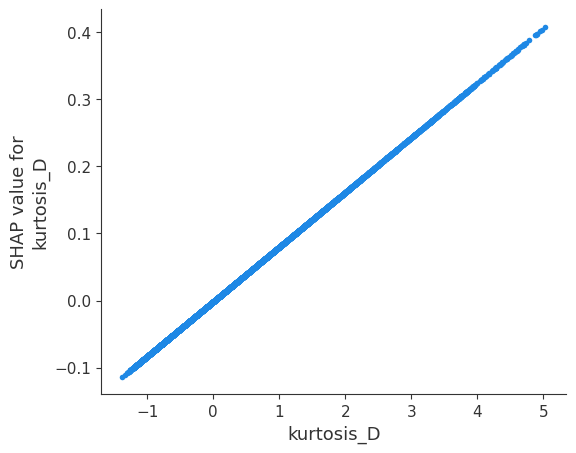

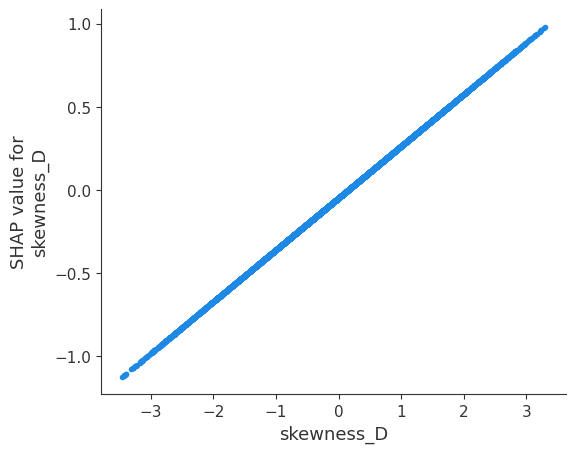

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


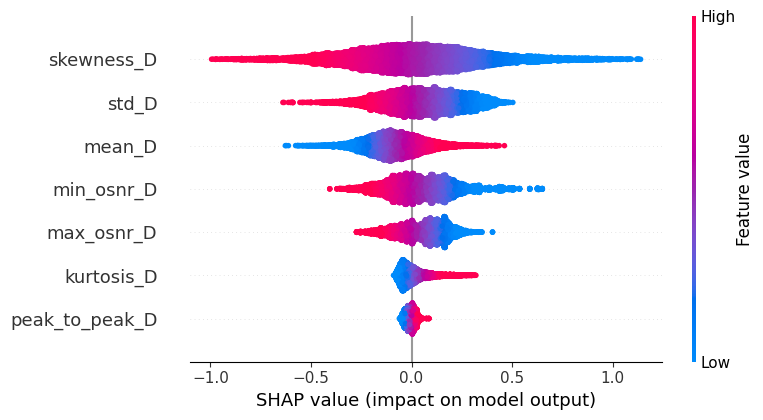

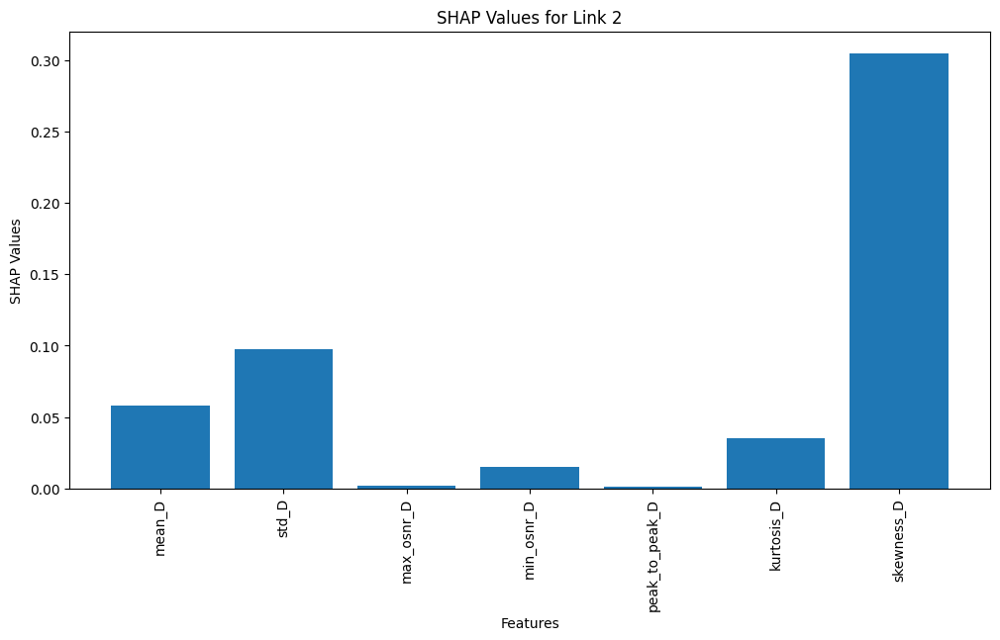

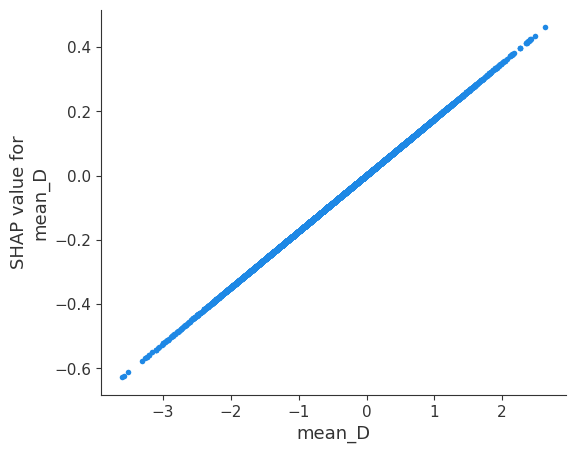

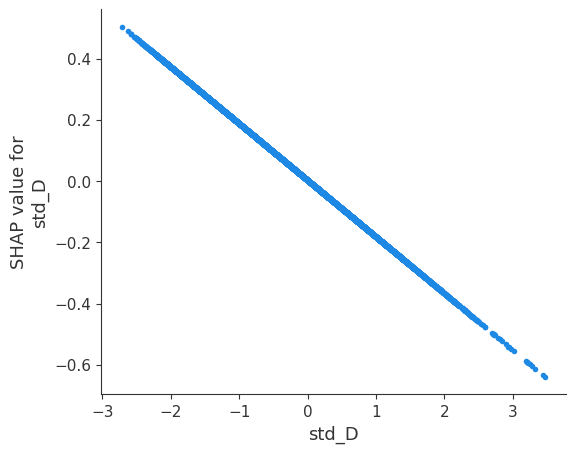

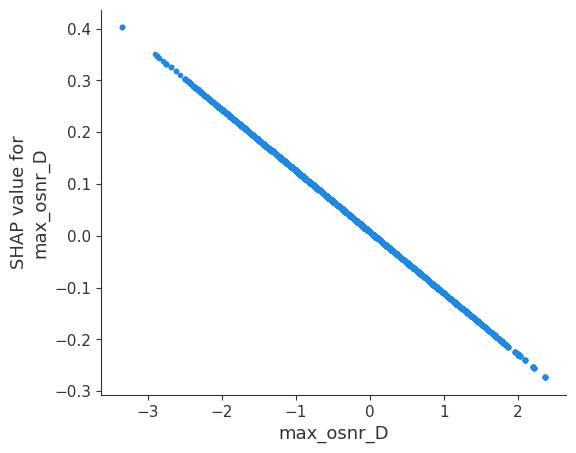

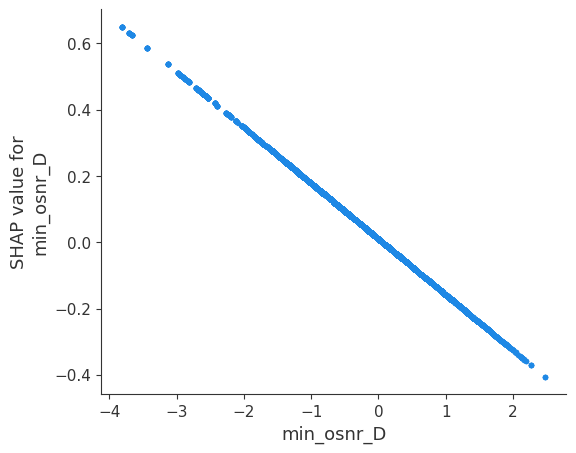

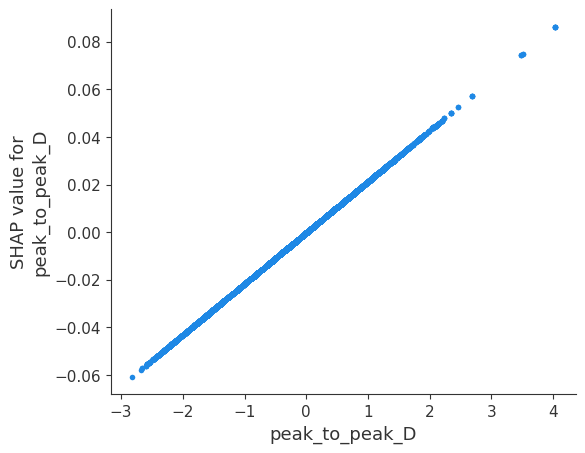

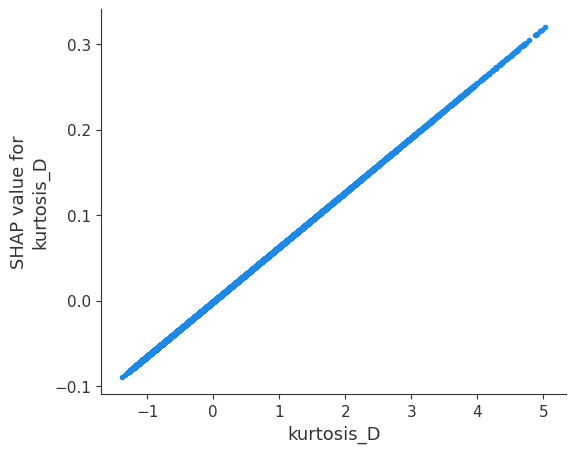

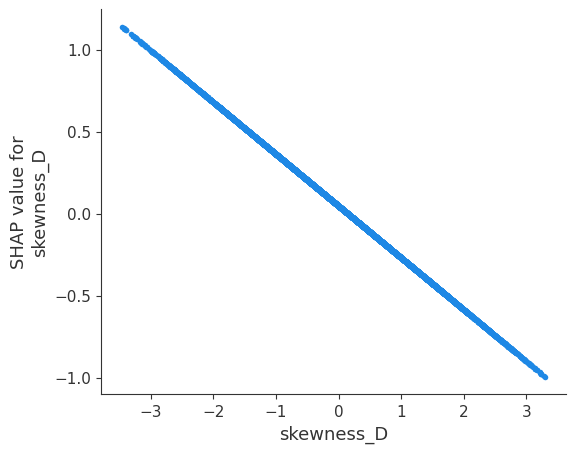

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


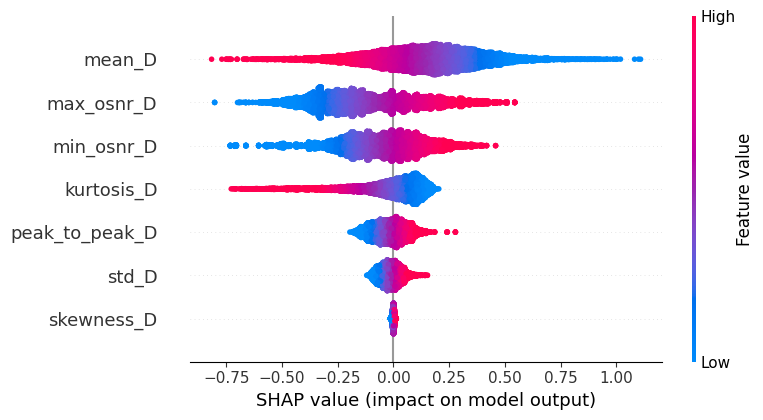

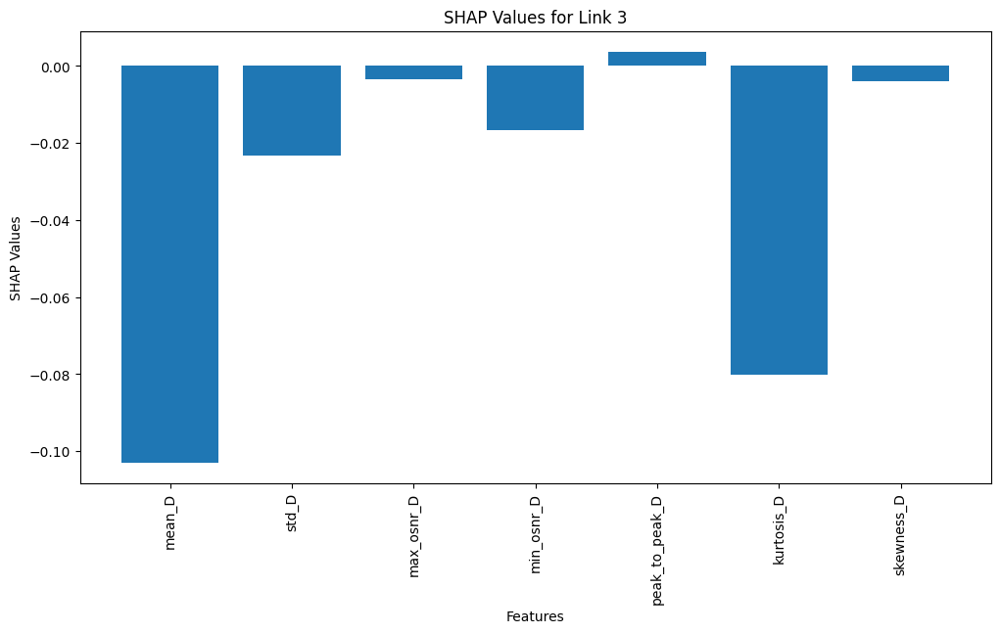

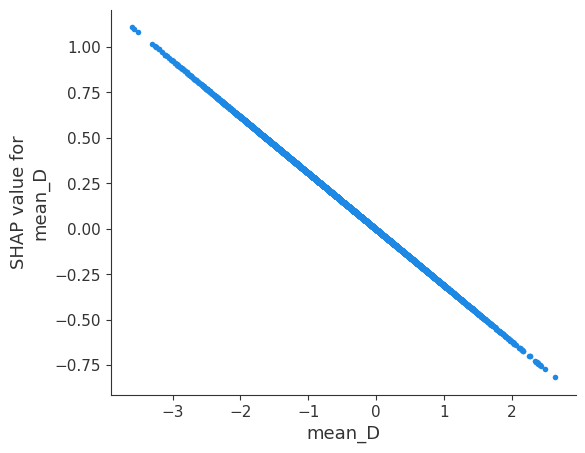

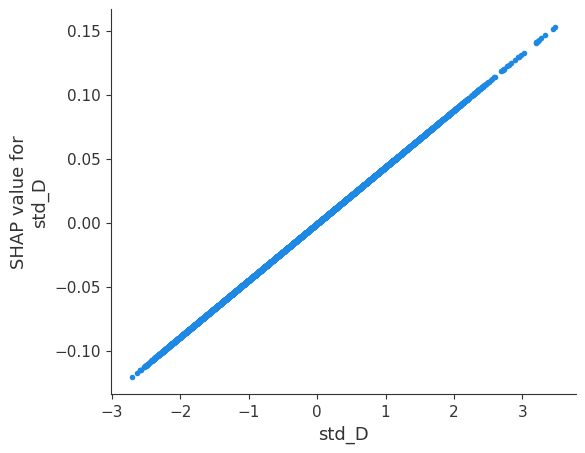

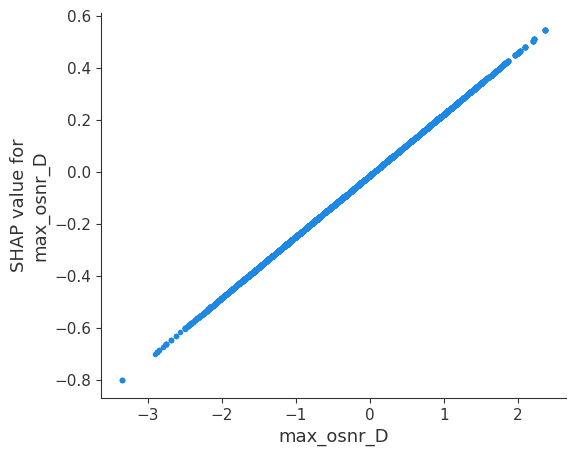

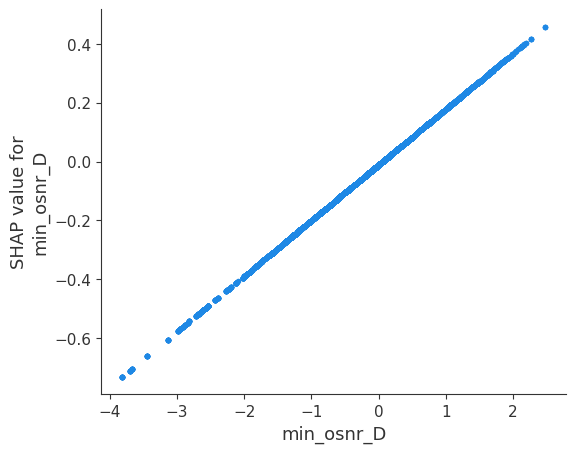

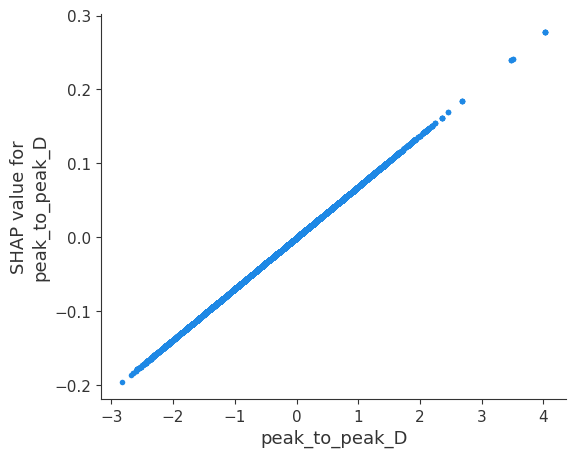

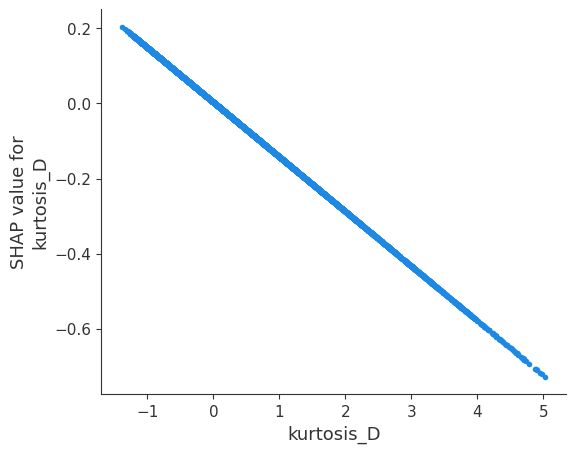

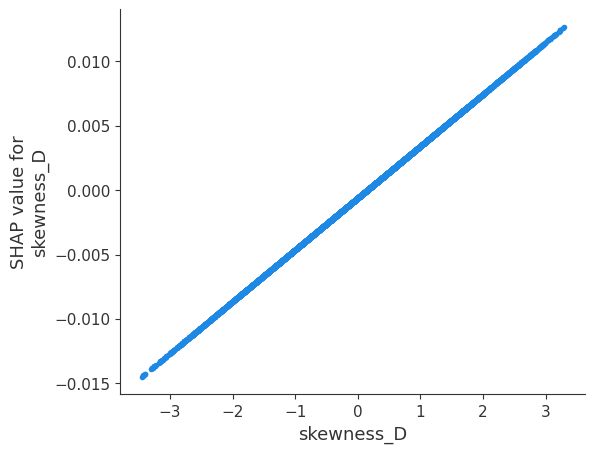

In [ ]:
shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test)

#### Bigger window sizes and spacing

#### Multiple Monitor

Average Train Accuracy: 0.9156
Average Train MSE: 0.1189
Average Train Precision: 0.9163
Average Train F1: 0.9157
Average Train Duration: nan
Average Test Accuracy: 0.7888
Best Test Accuracy: 0.7952


Mean of empty slice.
invalid value encountered in scalar divide


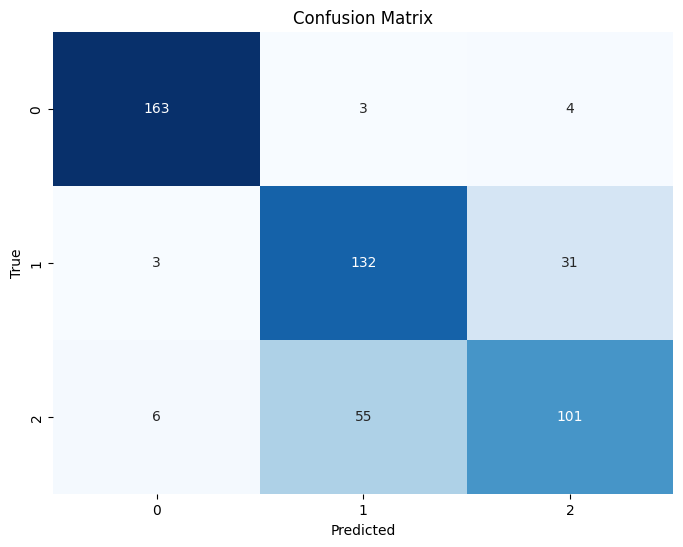

In [ ]:
# no scaling, window size=100, test size=0.2
train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.8)
best_model, X_train, X_test = in_time_logistic_classifier_w_kfold(5, train_data, test_data, False)

Average Train Accuracy: 0.9151
Average Train MSE: 0.1194
Average Train Precision: 0.9158
Average Train F1: 0.9152
Average Train Duration: nan
Average Test Accuracy: 0.7880
Best Test Accuracy: 0.7952


Mean of empty slice.
invalid value encountered in scalar divide


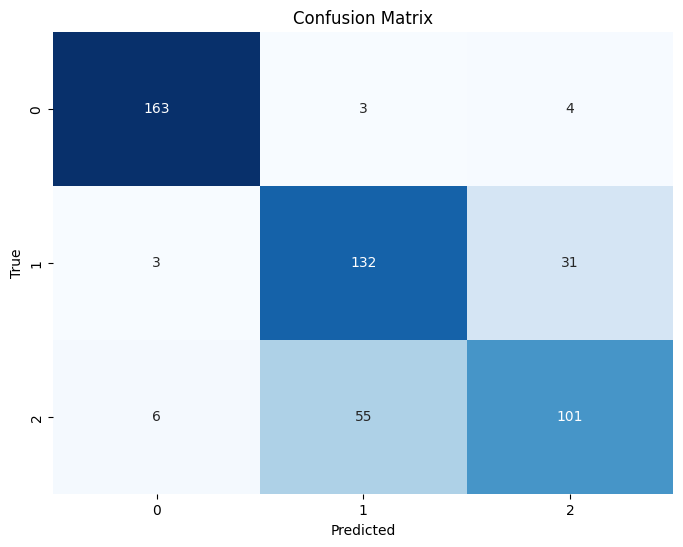

In [ ]:
# scaling, window size=100, test size=0.2
train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.8)
best_model, X_train, X_test = in_time_logistic_classifier_w_kfold(5, train_data, test_data, True)

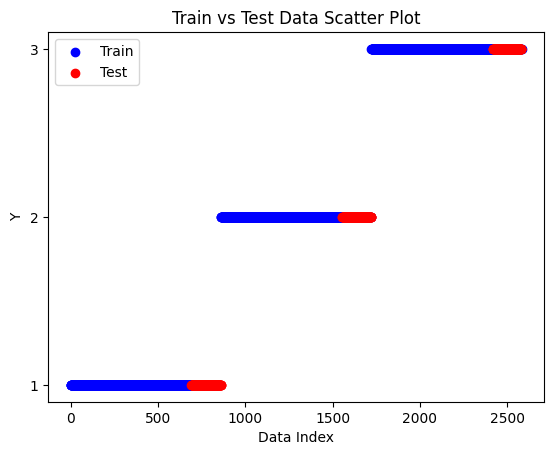

In [ ]:
new_final_df.reset_index(drop=True, inplace=True)

train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.8)

X_train = train_data.drop('link', axis=1)
y_train = train_data['link']

X_test = test_data.drop('link', axis=1)
y_test = test_data['link']

scatter_plot_train_test(X_train, X_test, y_train, y_test)

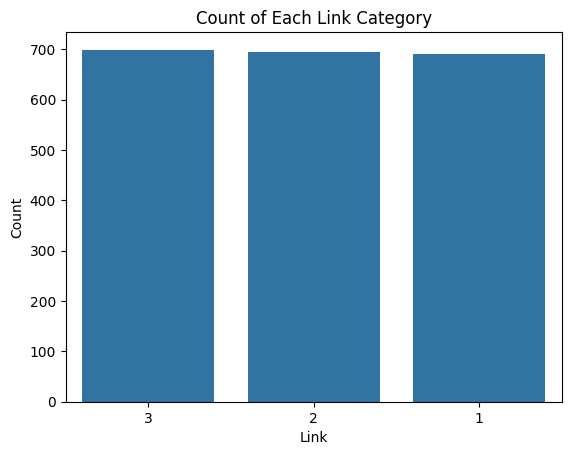

In [ ]:
# plot the count of each 'link' category
link_counts = train_data['link'].value_counts()
sns.barplot(x=link_counts.index, y=link_counts.values)
plt.xlabel('Link')
plt.ylabel('Count')
plt.title('Count of Each Link Category')
plt.show()

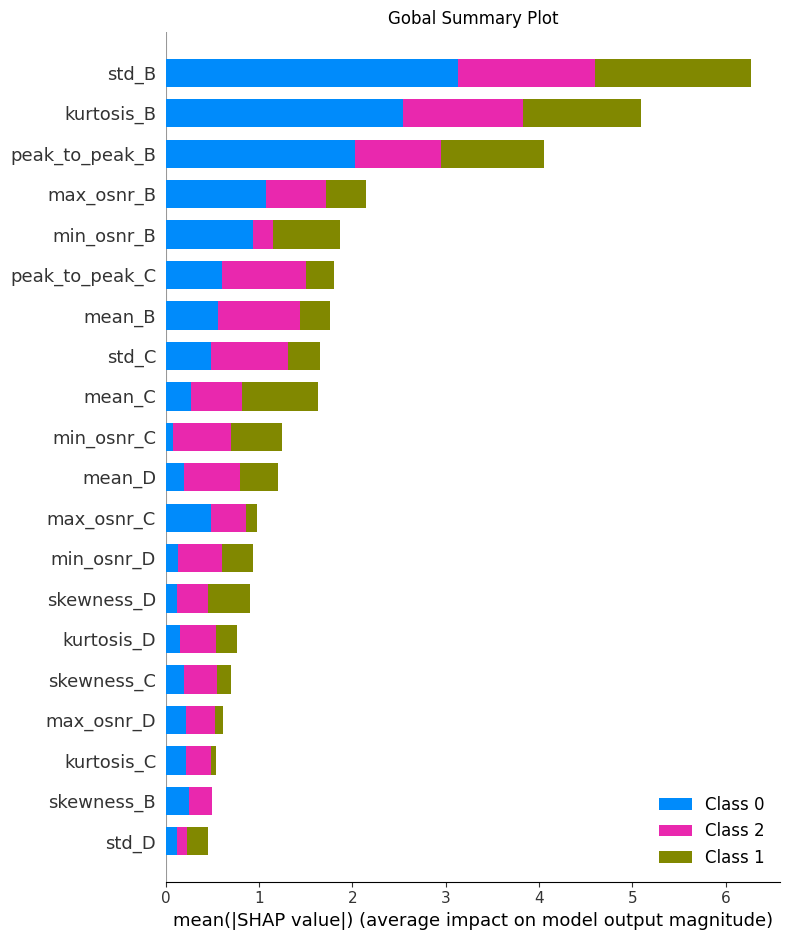

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


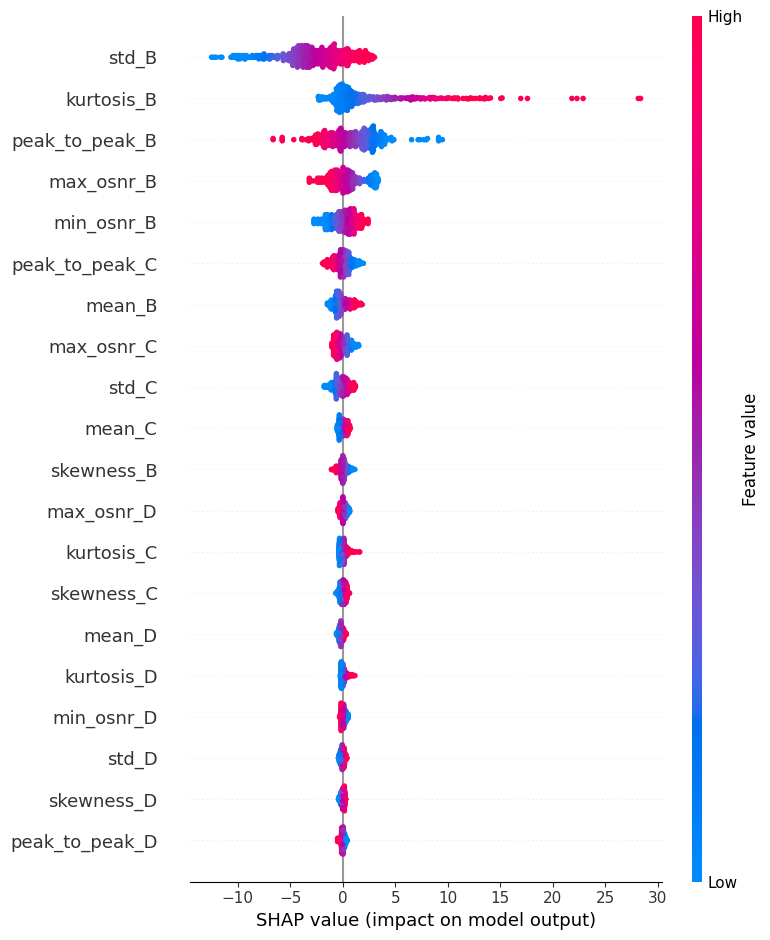

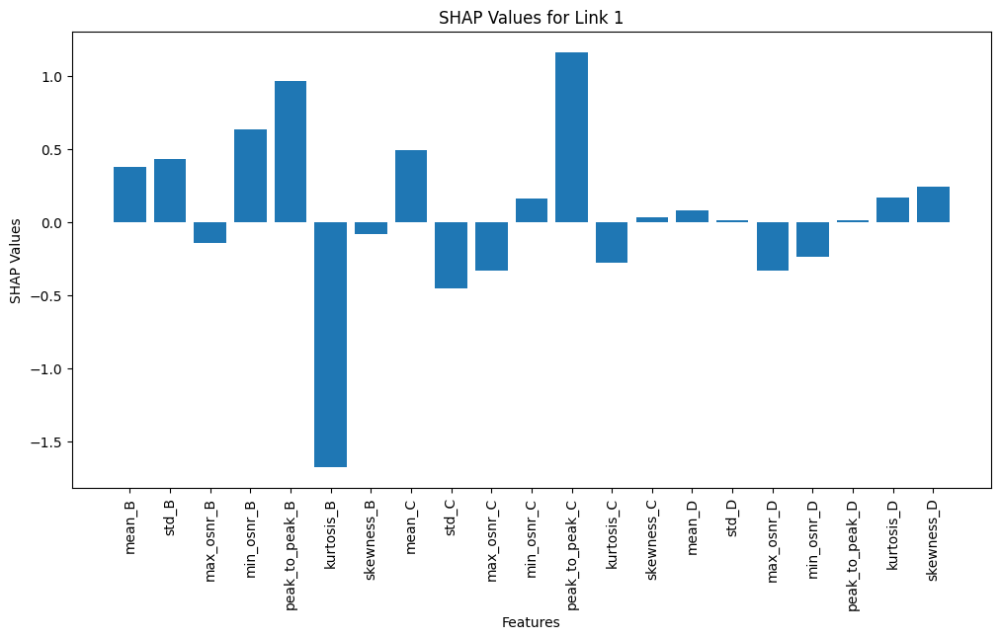

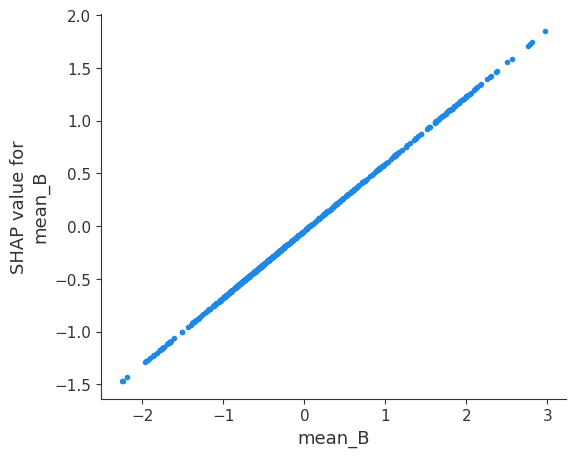

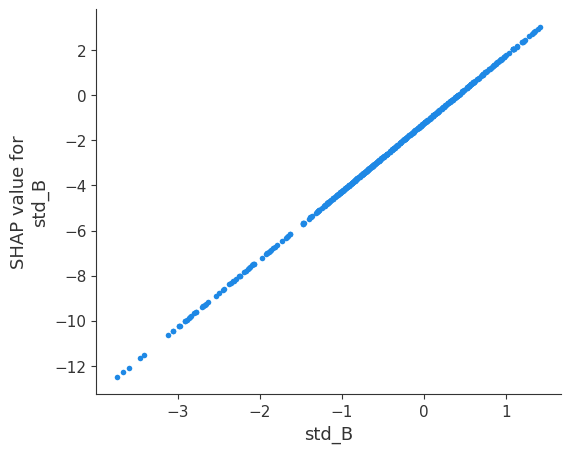

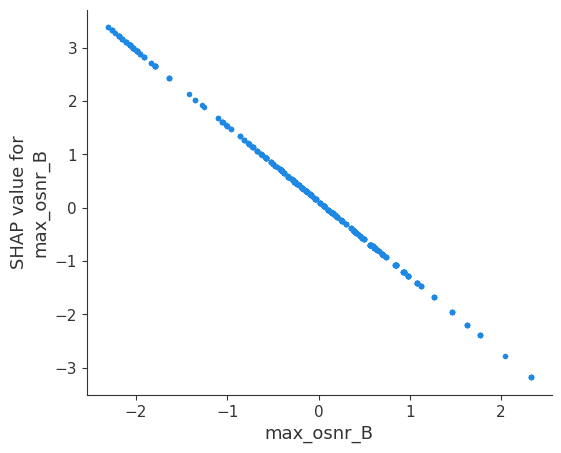

...

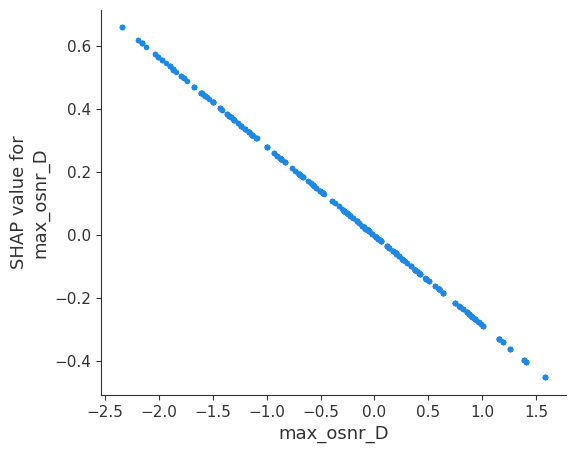

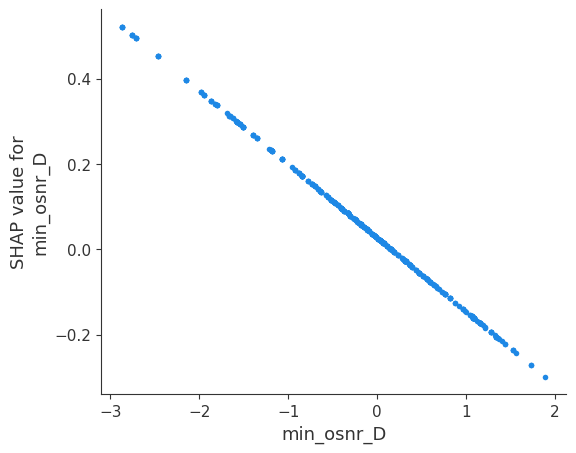

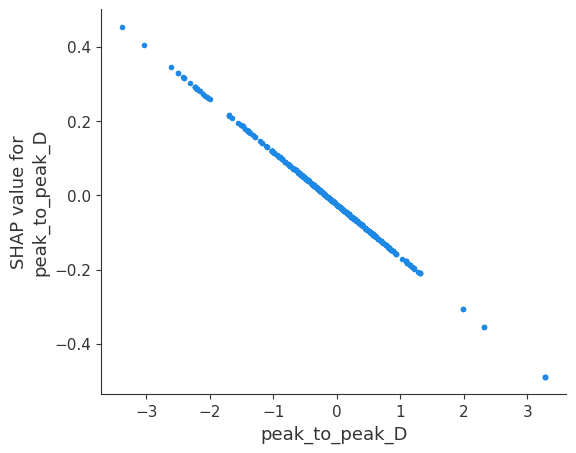

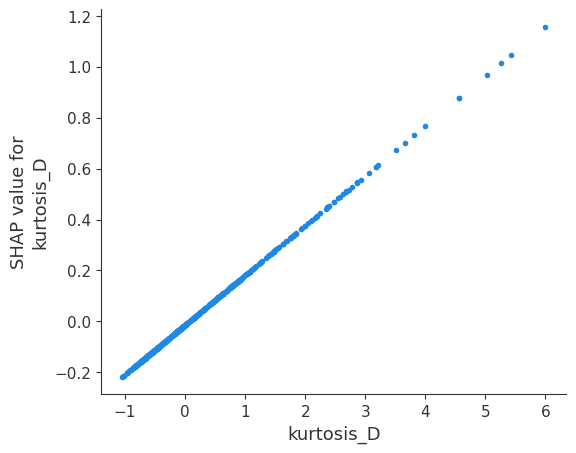

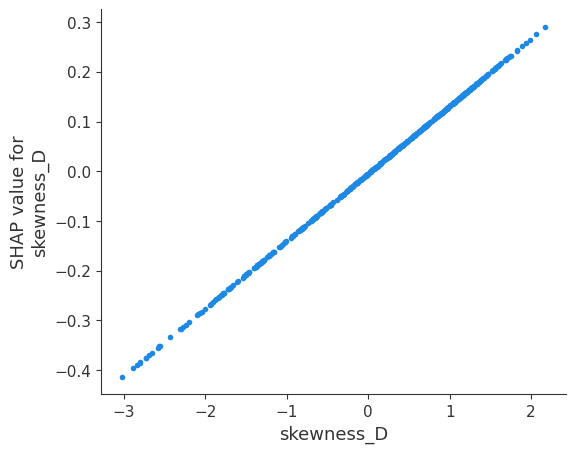

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


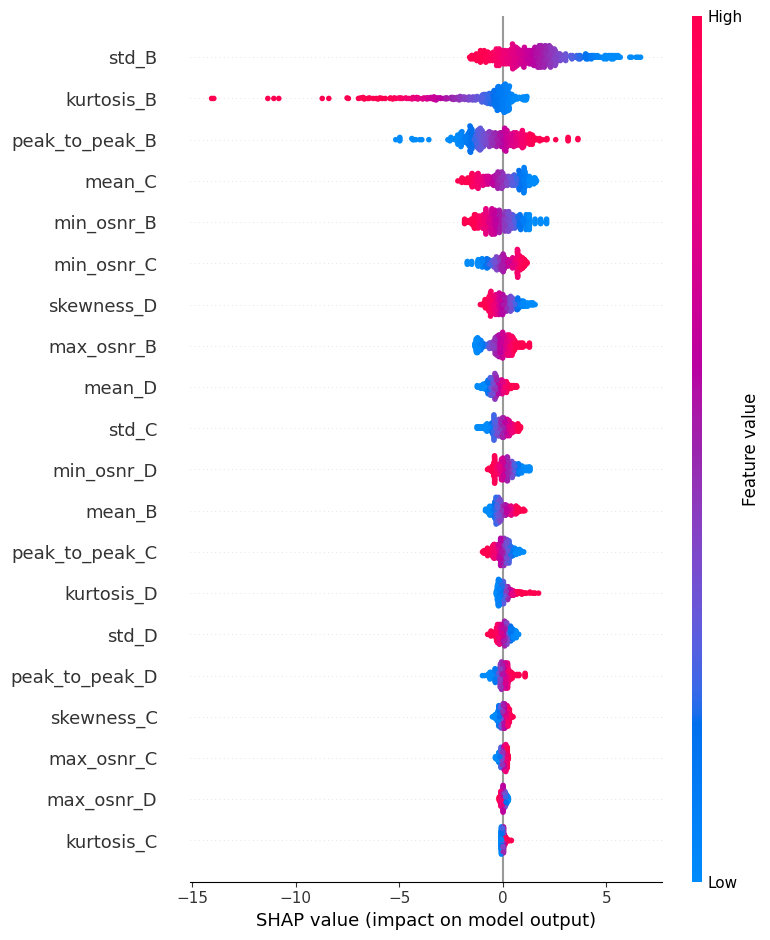

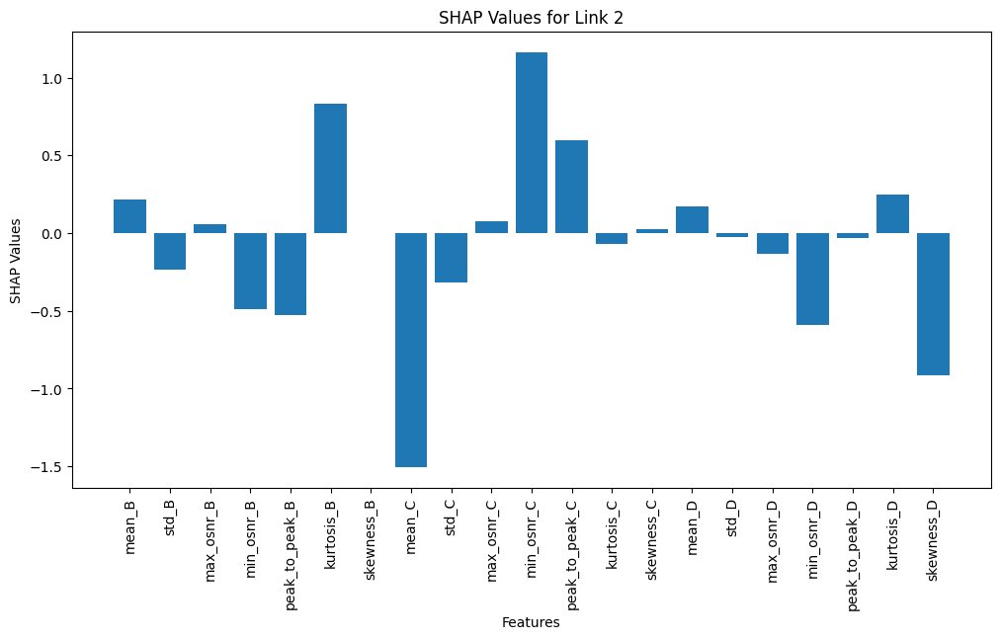

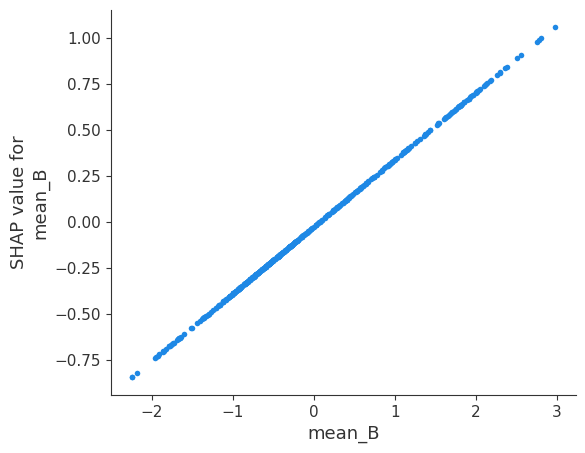

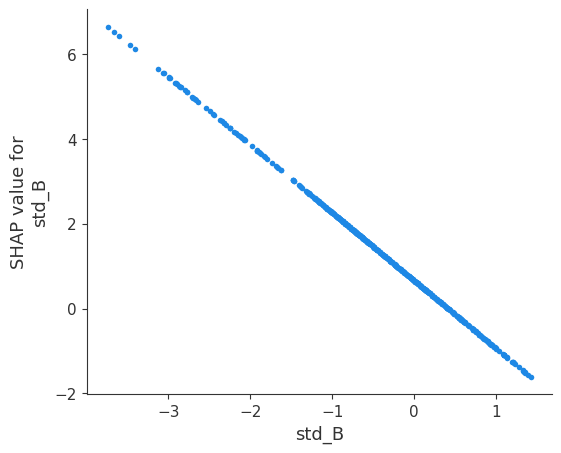

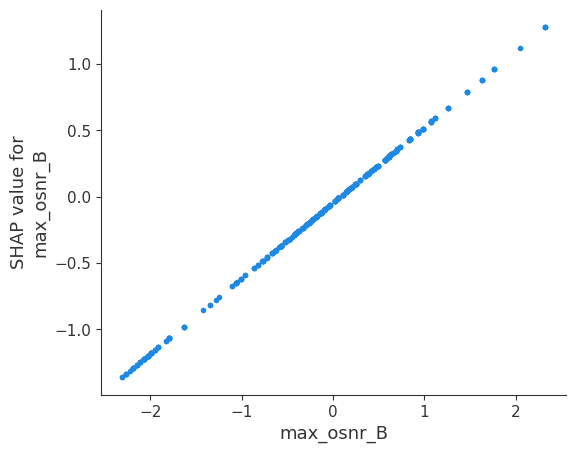

...

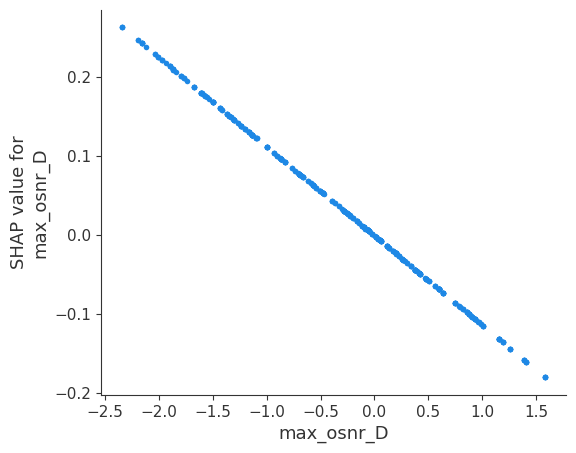

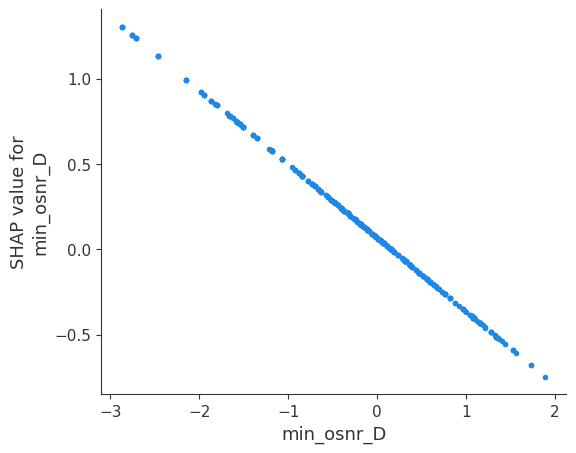

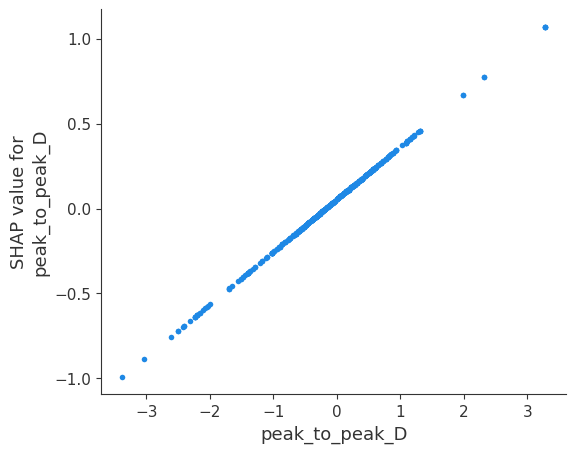

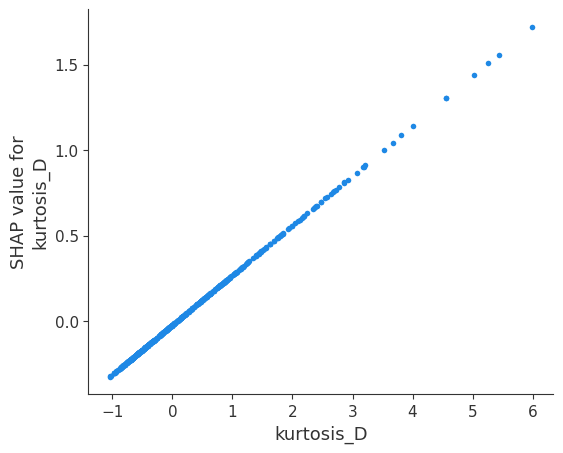

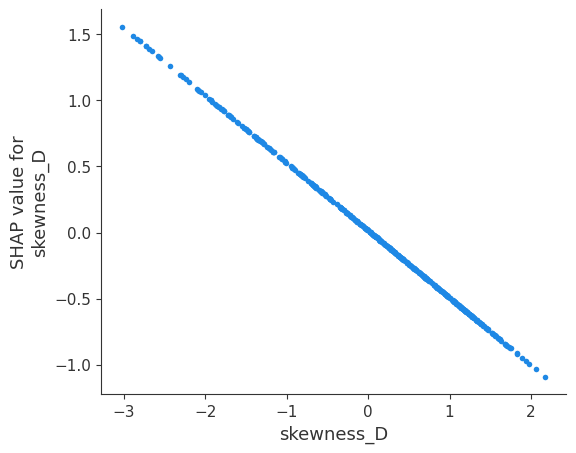

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


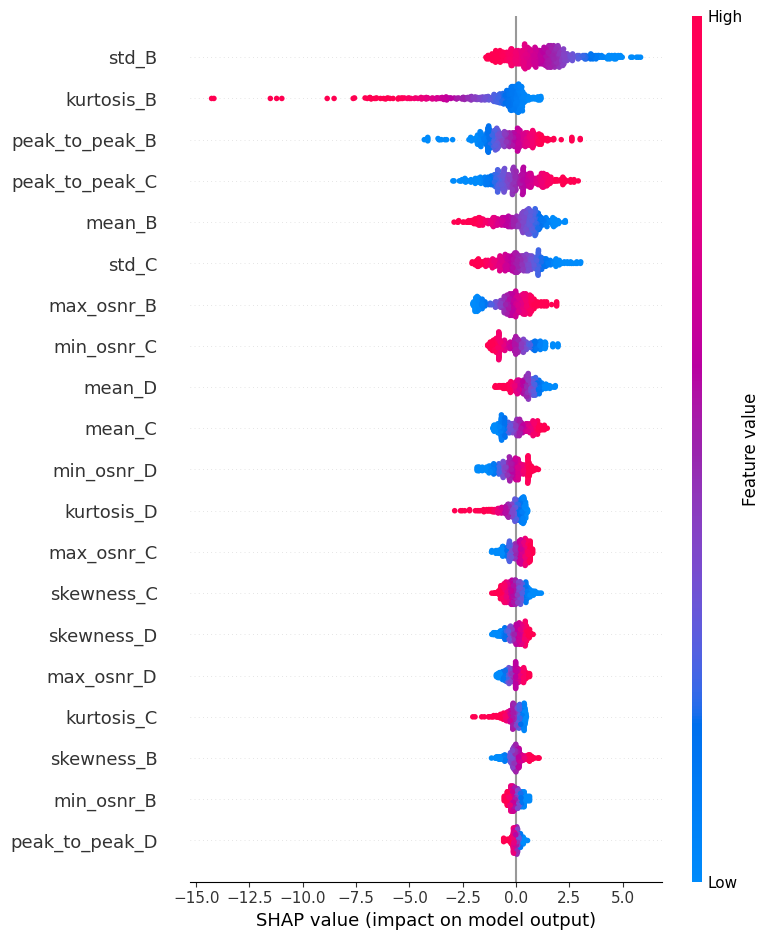

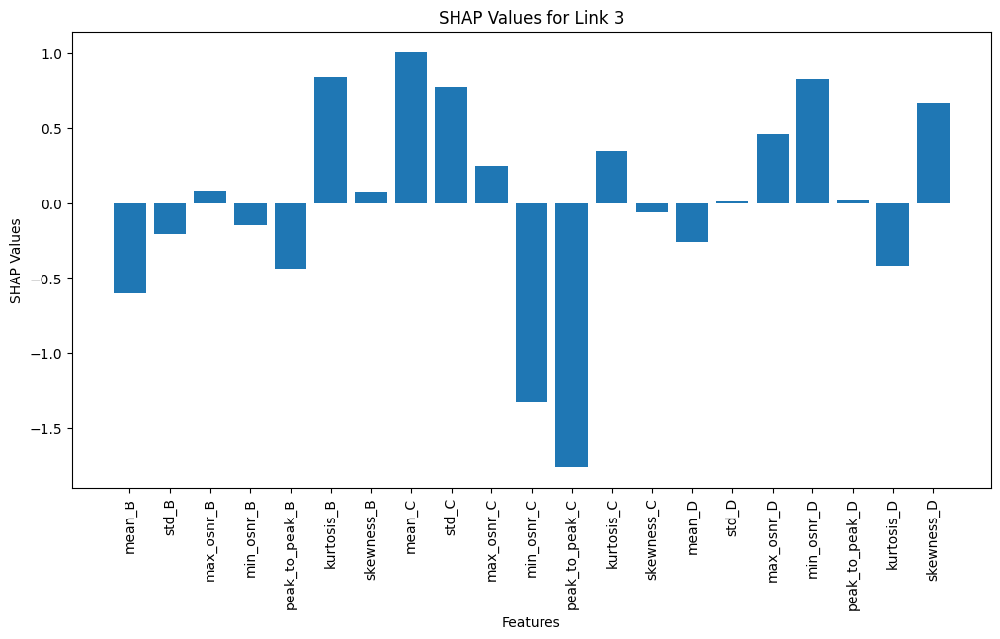

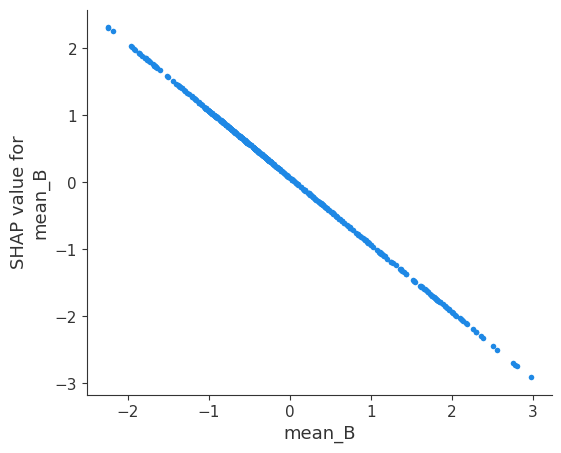

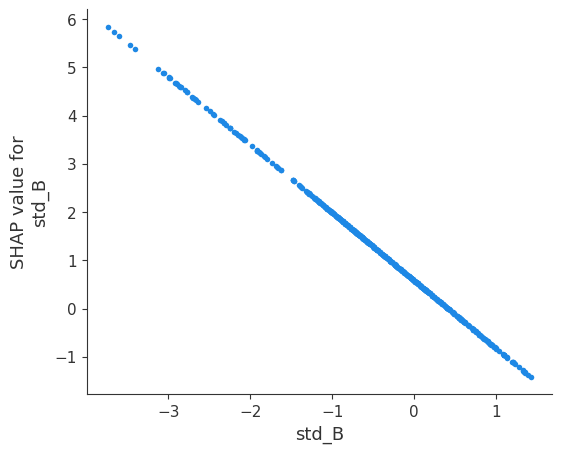

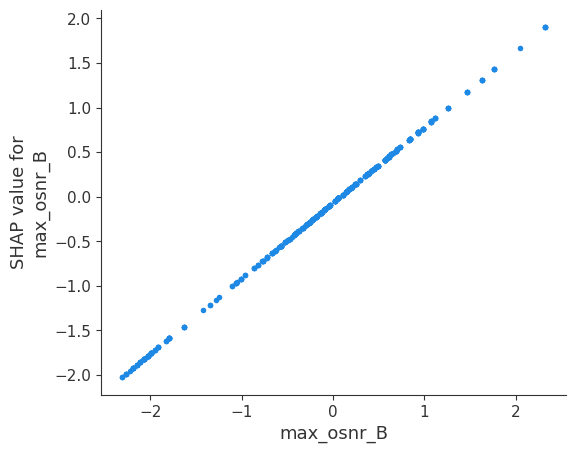

...

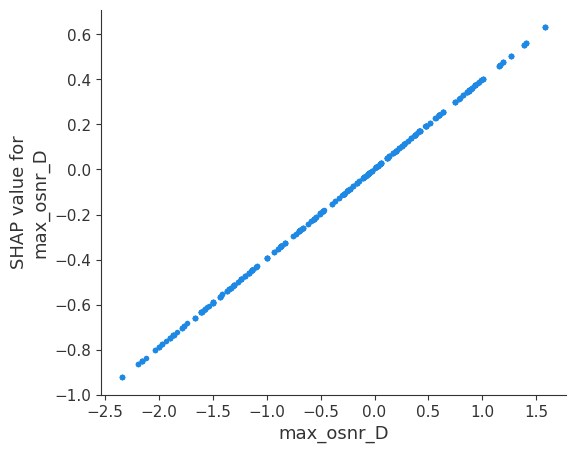

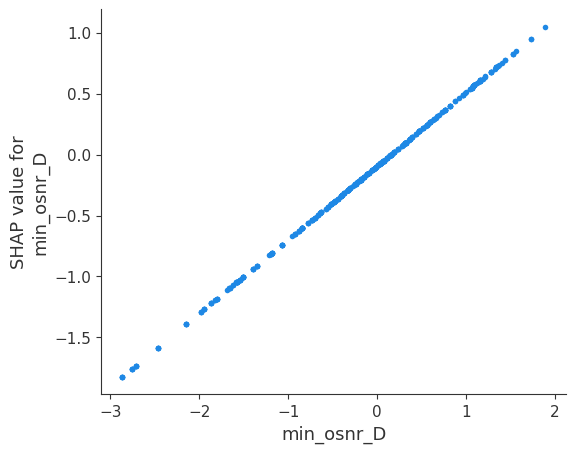

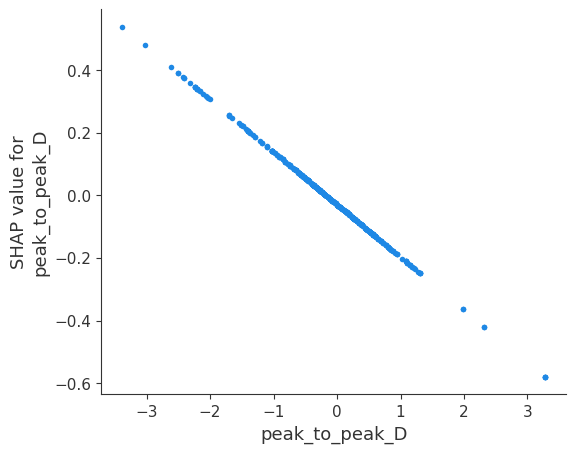

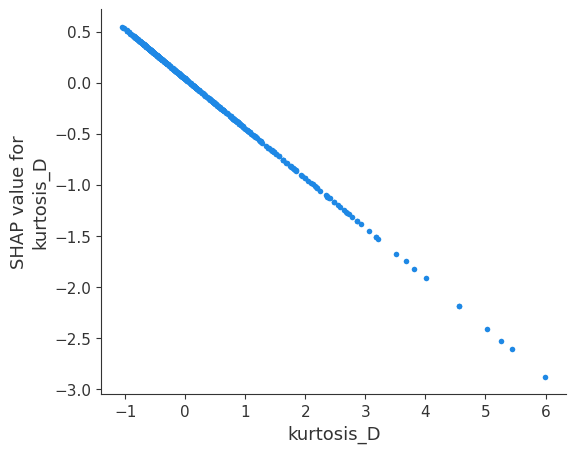

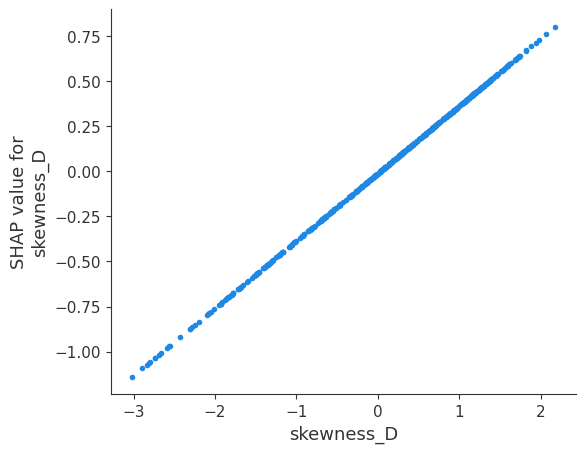

In [ ]:
shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test)

#### Single Monitor

Average Train Accuracy: 0.4568
Average Train MSE: 1.1403
Average Train Precision: 0.4554
Average Train F1: 0.4491
Average Train Duration: nan
Average Test Accuracy: 0.5416
Best Test Accuracy: 0.5427


Mean of empty slice.
invalid value encountered in scalar divide


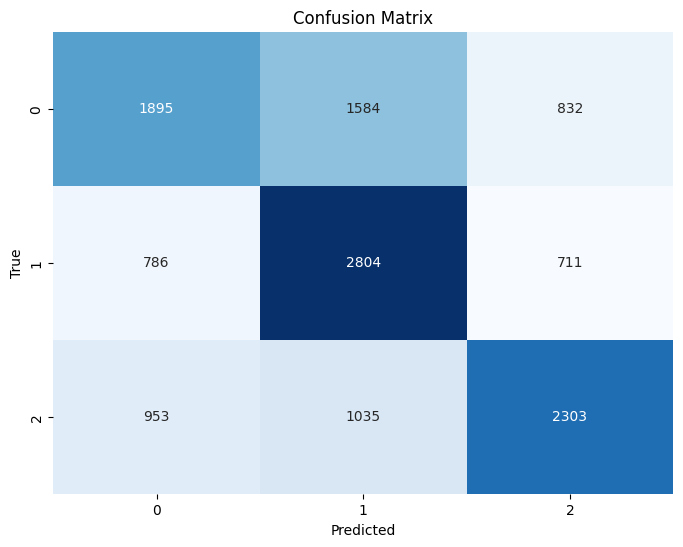

In [ ]:
# no scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
best_model, X_train, X_test = in_time_logistic_classifier_w_kfold(5, train_data, test_data, False)

Average Train Accuracy: 0.4568
Average Train MSE: 1.1403
Average Train Precision: 0.4554
Average Train F1: 0.4491
Average Train Duration: nan
Average Test Accuracy: 0.5416
Best Test Accuracy: 0.5427


Mean of empty slice.
invalid value encountered in scalar divide


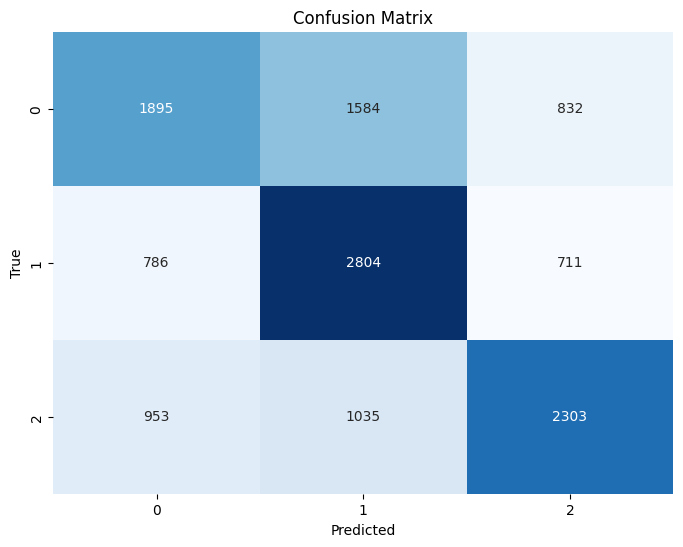

In [ ]:
#scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
best_model, X_train, X_test = in_time_logistic_classifier_w_kfold(5, train_data, test_data, True)

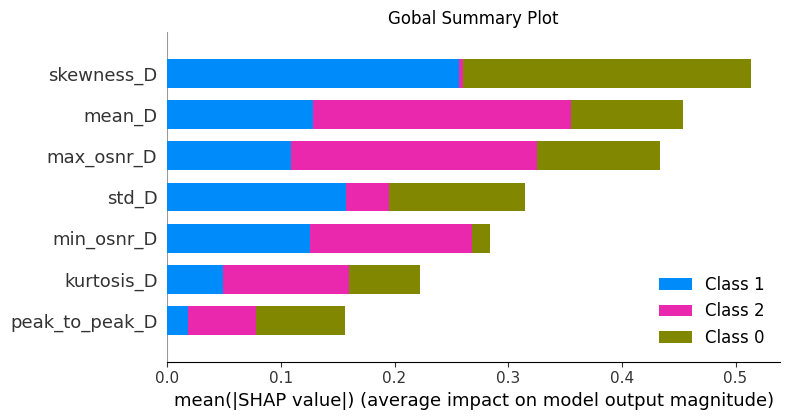

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


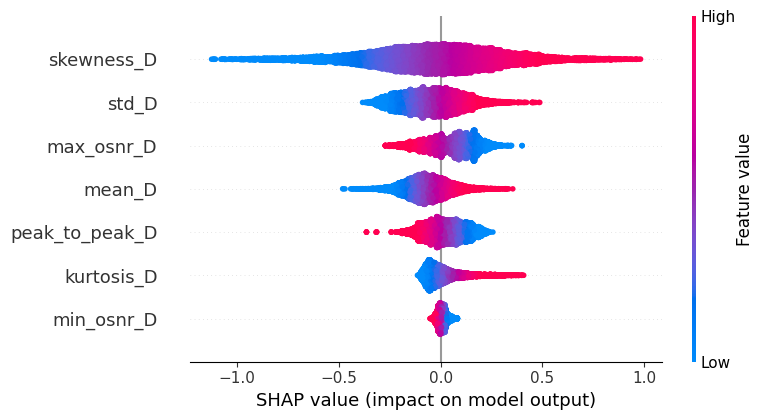

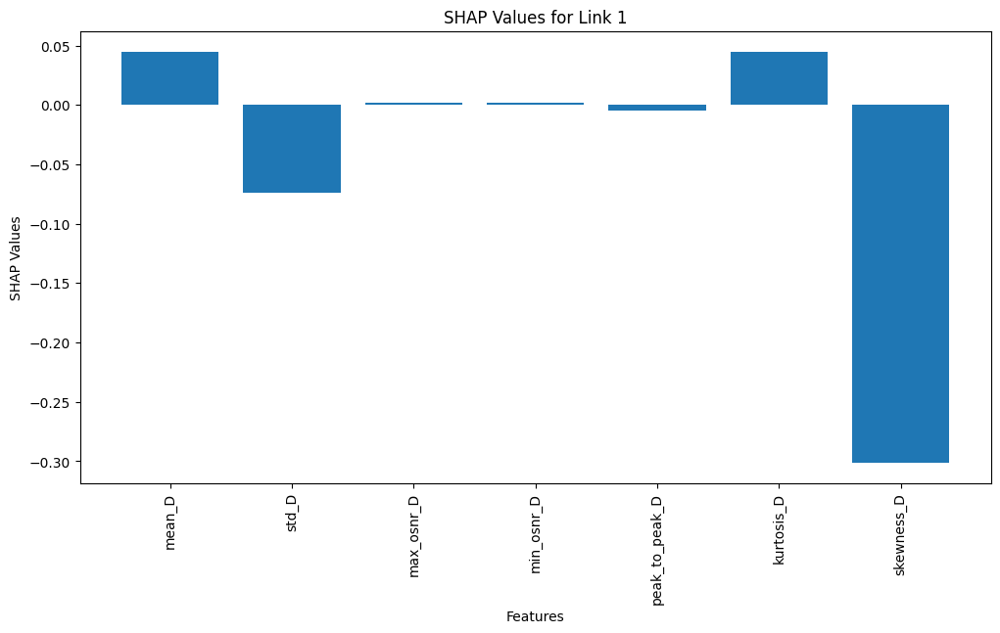

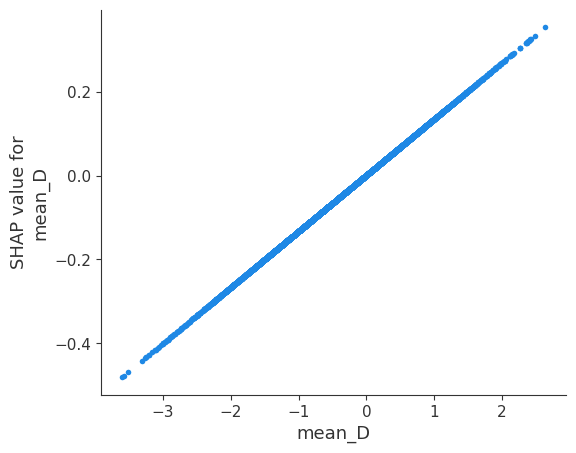

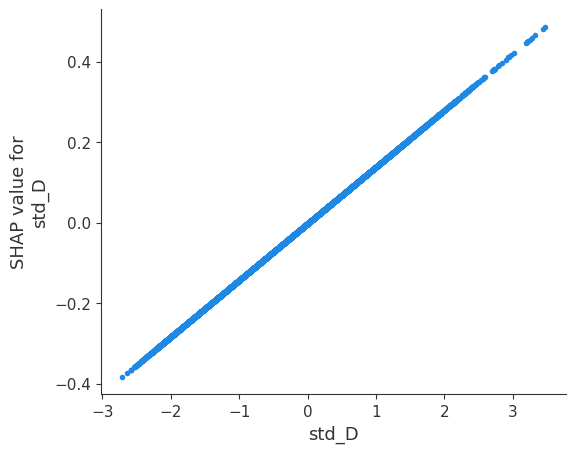

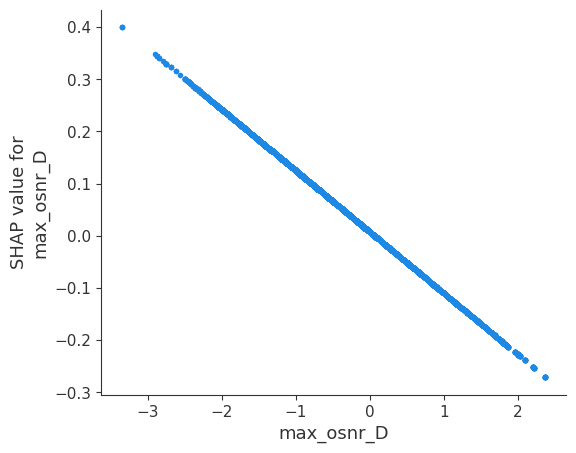

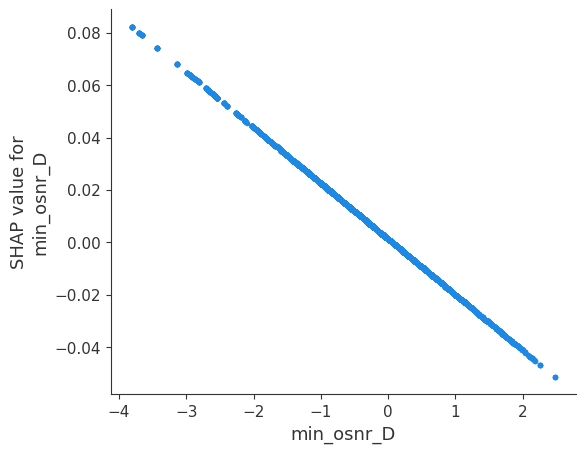

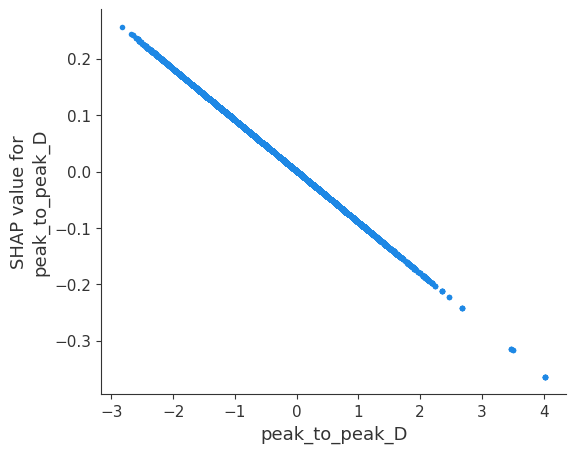

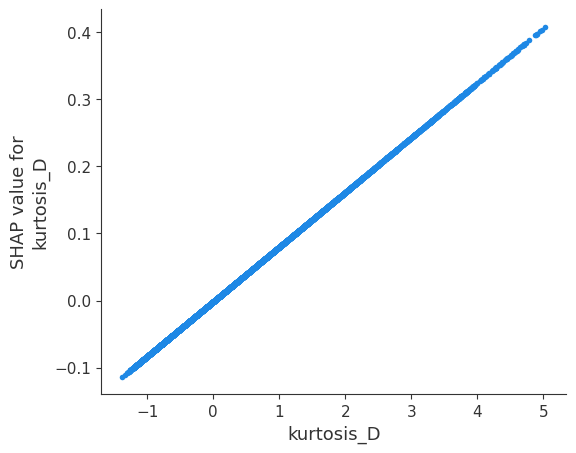

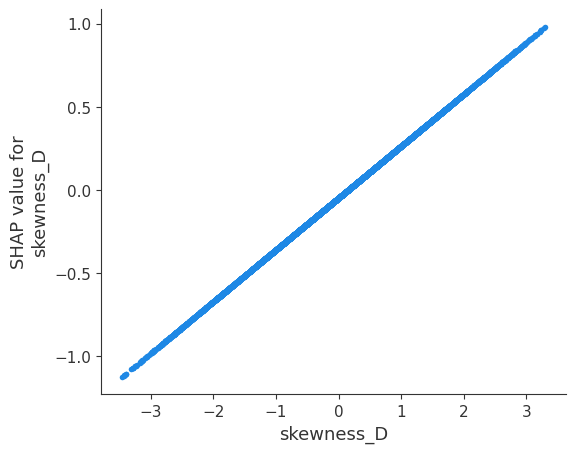

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


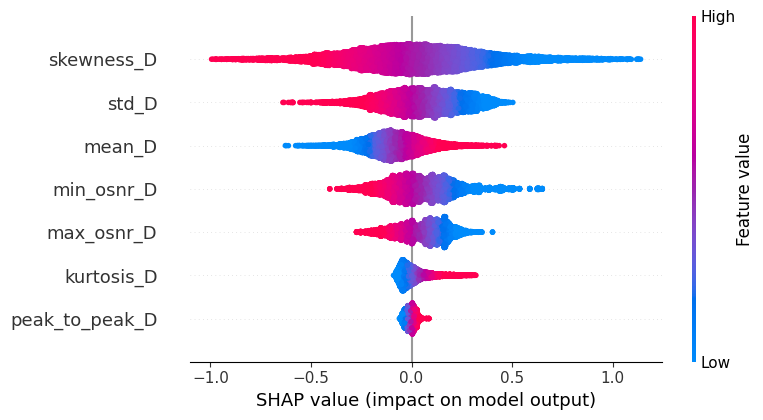

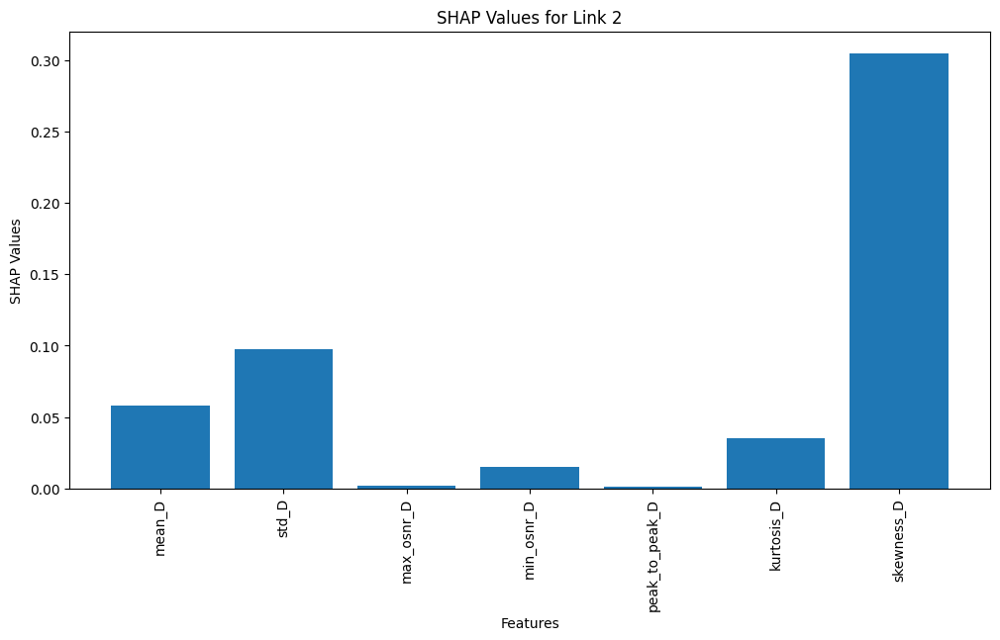

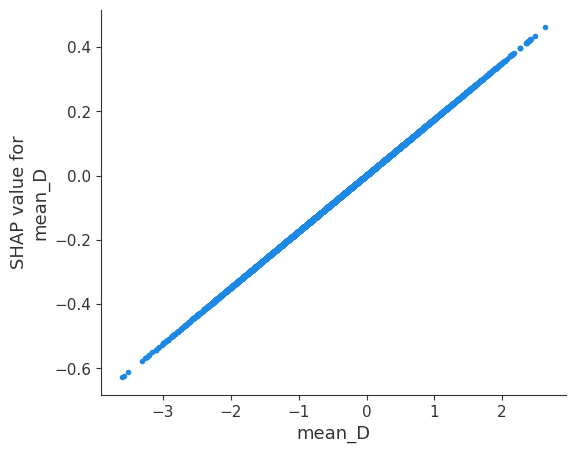

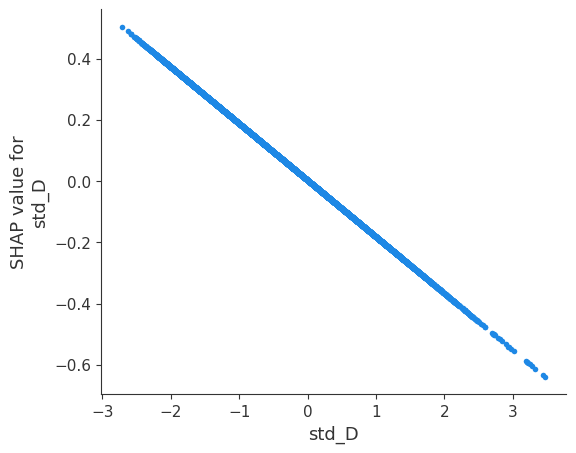

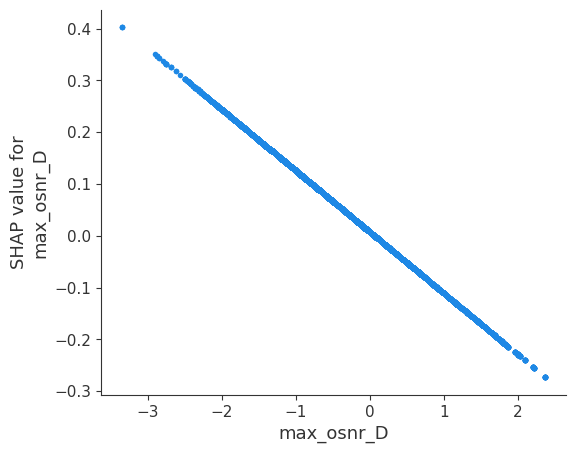

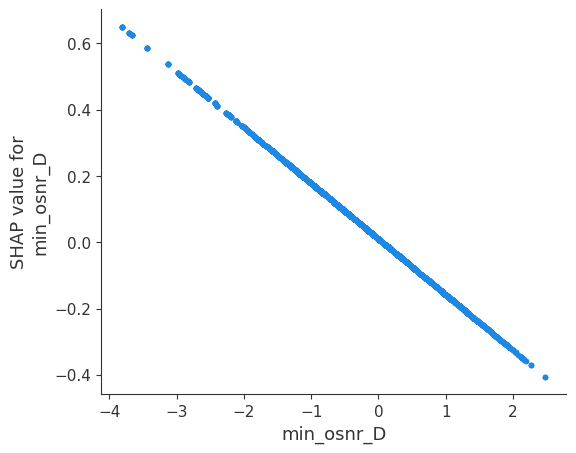

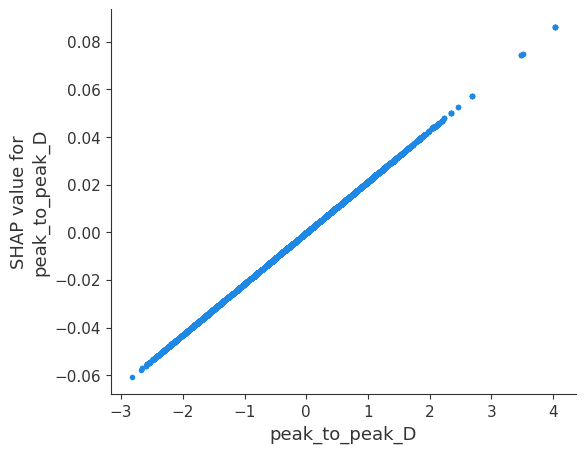

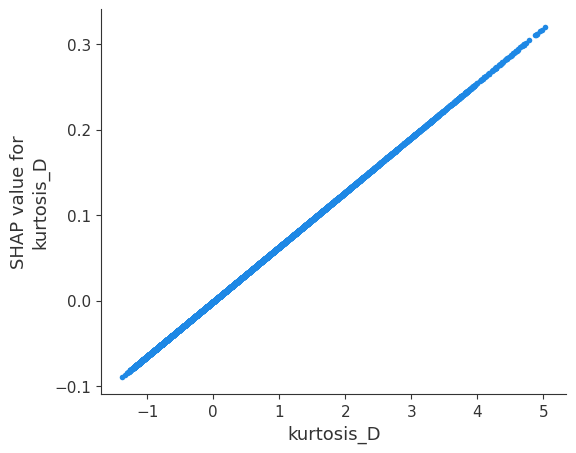

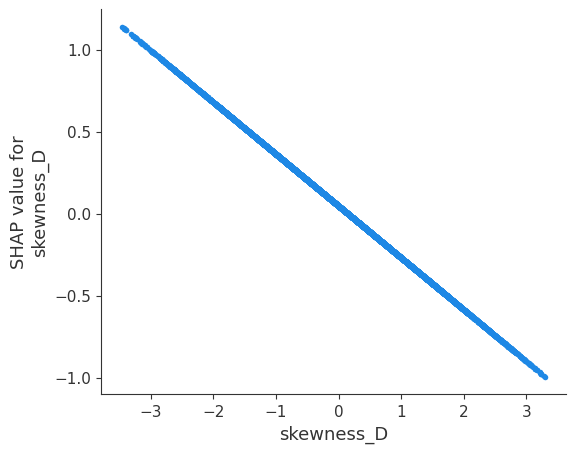

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


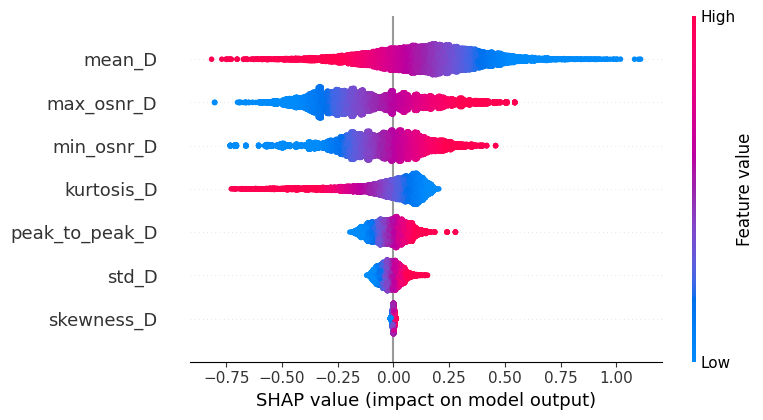

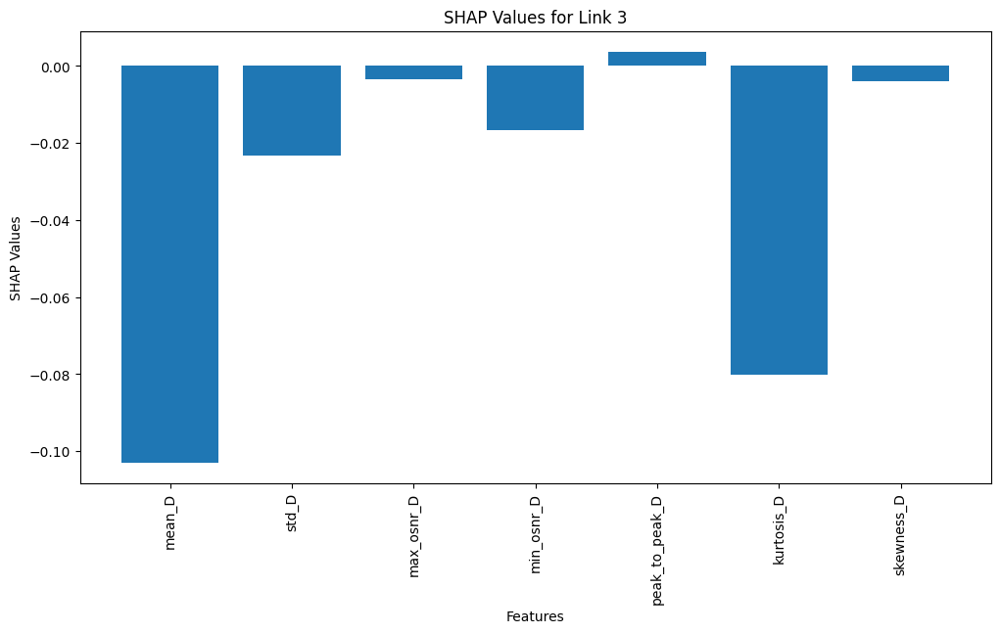

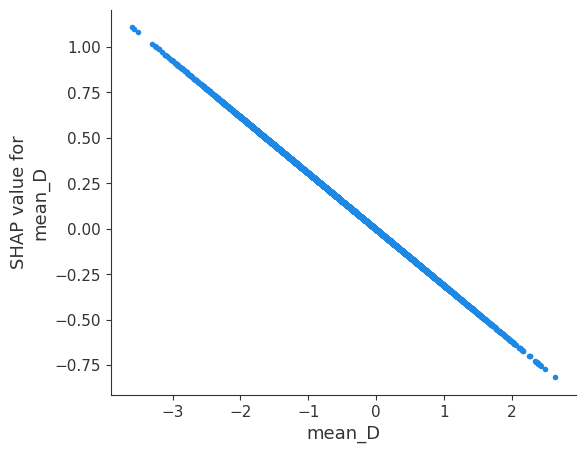

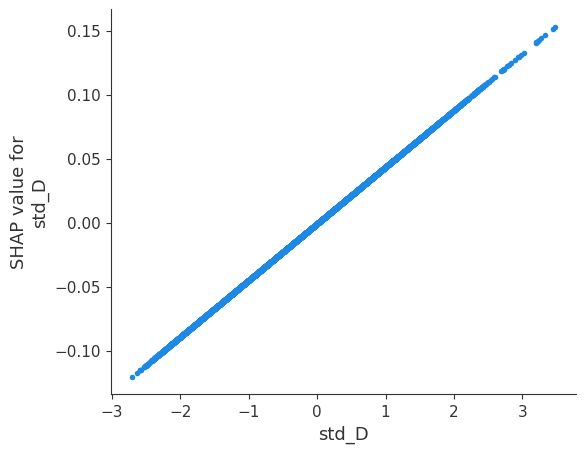

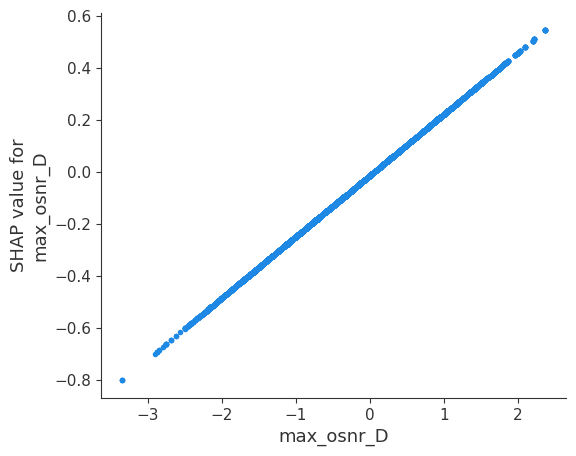

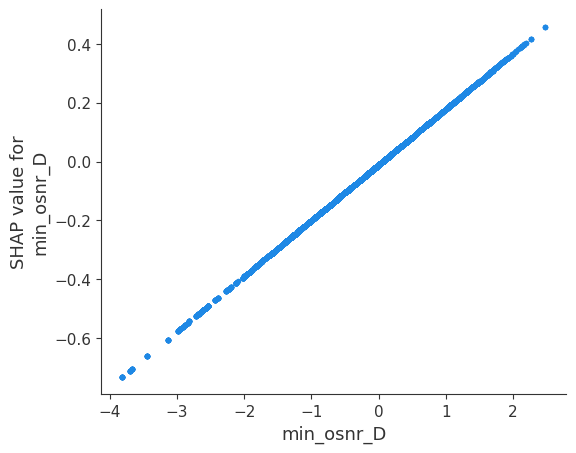

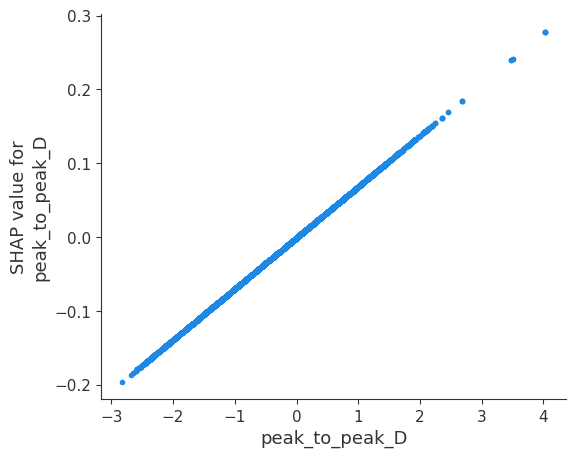

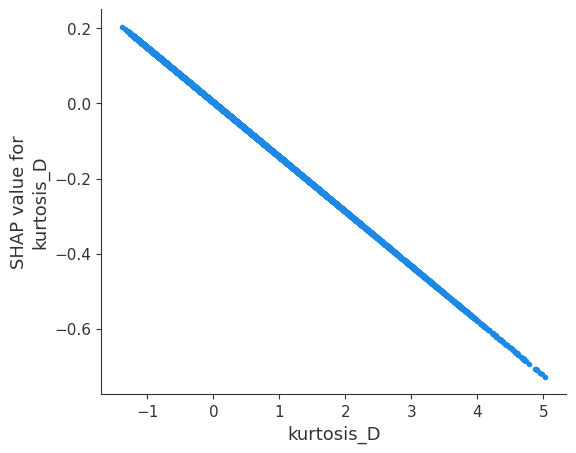

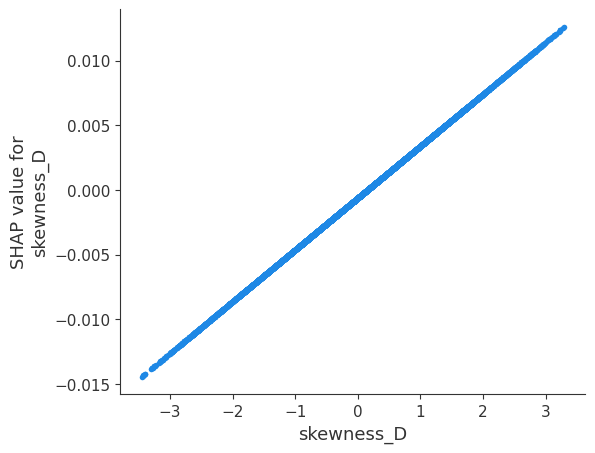

In [ ]:
shap_plots_explainable_ai_linear_explainer(best_model, X_train, X_test)

### XGBoost

In [ ]:
def in_time_xgb_classifier_w_kfold(n_splits, train_df, test_df, is_scaled):
    """
    Classification with XGBoost, using hyperparameter tuning
    """
    # define parameter grid
    param_grid = {
        'n_estimators': [50, 100], # Number of trees or boosting rounds
        'max_depth': [4, 6], # Maximum depth of each tree
        # 'learning_rate': [0.01, 0.001], # Learning rate (step size) for each boosting round
    }

    # shuffle the datasets
    train_df = train_df.sample(frac=1, random_state=42)
    test_df = test_df.sample(frac=1, random_state=42)

    train_df.reset_index(drop=True, inplace=True)
    test_df.reset_index(drop=True, inplace=True)

    label_encoder = LabelEncoder()
    X_train, y_train = train_df.drop('link', axis=1), label_encoder.fit_transform(train_df['link'])
    X_test, y_test = test_df.drop('link', axis=1), label_encoder.fit_transform(test_df['link'])

    cols = X_train.columns

    if is_scaled:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    X_train = pd.DataFrame(X_train, columns=cols)
    X_test = pd.DataFrame(X_test, columns=cols)

    outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    inner_skf = StratifiedKFold(n_splits=2, shuffle=True, random_state=42)

    test_accuracies, train_accuracies, mse_scores, precision_scores, recall_scores, f1_scores, training_durations = [], [], [], [], [], [], []

    best_model, best_score = None, 0.0

    for train_index, test_index in outer_skf.split(X_train, y_train):
        X_train_fold, X_val_fold = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train_fold, y_val_fold = y_train[train_index], y_train[test_index]

        model = xgb.XGBClassifier(objective='multi:softmax', num_class=3)
        grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=inner_skf)

        start_time = time.time()
        grid_search.fit(X_train_fold, y_train_fold)
        training_durations.append(time.time() - start_time)

        y_pred_val = grid_search.best_estimator_.predict(X_val_fold)
        train_accuracies.append(accuracy_score(y_val_fold, y_pred_val))
        mse_scores.append(mean_squared_error(y_val_fold, y_pred_val))
        precision_scores.append(precision_score(y_val_fold, y_pred_val, average='macro'))
        recall_scores.append(recall_score(y_val_fold, y_pred_val, average='macro'))
        f1_scores.append(f1_score(y_val_fold, y_pred_val, average='macro'))

        y_pred_test = grid_search.best_estimator_.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred_test)
        test_accuracies.append(accuracy)

        if accuracy > best_score:
            best_score = accuracy
            best_model = grid_search.best_estimator_

    avg_metrics = {
        "Average Train Accuracy": np.mean(train_accuracies),
        "Average Train MSE": np.mean(mse_scores),
        "Average Train Precision": np.mean(precision_scores),
        "Average Train F1": np.mean(f1_scores),
        "Average Train Duration": np.mean(training_durations),
        "Average Test Accuracy": np.mean(test_accuracies)
    }

    for metric, value in avg_metrics.items():
        print(f"{metric}: {value:.4f}")

    print(f"Best Test Accuracy: {best_score:.4f}")

    y_pred_best = best_model.predict(X_test)
    confusion_best = confusion_matrix(y_test, y_pred_best)
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

    return best_model, X_test

#### Multiple Monitor

Average Train Accuracy: 0.9806
Average Train MSE: 0.0386
Average Train Precision: 0.9807
Average Train F1: 0.9806
Average Train Duration: 14.8067
Average Test Accuracy: 0.8729
Best Test Accuracy: 0.8744


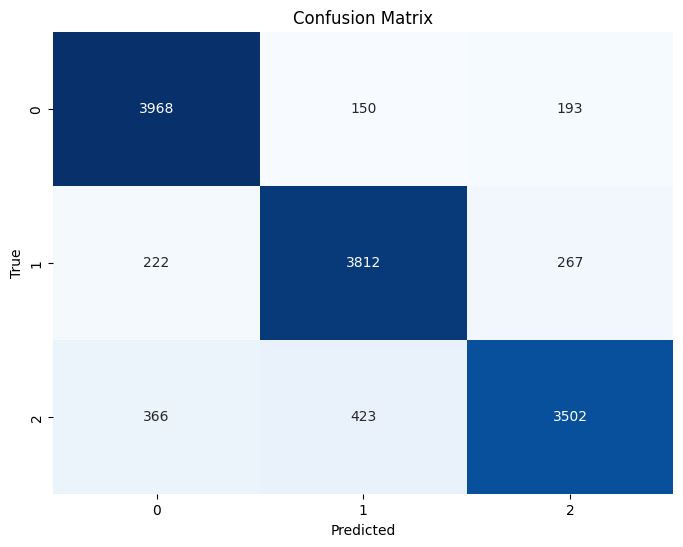

In [ ]:
# no scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.8)
best_model, X_test = in_time_xgb_classifier_w_kfold(5, train_data, test_data, False)

Average Train Accuracy: 0.9809
Average Train MSE: 0.0377
Average Train Precision: 0.9809
Average Train F1: 0.9809
Average Train Duration: 15.2445
Average Test Accuracy: 0.8736
Best Test Accuracy: 0.8751


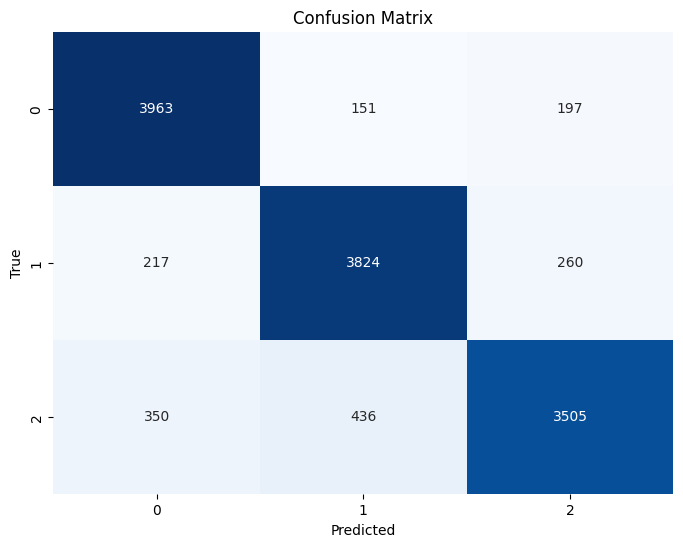

In [ ]:
# with scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.8)
best_model, X_test = in_time_xgb_classifier_w_kfold(5, train_data, test_data, True)

[09:07:30] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


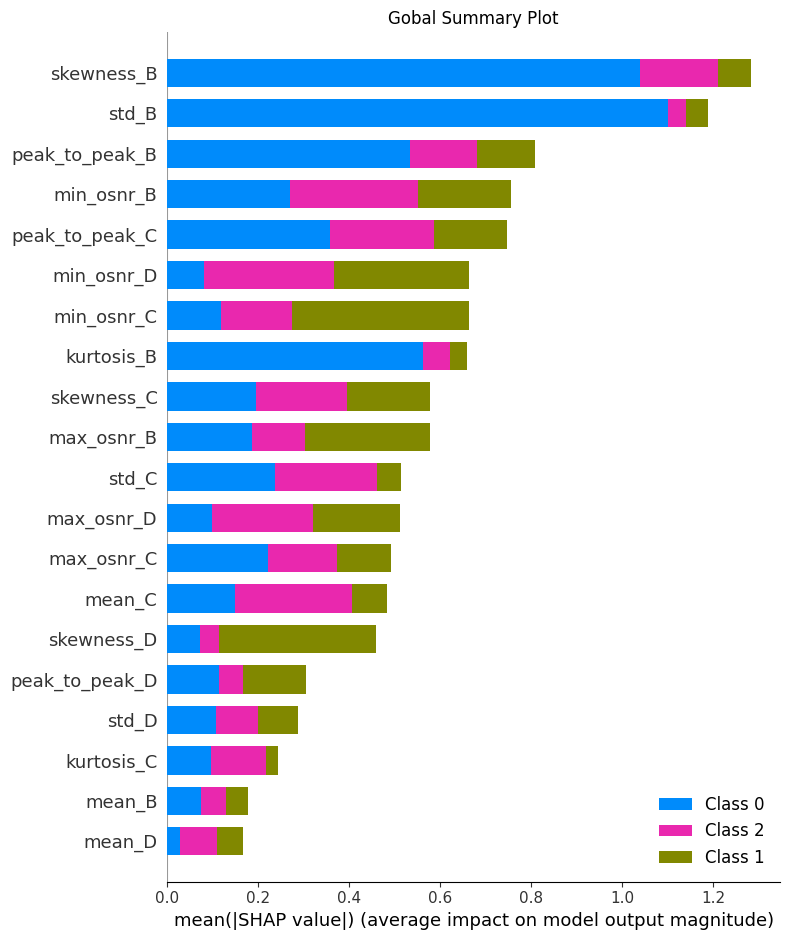

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


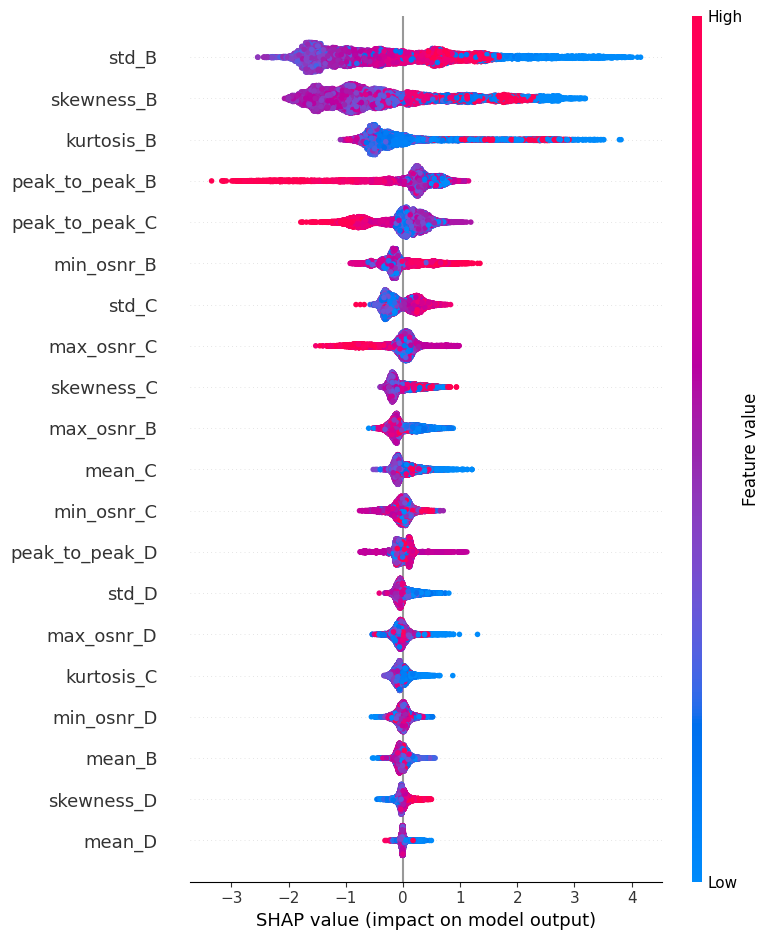

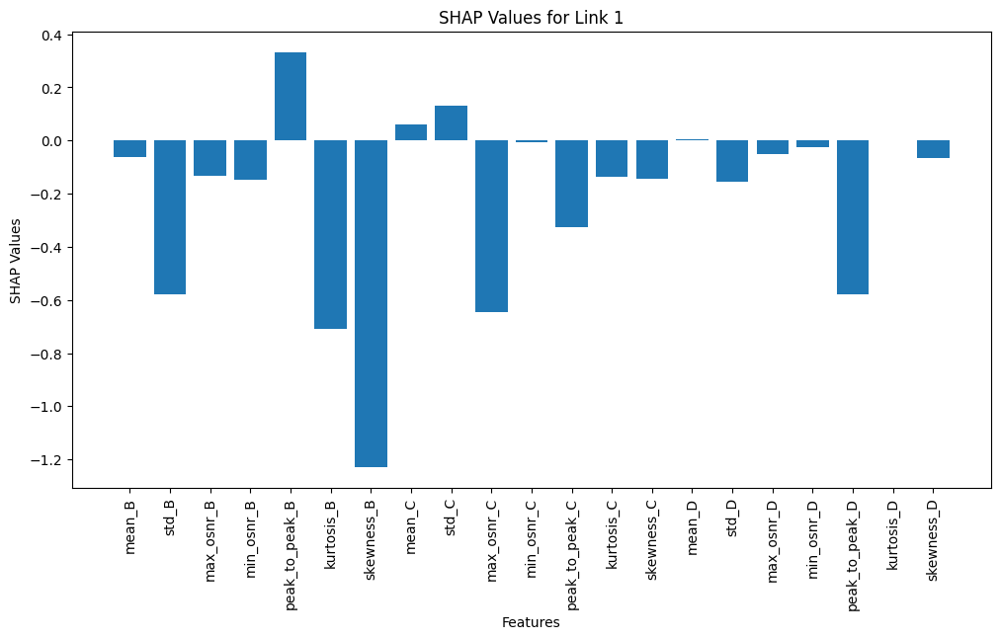

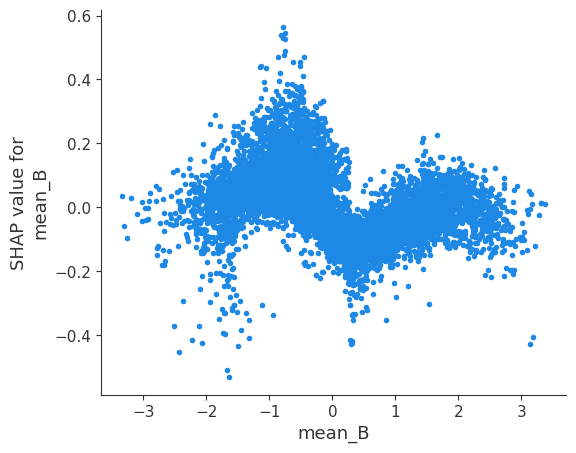

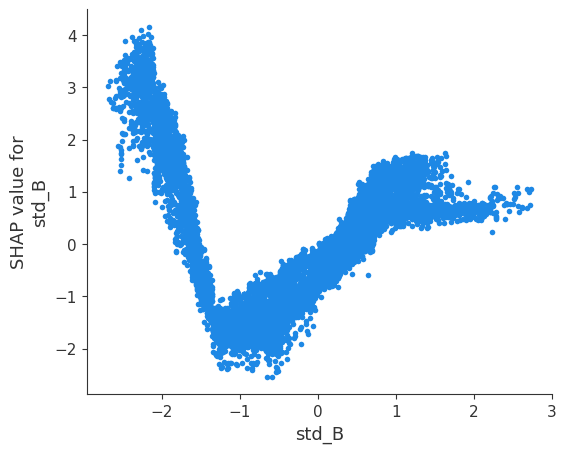

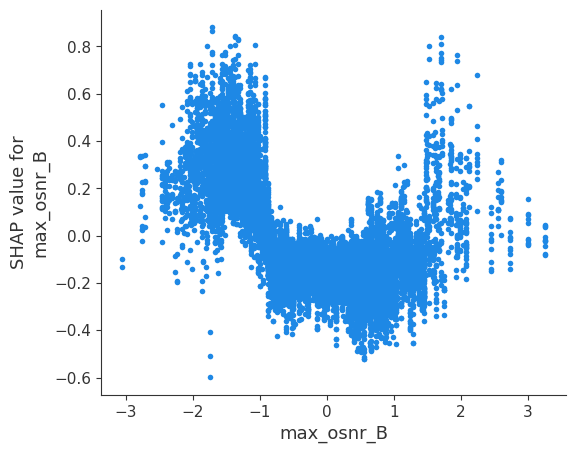

...

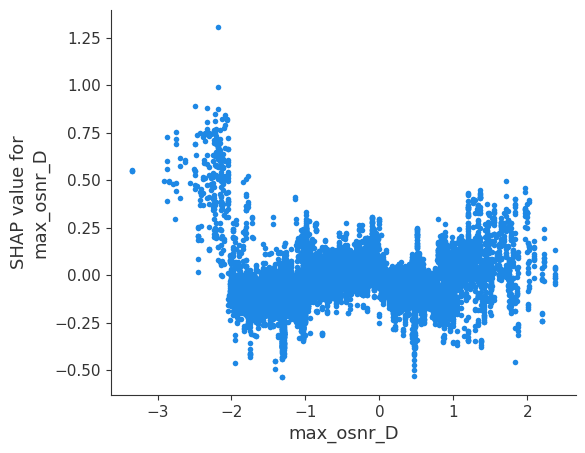

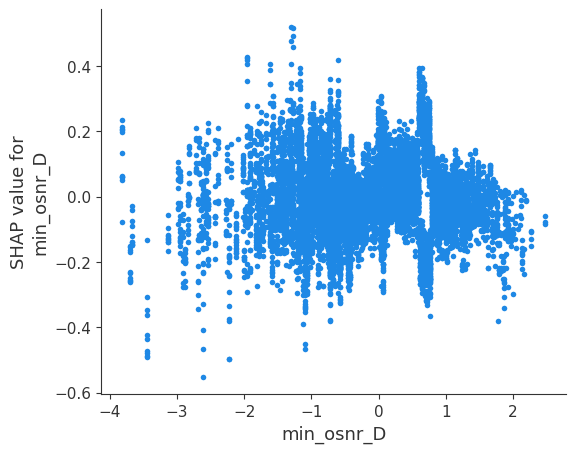

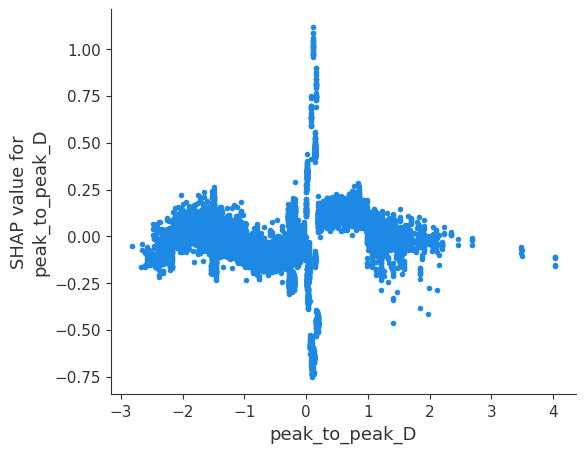

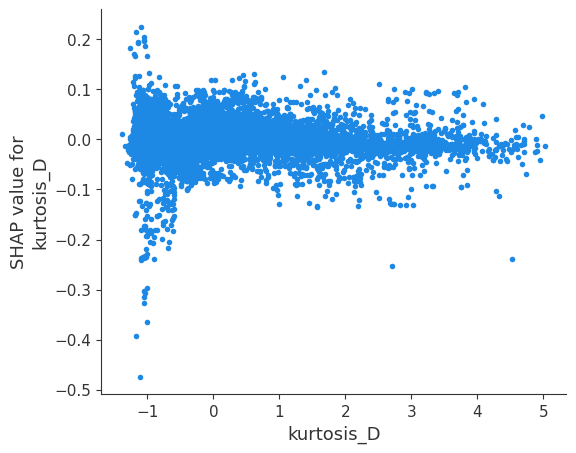

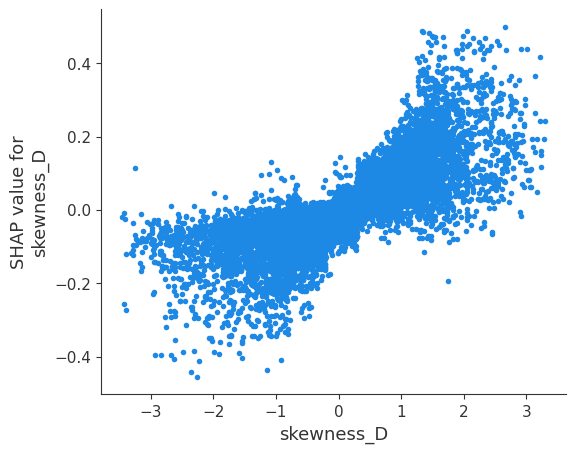

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


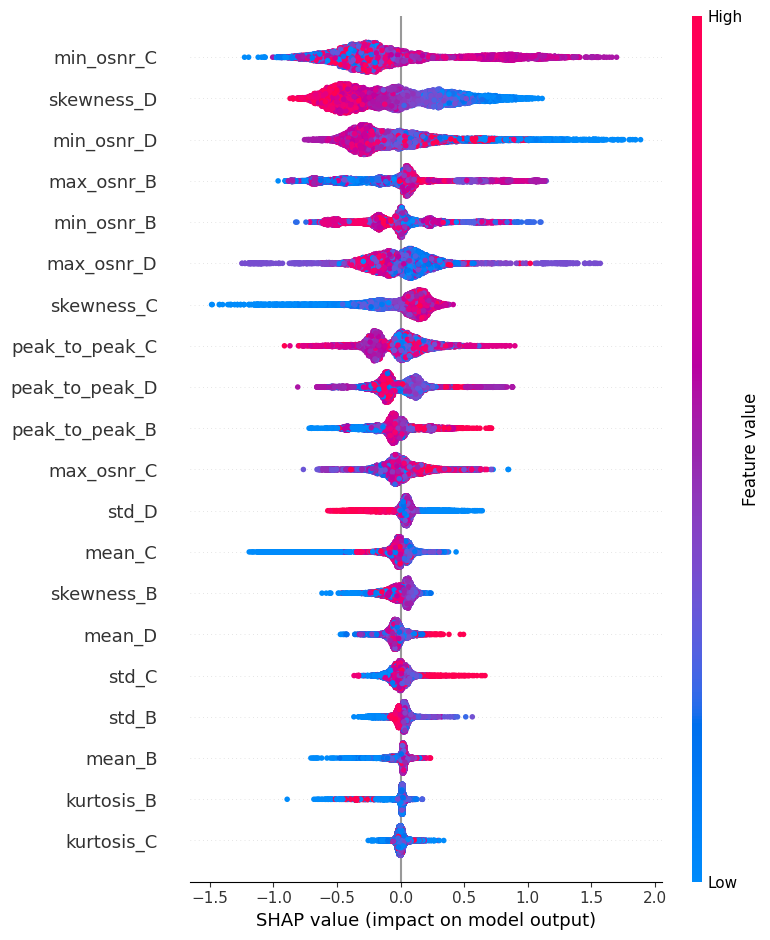

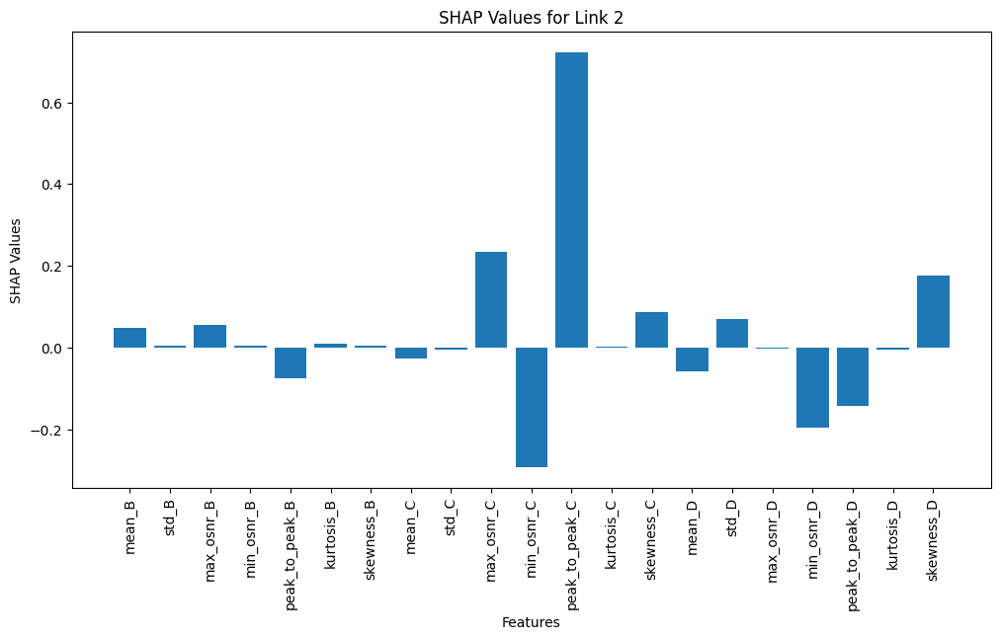

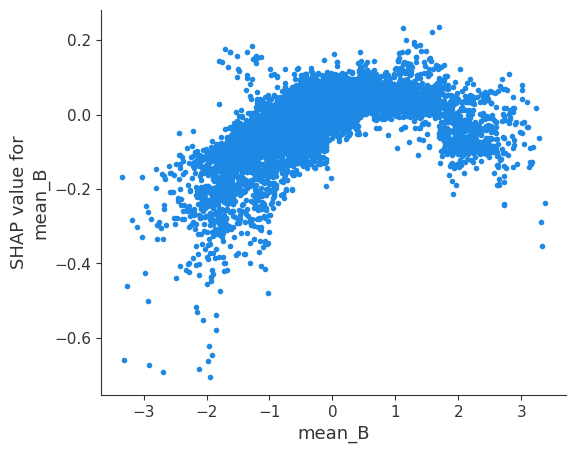

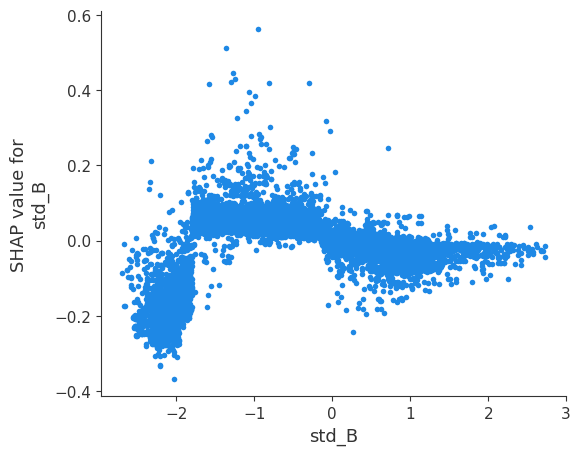

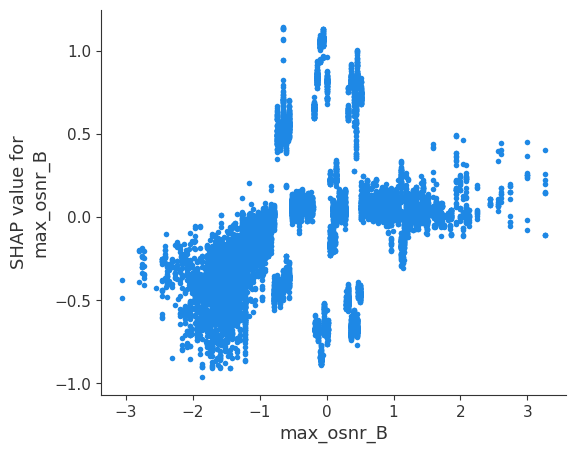

...

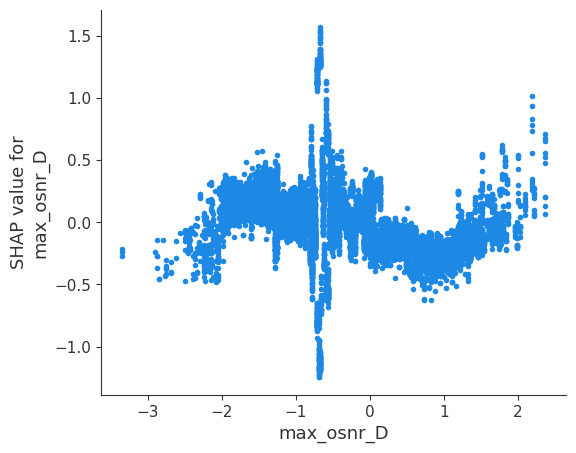

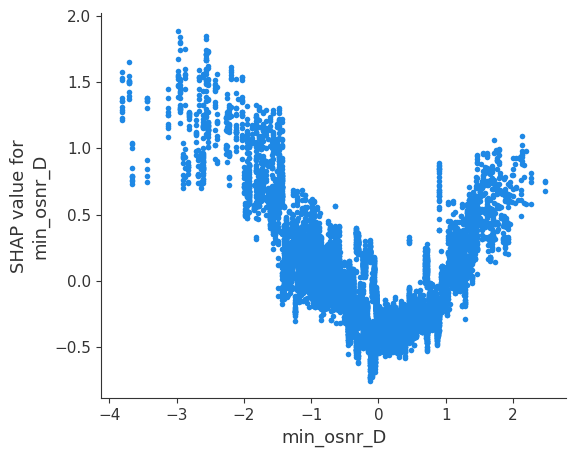

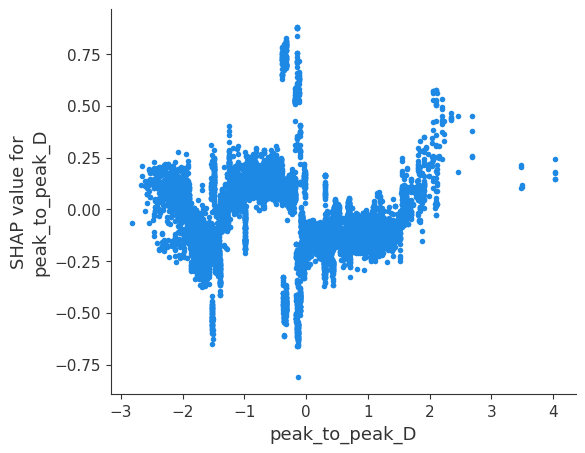

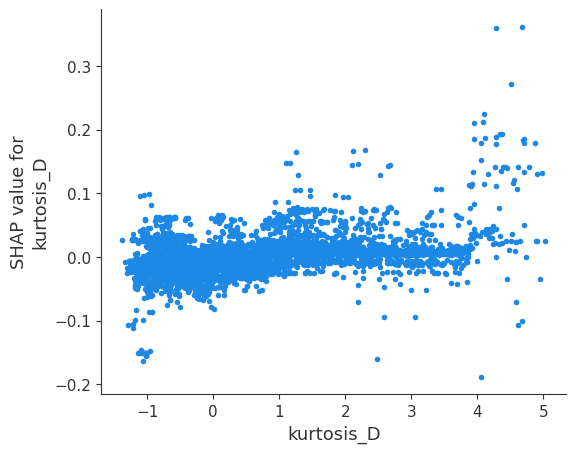

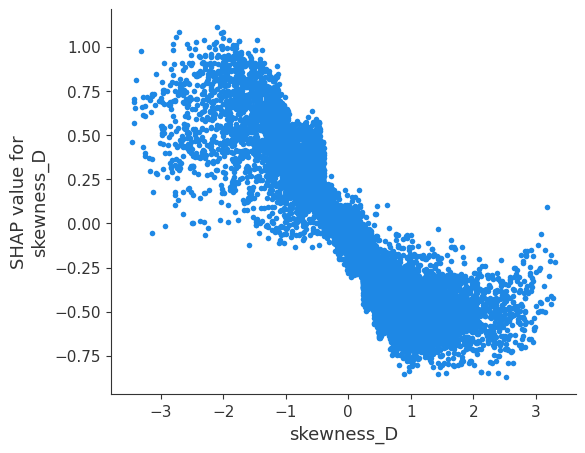

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


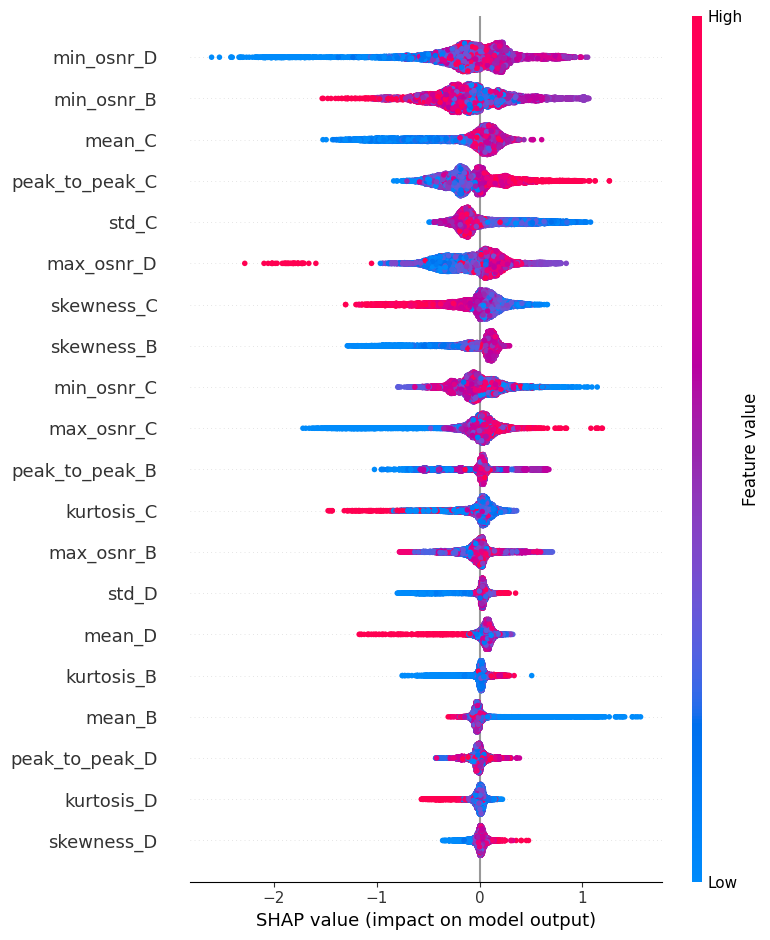

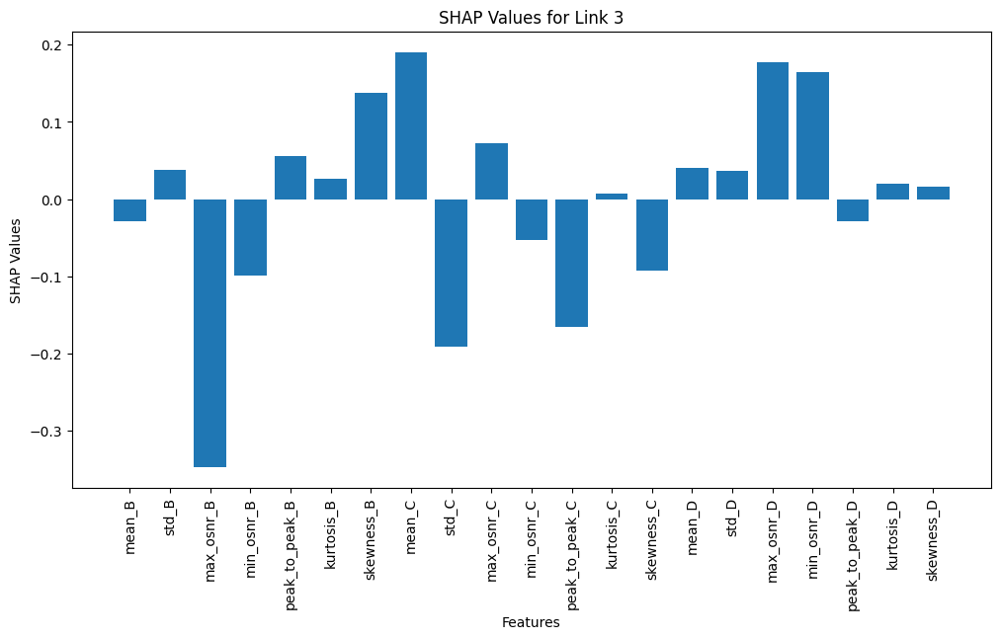

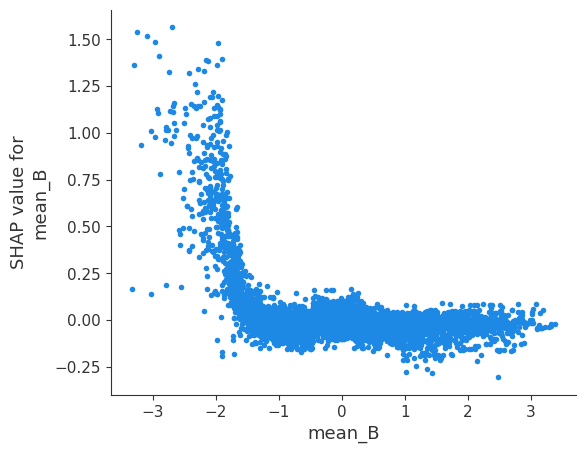

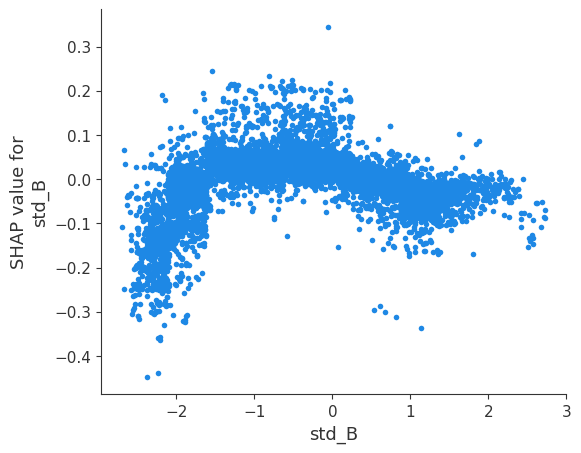

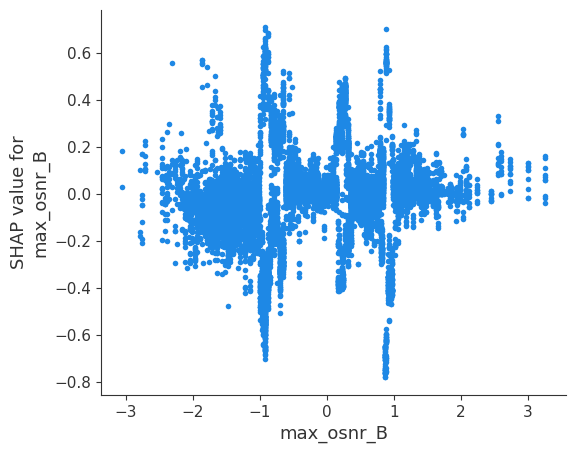

...

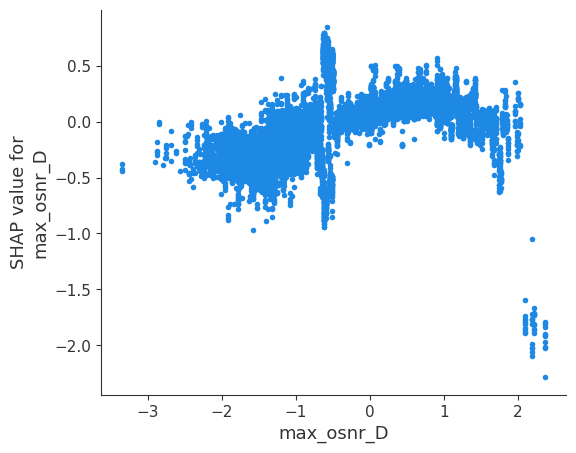

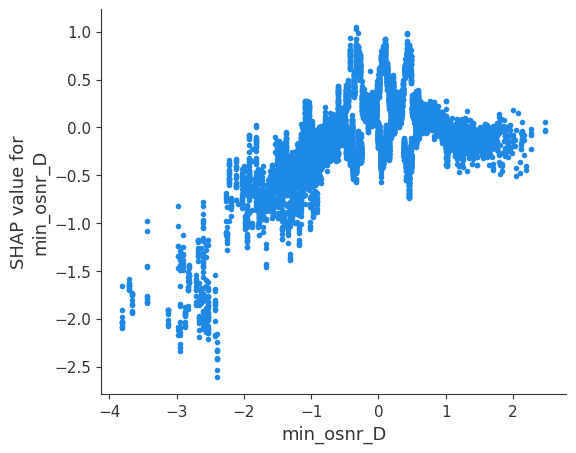

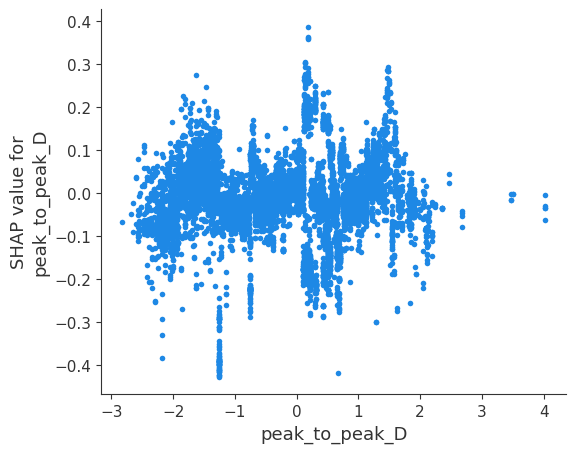

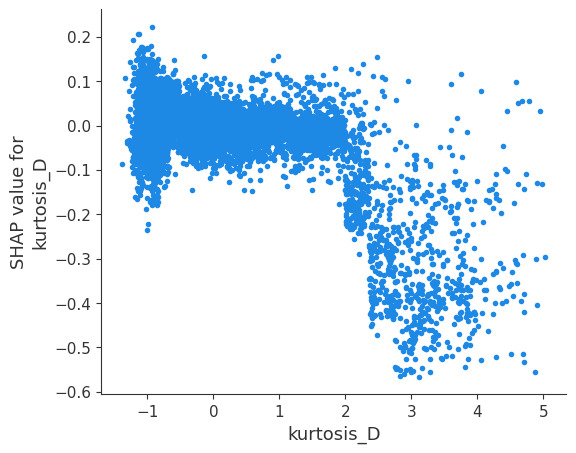

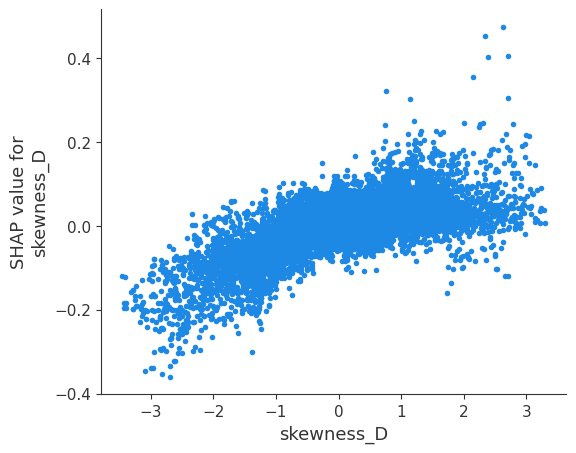

In [ ]:
shap_plots_explainable_ai_tree_explainer(best_model, X_test)

#### Single Monitor

Average Train Accuracy: 0.9431
Average Train MSE: 0.0895
Average Train Precision: 0.9435
Average Train F1: 0.9432
Average Train Duration: 6.7868
Average Test Accuracy: 0.8815
Best Test Accuracy: 0.8910


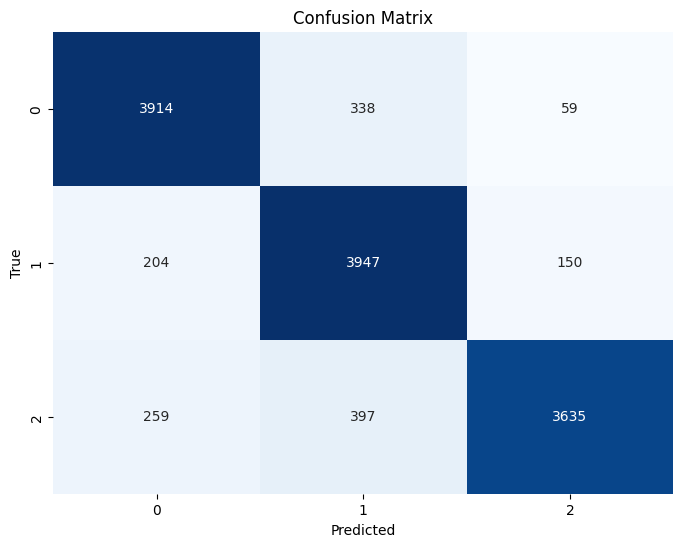

In [ ]:
# no scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
best_model, X_test = in_time_xgb_classifier_w_kfold(5, train_data, test_data, False)

Average Train Accuracy: 0.9434
Average Train MSE: 0.0892
Average Train Precision: 0.9438
Average Train F1: 0.9435
Average Train Duration: 7.0143
Average Test Accuracy: 0.8815
Best Test Accuracy: 0.8910


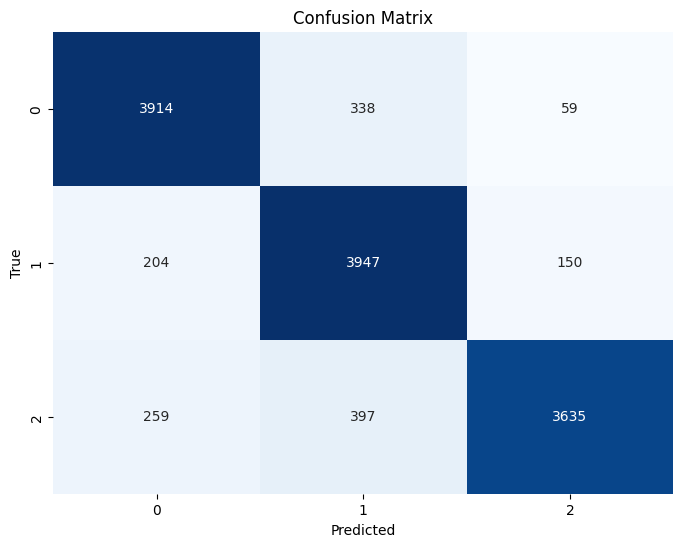

In [ ]:
# scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
best_model, X_test = in_time_xgb_classifier_w_kfold(5, train_data, test_data, True)

[09:09:34] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


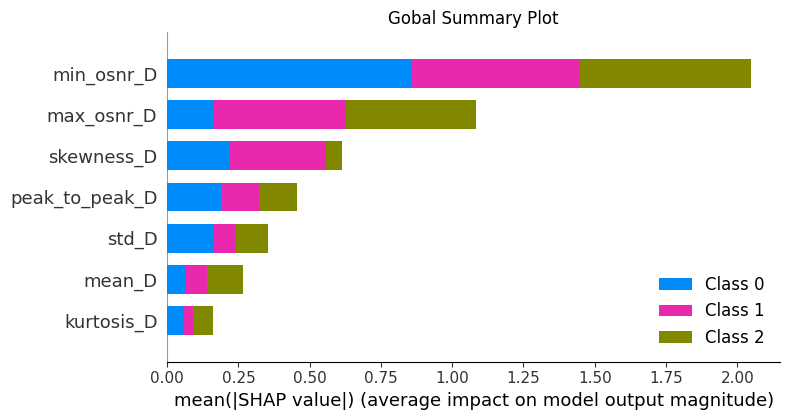

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


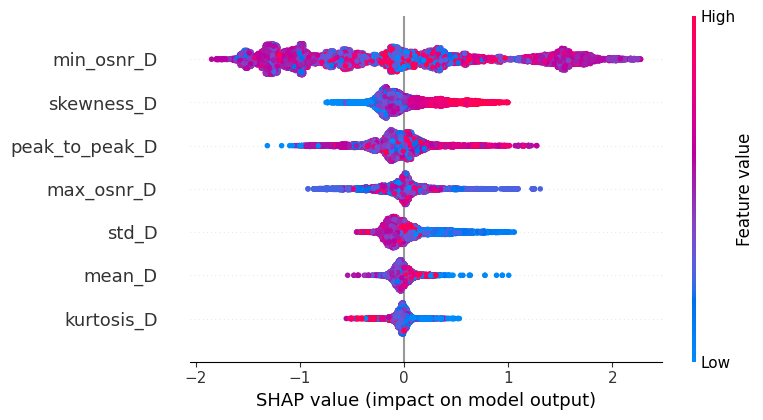

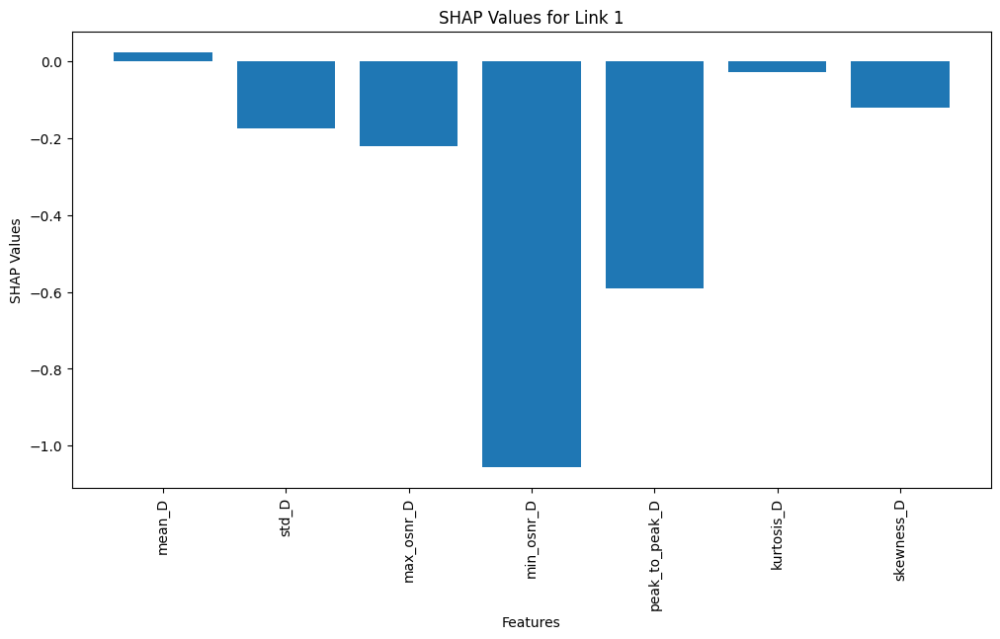

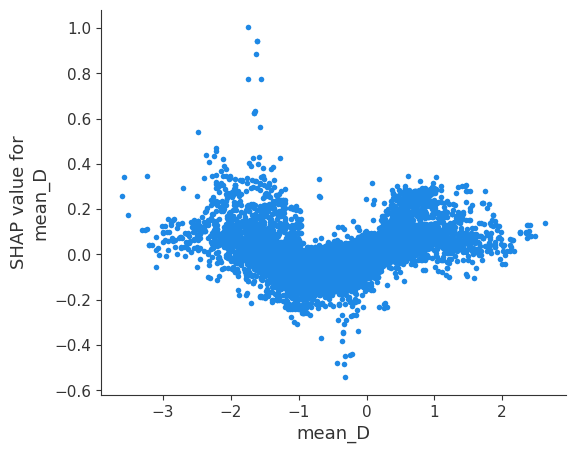

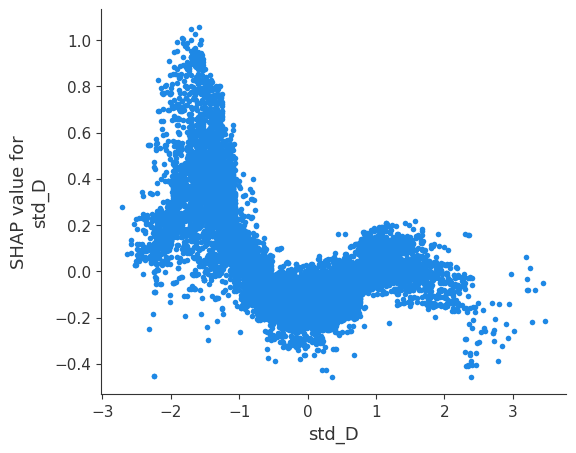

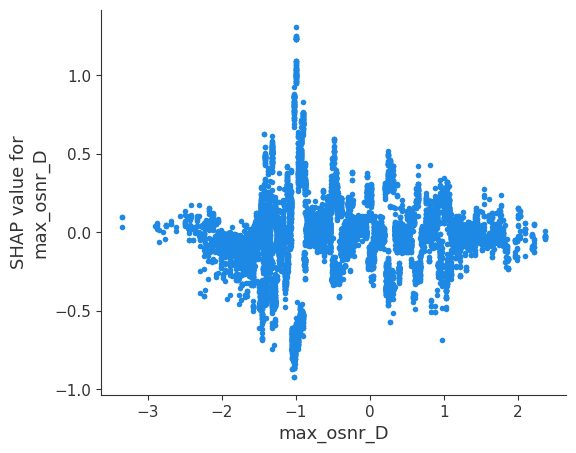

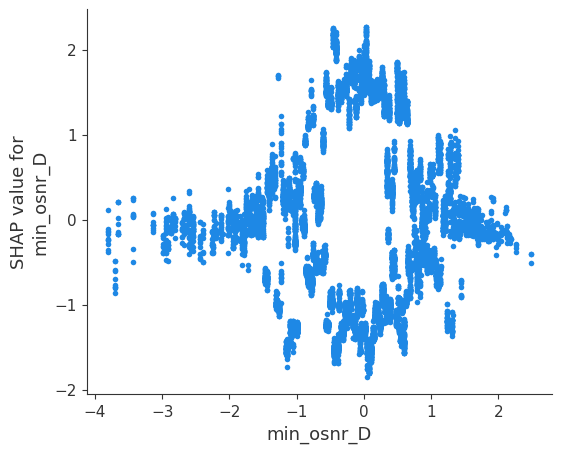

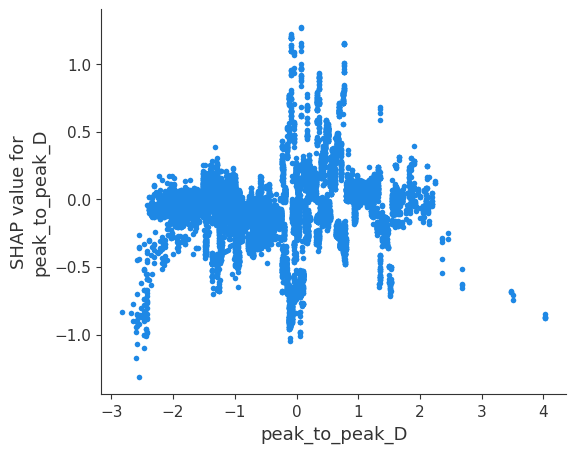

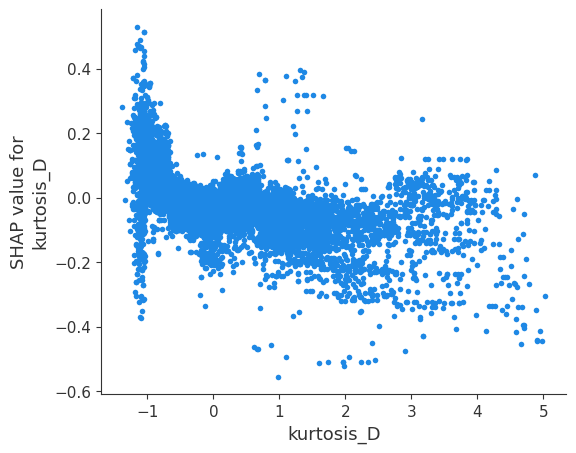

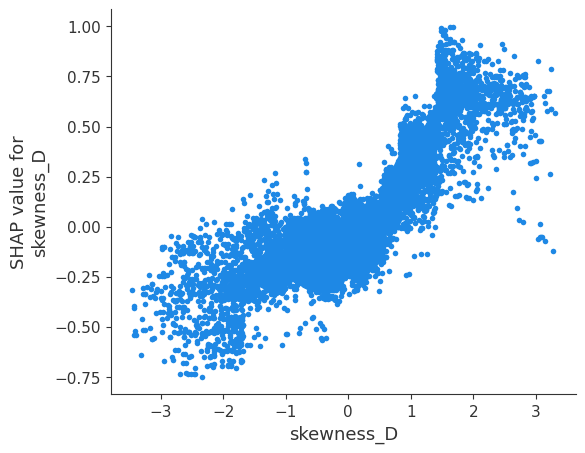

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


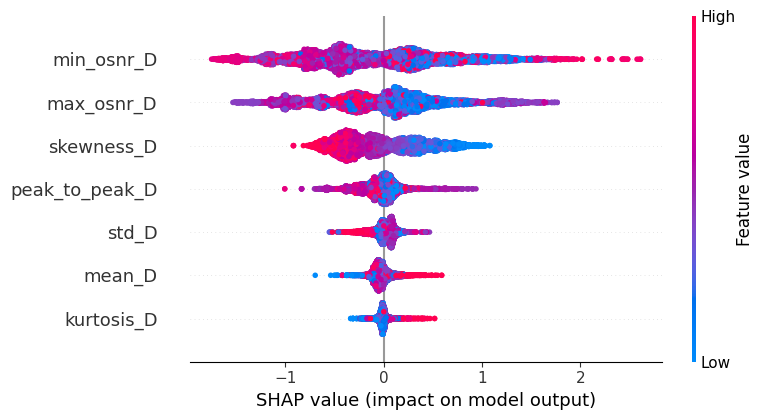

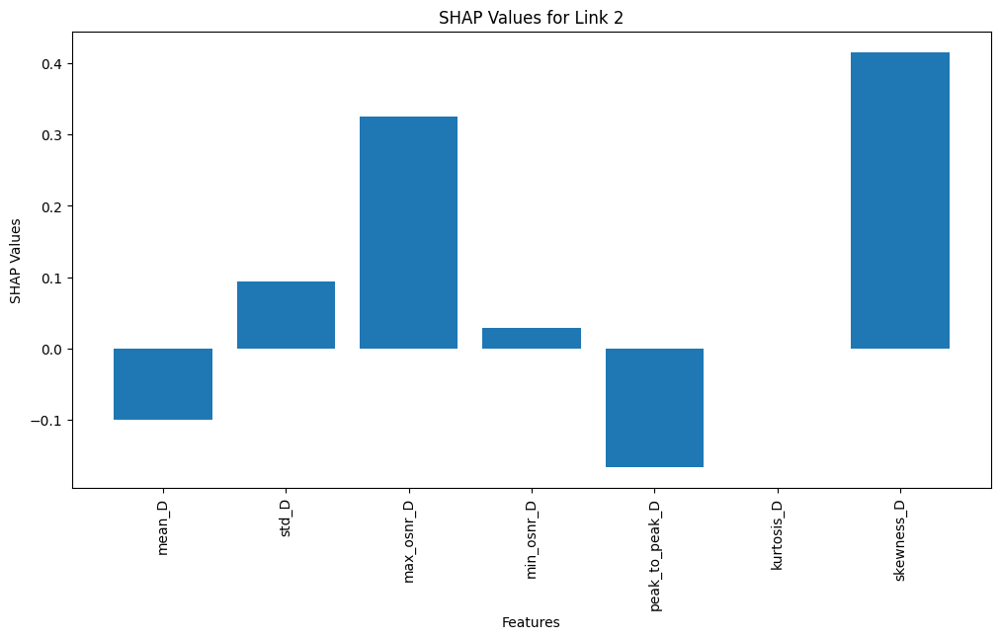

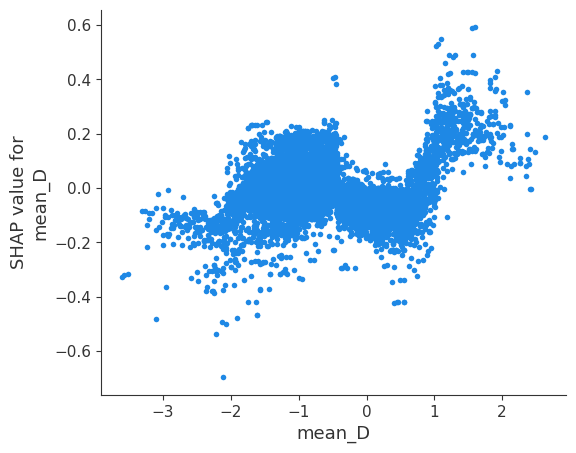

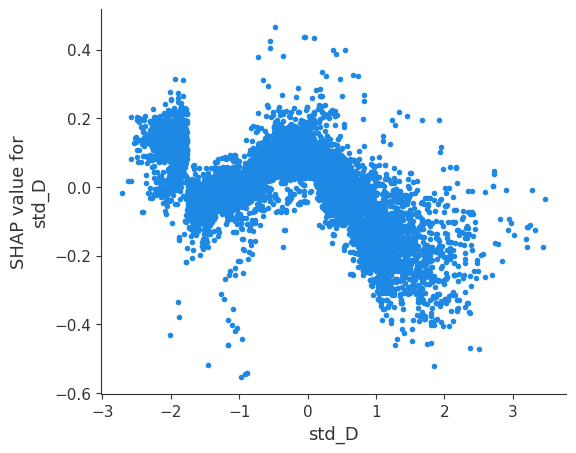

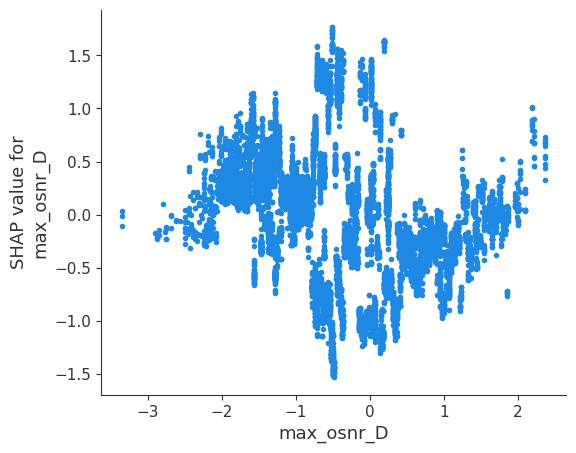

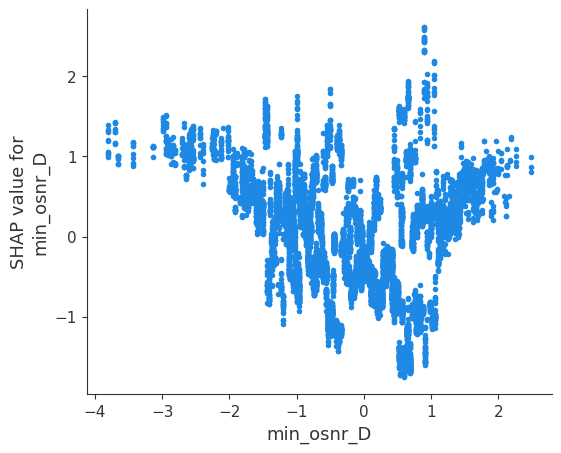

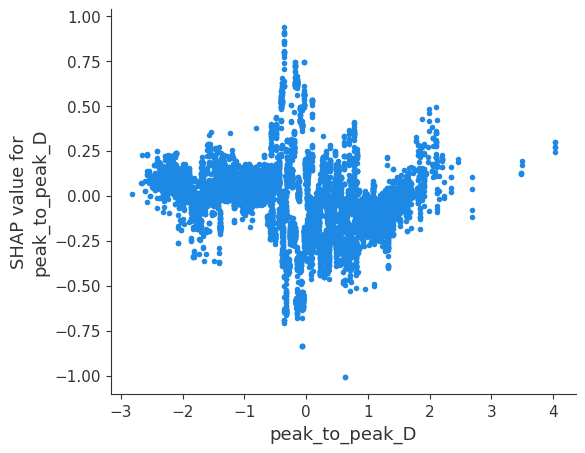

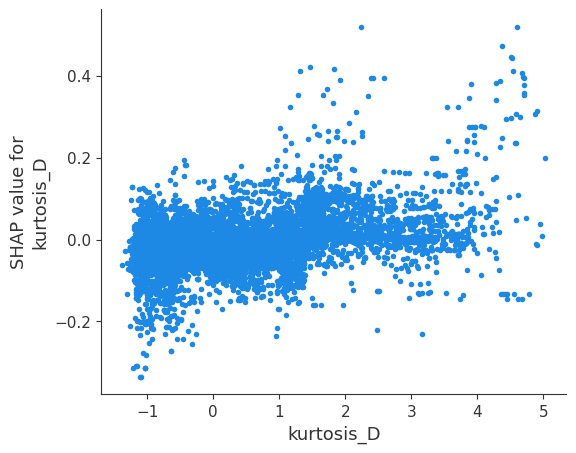

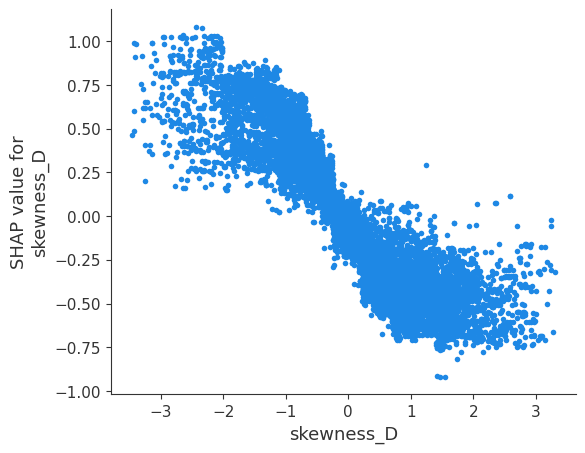

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


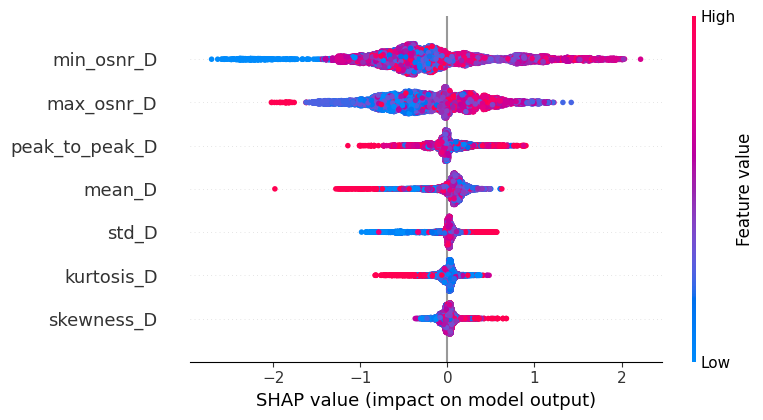

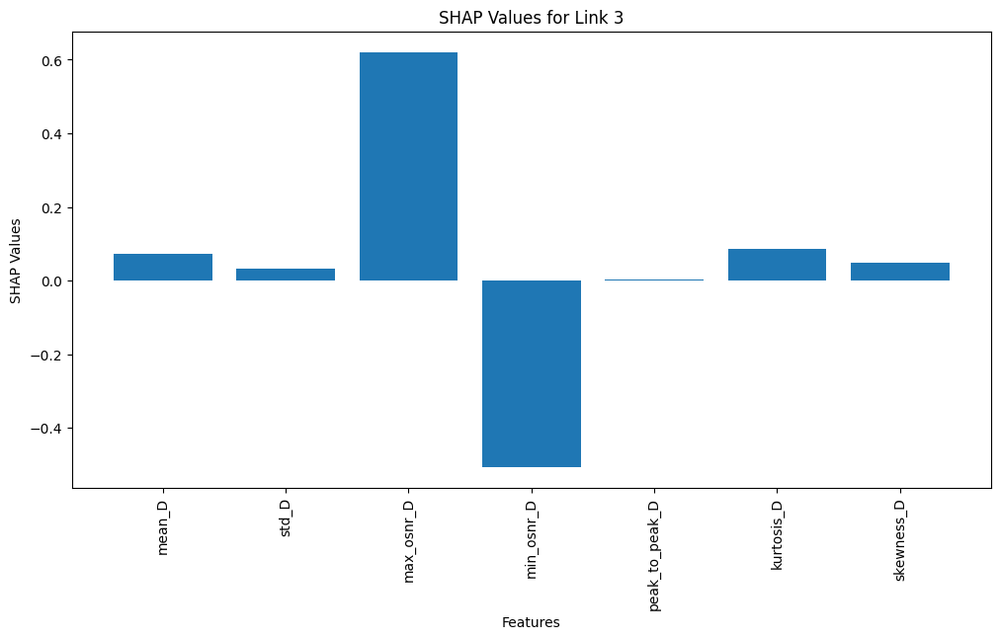

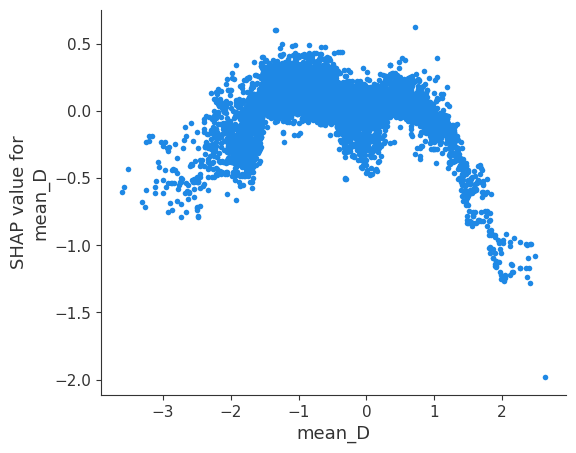

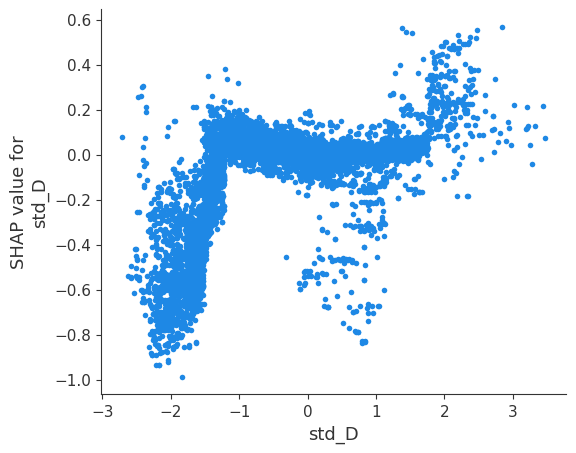

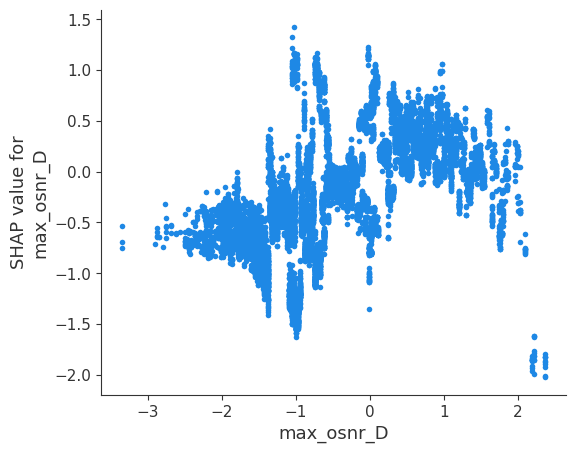

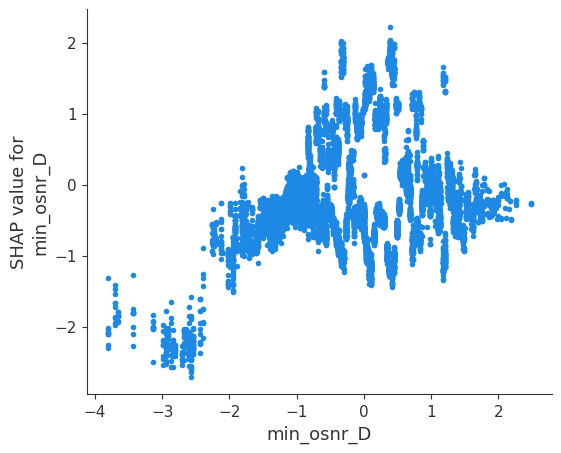

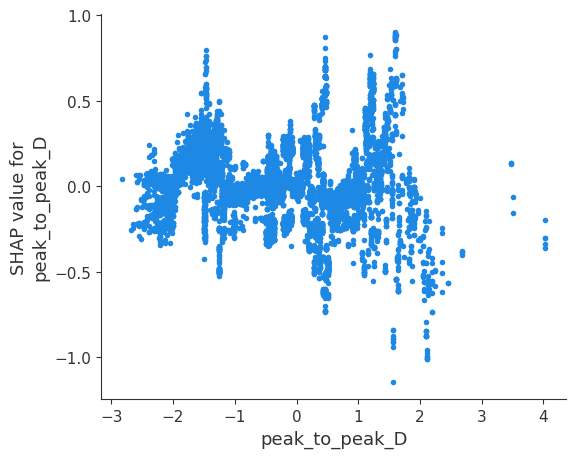

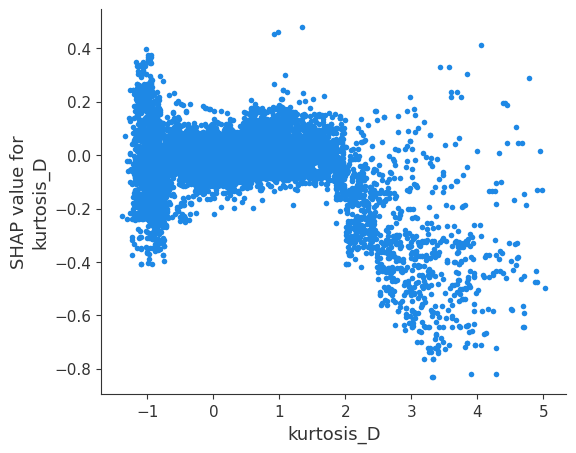

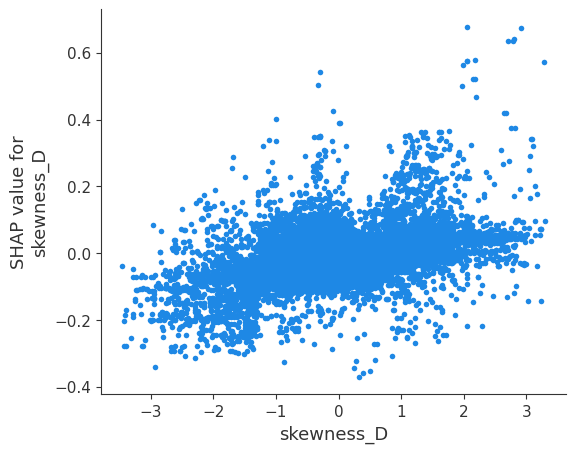

In [ ]:
shap_plots_explainable_ai_tree_explainer(best_model, X_test)

#### Bigger window sizes and spacing

#### Multiple Monitor

Average Train Accuracy: 0.9842
Average Train MSE: 0.0273
Average Train Precision: 0.9844
Average Train F1: 0.9842
Average Train Duration: 2.5956
Average Test Accuracy: 0.8382
Best Test Accuracy: 0.8554


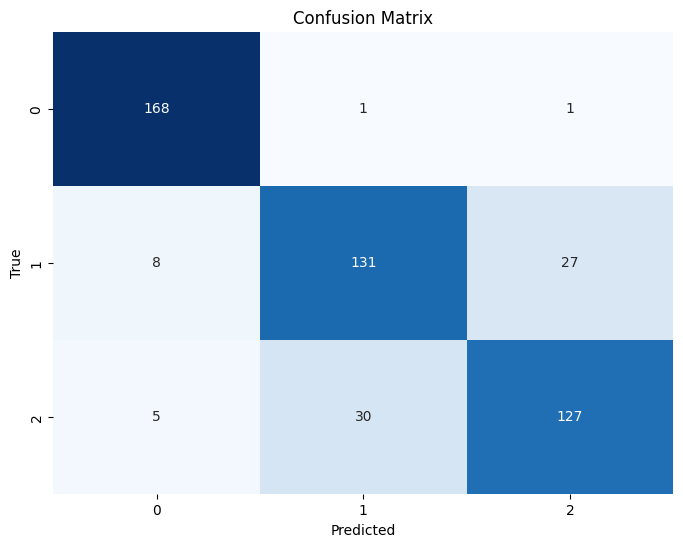

In [ ]:
# no scaling, window size=100, test size=0.2
train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.8)
best_model, X_test = in_time_xgb_classifier_w_kfold(5, train_data, test_data, False)

Average Train Accuracy: 0.9842
Average Train MSE: 0.0273
Average Train Precision: 0.9844
Average Train F1: 0.9842
Average Train Duration: 2.4165
Average Test Accuracy: 0.8382
Best Test Accuracy: 0.8554


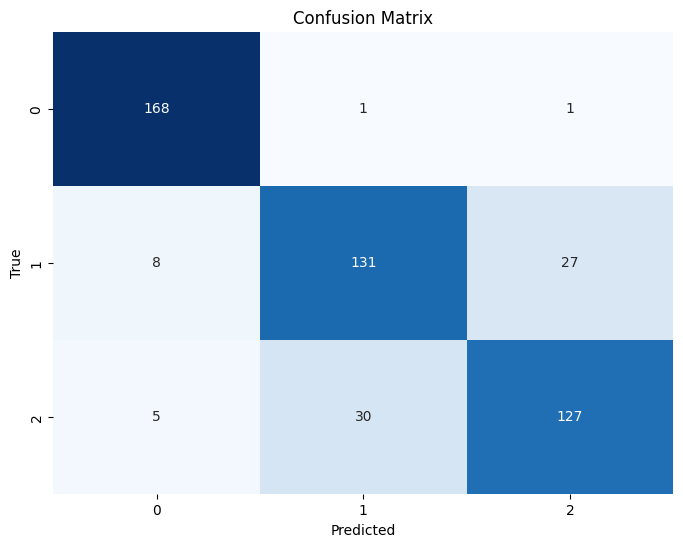

In [ ]:
# scaling, window size=100, test size=0.2
train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.8)
best_model, X_test = in_time_xgb_classifier_w_kfold(5, train_data, test_data, True)

[09:10:25] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


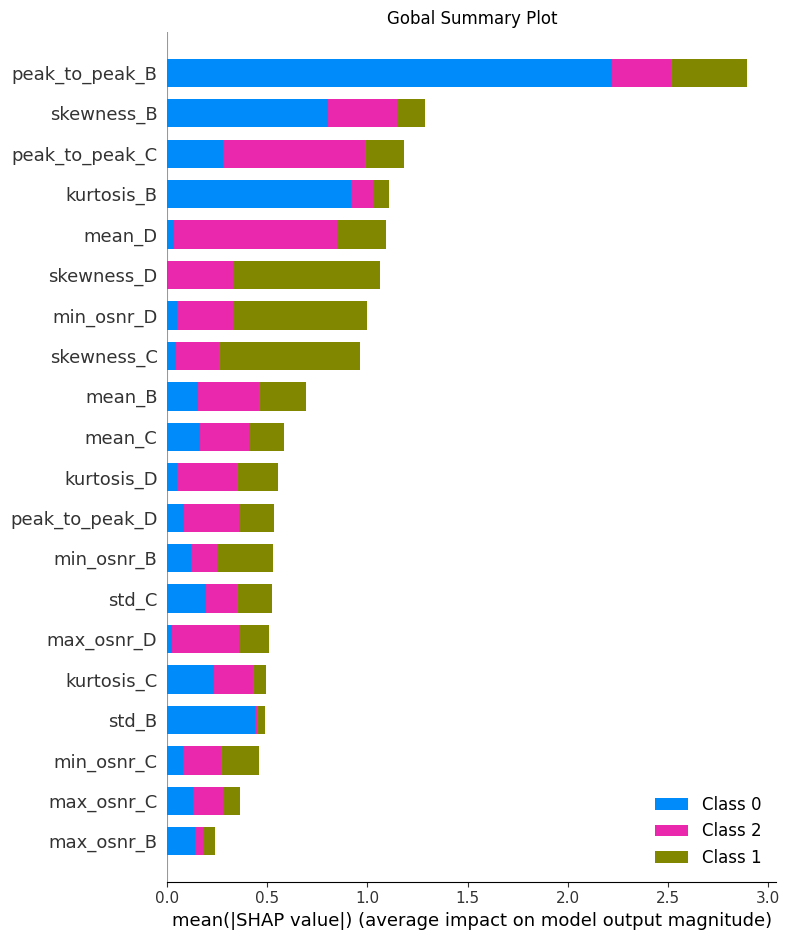

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


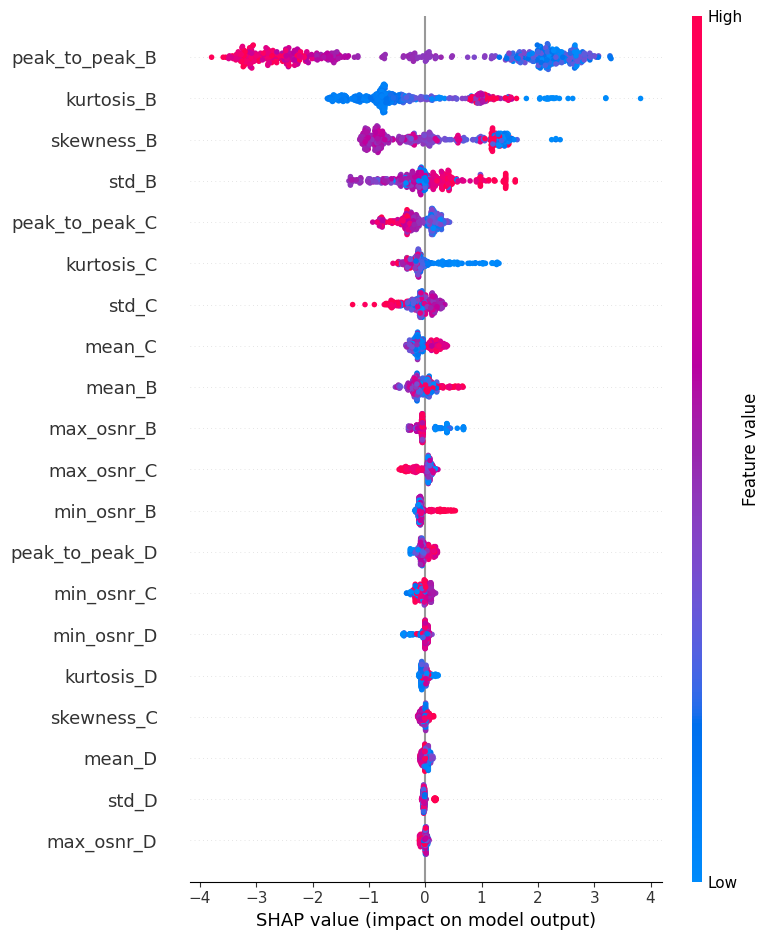

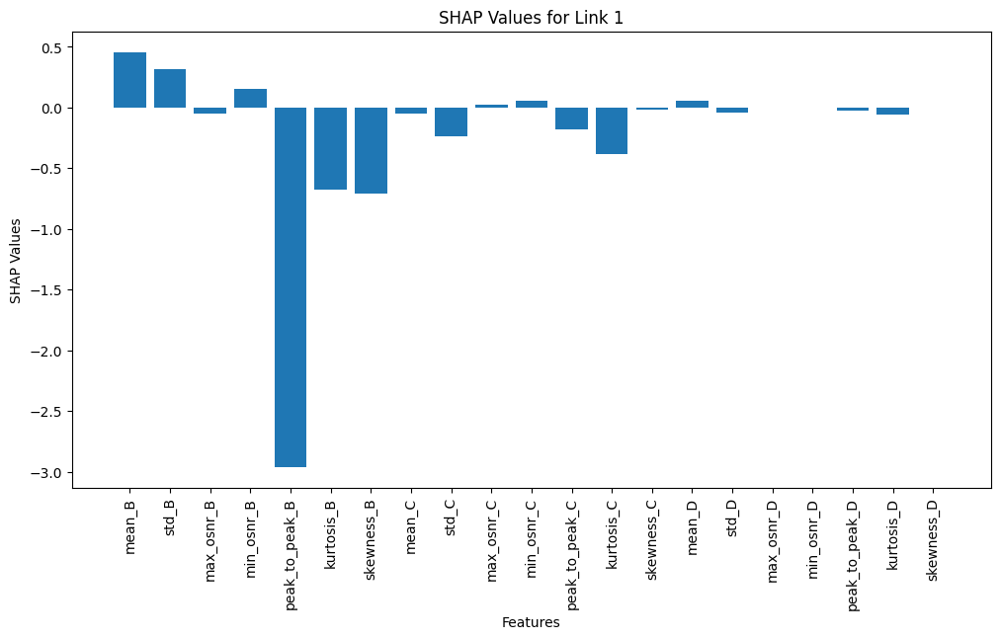

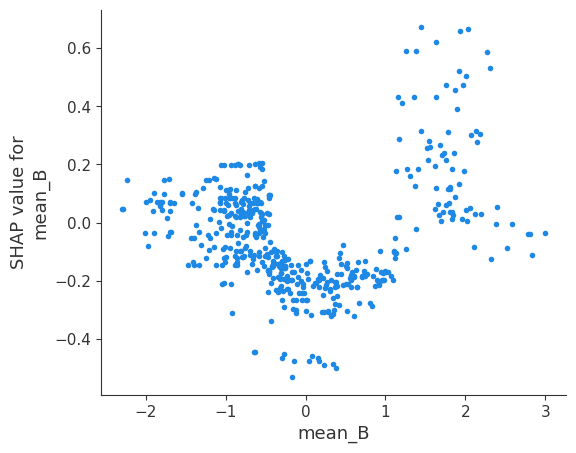

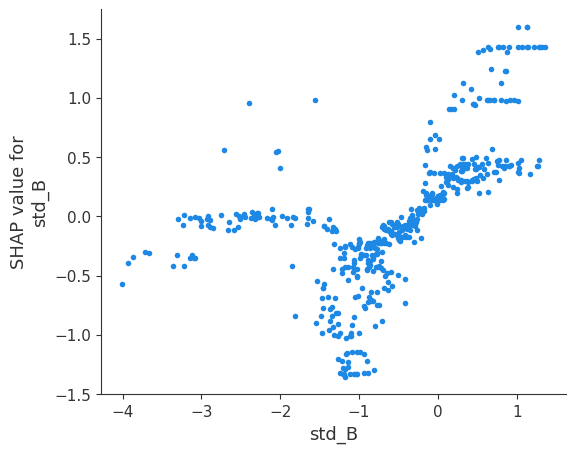

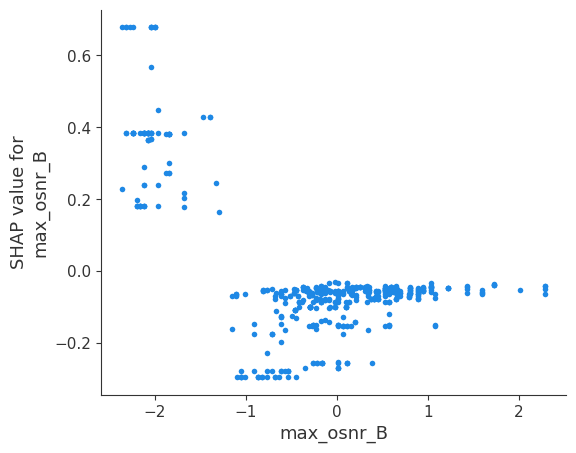

...

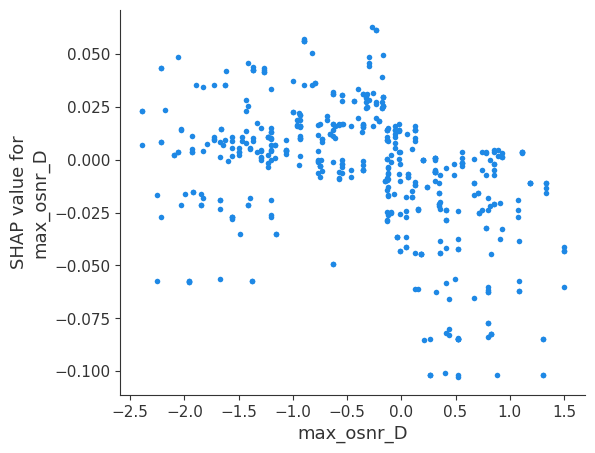

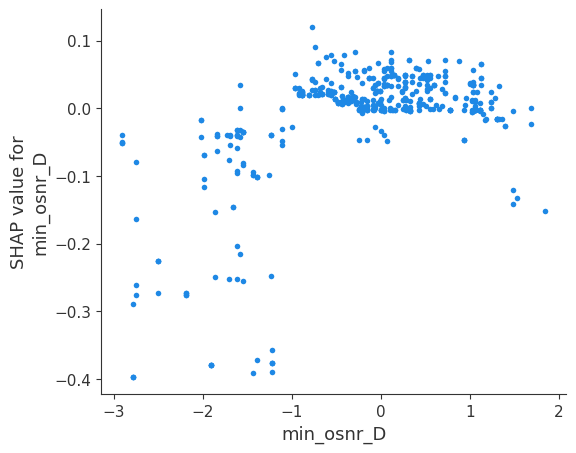

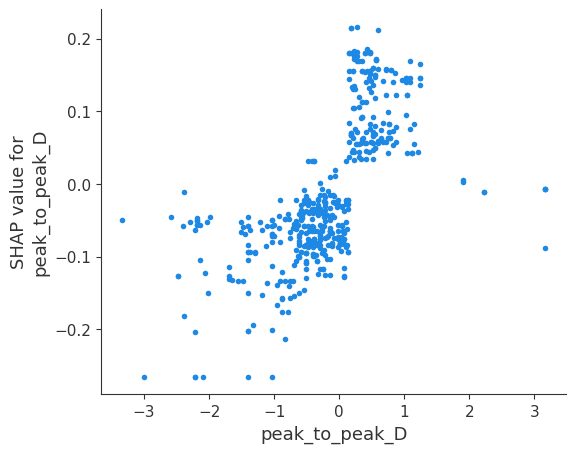

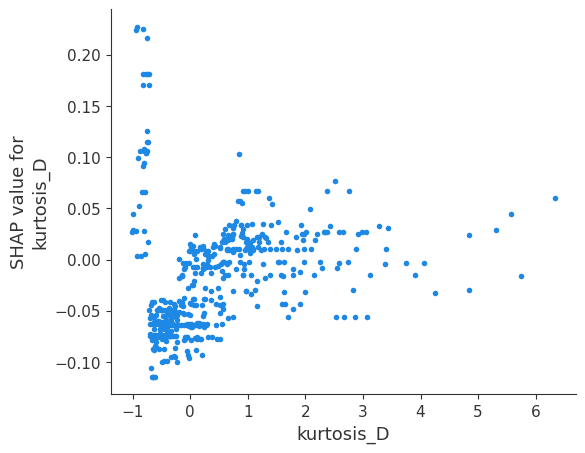

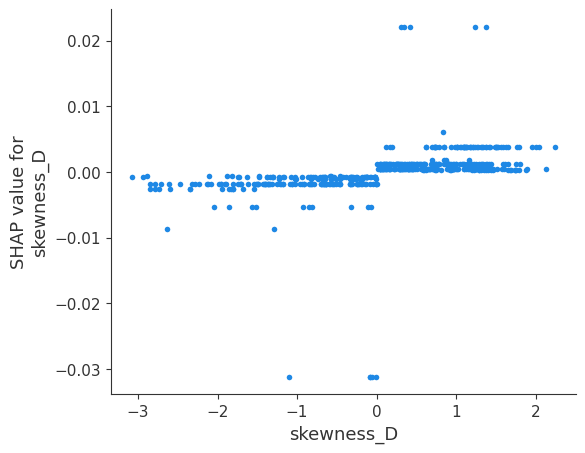

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


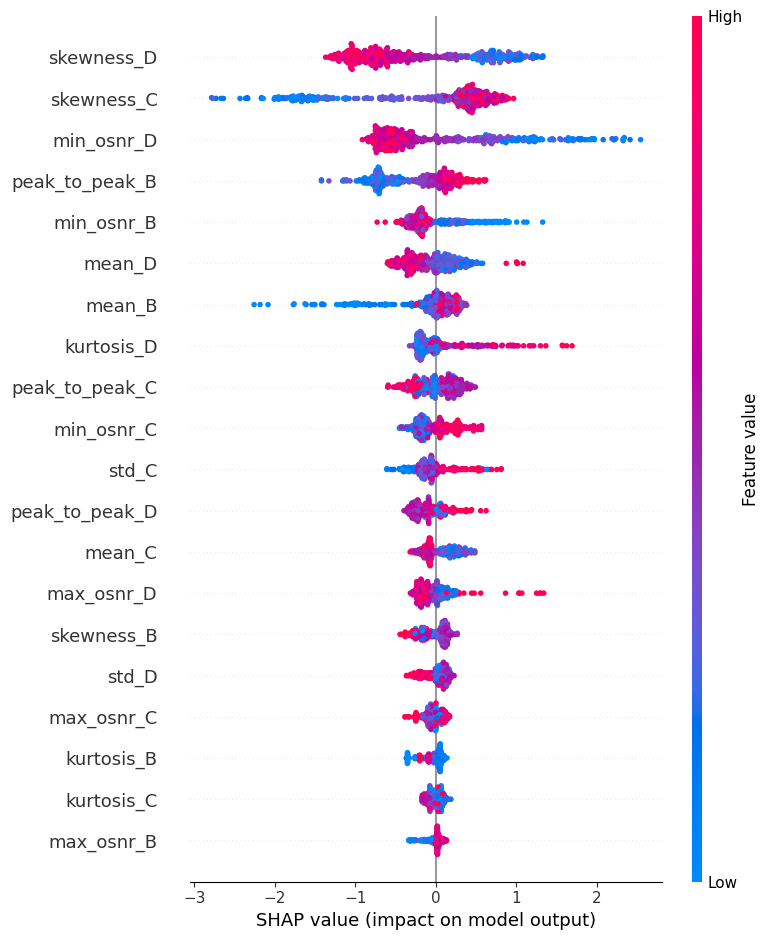

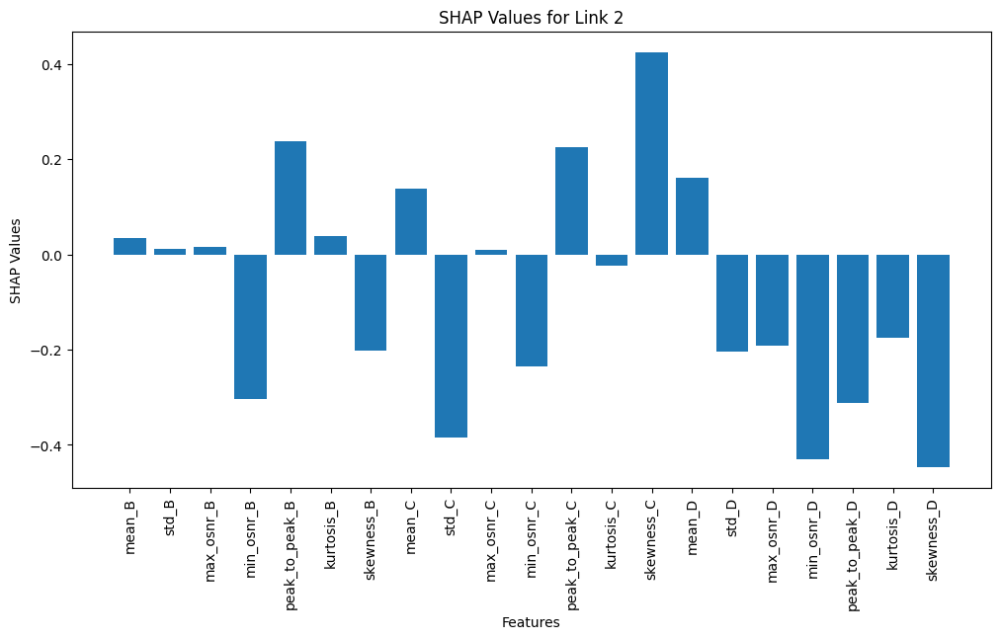

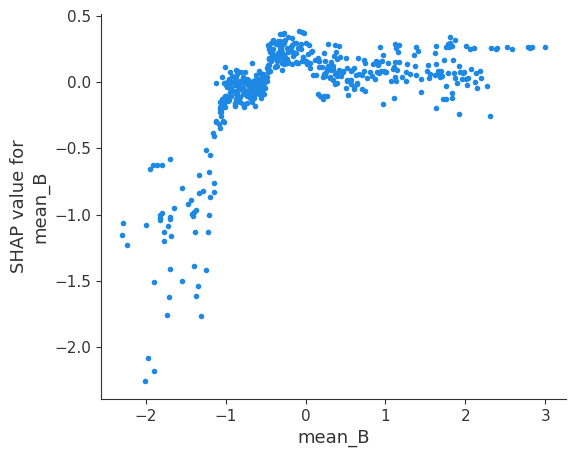

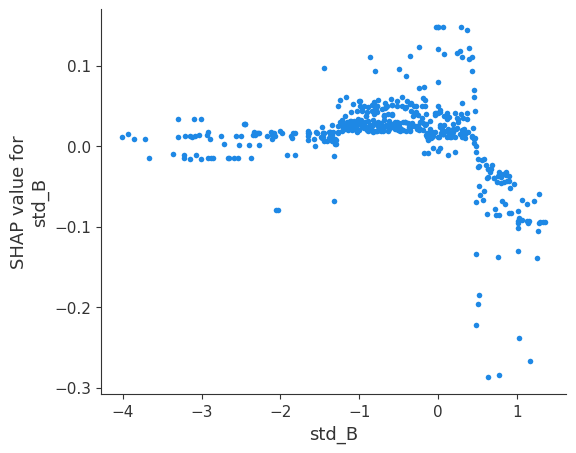

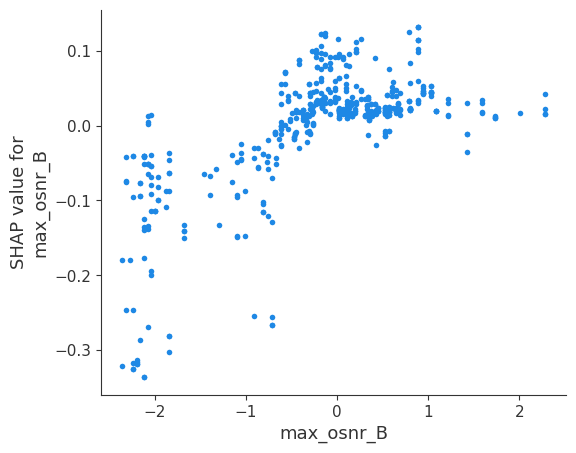

...

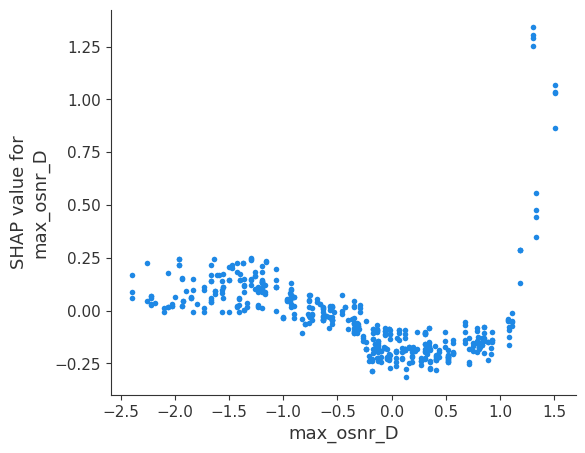

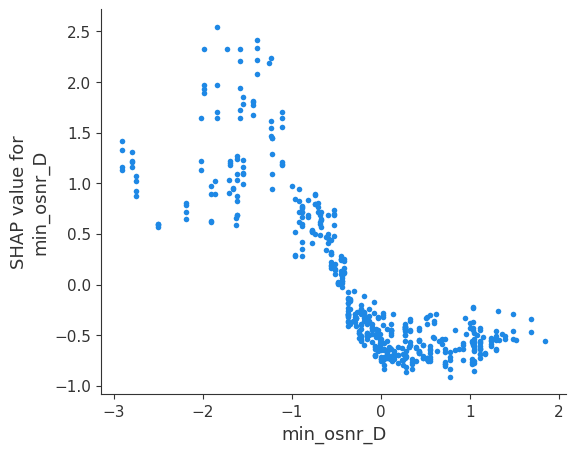

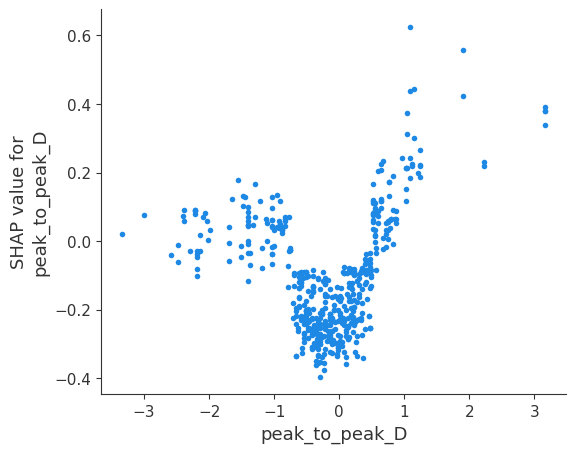

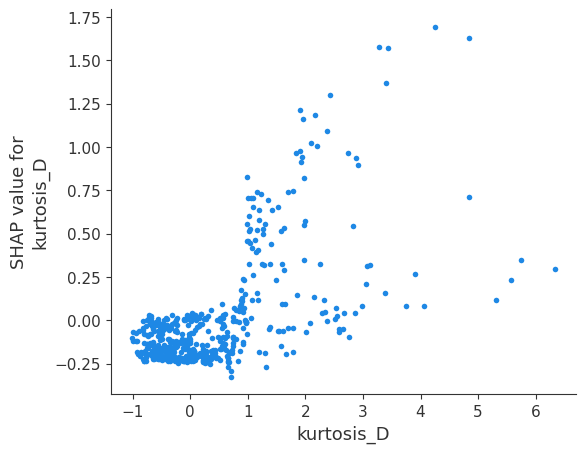

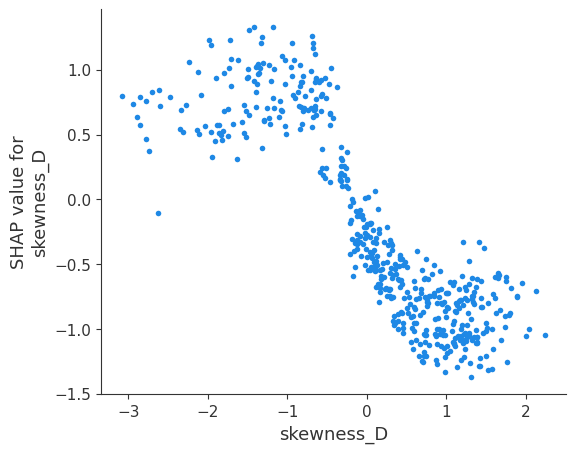

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


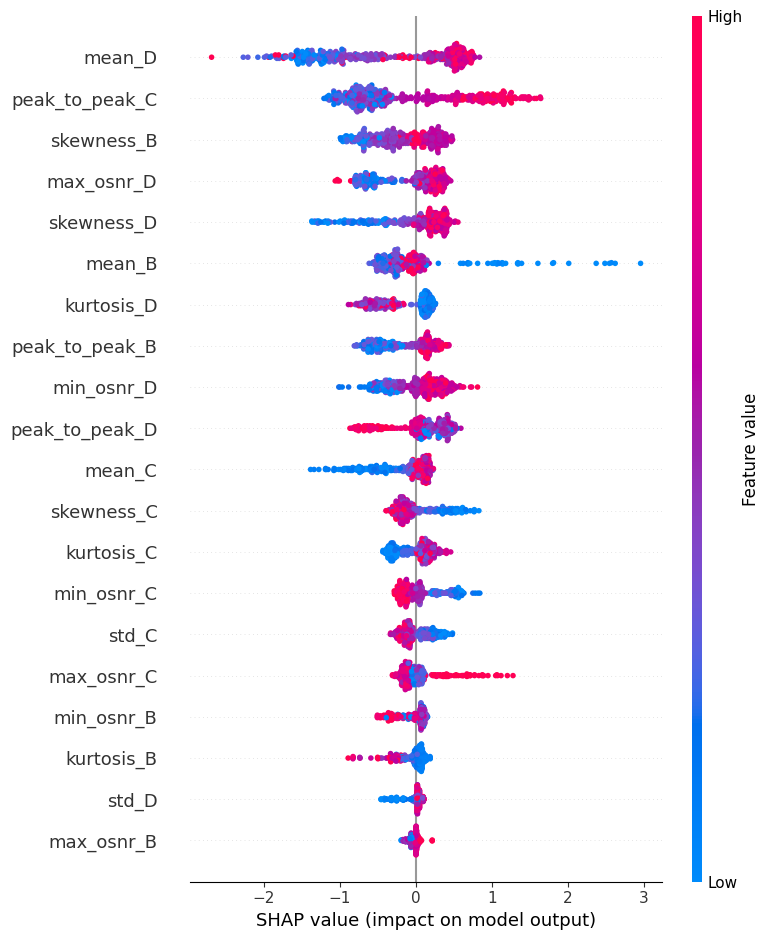

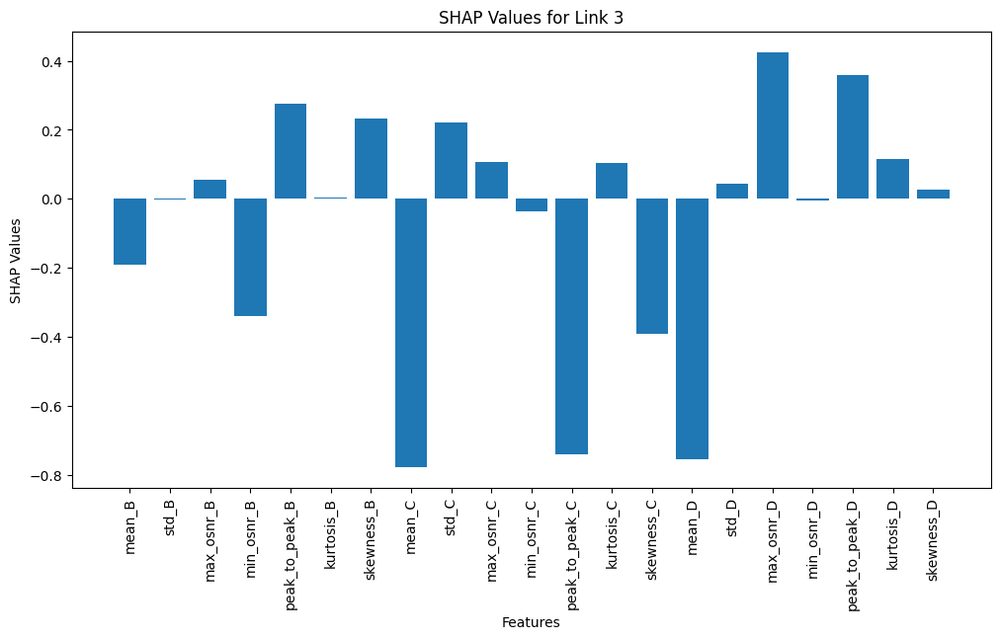

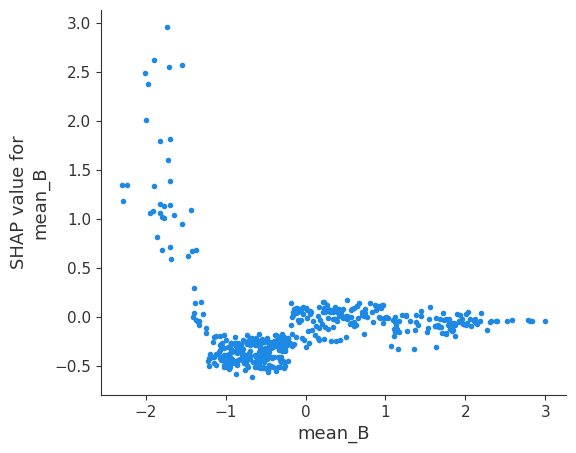

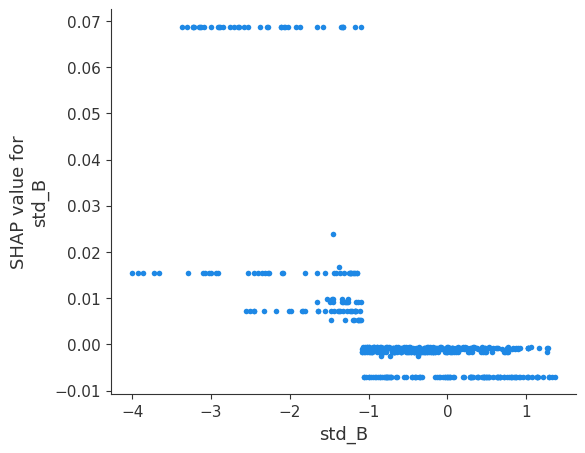

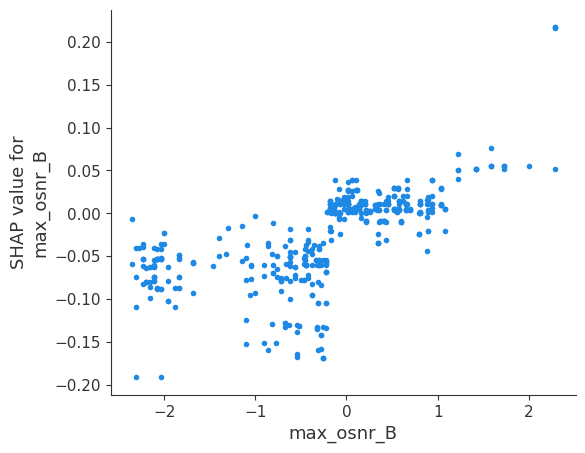

...

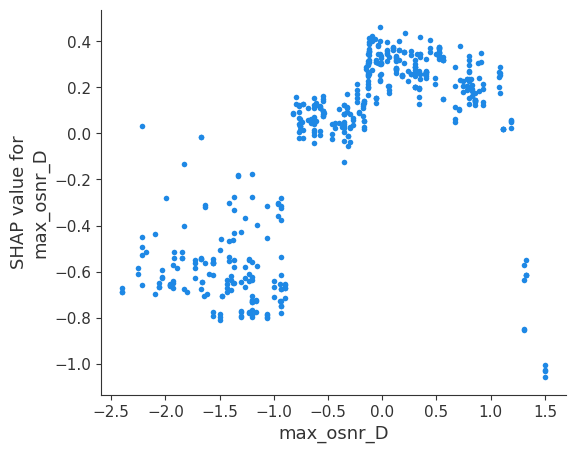

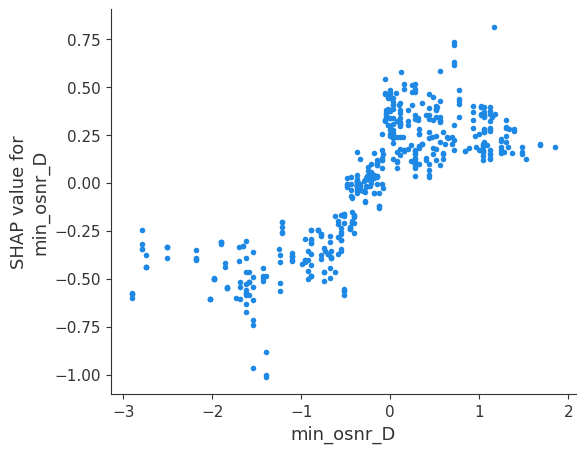

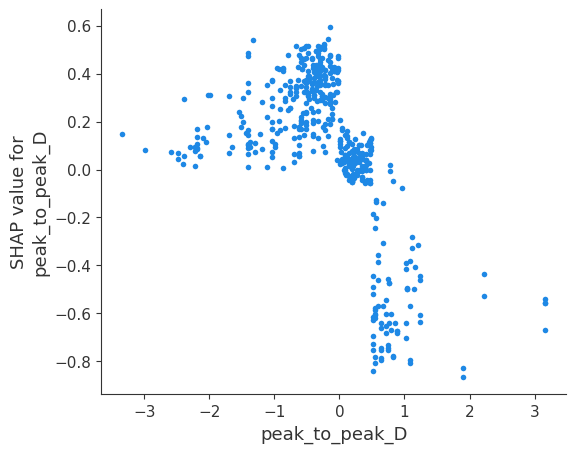

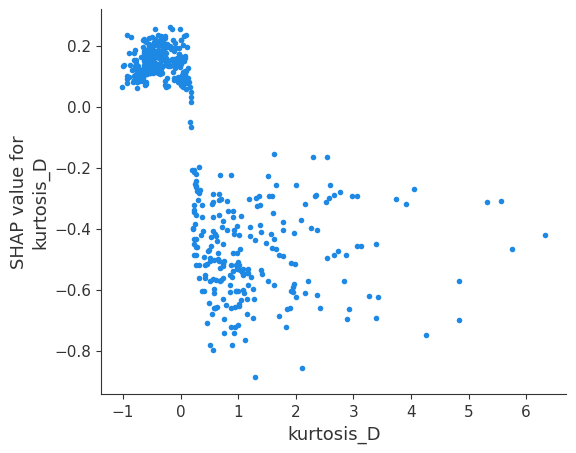

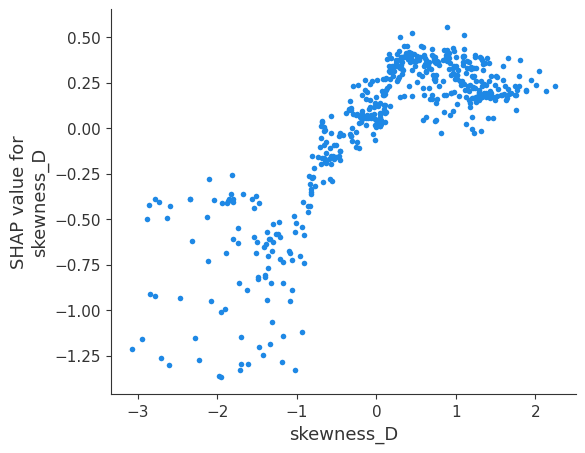

In [ ]:
shap_plots_explainable_ai_tree_explainer(best_model, X_test)

Average Train Accuracy: 0.9431
Average Train MSE: 0.0895
Average Train Precision: 0.9435
Average Train F1: 0.9432
Average Train Duration: 7.5163
Average Test Accuracy: 0.8815
Best Test Accuracy: 0.8910


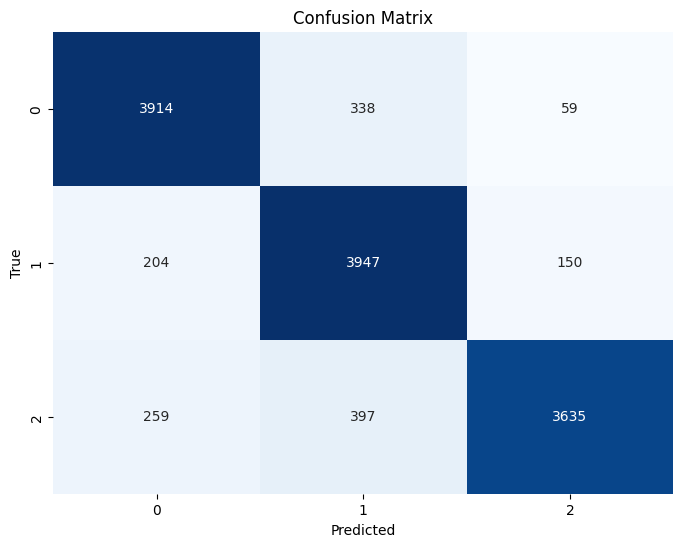

In [ ]:
#no scaling
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
best_model, X_test = in_time_xgb_classifier_w_kfold(5, train_data, test_data, False)

Average Train Accuracy: 0.9434
Average Train MSE: 0.0892
Average Train Precision: 0.9438
Average Train F1: 0.9435
Average Train Duration: 7.1339
Average Test Accuracy: 0.8815
Best Test Accuracy: 0.8910


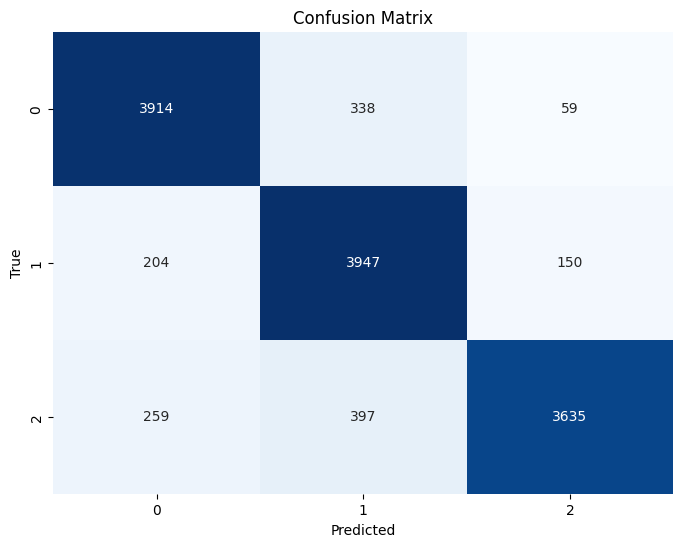

In [ ]:
#scaling
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
best_model, X_test = in_time_xgb_classifier_w_kfold(5, train_data, test_data, True)

[09:11:58] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


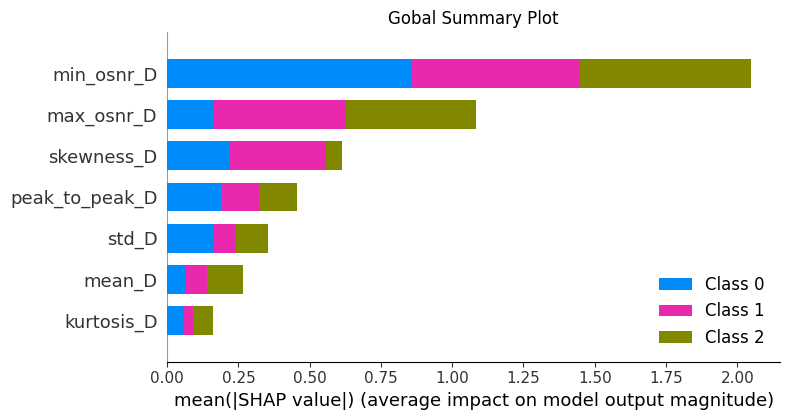

Link  1


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


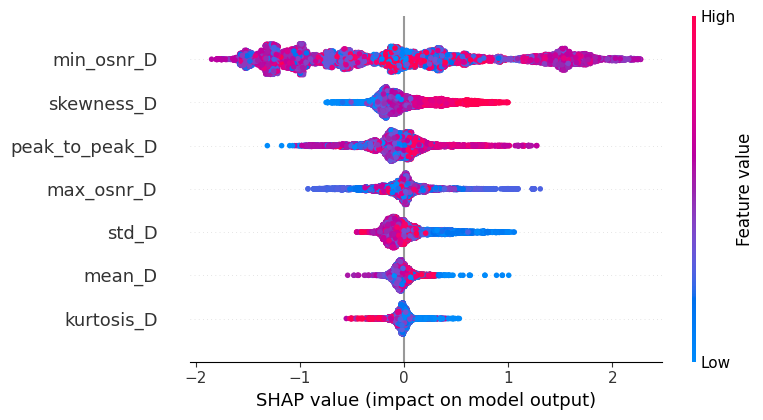

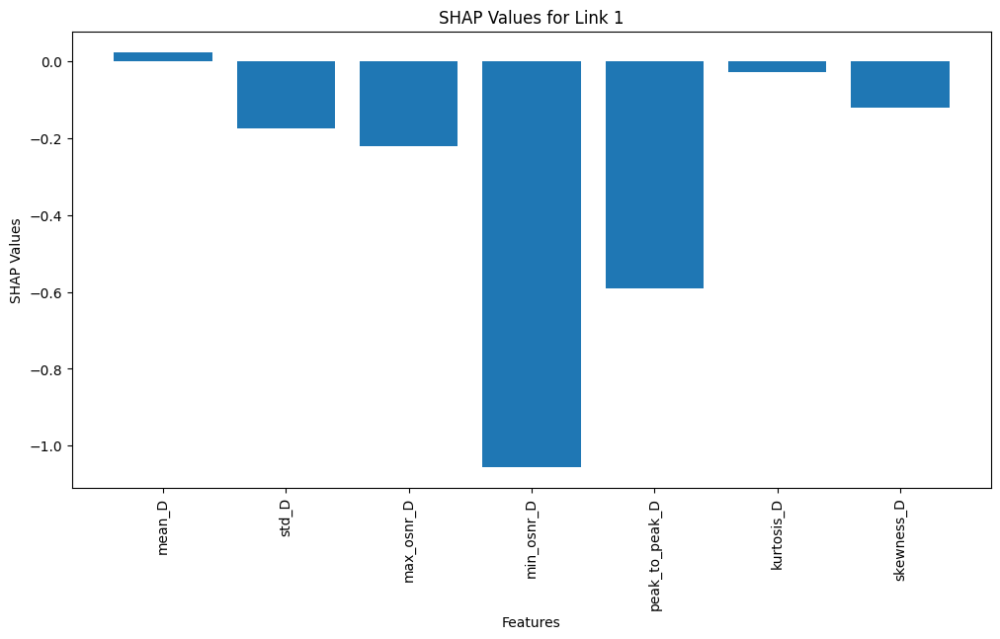

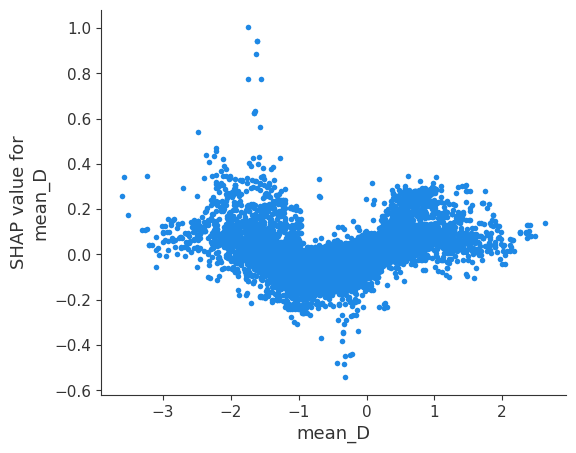

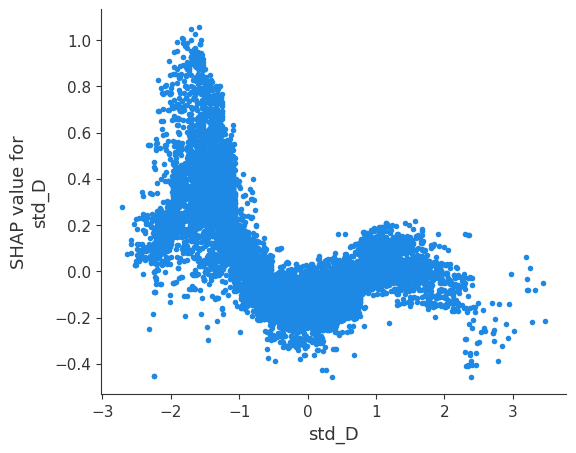

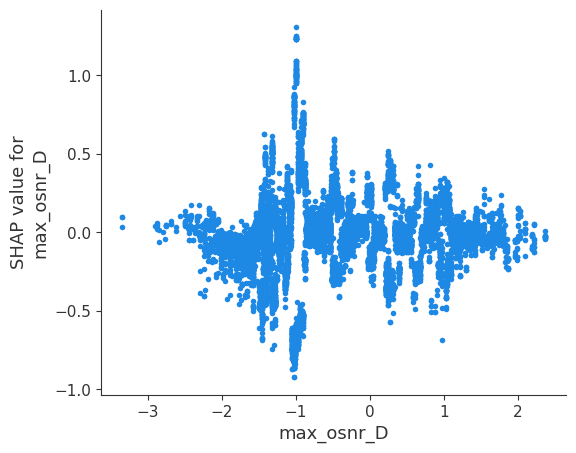

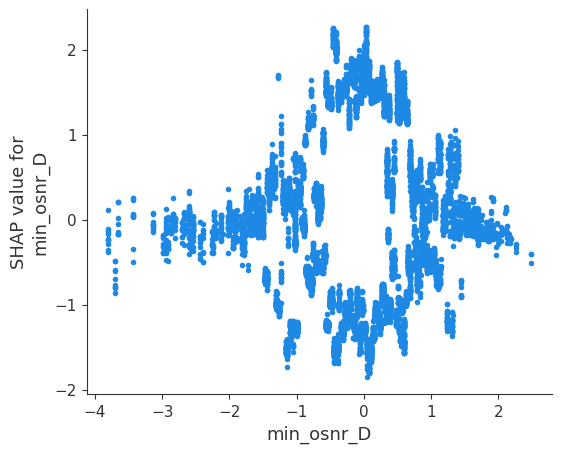

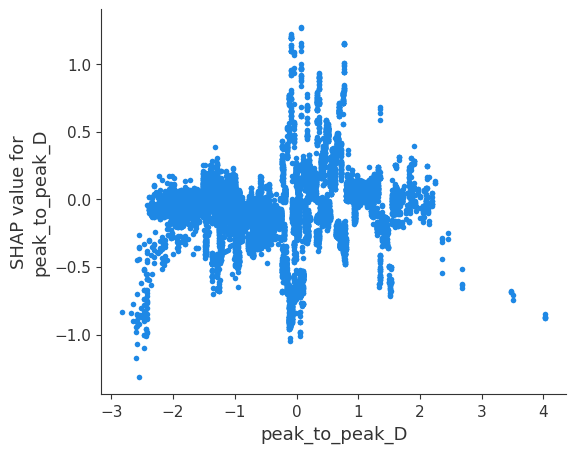

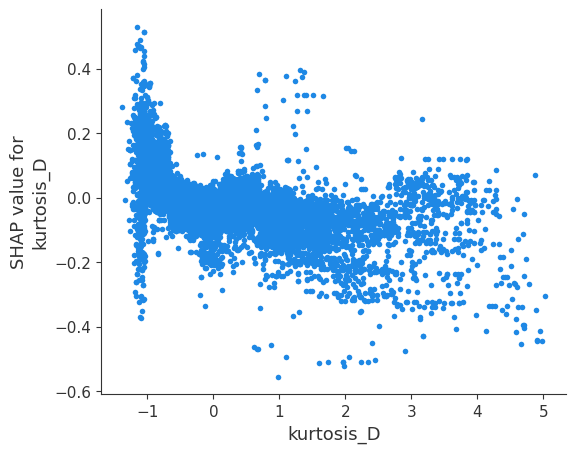

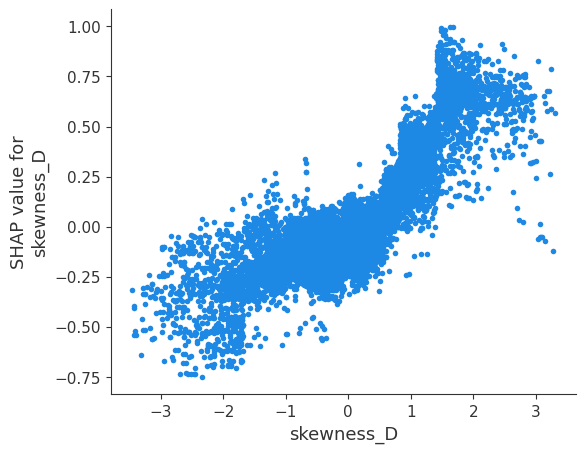

Link  2


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


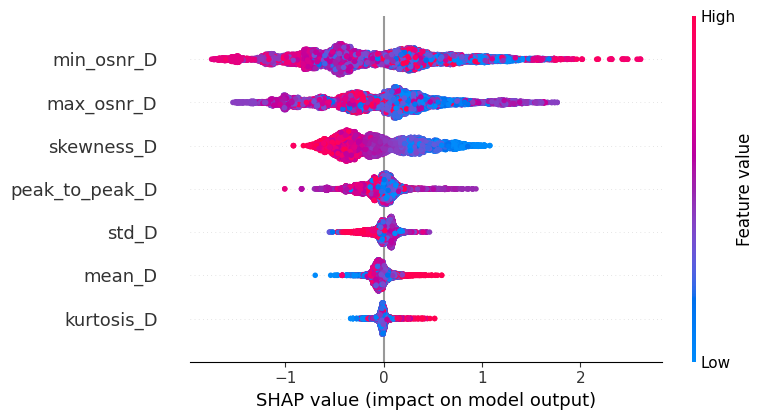

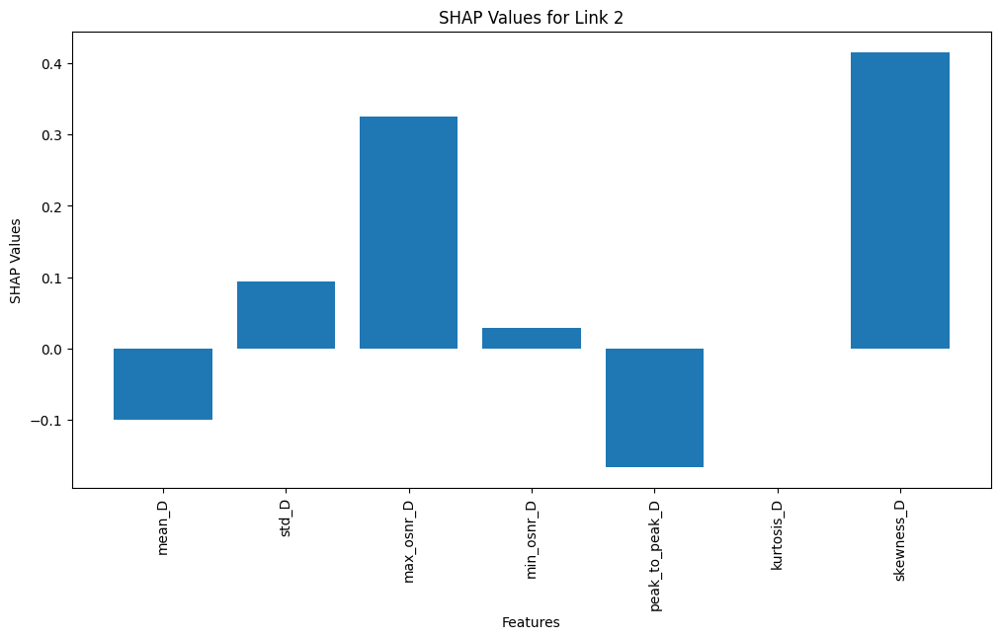

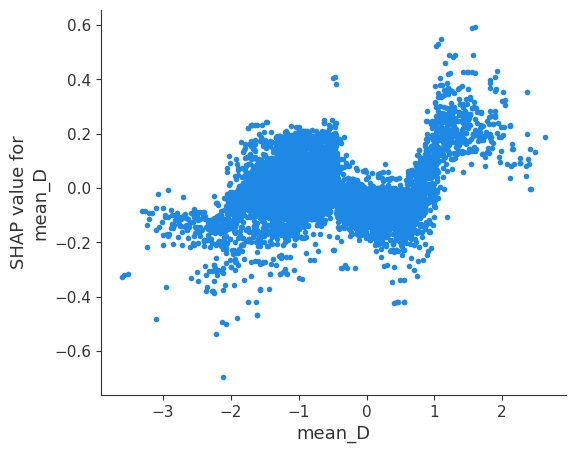

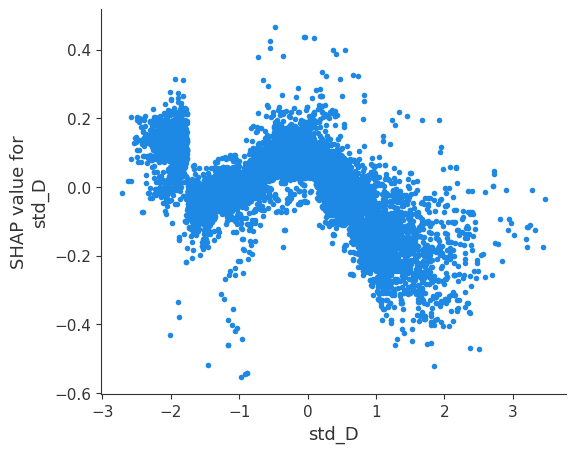

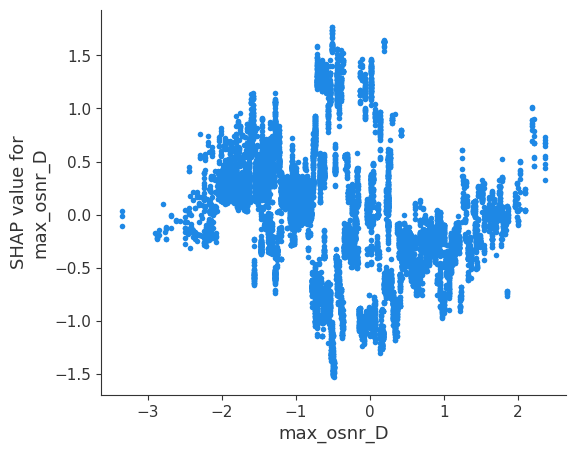

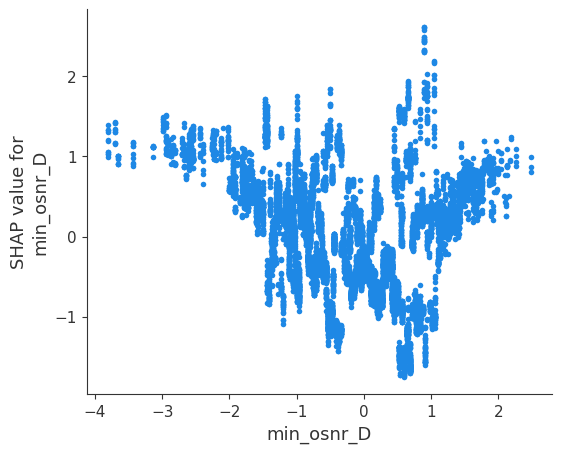

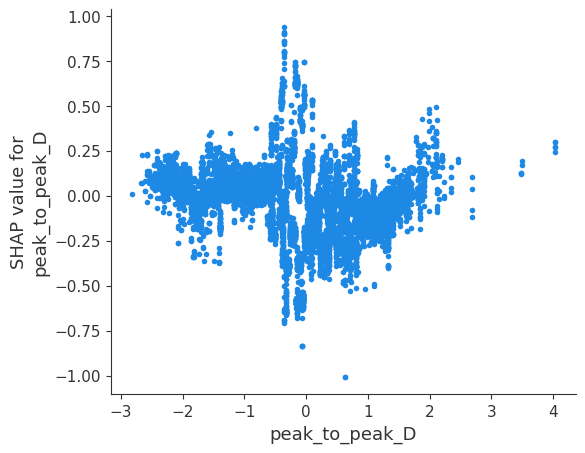

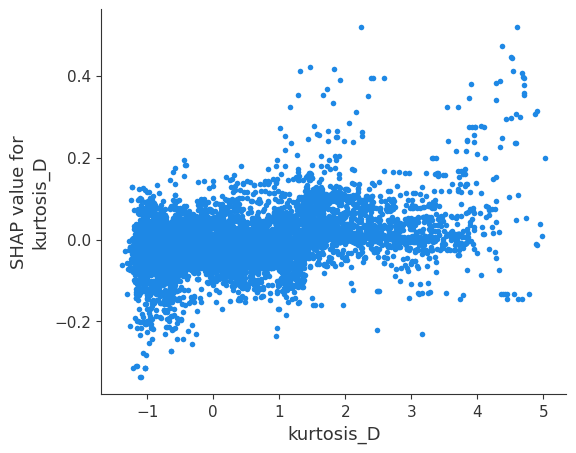

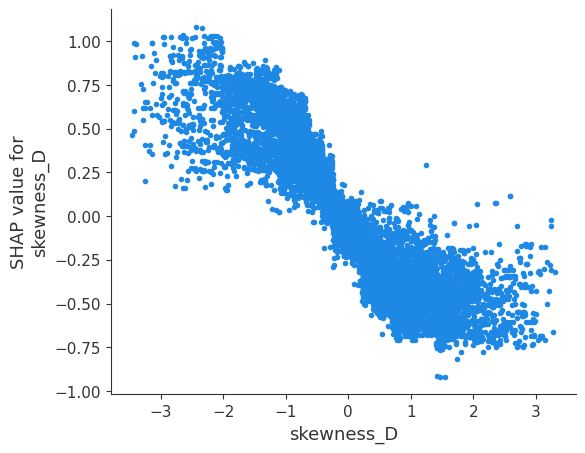

Link  3


No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


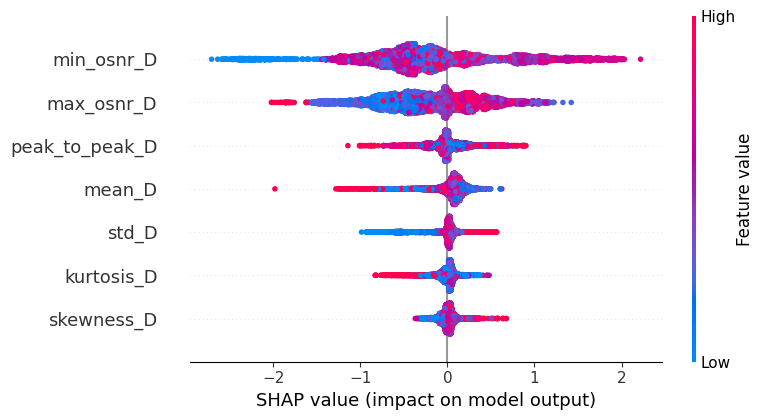

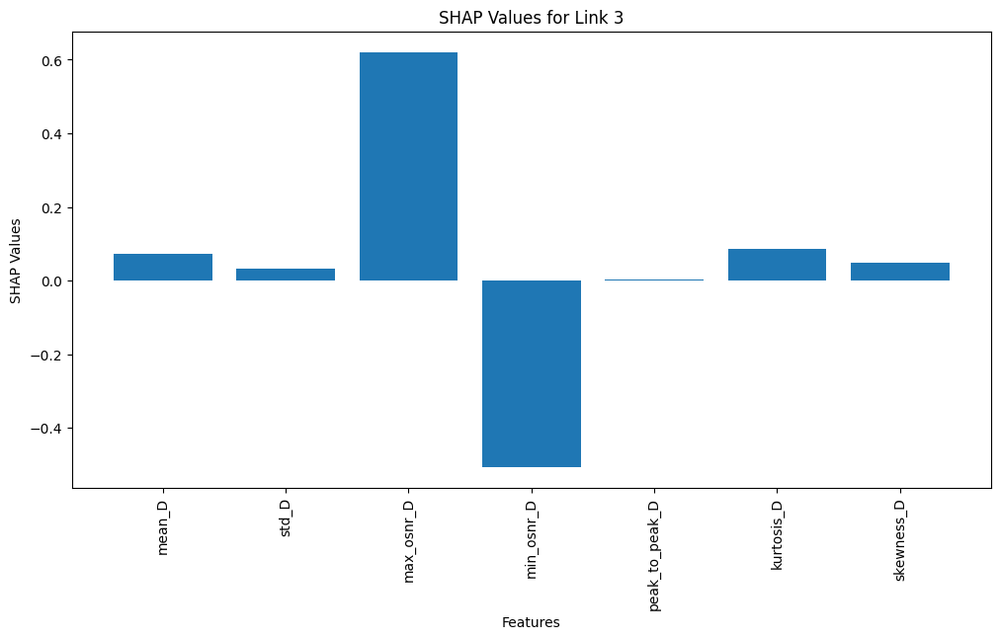

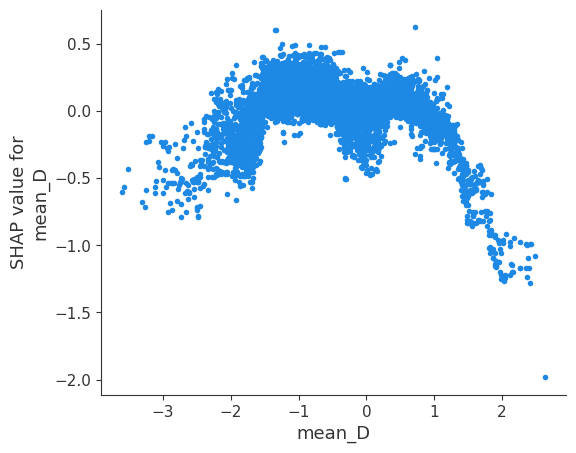

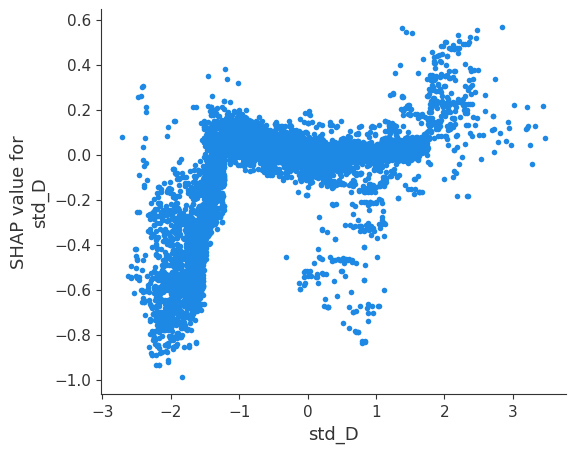

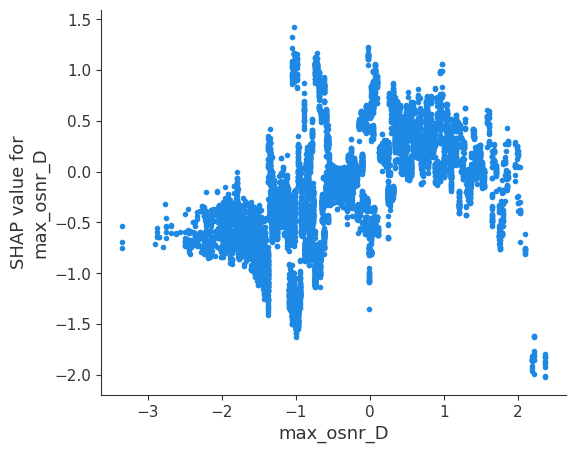

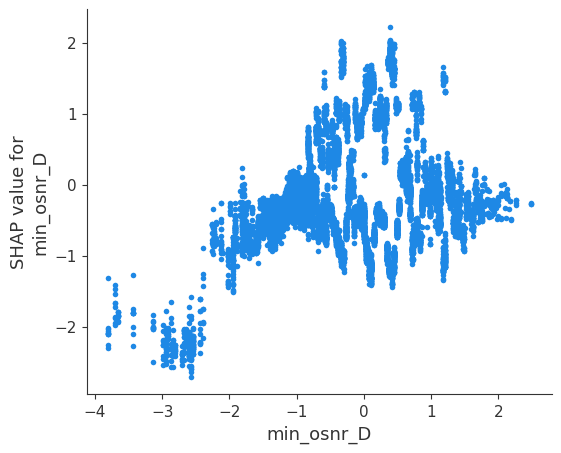

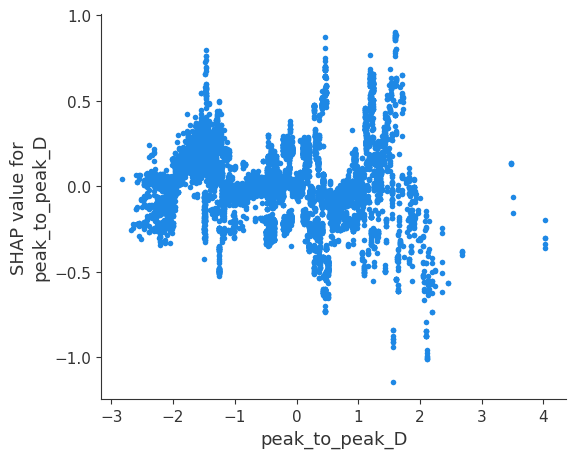

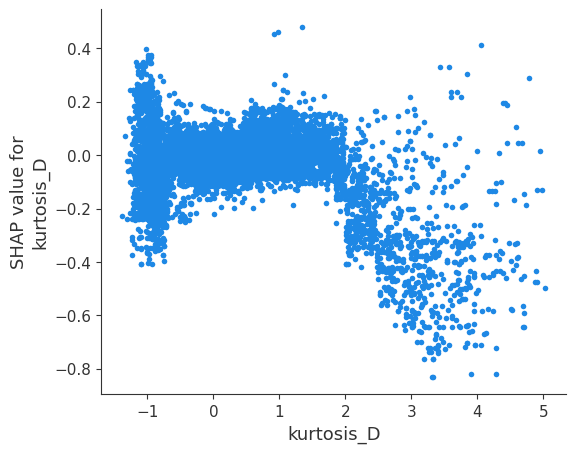

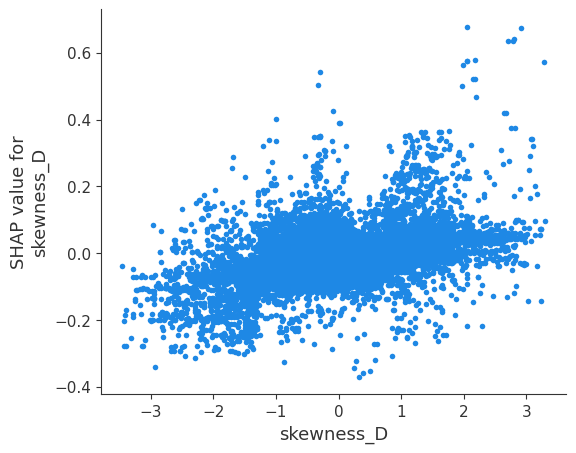

In [ ]:
shap_plots_explainable_ai_tree_explainer(best_model, X_test)

### LSTM

In [ ]:
def in_time_lstm_classifier_w_kfold(n_splits, train_df, test_df, is_scaled):
    """
    Classification with LSTM model
    """
    # shuffle
    train_df = train_df.sample(frac=1, random_state=42)
    test_df = test_df.sample(frac=1, random_state=42)

    train_df.reset_index(drop=True, inplace=True)
    test_df.reset_index(drop=True, inplace=True)

    label_encoder = LabelEncoder()
    X_train, y_train = train_df.drop('link', axis=1), label_encoder.fit_transform(train_df['link'])
    X_test, y_test = test_df.drop('link', axis=1), label_encoder.fit_transform(test_df['link'])

    if is_scaled:
        scaler = StandardScaler()
        X_train = scaler.fit_transform(X_train)
        X_test = scaler.transform(X_test)

    # Reshape data for LSTM [samples, time steps, features]
    X_train = np.array(X_train).reshape((X_train.shape[0], 1, X_train.shape[1]))
    X_test = np.array(X_test).reshape((X_test.shape[0], 1, X_test.shape[1]))

    # One-hot encode the labels
    y_train = to_categorical(y_train)
    y_test = to_categorical(y_test)

    outer_skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

    test_accuracies, train_accuracies, mse_scores, precision_scores, recall_scores, f1_scores, training_durations = [], [], [], [], [], [], []
    best_model, best_score = None, 0.0

    for train_index, test_index in outer_skf.split(X_train, np.argmax(y_train, axis=1)):
        X_train_fold, X_val_fold = X_train[train_index], X_train[test_index]
        y_train_fold, y_val_fold = y_train[train_index], y_train[test_index]

        model = Sequential([
            LSTM(10, input_shape=(X_train.shape[1], X_train.shape[2])),
            Dense(y_train.shape[1], activation='softmax')
        ])
        model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

        start_time = time.time()
        model.fit(X_train_fold, y_train_fold, epochs=10, batch_size=64, verbose=0)
        training_duration = time.time() - start_time

        _, train_accuracy = model.evaluate(X_val_fold, y_val_fold, verbose=0)
        train_accuracies.append(train_accuracy)

        y_pred_val = model.predict(X_val_fold).argmax(axis=1)
        y_val_fold_classes = np.argmax(y_val_fold, axis=1)
        mse_scores.append(mean_squared_error(y_val_fold_classes, y_pred_val))
        precision_scores.append(precision_score(y_val_fold_classes, y_pred_val, average='macro'))
        recall_scores.append(recall_score(y_val_fold_classes, y_pred_val, average='macro'))
        f1_scores.append(f1_score(y_val_fold_classes, y_pred_val, average='macro'))

        y_pred_test = model.predict(X_test).argmax(axis=1)
        y_test_classes = np.argmax(y_test, axis=1)
        accuracy = accuracy_score(y_test_classes, y_pred_test)
        test_accuracies.append(accuracy)

        if accuracy > best_score:
            best_score = accuracy
            best_model = model

    avg_metrics = {
        "Average Train Accuracy": np.mean(train_accuracies),
        "Average Train MSE": np.mean(mse_scores),
        "Average Train Precision": np.mean(precision_scores),
        "Average Train F1": np.mean(f1_scores),
        "Average Train Duration": np.mean(training_durations),
        "Average Test Accuracy": np.mean(test_accuracies)
    }

    for metric, value in avg_metrics.items():
        print(f"{metric}: {value:.4f}")

    print(f"Best Test Accuracy: {best_score:.4f}")

    y_pred_best = best_model.predict(X_test).argmax(axis=1)
    confusion_best = confusion_matrix(y_test_classes, y_pred_best)
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_best, annot=True, cmap='Blues', fmt='d', cbar=False)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

#### Multiple Monitor

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in

Average Train Accuracy: 0.8000
Average Train MSE: 0.3296
Average Train Precision: 0.7997
Average Train F1: 0.7996
Average Train Duration: nan
Average Test Accuracy: 0.6845
Best Test Accuracy: 0.6967


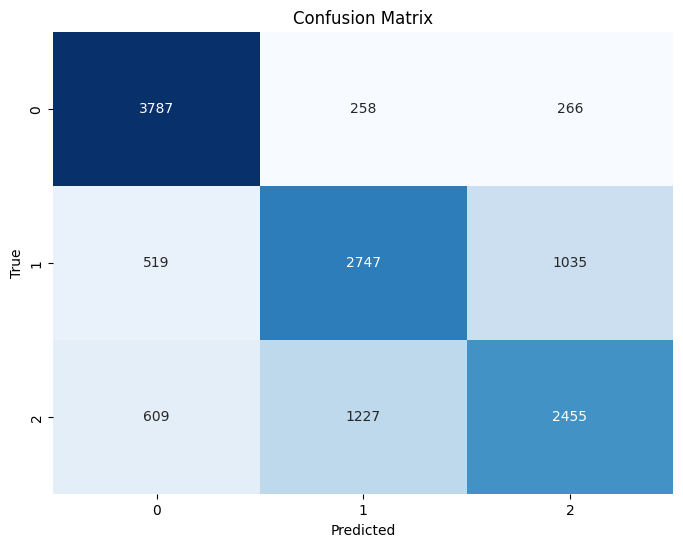

In [ ]:
# no scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.8)
in_time_lstm_classifier_w_kfold(5, train_data, test_data, False)

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in

Average Train Accuracy: 0.7979
Average Train MSE: 0.3327
Average Train Precision: 0.7969
Average Train F1: 0.7971
Average Train Duration: nan
Average Test Accuracy: 0.6808
Best Test Accuracy: 0.6955


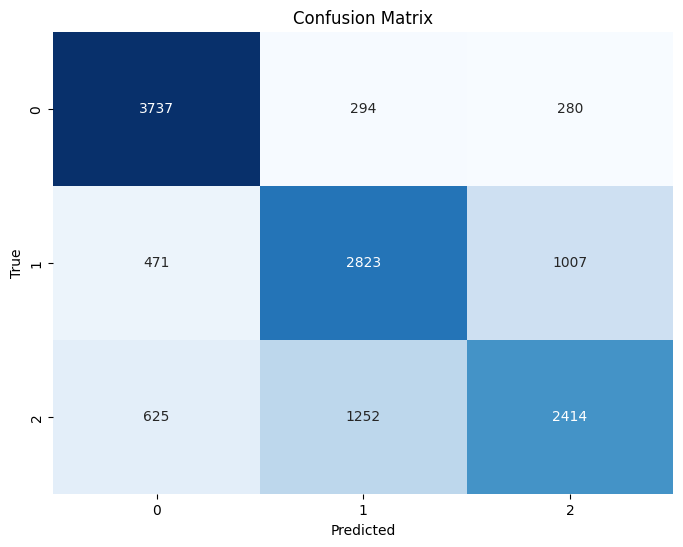

In [ ]:
# scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_df, 10, 1, 0.8)
in_time_lstm_classifier_w_kfold(5, train_data, test_data, True)

#### Single Monitor

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in

Average Train Accuracy: 0.5574
Average Train MSE: 0.9752
Average Train Precision: 0.5561
Average Train F1: 0.5534
Average Train Duration: nan
Average Test Accuracy: 0.5540
Best Test Accuracy: 0.5589


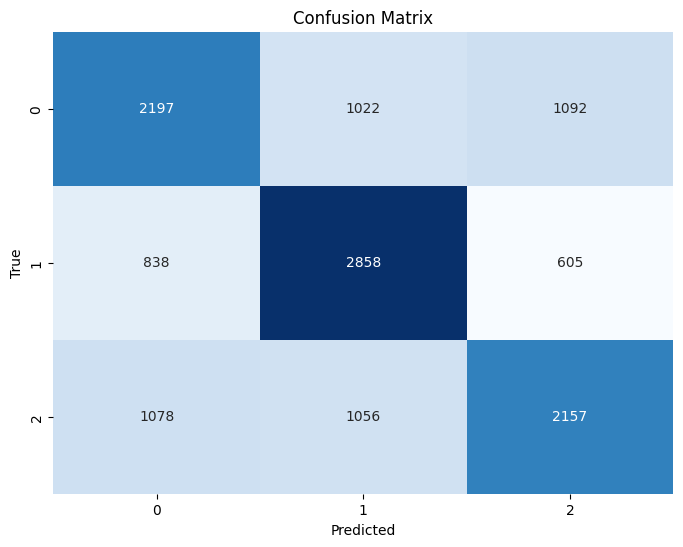

In [ ]:
# no scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
in_time_lstm_classifier_w_kfold(5, train_data, test_data, False)

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in

Average Train Accuracy: 0.5579
Average Train MSE: 0.9714
Average Train Precision: 0.5567
Average Train F1: 0.5547
Average Train Duration: nan
Average Test Accuracy: 0.5533
Best Test Accuracy: 0.5585


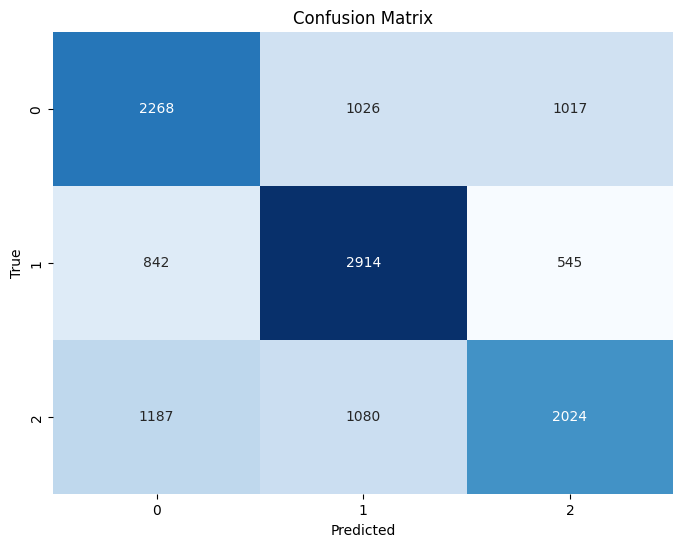

In [ ]:
# scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 10, 1, 0.8)
in_time_lstm_classifier_w_kfold(5, train_data, test_data, True)

#### Bigger window sizes and spacing

#### Multiple Monitor

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in

Average Train Accuracy: 0.8513
Average Train MSE: 0.2408
Average Train Precision: 0.8521
Average Train F1: 0.8512
Average Train Duration: nan
Average Test Accuracy: 0.7502
Best Test Accuracy: 0.7932


Mean of empty slice.
invalid value encountered in scalar divide


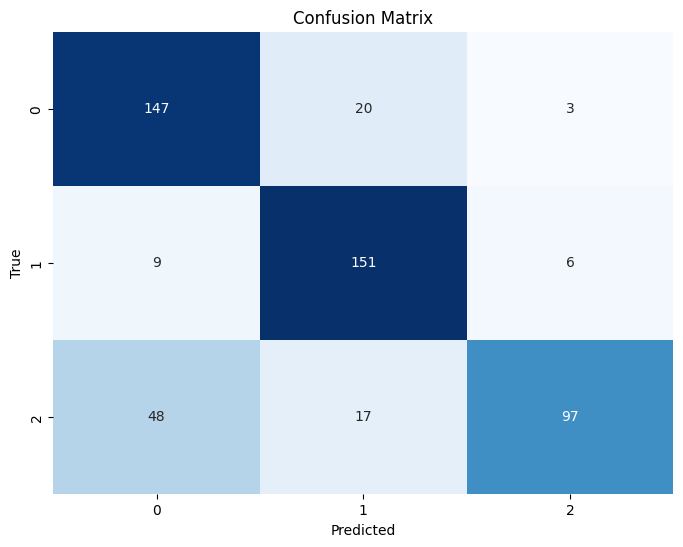

In [ ]:
# no scaling, window size=100, test size=0.2
train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.8)
in_time_lstm_classifier_w_kfold(5, train_data, test_data, False)

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in

Average Train Accuracy: 0.8561
Average Train MSE: 0.2331
Average Train Precision: 0.8575
Average Train F1: 0.8561
Average Train Duration: nan
Average Test Accuracy: 0.7534
Best Test Accuracy: 0.7711


Mean of empty slice.
invalid value encountered in scalar divide


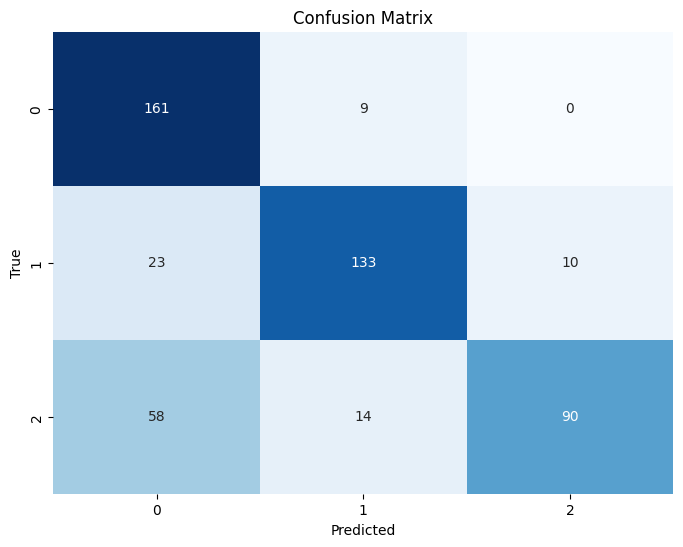

In [ ]:
# scaling, window size=100, test size=0.2
train_data, test_data = in_time_spliter(new_final_df, 100, 25, 0.8)
in_time_lstm_classifier_w_kfold(5, train_data, test_data, True)

#### Signle Monitor

`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
`Model.state_updates` will be removed in a future version. This property should not be used in

Average Train Accuracy: 0.5575
Average Train MSE: 0.9775
Average Train Precision: 0.5567
Average Train F1: 0.5540
Average Train Duration: nan
Average Test Accuracy: 0.5621
Best Test Accuracy: 0.5677


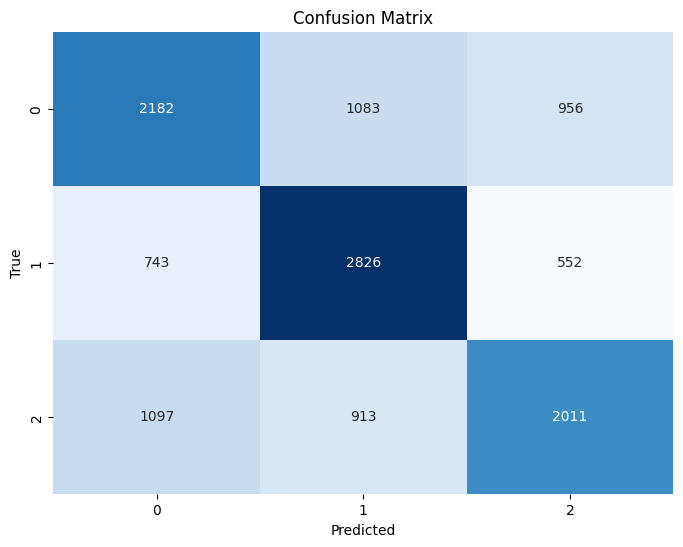

In [ ]:
# No scaling, window size=10, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 100, 1, 0.8)
in_time_lstm_classifier_w_kfold(5, train_data, test_data, False)

In [ ]:
# scaling, window size=100, test size=0.2
train_data, test_data = in_time_spliter(final_one_node_df, 100, 1, 0.8)
in_time_lstm_classifier_w_kfold(5, train_data, test_data, True)